In [2]:

import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
power = pd.read_csv("building_power.csv") # power consumption
occ = pd.read_csv("wrongocc.csv") # building occ.
weather_2015 = pd.read_csv("weather/weather_2015.csv")
weather_2016 = pd.read_csv("weather/weather_2016.csv")
weather_2017 = pd.read_csv("weather/weather_2017.csv")
cal_2015 = pd.read_csv("calender/calender_2015.csv")
cal_2016 = pd.read_csv("calender/calender_2016.csv")
cal_2017 = pd.read_csv("calender/calender_2017.csv")

## Data Processing

### combine weather and cal dataframe

In [4]:
cal_new = pd.concat([cal_2015,cal_2016,cal_2017],axis=0,ignore_index='false',join="outer")

In [5]:
weather_new = pd.concat([weather_2015,weather_2016,weather_2017],axis=0,ignore_index='false',join="outer")

In [6]:
cal_new.rename(columns={'Date': 'date'}, inplace=True)

In [7]:
weather_new[17500
            :17525]

,timestamp,TemperatureC,Humidity
17500,2015-12-31 14:00:00,23.0,14.0
17501,2015-12-31 14:30:00,24.0,9.0
17502,2015-12-31 15:00:00,23.0,10.0
17503,2015-12-31 15:30:00,23.0,10.0
17504,2015-12-31 16:00:00,24.0,8.0
17505,2015-12-31 16:30:00,23.0,10.0
17506,2015-12-31 17:00:00,22.0,14.0
17507,2015-12-31 17:30:00,19.0,19.0
17508,2015-12-31 18:00:00,19.0,23.0
17509,2015-12-31 18:30:00,18.0,28.0


In [8]:
weather_new["timestamp"] = pd.to_datetime(weather_new['timestamp'])
weather_new['date'] = [str(d.date()) for d in weather_new['timestamp']]
weather_new['time'] = [d.time() for d in weather_new['timestamp']]
#weather_new['working_day']=[cal_new[cal_new.Date==str(d)]['working_day'] for d in weather_new['date']]

In [9]:
c1=pd.merge(weather_new,cal_new,on='date',how='inner')

In [10]:

c1['date'] = [d.date()for d in c1['timestamp']]


In [11]:

occ[44980:46100]

,timestamp,occupancy_count
44980,2016-01-01 00:10:00,7.0
44981,2016-01-01 00:11:00,8.0
44982,2016-01-01 00:12:00,8.0
44983,2016-01-01 00:13:00,8.0
44984,2016-01-01 00:14:00,8.0
44985,2016-01-01 00:15:00,8.0
44986,2016-01-01 00:16:00,8.0
44987,2016-01-01 00:17:00,8.0
44988,2016-01-01 00:18:00,9.0
44989,2016-01-01 00:19:00,9.0


## Join occ and power

In [12]:
c2=power.merge(occ,on="timestamp")

In [13]:
c2[44980:46100]

,timestamp,power,occupancy_count
44980,2016-01-01 00:10:00,20555.59570,7.0
44981,2016-01-01 00:11:00,20534.36523,8.0
44982,2016-01-01 00:12:00,20662.73438,8.0
44983,2016-01-01 00:13:00,20953.13184,8.0
44984,2016-01-01 00:14:00,20876.59082,8.0
44985,2016-01-01 00:15:00,20824.33691,8.0
44986,2016-01-01 00:16:00,20507.81641,8.0
44987,2016-01-01 00:17:00,19461.19922,8.0
44988,2016-01-01 00:18:00,18318.10352,9.0
44989,2016-01-01 00:19:00,18622.61035,9.0


In [14]:
c2["timestamp"] = pd.to_datetime(c2['timestamp'])
c2['date'] = [str(d.date()) for d in c2['timestamp']]
c2['time'] = [d.time() for d in c2['timestamp']]

In [15]:
c2[45000:46100]

,timestamp,power,occupancy_count,date,time
45000,2016-01-01 00:30:00,18326.23145,13.0,2016-01-01,00:30:00
45001,2016-01-01 00:31:00,18789.11133,13.0,2016-01-01,00:31:00
45002,2016-01-01 00:32:00,18873.01855,13.0,2016-01-01,00:32:00
45003,2016-01-01 00:33:00,19958.39844,13.0,2016-01-01,00:33:00
45004,2016-01-01 00:34:00,20491.38867,14.0,2016-01-01,00:34:00
45005,2016-01-01 00:35:00,21150.96484,13.0,2016-01-01,00:35:00
45006,2016-01-01 00:36:00,20810.88086,13.0,2016-01-01,00:36:00
45007,2016-01-01 00:37:00,19893.61621,13.0,2016-01-01,00:37:00
45008,2016-01-01 00:38:00,19486.05273,13.0,2016-01-01,00:38:00
45009,2016-01-01 00:39:00,19493.58008,14.0,2016-01-01,00:39:00


In [16]:
c3=pd.merge(c2,c1,on='timestamp',how='outer')

In [17]:
cal_new.rename(columns={'date': 'date_x'}, inplace=True)

In [18]:
c4=pd.merge(c3,cal_new,on='date_x',how='inner')

In [19]:
c4=c4.drop(['working_day_x','activity_x','date_y','time_y'], axis=1)

In [20]:
c4[44970:45002]

,timestamp,power,occupancy_count,date_x,time_x,TemperatureC,Humidity,working_day_y,activity_y
44970,2016-01-01 00:00:00,18262.48340,10.0,2016-01-01,00:00:00,12.0,52.0,0,L
44971,2016-01-01 00:01:00,20307.26367,4.0,2016-01-01,00:01:00,NaN,NaN,0,L
44972,2016-01-01 00:02:00,20471.88184,4.0,2016-01-01,00:02:00,NaN,NaN,0,L
44973,2016-01-01 00:03:00,20597.34863,4.0,2016-01-01,00:03:00,NaN,NaN,0,L
44974,2016-01-01 00:04:00,20880.81543,4.0,2016-01-01,00:04:00,NaN,NaN,0,L
44975,2016-01-01 00:05:00,19360.50586,5.0,2016-01-01,00:05:00,NaN,NaN,0,L
44976,2016-01-01 00:06:00,18987.05664,4.0,2016-01-01,00:06:00,NaN,NaN,0,L
44977,2016-01-01 00:07:00,18666.01270,4.0,2016-01-01,00:07:00,NaN,NaN,0,L
44978,2016-01-01 00:08:00,19621.63086,4.0,2016-01-01,00:08:00,NaN,NaN,0,L
44979,2016-01-01 00:09:00,20543.23242,5.0,2016-01-01,00:09:00,NaN,NaN,0,L


In [21]:
c4.loc[44900:45001]

,timestamp,power,occupancy_count,date_x,time_x,TemperatureC,Humidity,working_day_y,activity_y
44900,2015-12-31 22:50:00,16781.35156,14.0,2015-12-31,22:50:00,NaN,NaN,1,L
44901,2015-12-31 22:51:00,16933.67188,15.0,2015-12-31,22:51:00,NaN,NaN,1,L
44902,2015-12-31 22:52:00,15230.83057,14.0,2015-12-31,22:52:00,NaN,NaN,1,L
44903,2015-12-31 22:53:00,16824.86328,15.0,2015-12-31,22:53:00,NaN,NaN,1,L
44904,2015-12-31 22:54:00,18311.01758,15.0,2015-12-31,22:54:00,NaN,NaN,1,L
44905,2015-12-31 22:55:00,20274.52539,15.0,2015-12-31,22:55:00,NaN,NaN,1,L
44906,2015-12-31 22:56:00,20227.74316,15.0,2015-12-31,22:56:00,NaN,NaN,1,L
44907,2015-12-31 22:57:00,20313.66699,13.0,2015-12-31,22:57:00,NaN,NaN,1,L
44908,2015-12-31 22:58:00,20450.90625,14.0,2015-12-31,22:58:00,NaN,NaN,1,L
44909,2015-12-31 22:59:00,19596.57910,15.0,2015-12-31,22:59:00,NaN,NaN,1,L


In [22]:
c=0
c5=c4

In [23]:
c5[78920:78940]

,timestamp,power,occupancy_count,date_x,time_x,TemperatureC,Humidity,working_day_y,activity_y
78920,2016-01-24 13:54:00,15368.33350,33.0,2016-01-24,13:54:00,NaN,NaN,0,L
78921,2016-01-24 13:55:00,17005.82959,34.0,2016-01-24,13:55:00,NaN,NaN,0,L
78922,2016-01-24 13:56:00,18194.82324,34.0,2016-01-24,13:56:00,NaN,NaN,0,L
78923,2016-01-24 13:57:00,18215.51367,33.0,2016-01-24,13:57:00,NaN,NaN,0,L
78924,2016-01-24 13:58:00,17889.36914,34.0,2016-01-24,13:58:00,NaN,NaN,0,L
78925,2016-01-24 13:59:00,19793.70117,33.0,2016-01-24,13:59:00,NaN,NaN,0,L
78926,2016-01-24 14:00:00,17616.29834,34.0,2016-01-24,14:00:00,12.0,52.0,0,L
78927,2016-01-24 14:01:00,16156.55176,34.0,2016-01-24,14:01:00,NaN,NaN,0,L
78928,2016-01-24 14:02:00,15374.41553,36.0,2016-01-24,14:02:00,NaN,NaN,0,L
78929,2016-01-24 14:03:00,15211.78906,35.0,2016-01-24,14:03:00,NaN,NaN,0,L


In [24]:
c5 = c5.fillna(value = 0)

In [25]:
c5

,timestamp,power,occupancy_count,date_x,time_x,TemperatureC,Humidity,working_day_y,activity_y
0,2015-11-30 18:30:00,29953.22949,8.0,2015-11-30,18:30:00,22.0,51.0,1,H
1,2015-11-30 18:31:00,27789.64062,11.0,2015-11-30,18:31:00,0.0,0.0,1,H
2,2015-11-30 18:32:00,29350.33496,16.0,2015-11-30,18:32:00,0.0,0.0,1,H
3,2015-11-30 18:33:00,25997.53418,16.0,2015-11-30,18:33:00,0.0,0.0,1,H
4,2015-11-30 18:34:00,26116.20020,18.0,2015-11-30,18:34:00,0.0,0.0,1,H
5,2015-11-30 18:35:00,26700.80859,18.0,2015-11-30,18:35:00,0.0,0.0,1,H
6,2015-11-30 18:36:00,28339.76367,23.0,2015-11-30,18:36:00,0.0,0.0,1,H
7,2015-11-30 18:37:00,29065.69824,24.0,2015-11-30,18:37:00,0.0,0.0,1,H
8,2015-11-30 18:38:00,28851.12793,29.0,2015-11-30,18:38:00,0.0,0.0,1,H
9,2015-11-30 18:39:00,28407.06738,34.0,2015-11-30,18:39:00,0.0,0.0,1,H


In [26]:
for index, row in c5.iterrows():
    if row['activity_y']=='H':
        c5.at[index,'activity_y']=1
    else:
        c5.at[index,'activity_y']=0
        
    

In [27]:
c5

,timestamp,power,occupancy_count,date_x,time_x,TemperatureC,Humidity,working_day_y,activity_y
0,2015-11-30 18:30:00,29953.22949,8.0,2015-11-30,18:30:00,22.0,51.0,1,1
1,2015-11-30 18:31:00,27789.64062,11.0,2015-11-30,18:31:00,0.0,0.0,1,1
2,2015-11-30 18:32:00,29350.33496,16.0,2015-11-30,18:32:00,0.0,0.0,1,1
3,2015-11-30 18:33:00,25997.53418,16.0,2015-11-30,18:33:00,0.0,0.0,1,1
4,2015-11-30 18:34:00,26116.20020,18.0,2015-11-30,18:34:00,0.0,0.0,1,1
5,2015-11-30 18:35:00,26700.80859,18.0,2015-11-30,18:35:00,0.0,0.0,1,1
6,2015-11-30 18:36:00,28339.76367,23.0,2015-11-30,18:36:00,0.0,0.0,1,1
7,2015-11-30 18:37:00,29065.69824,24.0,2015-11-30,18:37:00,0.0,0.0,1,1
8,2015-11-30 18:38:00,28851.12793,29.0,2015-11-30,18:38:00,0.0,0.0,1,1
9,2015-11-30 18:39:00,28407.06738,34.0,2015-11-30,18:39:00,0.0,0.0,1,1


In [28]:

for index, row in c5.iterrows():
    c+=1
    
    if index%30==0 and row['TemperatureC']!=0:
        t=0
        c=0
        o=index
       
        t1=(row['TemperatureC'])
        #print(t1)
        h1=(row['Humidity'])
        print(h1)
        d1=c5.loc[o+1:o+30]
        #print(d1)
        for index, r in d1.iterrows():
            if index==30:
                t2=(r['TemperatureC'])
                #print( t2)
                h2=(r['Humidity'])
                #print( h2)
                break
        dt=(t2-t1)/30
        dh=(h2-h1)/30
    elif index%30==0 and row['TemperatureC']==0:
        t=1
    elif index%30!=0 and t==0:
        print(index,t1,dt,c)
        c5.at[index,'TemperatureC']=t1+dt*c
        c5.at[index,'Humidity']=h1+dh*c
                
    

51.0
1 22.0 -0.03333333333333333 1
2 22.0 -0.03333333333333333 2
3 22.0 -0.03333333333333333 3
4 22.0 -0.03333333333333333 4
5 22.0 -0.03333333333333333 5
6 22.0 -0.03333333333333333 6
7 22.0 -0.03333333333333333 7
8 22.0 -0.03333333333333333 8
9 22.0 -0.03333333333333333 9
10 22.0 -0.03333333333333333 10
11 22.0 -0.03333333333333333 11
12 22.0 -0.03333333333333333 12
13 22.0 -0.03333333333333333 13
14 22.0 -0.03333333333333333 14
15 22.0 -0.03333333333333333 15
16 22.0 -0.03333333333333333 16
17 22.0 -0.03333333333333333 17
18 22.0 -0.03333333333333333 18
19 22.0 -0.03333333333333333 19
20 22.0 -0.03333333333333333 20
21 22.0 -0.03333333333333333 21
22 22.0 -0.03333333333333333 22
23 22.0 -0.03333333333333333 23
24 22.0 -0.03333333333333333 24
25 22.0 -0.03333333333333333 25
26 22.0 -0.03333333333333333 26
27 22.0 -0.03333333333333333 27
28 22.0 -0.03333333333333333 28
29 22.0 -0.03333333333333333 29
51.0
31 21.0 0.0 1
32 21.0 0.0 2
33 21.0 0.0 3
34 21.0 0.0 4
35 21.0 0.0 5
36 21.0 0.

400 17.0 0.13333333333333333 10
401 17.0 0.13333333333333333 11
402 17.0 0.13333333333333333 12
403 17.0 0.13333333333333333 13
404 17.0 0.13333333333333333 14
405 17.0 0.13333333333333333 15
406 17.0 0.13333333333333333 16
407 17.0 0.13333333333333333 17
408 17.0 0.13333333333333333 18
409 17.0 0.13333333333333333 19
410 17.0 0.13333333333333333 20
411 17.0 0.13333333333333333 21
412 17.0 0.13333333333333333 22
413 17.0 0.13333333333333333 23
414 17.0 0.13333333333333333 24
415 17.0 0.13333333333333333 25
416 17.0 0.13333333333333333 26
417 17.0 0.13333333333333333 27
418 17.0 0.13333333333333333 28
419 17.0 0.13333333333333333 29
77.0
421 17.0 0.13333333333333333 1
422 17.0 0.13333333333333333 2
423 17.0 0.13333333333333333 3
424 17.0 0.13333333333333333 4
425 17.0 0.13333333333333333 5
426 17.0 0.13333333333333333 6
427 17.0 0.13333333333333333 7
428 17.0 0.13333333333333333 8
429 17.0 0.13333333333333333 9
430 17.0 0.13333333333333333 10
431 17.0 0.13333333333333333 11
432 17.0 0.1

850 16.0 0.16666666666666666 10
851 16.0 0.16666666666666666 11
852 16.0 0.16666666666666666 12
853 16.0 0.16666666666666666 13
854 16.0 0.16666666666666666 14
855 16.0 0.16666666666666666 15
856 16.0 0.16666666666666666 16
857 16.0 0.16666666666666666 17
858 16.0 0.16666666666666666 18
859 16.0 0.16666666666666666 19
860 16.0 0.16666666666666666 20
861 16.0 0.16666666666666666 21
862 16.0 0.16666666666666666 22
863 16.0 0.16666666666666666 23
864 16.0 0.16666666666666666 24
865 16.0 0.16666666666666666 25
866 16.0 0.16666666666666666 26
867 16.0 0.16666666666666666 27
868 16.0 0.16666666666666666 28
869 16.0 0.16666666666666666 29
71.0
871 17.0 0.13333333333333333 1
872 17.0 0.13333333333333333 2
873 17.0 0.13333333333333333 3
874 17.0 0.13333333333333333 4
875 17.0 0.13333333333333333 5
876 17.0 0.13333333333333333 6
877 17.0 0.13333333333333333 7
878 17.0 0.13333333333333333 8
879 17.0 0.13333333333333333 9
880 17.0 0.13333333333333333 10
881 17.0 0.13333333333333333 11
882 17.0 0.1

1321 25.0 -0.13333333333333333 1
1322 25.0 -0.13333333333333333 2
1323 25.0 -0.13333333333333333 3
1324 25.0 -0.13333333333333333 4
1325 25.0 -0.13333333333333333 5
1326 25.0 -0.13333333333333333 6
1327 25.0 -0.13333333333333333 7
1328 25.0 -0.13333333333333333 8
1329 25.0 -0.13333333333333333 9
1330 25.0 -0.13333333333333333 10
1331 25.0 -0.13333333333333333 11
1332 25.0 -0.13333333333333333 12
1333 25.0 -0.13333333333333333 13
1334 25.0 -0.13333333333333333 14
1335 25.0 -0.13333333333333333 15
1336 25.0 -0.13333333333333333 16
1337 25.0 -0.13333333333333333 17
1338 25.0 -0.13333333333333333 18
1339 25.0 -0.13333333333333333 19
1340 25.0 -0.13333333333333333 20
1341 25.0 -0.13333333333333333 21
1342 25.0 -0.13333333333333333 22
1343 25.0 -0.13333333333333333 23
1344 25.0 -0.13333333333333333 24
1345 25.0 -0.13333333333333333 25
1346 25.0 -0.13333333333333333 26
1347 25.0 -0.13333333333333333 27
1348 25.0 -0.13333333333333333 28
1349 25.0 -0.13333333333333333 29
44.0
1351 23.0 -0.06666

1747 18.0 0.1 7
1748 18.0 0.1 8
1749 18.0 0.1 9
1750 18.0 0.1 10
1751 18.0 0.1 11
1752 18.0 0.1 12
1753 18.0 0.1 13
1754 18.0 0.1 14
1755 18.0 0.1 15
1756 18.0 0.1 16
1757 18.0 0.1 17
1758 18.0 0.1 18
1759 18.0 0.1 19
1760 18.0 0.1 20
1761 18.0 0.1 21
1762 18.0 0.1 22
1763 18.0 0.1 23
1764 18.0 0.1 24
1765 18.0 0.1 25
1766 18.0 0.1 26
1767 18.0 0.1 27
1768 18.0 0.1 28
1769 18.0 0.1 29
71.0
1771 18.0 0.1 1
1772 18.0 0.1 2
1773 18.0 0.1 3
1774 18.0 0.1 4
1775 18.0 0.1 5
1776 18.0 0.1 6
1777 18.0 0.1 7
1778 18.0 0.1 8
1779 18.0 0.1 9
1780 18.0 0.1 10
1781 18.0 0.1 11
1782 18.0 0.1 12
1783 18.0 0.1 13
1784 18.0 0.1 14
1785 18.0 0.1 15
1786 18.0 0.1 16
1787 18.0 0.1 17
1788 18.0 0.1 18
1789 18.0 0.1 19
1790 18.0 0.1 20
1791 18.0 0.1 21
1792 18.0 0.1 22
1793 18.0 0.1 23
1794 18.0 0.1 24
1795 18.0 0.1 25
1796 18.0 0.1 26
1797 18.0 0.1 27
1798 18.0 0.1 28
1799 18.0 0.1 29
77.0
1801 17.0 0.13333333333333333 1
1802 17.0 0.13333333333333333 2
1803 17.0 0.13333333333333333 3
1804 17.0 0.1333333333

2260 15.0 0.2 10
2261 15.0 0.2 11
2262 15.0 0.2 12
2263 15.0 0.2 13
2264 15.0 0.2 14
2265 15.0 0.2 15
2266 15.0 0.2 16
2267 15.0 0.2 17
2268 15.0 0.2 18
2269 15.0 0.2 19
2270 15.0 0.2 20
2271 15.0 0.2 21
2272 15.0 0.2 22
2273 15.0 0.2 23
2274 15.0 0.2 24
2275 15.0 0.2 25
2276 15.0 0.2 26
2277 15.0 0.2 27
2278 15.0 0.2 28
2279 15.0 0.2 29
71.0
2281 15.0 0.2 1
2282 15.0 0.2 2
2283 15.0 0.2 3
2284 15.0 0.2 4
2285 15.0 0.2 5
2286 15.0 0.2 6
2287 15.0 0.2 7
2288 15.0 0.2 8
2289 15.0 0.2 9
2290 15.0 0.2 10
2291 15.0 0.2 11
2292 15.0 0.2 12
2293 15.0 0.2 13
2294 15.0 0.2 14
2295 15.0 0.2 15
2296 15.0 0.2 16
2297 15.0 0.2 17
2298 15.0 0.2 18
2299 15.0 0.2 19
2300 15.0 0.2 20
2301 15.0 0.2 21
2302 15.0 0.2 22
2303 15.0 0.2 23
2304 15.0 0.2 24
2305 15.0 0.2 25
2306 15.0 0.2 26
2307 15.0 0.2 27
2308 15.0 0.2 28
2309 15.0 0.2 29
65.0
2311 16.0 0.16666666666666666 1
2312 16.0 0.16666666666666666 2
2313 16.0 0.16666666666666666 3
2314 16.0 0.16666666666666666 4
2315 16.0 0.16666666666666666 5
2316 1

2740 24.0 -0.1 10
2741 24.0 -0.1 11
2742 24.0 -0.1 12
2743 24.0 -0.1 13
2744 24.0 -0.1 14
2745 24.0 -0.1 15
2746 24.0 -0.1 16
2747 24.0 -0.1 17
2748 24.0 -0.1 18
2749 24.0 -0.1 19
2750 24.0 -0.1 20
2751 24.0 -0.1 21
2752 24.0 -0.1 22
2753 24.0 -0.1 23
2754 24.0 -0.1 24
2755 24.0 -0.1 25
2756 24.0 -0.1 26
2757 24.0 -0.1 27
2758 24.0 -0.1 28
2759 24.0 -0.1 29
24.0
2761 24.0 -0.1 1
2762 24.0 -0.1 2
2763 24.0 -0.1 3
2764 24.0 -0.1 4
2765 24.0 -0.1 5
2766 24.0 -0.1 6
2767 24.0 -0.1 7
2768 24.0 -0.1 8
2769 24.0 -0.1 9
2770 24.0 -0.1 10
2771 24.0 -0.1 11
2772 24.0 -0.1 12
2773 24.0 -0.1 13
2774 24.0 -0.1 14
2775 24.0 -0.1 15
2776 24.0 -0.1 16
2777 24.0 -0.1 17
2778 24.0 -0.1 18
2779 24.0 -0.1 19
2780 24.0 -0.1 20
2781 24.0 -0.1 21
2782 24.0 -0.1 22
2783 24.0 -0.1 23
2784 24.0 -0.1 24
2785 24.0 -0.1 25
2786 24.0 -0.1 26
2787 24.0 -0.1 27
2788 24.0 -0.1 28
2789 24.0 -0.1 29
24.0
2791 24.0 -0.1 1
2792 24.0 -0.1 2
2793 24.0 -0.1 3
2794 24.0 -0.1 4
2795 24.0 -0.1 5
2796 24.0 -0.1 6
2797 24.0 -0.1 

3157 17.0 0.13333333333333333 7
3158 17.0 0.13333333333333333 8
3159 17.0 0.13333333333333333 9
3160 17.0 0.13333333333333333 10
3161 17.0 0.13333333333333333 11
3162 17.0 0.13333333333333333 12
3163 17.0 0.13333333333333333 13
3164 17.0 0.13333333333333333 14
3165 17.0 0.13333333333333333 15
3166 17.0 0.13333333333333333 16
3167 17.0 0.13333333333333333 17
3168 17.0 0.13333333333333333 18
3169 17.0 0.13333333333333333 19
3170 17.0 0.13333333333333333 20
3171 17.0 0.13333333333333333 21
3172 17.0 0.13333333333333333 22
3173 17.0 0.13333333333333333 23
3174 17.0 0.13333333333333333 24
3175 17.0 0.13333333333333333 25
3176 17.0 0.13333333333333333 26
3177 17.0 0.13333333333333333 27
3178 17.0 0.13333333333333333 28
3179 17.0 0.13333333333333333 29
42.0
3181 17.0 0.13333333333333333 1
3182 17.0 0.13333333333333333 2
3183 17.0 0.13333333333333333 3
3184 17.0 0.13333333333333333 4
3185 17.0 0.13333333333333333 5
3186 17.0 0.13333333333333333 6
3187 17.0 0.13333333333333333 7
3188 17.0 0.133

3661 12.0 0.3 1
3662 12.0 0.3 2
3663 12.0 0.3 3
3664 12.0 0.3 4
3665 12.0 0.3 5
3666 12.0 0.3 6
3667 12.0 0.3 7
3668 12.0 0.3 8
3669 12.0 0.3 9
3670 12.0 0.3 10
3671 12.0 0.3 11
3672 12.0 0.3 12
3673 12.0 0.3 13
3674 12.0 0.3 14
3675 12.0 0.3 15
3676 12.0 0.3 16
3677 12.0 0.3 17
3678 12.0 0.3 18
3679 12.0 0.3 19
3680 12.0 0.3 20
3681 12.0 0.3 21
3682 12.0 0.3 22
3683 12.0 0.3 23
3684 12.0 0.3 24
3685 12.0 0.3 25
3686 12.0 0.3 26
3687 12.0 0.3 27
3688 12.0 0.3 28
3689 12.0 0.3 29
77.0
3691 12.0 0.3 1
3692 12.0 0.3 2
3693 12.0 0.3 3
3694 12.0 0.3 4
3695 12.0 0.3 5
3696 12.0 0.3 6
3697 12.0 0.3 7
3698 12.0 0.3 8
3699 12.0 0.3 9
3700 12.0 0.3 10
3701 12.0 0.3 11
3702 12.0 0.3 12
3703 12.0 0.3 13
3704 12.0 0.3 14
3705 12.0 0.3 15
3706 12.0 0.3 16
3707 12.0 0.3 17
3708 12.0 0.3 18
3709 12.0 0.3 19
3710 12.0 0.3 20
3711 12.0 0.3 21
3712 12.0 0.3 22
3713 12.0 0.3 23
3714 12.0 0.3 24
3715 12.0 0.3 25
3716 12.0 0.3 26
3717 12.0 0.3 27
3718 12.0 0.3 28
3719 12.0 0.3 29
77.0
3721 13.0 0.2666666666

4074 24.0 -0.1 24
4075 24.0 -0.1 25
4076 24.0 -0.1 26
4077 24.0 -0.1 27
4078 24.0 -0.1 28
4079 24.0 -0.1 29
27.0
4081 24.0 -0.1 1
4082 24.0 -0.1 2
4083 24.0 -0.1 3
4084 24.0 -0.1 4
4085 24.0 -0.1 5
4086 24.0 -0.1 6
4087 24.0 -0.1 7
4088 24.0 -0.1 8
4089 24.0 -0.1 9
4090 24.0 -0.1 10
4091 24.0 -0.1 11
4092 24.0 -0.1 12
4093 24.0 -0.1 13
4094 24.0 -0.1 14
4095 24.0 -0.1 15
4096 24.0 -0.1 16
4097 24.0 -0.1 17
4098 24.0 -0.1 18
4099 24.0 -0.1 19
4100 24.0 -0.1 20
4101 24.0 -0.1 21
4102 24.0 -0.1 22
4103 24.0 -0.1 23
4104 24.0 -0.1 24
4105 24.0 -0.1 25
4106 24.0 -0.1 26
4107 24.0 -0.1 27
4108 24.0 -0.1 28
4109 24.0 -0.1 29
27.0
4111 24.0 -0.1 1
4112 24.0 -0.1 2
4113 24.0 -0.1 3
4114 24.0 -0.1 4
4115 24.0 -0.1 5
4116 24.0 -0.1 6
4117 24.0 -0.1 7
4118 24.0 -0.1 8
4119 24.0 -0.1 9
4120 24.0 -0.1 10
4121 24.0 -0.1 11
4122 24.0 -0.1 12
4123 24.0 -0.1 13
4124 24.0 -0.1 14
4125 24.0 -0.1 15
4126 24.0 -0.1 16
4127 24.0 -0.1 17
4128 24.0 -0.1 18
4129 24.0 -0.1 19
4130 24.0 -0.1 20
4131 24.0 -0.1 21


4567 16.0 0.16666666666666666 7
4568 16.0 0.16666666666666666 8
4569 16.0 0.16666666666666666 9
4570 16.0 0.16666666666666666 10
4571 16.0 0.16666666666666666 11
4572 16.0 0.16666666666666666 12
4573 16.0 0.16666666666666666 13
4574 16.0 0.16666666666666666 14
4575 16.0 0.16666666666666666 15
4576 16.0 0.16666666666666666 16
4577 16.0 0.16666666666666666 17
4578 16.0 0.16666666666666666 18
4579 16.0 0.16666666666666666 19
4580 16.0 0.16666666666666666 20
4581 16.0 0.16666666666666666 21
4582 16.0 0.16666666666666666 22
4583 16.0 0.16666666666666666 23
4584 16.0 0.16666666666666666 24
4585 16.0 0.16666666666666666 25
4586 16.0 0.16666666666666666 26
4587 16.0 0.16666666666666666 27
4588 16.0 0.16666666666666666 28
4589 16.0 0.16666666666666666 29
65.0
4591 16.0 0.16666666666666666 1
4592 16.0 0.16666666666666666 2
4593 16.0 0.16666666666666666 3
4594 16.0 0.16666666666666666 4
4595 16.0 0.16666666666666666 5
4596 16.0 0.16666666666666666 6
4597 16.0 0.16666666666666666 7
4598 16.0 0.166

5032 12.0 0.3 22
5033 12.0 0.3 23
5034 12.0 0.3 24
5035 12.0 0.3 25
5036 12.0 0.3 26
5037 12.0 0.3 27
5038 12.0 0.3 28
5039 12.0 0.3 29
77.0
5041 12.0 0.3 1
5042 12.0 0.3 2
5043 12.0 0.3 3
5044 12.0 0.3 4
5045 12.0 0.3 5
5046 12.0 0.3 6
5047 12.0 0.3 7
5048 12.0 0.3 8
5049 12.0 0.3 9
5050 12.0 0.3 10
5051 12.0 0.3 11
5052 12.0 0.3 12
5053 12.0 0.3 13
5054 12.0 0.3 14
5055 12.0 0.3 15
5056 12.0 0.3 16
5057 12.0 0.3 17
5058 12.0 0.3 18
5059 12.0 0.3 19
5060 12.0 0.3 20
5061 12.0 0.3 21
5062 12.0 0.3 22
5063 12.0 0.3 23
5064 12.0 0.3 24
5065 12.0 0.3 25
5066 12.0 0.3 26
5067 12.0 0.3 27
5068 12.0 0.3 28
5069 12.0 0.3 29
77.0
5071 12.0 0.3 1
5072 12.0 0.3 2
5073 12.0 0.3 3
5074 12.0 0.3 4
5075 12.0 0.3 5
5076 12.0 0.3 6
5077 12.0 0.3 7
5078 12.0 0.3 8
5079 12.0 0.3 9
5080 12.0 0.3 10
5081 12.0 0.3 11
5082 12.0 0.3 12
5083 12.0 0.3 13
5084 12.0 0.3 14
5085 12.0 0.3 15
5086 12.0 0.3 16
5087 12.0 0.3 17
5088 12.0 0.3 18
5089 12.0 0.3 19
5090 12.0 0.3 20
5091 12.0 0.3 21
5092 12.0 0.3 22
5093 

5464 25.0 -0.13333333333333333 4
5465 25.0 -0.13333333333333333 5
5466 25.0 -0.13333333333333333 6
5467 25.0 -0.13333333333333333 7
5468 25.0 -0.13333333333333333 8
5469 25.0 -0.13333333333333333 9
5470 25.0 -0.13333333333333333 10
5471 25.0 -0.13333333333333333 11
5472 25.0 -0.13333333333333333 12
5473 25.0 -0.13333333333333333 13
5474 25.0 -0.13333333333333333 14
5475 25.0 -0.13333333333333333 15
5476 25.0 -0.13333333333333333 16
5477 25.0 -0.13333333333333333 17
5478 25.0 -0.13333333333333333 18
5479 25.0 -0.13333333333333333 19
5480 25.0 -0.13333333333333333 20
5481 25.0 -0.13333333333333333 21
5482 25.0 -0.13333333333333333 22
5483 25.0 -0.13333333333333333 23
5484 25.0 -0.13333333333333333 24
5485 25.0 -0.13333333333333333 25
5486 25.0 -0.13333333333333333 26
5487 25.0 -0.13333333333333333 27
5488 25.0 -0.13333333333333333 28
5489 25.0 -0.13333333333333333 29
19.0
5491 26.0 -0.16666666666666666 1
5492 26.0 -0.16666666666666666 2
5493 26.0 -0.16666666666666666 3
5494 26.0 -0.16666

5936 17.0 0.13333333333333333 26
5937 17.0 0.13333333333333333 27
5938 17.0 0.13333333333333333 28
5939 17.0 0.13333333333333333 29
51.0
5941 16.0 0.16666666666666666 1
5942 16.0 0.16666666666666666 2
5943 16.0 0.16666666666666666 3
5944 16.0 0.16666666666666666 4
5945 16.0 0.16666666666666666 5
5946 16.0 0.16666666666666666 6
5947 16.0 0.16666666666666666 7
5948 16.0 0.16666666666666666 8
5949 16.0 0.16666666666666666 9
5950 16.0 0.16666666666666666 10
5951 16.0 0.16666666666666666 11
5952 16.0 0.16666666666666666 12
5953 16.0 0.16666666666666666 13
5954 16.0 0.16666666666666666 14
5955 16.0 0.16666666666666666 15
5956 16.0 0.16666666666666666 16
5957 16.0 0.16666666666666666 17
5958 16.0 0.16666666666666666 18
5959 16.0 0.16666666666666666 19
5960 16.0 0.16666666666666666 20
5961 16.0 0.16666666666666666 21
5962 16.0 0.16666666666666666 22
5963 16.0 0.16666666666666666 23
5964 16.0 0.16666666666666666 24
5965 16.0 0.16666666666666666 25
5966 16.0 0.16666666666666666 26
5967 16.0 0.16

6361 12.0 0.3 1
6362 12.0 0.3 2
6363 12.0 0.3 3
6364 12.0 0.3 4
6365 12.0 0.3 5
6366 12.0 0.3 6
6367 12.0 0.3 7
6368 12.0 0.3 8
6369 12.0 0.3 9
6370 12.0 0.3 10
6371 12.0 0.3 11
6372 12.0 0.3 12
6373 12.0 0.3 13
6374 12.0 0.3 14
6375 12.0 0.3 15
6376 12.0 0.3 16
6377 12.0 0.3 17
6378 12.0 0.3 18
6379 12.0 0.3 19
6380 12.0 0.3 20
6381 12.0 0.3 21
6382 12.0 0.3 22
6383 12.0 0.3 23
6384 12.0 0.3 24
6385 12.0 0.3 25
6386 12.0 0.3 26
6387 12.0 0.3 27
6388 12.0 0.3 28
6389 12.0 0.3 29
71.0
6391 12.0 0.3 1
6392 12.0 0.3 2
6393 12.0 0.3 3
6394 12.0 0.3 4
6395 12.0 0.3 5
6396 12.0 0.3 6
6397 12.0 0.3 7
6398 12.0 0.3 8
6399 12.0 0.3 9
6400 12.0 0.3 10
6401 12.0 0.3 11
6402 12.0 0.3 12
6403 12.0 0.3 13
6404 12.0 0.3 14
6405 12.0 0.3 15
6406 12.0 0.3 16
6407 12.0 0.3 17
6408 12.0 0.3 18
6409 12.0 0.3 19
6410 12.0 0.3 20
6411 12.0 0.3 21
6412 12.0 0.3 22
6413 12.0 0.3 23
6414 12.0 0.3 24
6415 12.0 0.3 25
6416 12.0 0.3 26
6417 12.0 0.3 27
6418 12.0 0.3 28
6419 12.0 0.3 29
77.0
6421 11.0 0.3333333333

6841 25.0 -0.13333333333333333 1
6842 25.0 -0.13333333333333333 2
6843 25.0 -0.13333333333333333 3
6844 25.0 -0.13333333333333333 4
6845 25.0 -0.13333333333333333 5
6846 25.0 -0.13333333333333333 6
6847 25.0 -0.13333333333333333 7
6848 25.0 -0.13333333333333333 8
6849 25.0 -0.13333333333333333 9
6850 25.0 -0.13333333333333333 10
6851 25.0 -0.13333333333333333 11
6852 25.0 -0.13333333333333333 12
6853 25.0 -0.13333333333333333 13
6854 25.0 -0.13333333333333333 14
6855 25.0 -0.13333333333333333 15
6856 25.0 -0.13333333333333333 16
6857 25.0 -0.13333333333333333 17
6858 25.0 -0.13333333333333333 18
6859 25.0 -0.13333333333333333 19
6860 25.0 -0.13333333333333333 20
6861 25.0 -0.13333333333333333 21
6862 25.0 -0.13333333333333333 22
6863 25.0 -0.13333333333333333 23
6864 25.0 -0.13333333333333333 24
6865 25.0 -0.13333333333333333 25
6866 25.0 -0.13333333333333333 26
6867 25.0 -0.13333333333333333 27
6868 25.0 -0.13333333333333333 28
6869 25.0 -0.13333333333333333 29
17.0
6871 26.0 -0.16666

7261 20.0 0.03333333333333333 1
7262 20.0 0.03333333333333333 2
7263 20.0 0.03333333333333333 3
7264 20.0 0.03333333333333333 4
7265 20.0 0.03333333333333333 5
7266 20.0 0.03333333333333333 6
7267 20.0 0.03333333333333333 7
7268 20.0 0.03333333333333333 8
7269 20.0 0.03333333333333333 9
7270 20.0 0.03333333333333333 10
7271 20.0 0.03333333333333333 11
7272 20.0 0.03333333333333333 12
7273 20.0 0.03333333333333333 13
7274 20.0 0.03333333333333333 14
7275 20.0 0.03333333333333333 15
7276 20.0 0.03333333333333333 16
7277 20.0 0.03333333333333333 17
7278 20.0 0.03333333333333333 18
7279 20.0 0.03333333333333333 19
7280 20.0 0.03333333333333333 20
7281 20.0 0.03333333333333333 21
7282 20.0 0.03333333333333333 22
7283 20.0 0.03333333333333333 23
7284 20.0 0.03333333333333333 24
7285 20.0 0.03333333333333333 25
7286 20.0 0.03333333333333333 26
7287 20.0 0.03333333333333333 27
7288 20.0 0.03333333333333333 28
7289 20.0 0.03333333333333333 29
47.0
7291 19.0 0.06666666666666667 1
7292 19.0 0.066

7749 14.0 0.23333333333333334 9
7750 14.0 0.23333333333333334 10
7751 14.0 0.23333333333333334 11
7752 14.0 0.23333333333333334 12
7753 14.0 0.23333333333333334 13
7754 14.0 0.23333333333333334 14
7755 14.0 0.23333333333333334 15
7756 14.0 0.23333333333333334 16
7757 14.0 0.23333333333333334 17
7758 14.0 0.23333333333333334 18
7759 14.0 0.23333333333333334 19
7760 14.0 0.23333333333333334 20
7761 14.0 0.23333333333333334 21
7762 14.0 0.23333333333333334 22
7763 14.0 0.23333333333333334 23
7764 14.0 0.23333333333333334 24
7765 14.0 0.23333333333333334 25
7766 14.0 0.23333333333333334 26
7767 14.0 0.23333333333333334 27
7768 14.0 0.23333333333333334 28
7769 14.0 0.23333333333333334 29
71.0
7771 14.0 0.23333333333333334 1
7772 14.0 0.23333333333333334 2
7773 14.0 0.23333333333333334 3
7774 14.0 0.23333333333333334 4
7775 14.0 0.23333333333333334 5
7776 14.0 0.23333333333333334 6
7777 14.0 0.23333333333333334 7
7778 14.0 0.23333333333333334 8
7779 14.0 0.23333333333333334 9
7780 14.0 0.233

8284 24.0 -0.1 4
8285 24.0 -0.1 5
8286 24.0 -0.1 6
8287 24.0 -0.1 7
8288 24.0 -0.1 8
8289 24.0 -0.1 9
8290 24.0 -0.1 10
8291 24.0 -0.1 11
8292 24.0 -0.1 12
8293 24.0 -0.1 13
8294 24.0 -0.1 14
8295 24.0 -0.1 15
8296 24.0 -0.1 16
8297 24.0 -0.1 17
8298 24.0 -0.1 18
8299 24.0 -0.1 19
8300 24.0 -0.1 20
8301 24.0 -0.1 21
8302 24.0 -0.1 22
8303 24.0 -0.1 23
8304 24.0 -0.1 24
8305 24.0 -0.1 25
8306 24.0 -0.1 26
8307 24.0 -0.1 27
8308 24.0 -0.1 28
8309 24.0 -0.1 29
24.0
8311 25.0 -0.13333333333333333 1
8312 25.0 -0.13333333333333333 2
8313 25.0 -0.13333333333333333 3
8314 25.0 -0.13333333333333333 4
8315 25.0 -0.13333333333333333 5
8316 25.0 -0.13333333333333333 6
8317 25.0 -0.13333333333333333 7
8318 25.0 -0.13333333333333333 8
8319 25.0 -0.13333333333333333 9
8320 25.0 -0.13333333333333333 10
8321 25.0 -0.13333333333333333 11
8322 25.0 -0.13333333333333333 12
8323 25.0 -0.13333333333333333 13
8324 25.0 -0.13333333333333333 14
8325 25.0 -0.13333333333333333 15
8326 25.0 -0.13333333333333333 1

8786 19.0 0.06666666666666667 26
8787 19.0 0.06666666666666667 27
8788 19.0 0.06666666666666667 28
8789 19.0 0.06666666666666667 29
61.0
8791 19.0 0.06666666666666667 1
8792 19.0 0.06666666666666667 2
8793 19.0 0.06666666666666667 3
8794 19.0 0.06666666666666667 4
8795 19.0 0.06666666666666667 5
8796 19.0 0.06666666666666667 6
8797 19.0 0.06666666666666667 7
8798 19.0 0.06666666666666667 8
8799 19.0 0.06666666666666667 9
8800 19.0 0.06666666666666667 10
8801 19.0 0.06666666666666667 11
8802 19.0 0.06666666666666667 12
8803 19.0 0.06666666666666667 13
8804 19.0 0.06666666666666667 14
8805 19.0 0.06666666666666667 15
8806 19.0 0.06666666666666667 16
8807 19.0 0.06666666666666667 17
8808 19.0 0.06666666666666667 18
8809 19.0 0.06666666666666667 19
8810 19.0 0.06666666666666667 20
8811 19.0 0.06666666666666667 21
8812 19.0 0.06666666666666667 22
8813 19.0 0.06666666666666667 23
8814 19.0 0.06666666666666667 24
8815 19.0 0.06666666666666667 25
8816 19.0 0.06666666666666667 26
8817 19.0 0.06

9249 16.0 0.16666666666666666 9
9250 16.0 0.16666666666666666 10
9251 16.0 0.16666666666666666 11
9252 16.0 0.16666666666666666 12
9253 16.0 0.16666666666666666 13
9254 16.0 0.16666666666666666 14
9255 16.0 0.16666666666666666 15
9256 16.0 0.16666666666666666 16
9257 16.0 0.16666666666666666 17
9258 16.0 0.16666666666666666 18
9259 16.0 0.16666666666666666 19
9260 16.0 0.16666666666666666 20
9261 16.0 0.16666666666666666 21
9262 16.0 0.16666666666666666 22
9263 16.0 0.16666666666666666 23
9264 16.0 0.16666666666666666 24
9265 16.0 0.16666666666666666 25
9266 16.0 0.16666666666666666 26
9267 16.0 0.16666666666666666 27
9268 16.0 0.16666666666666666 28
9269 16.0 0.16666666666666666 29
71.0
9271 16.0 0.16666666666666666 1
9272 16.0 0.16666666666666666 2
9273 16.0 0.16666666666666666 3
9274 16.0 0.16666666666666666 4
9275 16.0 0.16666666666666666 5
9276 16.0 0.16666666666666666 6
9277 16.0 0.16666666666666666 7
9278 16.0 0.16666666666666666 8
9279 16.0 0.16666666666666666 9
9280 16.0 0.166

9694 24.0 -0.1 4
9695 24.0 -0.1 5
9696 24.0 -0.1 6
9697 24.0 -0.1 7
9698 24.0 -0.1 8
9699 24.0 -0.1 9
9700 24.0 -0.1 10
9701 24.0 -0.1 11
9702 24.0 -0.1 12
9703 24.0 -0.1 13
9704 24.0 -0.1 14
9705 24.0 -0.1 15
9706 24.0 -0.1 16
9707 24.0 -0.1 17
9708 24.0 -0.1 18
9709 24.0 -0.1 19
9710 24.0 -0.1 20
9711 24.0 -0.1 21
9712 24.0 -0.1 22
9713 24.0 -0.1 23
9714 24.0 -0.1 24
9715 24.0 -0.1 25
9716 24.0 -0.1 26
9717 24.0 -0.1 27
9718 24.0 -0.1 28
9719 24.0 -0.1 29
33.0
9721 24.0 -0.1 1
9722 24.0 -0.1 2
9723 24.0 -0.1 3
9724 24.0 -0.1 4
9725 24.0 -0.1 5
9726 24.0 -0.1 6
9727 24.0 -0.1 7
9728 24.0 -0.1 8
9729 24.0 -0.1 9
9730 24.0 -0.1 10
9731 24.0 -0.1 11
9732 24.0 -0.1 12
9733 24.0 -0.1 13
9734 24.0 -0.1 14
9735 24.0 -0.1 15
9736 24.0 -0.1 16
9737 24.0 -0.1 17
9738 24.0 -0.1 18
9739 24.0 -0.1 19
9740 24.0 -0.1 20
9741 24.0 -0.1 21
9742 24.0 -0.1 22
9743 24.0 -0.1 23
9744 24.0 -0.1 24
9745 24.0 -0.1 25
9746 24.0 -0.1 26
9747 24.0 -0.1 27
9748 24.0 -0.1 28
9749 24.0 -0.1 29
31.5
9751 24.5 -0.11

10199 18.0 0.1 29
61.0
10201 17.0 0.13333333333333333 1
10202 17.0 0.13333333333333333 2
10203 17.0 0.13333333333333333 3
10204 17.0 0.13333333333333333 4
10205 17.0 0.13333333333333333 5
10206 17.0 0.13333333333333333 6
10207 17.0 0.13333333333333333 7
10208 17.0 0.13333333333333333 8
10209 17.0 0.13333333333333333 9
10210 17.0 0.13333333333333333 10
10211 17.0 0.13333333333333333 11
10212 17.0 0.13333333333333333 12
10213 17.0 0.13333333333333333 13
10214 17.0 0.13333333333333333 14
10215 17.0 0.13333333333333333 15
10216 17.0 0.13333333333333333 16
10217 17.0 0.13333333333333333 17
10218 17.0 0.13333333333333333 18
10219 17.0 0.13333333333333333 19
10220 17.0 0.13333333333333333 20
10221 17.0 0.13333333333333333 21
10222 17.0 0.13333333333333333 22
10223 17.0 0.13333333333333333 23
10224 17.0 0.13333333333333333 24
10225 17.0 0.13333333333333333 25
10226 17.0 0.13333333333333333 26
10227 17.0 0.13333333333333333 27
10228 17.0 0.13333333333333333 28
10229 17.0 0.13333333333333333 29


10591 15.0 0.2 1
10592 15.0 0.2 2
10593 15.0 0.2 3
10594 15.0 0.2 4
10595 15.0 0.2 5
10596 15.0 0.2 6
10597 15.0 0.2 7
10598 15.0 0.2 8
10599 15.0 0.2 9
10600 15.0 0.2 10
10601 15.0 0.2 11
10602 15.0 0.2 12
10603 15.0 0.2 13
10604 15.0 0.2 14
10605 15.0 0.2 15
10606 15.0 0.2 16
10607 15.0 0.2 17
10608 15.0 0.2 18
10609 15.0 0.2 19
10610 15.0 0.2 20
10611 15.0 0.2 21
10612 15.0 0.2 22
10613 15.0 0.2 23
10614 15.0 0.2 24
10615 15.0 0.2 25
10616 15.0 0.2 26
10617 15.0 0.2 27
10618 15.0 0.2 28
10619 15.0 0.2 29
71.0
10621 15.0 0.2 1
10622 15.0 0.2 2
10623 15.0 0.2 3
10624 15.0 0.2 4
10625 15.0 0.2 5
10626 15.0 0.2 6
10627 15.0 0.2 7
10628 15.0 0.2 8
10629 15.0 0.2 9
10630 15.0 0.2 10
10631 15.0 0.2 11
10632 15.0 0.2 12
10633 15.0 0.2 13
10634 15.0 0.2 14
10635 15.0 0.2 15
10636 15.0 0.2 16
10637 15.0 0.2 17
10638 15.0 0.2 18
10639 15.0 0.2 19
10640 15.0 0.2 20
10641 15.0 0.2 21
10642 15.0 0.2 22
10643 15.0 0.2 23
10644 15.0 0.2 24
10645 15.0 0.2 25
10646 15.0 0.2 26
10647 15.0 0.2 27
10648

11101 23.0 -0.06666666666666667 1
11102 23.0 -0.06666666666666667 2
11103 23.0 -0.06666666666666667 3
11104 23.0 -0.06666666666666667 4
11105 23.0 -0.06666666666666667 5
11106 23.0 -0.06666666666666667 6
11107 23.0 -0.06666666666666667 7
11108 23.0 -0.06666666666666667 8
11109 23.0 -0.06666666666666667 9
11110 23.0 -0.06666666666666667 10
11111 23.0 -0.06666666666666667 11
11112 23.0 -0.06666666666666667 12
11113 23.0 -0.06666666666666667 13
11114 23.0 -0.06666666666666667 14
11115 23.0 -0.06666666666666667 15
11116 23.0 -0.06666666666666667 16
11117 23.0 -0.06666666666666667 17
11118 23.0 -0.06666666666666667 18
11119 23.0 -0.06666666666666667 19
11120 23.0 -0.06666666666666667 20
11121 23.0 -0.06666666666666667 21
11122 23.0 -0.06666666666666667 22
11123 23.0 -0.06666666666666667 23
11124 23.0 -0.06666666666666667 24
11125 23.0 -0.06666666666666667 25
11126 23.0 -0.06666666666666667 26
11127 23.0 -0.06666666666666667 27
11128 23.0 -0.06666666666666667 28
11129 23.0 -0.066666666666666

11543 22.0 -0.03333333333333333 23
11544 22.0 -0.03333333333333333 24
11545 22.0 -0.03333333333333333 25
11546 22.0 -0.03333333333333333 26
11547 22.0 -0.03333333333333333 27
11548 22.0 -0.03333333333333333 28
11549 22.0 -0.03333333333333333 29
43.0
11551 21.0 0.0 1
11552 21.0 0.0 2
11553 21.0 0.0 3
11554 21.0 0.0 4
11555 21.0 0.0 5
11556 21.0 0.0 6
11557 21.0 0.0 7
11558 21.0 0.0 8
11559 21.0 0.0 9
11560 21.0 0.0 10
11561 21.0 0.0 11
11562 21.0 0.0 12
11563 21.0 0.0 13
11564 21.0 0.0 14
11565 21.0 0.0 15
11566 21.0 0.0 16
11567 21.0 0.0 17
11568 21.0 0.0 18
11569 21.0 0.0 19
11570 21.0 0.0 20
11571 21.0 0.0 21
11572 21.0 0.0 22
11573 21.0 0.0 23
11574 21.0 0.0 24
11575 21.0 0.0 25
11576 21.0 0.0 26
11577 21.0 0.0 27
11578 21.0 0.0 28
11579 21.0 0.0 29
43.0
11581 20.0 0.03333333333333333 1
11582 20.0 0.03333333333333333 2
11583 20.0 0.03333333333333333 3
11584 20.0 0.03333333333333333 4
11585 20.0 0.03333333333333333 5
11586 20.0 0.03333333333333333 6
11587 20.0 0.03333333333333333 7
1

12001 15.0 0.2 1
12002 15.0 0.2 2
12003 15.0 0.2 3
12004 15.0 0.2 4
12005 15.0 0.2 5
12006 15.0 0.2 6
12007 15.0 0.2 7
12008 15.0 0.2 8
12009 15.0 0.2 9
12010 15.0 0.2 10
12011 15.0 0.2 11
12012 15.0 0.2 12
12013 15.0 0.2 13
12014 15.0 0.2 14
12015 15.0 0.2 15
12016 15.0 0.2 16
12017 15.0 0.2 17
12018 15.0 0.2 18
12019 15.0 0.2 19
12020 15.0 0.2 20
12021 15.0 0.2 21
12022 15.0 0.2 22
12023 15.0 0.2 23
12024 15.0 0.2 24
12025 15.0 0.2 25
12026 15.0 0.2 26
12027 15.0 0.2 27
12028 15.0 0.2 28
12029 15.0 0.2 29
71.0
12031 15.0 0.2 1
12032 15.0 0.2 2
12033 15.0 0.2 3
12034 15.0 0.2 4
12035 15.0 0.2 5
12036 15.0 0.2 6
12037 15.0 0.2 7
12038 15.0 0.2 8
12039 15.0 0.2 9
12040 15.0 0.2 10
12041 15.0 0.2 11
12042 15.0 0.2 12
12043 15.0 0.2 13
12044 15.0 0.2 14
12045 15.0 0.2 15
12046 15.0 0.2 16
12047 15.0 0.2 17
12048 15.0 0.2 18
12049 15.0 0.2 19
12050 15.0 0.2 20
12051 15.0 0.2 21
12052 15.0 0.2 22
12053 15.0 0.2 23
12054 15.0 0.2 24
12055 15.0 0.2 25
12056 15.0 0.2 26
12057 15.0 0.2 27
12058

36.0
12451 22.0 -0.03333333333333333 1
12452 22.0 -0.03333333333333333 2
12453 22.0 -0.03333333333333333 3
12454 22.0 -0.03333333333333333 4
12455 22.0 -0.03333333333333333 5
12456 22.0 -0.03333333333333333 6
12457 22.0 -0.03333333333333333 7
12458 22.0 -0.03333333333333333 8
12459 22.0 -0.03333333333333333 9
12460 22.0 -0.03333333333333333 10
12461 22.0 -0.03333333333333333 11
12462 22.0 -0.03333333333333333 12
12463 22.0 -0.03333333333333333 13
12464 22.0 -0.03333333333333333 14
12465 22.0 -0.03333333333333333 15
12466 22.0 -0.03333333333333333 16
12467 22.0 -0.03333333333333333 17
12468 22.0 -0.03333333333333333 18
12469 22.0 -0.03333333333333333 19
12470 22.0 -0.03333333333333333 20
12471 22.0 -0.03333333333333333 21
12472 22.0 -0.03333333333333333 22
12473 22.0 -0.03333333333333333 23
12474 22.0 -0.03333333333333333 24
12475 22.0 -0.03333333333333333 25
12476 22.0 -0.03333333333333333 26
12477 22.0 -0.03333333333333333 27
12478 22.0 -0.03333333333333333 28
12479 22.0 -0.0333333333

12897 22.0 -0.03333333333333333 27
12898 22.0 -0.03333333333333333 28
12899 22.0 -0.03333333333333333 29
42.0
12901 21.0 0.0 1
12902 21.0 0.0 2
12903 21.0 0.0 3
12904 21.0 0.0 4
12905 21.0 0.0 5
12906 21.0 0.0 6
12907 21.0 0.0 7
12908 21.0 0.0 8
12909 21.0 0.0 9
12910 21.0 0.0 10
12911 21.0 0.0 11
12912 21.0 0.0 12
12913 21.0 0.0 13
12914 21.0 0.0 14
12915 21.0 0.0 15
12916 21.0 0.0 16
12917 21.0 0.0 17
12918 21.0 0.0 18
12919 21.0 0.0 19
12920 21.0 0.0 20
12921 21.0 0.0 21
12922 21.0 0.0 22
12923 21.0 0.0 23
12924 21.0 0.0 24
12925 21.0 0.0 25
12926 21.0 0.0 26
12927 21.0 0.0 27
12928 21.0 0.0 28
12929 21.0 0.0 29
47.0
12931 21.0 0.0 1
12932 21.0 0.0 2
12933 21.0 0.0 3
12934 21.0 0.0 4
12935 21.0 0.0 5
12936 21.0 0.0 6
12937 21.0 0.0 7
12938 21.0 0.0 8
12939 21.0 0.0 9
12940 21.0 0.0 10
12941 21.0 0.0 11
12942 21.0 0.0 12
12943 21.0 0.0 13
12944 21.0 0.0 14
12945 21.0 0.0 15
12946 21.0 0.0 16
12947 21.0 0.0 17
12948 21.0 0.0 18
12949 21.0 0.0 19
12950 21.0 0.0 20
12951 21.0 0.0 21
129

13321 17.0 0.13333333333333333 1
13322 17.0 0.13333333333333333 2
13323 17.0 0.13333333333333333 3
13324 17.0 0.13333333333333333 4
13325 17.0 0.13333333333333333 5
13326 17.0 0.13333333333333333 6
13327 17.0 0.13333333333333333 7
13328 17.0 0.13333333333333333 8
13329 17.0 0.13333333333333333 9
13330 17.0 0.13333333333333333 10
13331 17.0 0.13333333333333333 11
13332 17.0 0.13333333333333333 12
13333 17.0 0.13333333333333333 13
13334 17.0 0.13333333333333333 14
13335 17.0 0.13333333333333333 15
13336 17.0 0.13333333333333333 16
13337 17.0 0.13333333333333333 17
13338 17.0 0.13333333333333333 18
13339 17.0 0.13333333333333333 19
13340 17.0 0.13333333333333333 20
13341 17.0 0.13333333333333333 21
13342 17.0 0.13333333333333333 22
13343 17.0 0.13333333333333333 23
13344 17.0 0.13333333333333333 24
13345 17.0 0.13333333333333333 25
13346 17.0 0.13333333333333333 26
13347 17.0 0.13333333333333333 27
13348 17.0 0.13333333333333333 28
13349 17.0 0.13333333333333333 29
77.0
13351 16.0 0.16666

13795 17.0 0.13333333333333333 25
13796 17.0 0.13333333333333333 26
13797 17.0 0.13333333333333333 27
13798 17.0 0.13333333333333333 28
13799 17.0 0.13333333333333333 29
72.0
13801 16.0 0.16666666666666666 1
13802 16.0 0.16666666666666666 2
13803 16.0 0.16666666666666666 3
13804 16.0 0.16666666666666666 4
13805 16.0 0.16666666666666666 5
13806 16.0 0.16666666666666666 6
13807 16.0 0.16666666666666666 7
13808 16.0 0.16666666666666666 8
13809 16.0 0.16666666666666666 9
13810 16.0 0.16666666666666666 10
13811 16.0 0.16666666666666666 11
13812 16.0 0.16666666666666666 12
13813 16.0 0.16666666666666666 13
13814 16.0 0.16666666666666666 14
13815 16.0 0.16666666666666666 15
13816 16.0 0.16666666666666666 16
13817 16.0 0.16666666666666666 17
13818 16.0 0.16666666666666666 18
13819 16.0 0.16666666666666666 19
13820 16.0 0.16666666666666666 20
13821 16.0 0.16666666666666666 21
13822 16.0 0.16666666666666666 22
13823 16.0 0.16666666666666666 23
13824 16.0 0.16666666666666666 24
13825 16.0 0.16666

14281 25.0 -0.13333333333333333 1
14282 25.0 -0.13333333333333333 2
14283 25.0 -0.13333333333333333 3
14284 25.0 -0.13333333333333333 4
14285 25.0 -0.13333333333333333 5
14286 25.0 -0.13333333333333333 6
14287 25.0 -0.13333333333333333 7
14288 25.0 -0.13333333333333333 8
14289 25.0 -0.13333333333333333 9
14290 25.0 -0.13333333333333333 10
14291 25.0 -0.13333333333333333 11
14292 25.0 -0.13333333333333333 12
14293 25.0 -0.13333333333333333 13
14294 25.0 -0.13333333333333333 14
14295 25.0 -0.13333333333333333 15
14296 25.0 -0.13333333333333333 16
14297 25.0 -0.13333333333333333 17
14298 25.0 -0.13333333333333333 18
14299 25.0 -0.13333333333333333 19
14300 25.0 -0.13333333333333333 20
14301 25.0 -0.13333333333333333 21
14302 25.0 -0.13333333333333333 22
14303 25.0 -0.13333333333333333 23
14304 25.0 -0.13333333333333333 24
14305 25.0 -0.13333333333333333 25
14306 25.0 -0.13333333333333333 26
14307 25.0 -0.13333333333333333 27
14308 25.0 -0.13333333333333333 28
14309 25.0 -0.133333333333333

14761 19.0 0.06666666666666667 1
14762 19.0 0.06666666666666667 2
14763 19.0 0.06666666666666667 3
14764 19.0 0.06666666666666667 4
14765 19.0 0.06666666666666667 5
14766 19.0 0.06666666666666667 6
14767 19.0 0.06666666666666667 7
14768 19.0 0.06666666666666667 8
14769 19.0 0.06666666666666667 9
14770 19.0 0.06666666666666667 10
14771 19.0 0.06666666666666667 11
14772 19.0 0.06666666666666667 12
14773 19.0 0.06666666666666667 13
14774 19.0 0.06666666666666667 14
14775 19.0 0.06666666666666667 15
14776 19.0 0.06666666666666667 16
14777 19.0 0.06666666666666667 17
14778 19.0 0.06666666666666667 18
14779 19.0 0.06666666666666667 19
14780 19.0 0.06666666666666667 20
14781 19.0 0.06666666666666667 21
14782 19.0 0.06666666666666667 22
14783 19.0 0.06666666666666667 23
14784 19.0 0.06666666666666667 24
14785 19.0 0.06666666666666667 25
14786 19.0 0.06666666666666667 26
14787 19.0 0.06666666666666667 27
14788 19.0 0.06666666666666667 28
14789 19.0 0.06666666666666667 29
61.0
14791 19.0 0.06666

15204 15.0 0.2 24
15205 15.0 0.2 25
15206 15.0 0.2 26
15207 15.0 0.2 27
15208 15.0 0.2 28
15209 15.0 0.2 29
77.0
15211 15.0 0.2 1
15212 15.0 0.2 2
15213 15.0 0.2 3
15214 15.0 0.2 4
15215 15.0 0.2 5
15216 15.0 0.2 6
15217 15.0 0.2 7
15218 15.0 0.2 8
15219 15.0 0.2 9
15220 15.0 0.2 10
15221 15.0 0.2 11
15222 15.0 0.2 12
15223 15.0 0.2 13
15224 15.0 0.2 14
15225 15.0 0.2 15
15226 15.0 0.2 16
15227 15.0 0.2 17
15228 15.0 0.2 18
15229 15.0 0.2 19
15230 15.0 0.2 20
15231 15.0 0.2 21
15232 15.0 0.2 22
15233 15.0 0.2 23
15234 15.0 0.2 24
15235 15.0 0.2 25
15236 15.0 0.2 26
15237 15.0 0.2 27
15238 15.0 0.2 28
15239 15.0 0.2 29
71.0
15241 15.5 0.18333333333333332 1
15242 15.5 0.18333333333333332 2
15243 15.5 0.18333333333333332 3
15244 15.5 0.18333333333333332 4
15245 15.5 0.18333333333333332 5
15246 15.5 0.18333333333333332 6
15247 15.5 0.18333333333333332 7
15248 15.5 0.18333333333333332 8
15249 15.5 0.18333333333333332 9
15250 15.5 0.18333333333333332 10
15251 15.5 0.18333333333333332 11
1525

15717 20.0 0.03333333333333333 27
15718 20.0 0.03333333333333333 28
15719 20.0 0.03333333333333333 29
47.0
15721 20.0 0.03333333333333333 1
15722 20.0 0.03333333333333333 2
15723 20.0 0.03333333333333333 3
15724 20.0 0.03333333333333333 4
15725 20.0 0.03333333333333333 5
15726 20.0 0.03333333333333333 6
15727 20.0 0.03333333333333333 7
15728 20.0 0.03333333333333333 8
15729 20.0 0.03333333333333333 9
15730 20.0 0.03333333333333333 10
15731 20.0 0.03333333333333333 11
15732 20.0 0.03333333333333333 12
15733 20.0 0.03333333333333333 13
15734 20.0 0.03333333333333333 14
15735 20.0 0.03333333333333333 15
15736 20.0 0.03333333333333333 16
15737 20.0 0.03333333333333333 17
15738 20.0 0.03333333333333333 18
15739 20.0 0.03333333333333333 19
15740 20.0 0.03333333333333333 20
15741 20.0 0.03333333333333333 21
15742 20.0 0.03333333333333333 22
15743 20.0 0.03333333333333333 23
15744 20.0 0.03333333333333333 24
15745 20.0 0.03333333333333333 25
15746 20.0 0.03333333333333333 26
15747 20.0 0.03333

16171 13.0 0.26666666666666666 1
16172 13.0 0.26666666666666666 2
16173 13.0 0.26666666666666666 3
16174 13.0 0.26666666666666666 4
16175 13.0 0.26666666666666666 5
16176 13.0 0.26666666666666666 6
16177 13.0 0.26666666666666666 7
16178 13.0 0.26666666666666666 8
16179 13.0 0.26666666666666666 9
16180 13.0 0.26666666666666666 10
16181 13.0 0.26666666666666666 11
16182 13.0 0.26666666666666666 12
16183 13.0 0.26666666666666666 13
16184 13.0 0.26666666666666666 14
16185 13.0 0.26666666666666666 15
16186 13.0 0.26666666666666666 16
16187 13.0 0.26666666666666666 17
16188 13.0 0.26666666666666666 18
16189 13.0 0.26666666666666666 19
16190 13.0 0.26666666666666666 20
16191 13.0 0.26666666666666666 21
16192 13.0 0.26666666666666666 22
16193 13.0 0.26666666666666666 23
16194 13.0 0.26666666666666666 24
16195 13.0 0.26666666666666666 25
16196 13.0 0.26666666666666666 26
16197 13.0 0.26666666666666666 27
16198 13.0 0.26666666666666666 28
16199 13.0 0.26666666666666666 29
77.0
16201 13.0 0.26666

16614 11.0 0.3333333333333333 24
16615 11.0 0.3333333333333333 25
16616 11.0 0.3333333333333333 26
16617 11.0 0.3333333333333333 27
16618 11.0 0.3333333333333333 28
16619 11.0 0.3333333333333333 29
1.0
16621 11.0 0.3333333333333333 1
16622 11.0 0.3333333333333333 2
16623 11.0 0.3333333333333333 3
16624 11.0 0.3333333333333333 4
16625 11.0 0.3333333333333333 5
16626 11.0 0.3333333333333333 6
16627 11.0 0.3333333333333333 7
16628 11.0 0.3333333333333333 8
16629 11.0 0.3333333333333333 9
16630 11.0 0.3333333333333333 10
16631 11.0 0.3333333333333333 11
16632 11.0 0.3333333333333333 12
16633 11.0 0.3333333333333333 13
16634 11.0 0.3333333333333333 14
16635 11.0 0.3333333333333333 15
16636 11.0 0.3333333333333333 16
16637 11.0 0.3333333333333333 17
16638 11.0 0.3333333333333333 18
16639 11.0 0.3333333333333333 19
16640 11.0 0.3333333333333333 20
16641 11.0 0.3333333333333333 21
16642 11.0 0.3333333333333333 22
16643 11.0 0.3333333333333333 23
16644 11.0 0.3333333333333333 24
16645 11.0 0.33

17127 15.0 0.2 27
17128 15.0 0.2 28
17129 15.0 0.2 29
65.0
17131 16.0 0.16666666666666666 1
17132 16.0 0.16666666666666666 2
17133 16.0 0.16666666666666666 3
17134 16.0 0.16666666666666666 4
17135 16.0 0.16666666666666666 5
17136 16.0 0.16666666666666666 6
17137 16.0 0.16666666666666666 7
17138 16.0 0.16666666666666666 8
17139 16.0 0.16666666666666666 9
17140 16.0 0.16666666666666666 10
17141 16.0 0.16666666666666666 11
17142 16.0 0.16666666666666666 12
17143 16.0 0.16666666666666666 13
17144 16.0 0.16666666666666666 14
17145 16.0 0.16666666666666666 15
17146 16.0 0.16666666666666666 16
17147 16.0 0.16666666666666666 17
17148 16.0 0.16666666666666666 18
17149 16.0 0.16666666666666666 19
17150 16.0 0.16666666666666666 20
17151 16.0 0.16666666666666666 21
17152 16.0 0.16666666666666666 22
17153 16.0 0.16666666666666666 23
17154 16.0 0.16666666666666666 24
17155 16.0 0.16666666666666666 25
17156 16.0 0.16666666666666666 26
17157 16.0 0.16666666666666666 27
17158 16.0 0.16666666666666666 2

1.0
17641 10.0 0.36666666666666664 1
17642 10.0 0.36666666666666664 2
17643 10.0 0.36666666666666664 3
17644 10.0 0.36666666666666664 4
17645 10.0 0.36666666666666664 5
17646 10.0 0.36666666666666664 6
17647 10.0 0.36666666666666664 7
17648 10.0 0.36666666666666664 8
17649 10.0 0.36666666666666664 9
17650 10.0 0.36666666666666664 10
17651 10.0 0.36666666666666664 11
17652 10.0 0.36666666666666664 12
17653 10.0 0.36666666666666664 13
17654 10.0 0.36666666666666664 14
17655 10.0 0.36666666666666664 15
17656 10.0 0.36666666666666664 16
17657 10.0 0.36666666666666664 17
17658 10.0 0.36666666666666664 18
17659 10.0 0.36666666666666664 19
17660 10.0 0.36666666666666664 20
17661 10.0 0.36666666666666664 21
17662 10.0 0.36666666666666664 22
17663 10.0 0.36666666666666664 23
17664 10.0 0.36666666666666664 24
17665 10.0 0.36666666666666664 25
17666 10.0 0.36666666666666664 26
17667 10.0 0.36666666666666664 27
17668 10.0 0.36666666666666664 28
17669 10.0 0.36666666666666664 29
1.0
17671 10.0 0.36

18147 9.0 0.4 27
18148 9.0 0.4 28
18149 9.0 0.4 29
65.0
18151 10.0 0.36666666666666664 1
18152 10.0 0.36666666666666664 2
18153 10.0 0.36666666666666664 3
18154 10.0 0.36666666666666664 4
18155 10.0 0.36666666666666664 5
18156 10.0 0.36666666666666664 6
18157 10.0 0.36666666666666664 7
18158 10.0 0.36666666666666664 8
18159 10.0 0.36666666666666664 9
18160 10.0 0.36666666666666664 10
18161 10.0 0.36666666666666664 11
18162 10.0 0.36666666666666664 12
18163 10.0 0.36666666666666664 13
18164 10.0 0.36666666666666664 14
18165 10.0 0.36666666666666664 15
18166 10.0 0.36666666666666664 16
18167 10.0 0.36666666666666664 17
18168 10.0 0.36666666666666664 18
18169 10.0 0.36666666666666664 19
18170 10.0 0.36666666666666664 20
18171 10.0 0.36666666666666664 21
18172 10.0 0.36666666666666664 22
18173 10.0 0.36666666666666664 23
18174 10.0 0.36666666666666664 24
18175 10.0 0.36666666666666664 25
18176 10.0 0.36666666666666664 26
18177 10.0 0.36666666666666664 27
18178 10.0 0.36666666666666664 28
1

18559 20.0 0.03333333333333333 19
18560 20.0 0.03333333333333333 20
18561 20.0 0.03333333333333333 21
18562 20.0 0.03333333333333333 22
18563 20.0 0.03333333333333333 23
18564 20.0 0.03333333333333333 24
18565 20.0 0.03333333333333333 25
18566 20.0 0.03333333333333333 26
18567 20.0 0.03333333333333333 27
18568 20.0 0.03333333333333333 28
18569 20.0 0.03333333333333333 29
18.0
18571 20.0 0.03333333333333333 1
18572 20.0 0.03333333333333333 2
18573 20.0 0.03333333333333333 3
18574 20.0 0.03333333333333333 4
18575 20.0 0.03333333333333333 5
18576 20.0 0.03333333333333333 6
18577 20.0 0.03333333333333333 7
18578 20.0 0.03333333333333333 8
18579 20.0 0.03333333333333333 9
18580 20.0 0.03333333333333333 10
18581 20.0 0.03333333333333333 11
18582 20.0 0.03333333333333333 12
18583 20.0 0.03333333333333333 13
18584 20.0 0.03333333333333333 14
18585 20.0 0.03333333333333333 15
18586 20.0 0.03333333333333333 16
18587 20.0 0.03333333333333333 17
18588 20.0 0.03333333333333333 18
18589 20.0 0.03333

19049 10.0 0.36666666666666664 29
59.0
19051 10.0 0.36666666666666664 1
19052 10.0 0.36666666666666664 2
19053 10.0 0.36666666666666664 3
19054 10.0 0.36666666666666664 4
19055 10.0 0.36666666666666664 5
19056 10.0 0.36666666666666664 6
19057 10.0 0.36666666666666664 7
19058 10.0 0.36666666666666664 8
19059 10.0 0.36666666666666664 9
19060 10.0 0.36666666666666664 10
19061 10.0 0.36666666666666664 11
19062 10.0 0.36666666666666664 12
19063 10.0 0.36666666666666664 13
19064 10.0 0.36666666666666664 14
19065 10.0 0.36666666666666664 15
19066 10.0 0.36666666666666664 16
19067 10.0 0.36666666666666664 17
19068 10.0 0.36666666666666664 18
19069 10.0 0.36666666666666664 19
19070 10.0 0.36666666666666664 20
19071 10.0 0.36666666666666664 21
19072 10.0 0.36666666666666664 22
19073 10.0 0.36666666666666664 23
19074 10.0 0.36666666666666664 24
19075 10.0 0.36666666666666664 25
19076 10.0 0.36666666666666664 26
19077 10.0 0.36666666666666664 27
19078 10.0 0.36666666666666664 28
19079 10.0 0.36666

19539 7.0 0.4666666666666667 9
19540 7.0 0.4666666666666667 10
19541 7.0 0.4666666666666667 11
19542 7.0 0.4666666666666667 12
19543 7.0 0.4666666666666667 13
19544 7.0 0.4666666666666667 14
19545 7.0 0.4666666666666667 15
19546 7.0 0.4666666666666667 16
19547 7.0 0.4666666666666667 17
19548 7.0 0.4666666666666667 18
19549 7.0 0.4666666666666667 19
19550 7.0 0.4666666666666667 20
19551 7.0 0.4666666666666667 21
19552 7.0 0.4666666666666667 22
19553 7.0 0.4666666666666667 23
19554 7.0 0.4666666666666667 24
19555 7.0 0.4666666666666667 25
19556 7.0 0.4666666666666667 26
19557 7.0 0.4666666666666667 27
19558 7.0 0.4666666666666667 28
19559 7.0 0.4666666666666667 29
54.0
19561 8.0 0.43333333333333335 1
19562 8.0 0.43333333333333335 2
19563 8.0 0.43333333333333335 3
19564 8.0 0.43333333333333335 4
19565 8.0 0.43333333333333335 5
19566 8.0 0.43333333333333335 6
19567 8.0 0.43333333333333335 7
19568 8.0 0.43333333333333335 8
19569 8.0 0.43333333333333335 9
19570 8.0 0.43333333333333335 10
195

19953 20.0 0.03333333333333333 3
19954 20.0 0.03333333333333333 4
19955 20.0 0.03333333333333333 5
19956 20.0 0.03333333333333333 6
19957 20.0 0.03333333333333333 7
19958 20.0 0.03333333333333333 8
19959 20.0 0.03333333333333333 9
19960 20.0 0.03333333333333333 10
19961 20.0 0.03333333333333333 11
19962 20.0 0.03333333333333333 12
19963 20.0 0.03333333333333333 13
19964 20.0 0.03333333333333333 14
19965 20.0 0.03333333333333333 15
19966 20.0 0.03333333333333333 16
19967 20.0 0.03333333333333333 17
19968 20.0 0.03333333333333333 18
19969 20.0 0.03333333333333333 19
19970 20.0 0.03333333333333333 20
19971 20.0 0.03333333333333333 21
19972 20.0 0.03333333333333333 22
19973 20.0 0.03333333333333333 23
19974 20.0 0.03333333333333333 24
19975 20.0 0.03333333333333333 25
19976 20.0 0.03333333333333333 26
19977 20.0 0.03333333333333333 27
19978 20.0 0.03333333333333333 28
19979 20.0 0.03333333333333333 29
16.0
19981 20.0 0.03333333333333333 1
19982 20.0 0.03333333333333333 2
19983 20.0 0.03333

20459 11.0 0.3333333333333333 29
35.0
20461 11.0 0.3333333333333333 1
20462 11.0 0.3333333333333333 2
20463 11.0 0.3333333333333333 3
20464 11.0 0.3333333333333333 4
20465 11.0 0.3333333333333333 5
20466 11.0 0.3333333333333333 6
20467 11.0 0.3333333333333333 7
20468 11.0 0.3333333333333333 8
20469 11.0 0.3333333333333333 9
20470 11.0 0.3333333333333333 10
20471 11.0 0.3333333333333333 11
20472 11.0 0.3333333333333333 12
20473 11.0 0.3333333333333333 13
20474 11.0 0.3333333333333333 14
20475 11.0 0.3333333333333333 15
20476 11.0 0.3333333333333333 16
20477 11.0 0.3333333333333333 17
20478 11.0 0.3333333333333333 18
20479 11.0 0.3333333333333333 19
20480 11.0 0.3333333333333333 20
20481 11.0 0.3333333333333333 21
20482 11.0 0.3333333333333333 22
20483 11.0 0.3333333333333333 23
20484 11.0 0.3333333333333333 24
20485 11.0 0.3333333333333333 25
20486 11.0 0.3333333333333333 26
20487 11.0 0.3333333333333333 27
20488 11.0 0.3333333333333333 28
20489 11.0 0.3333333333333333 29
45.0
20491 11.

20961 7.0 0.4666666666666667 21
20962 7.0 0.4666666666666667 22
20963 7.0 0.4666666666666667 23
20964 7.0 0.4666666666666667 24
20965 7.0 0.4666666666666667 25
20966 7.0 0.4666666666666667 26
20967 7.0 0.4666666666666667 27
20968 7.0 0.4666666666666667 28
20969 7.0 0.4666666666666667 29
59.0
20971 8.0 0.43333333333333335 1
20972 8.0 0.43333333333333335 2
20973 8.0 0.43333333333333335 3
20974 8.0 0.43333333333333335 4
20975 8.0 0.43333333333333335 5
20976 8.0 0.43333333333333335 6
20977 8.0 0.43333333333333335 7
20978 8.0 0.43333333333333335 8
20979 8.0 0.43333333333333335 9
20980 8.0 0.43333333333333335 10
20981 8.0 0.43333333333333335 11
20982 8.0 0.43333333333333335 12
20983 8.0 0.43333333333333335 13
20984 8.0 0.43333333333333335 14
20985 8.0 0.43333333333333335 15
20986 8.0 0.43333333333333335 16
20987 8.0 0.43333333333333335 17
20988 8.0 0.43333333333333335 18
20989 8.0 0.43333333333333335 19
20990 8.0 0.43333333333333335 20
20991 8.0 0.43333333333333335 21
20992 8.0 0.43333333333

21391 21.0 0.0 1
21392 21.0 0.0 2
21393 21.0 0.0 3
21394 21.0 0.0 4
21395 21.0 0.0 5
21396 21.0 0.0 6
21397 21.0 0.0 7
21398 21.0 0.0 8
21399 21.0 0.0 9
21400 21.0 0.0 10
21401 21.0 0.0 11
21402 21.0 0.0 12
21403 21.0 0.0 13
21404 21.0 0.0 14
21405 21.0 0.0 15
21406 21.0 0.0 16
21407 21.0 0.0 17
21408 21.0 0.0 18
21409 21.0 0.0 19
21410 21.0 0.0 20
21411 21.0 0.0 21
21412 21.0 0.0 22
21413 21.0 0.0 23
21414 21.0 0.0 24
21415 21.0 0.0 25
21416 21.0 0.0 26
21417 21.0 0.0 27
21418 21.0 0.0 28
21419 21.0 0.0 29
10.0
21421 21.0 0.0 1
21422 21.0 0.0 2
21423 21.0 0.0 3
21424 21.0 0.0 4
21425 21.0 0.0 5
21426 21.0 0.0 6
21427 21.0 0.0 7
21428 21.0 0.0 8
21429 21.0 0.0 9
21430 21.0 0.0 10
21431 21.0 0.0 11
21432 21.0 0.0 12
21433 21.0 0.0 13
21434 21.0 0.0 14
21435 21.0 0.0 15
21436 21.0 0.0 16
21437 21.0 0.0 17
21438 21.0 0.0 18
21439 21.0 0.0 19
21440 21.0 0.0 20
21441 21.0 0.0 21
21442 21.0 0.0 22
21443 21.0 0.0 23
21444 21.0 0.0 24
21445 21.0 0.0 25
21446 21.0 0.0 26
21447 21.0 0.0 27
21448

21841 10.0 0.36666666666666664 1
21842 10.0 0.36666666666666664 2
21843 10.0 0.36666666666666664 3
21844 10.0 0.36666666666666664 4
21845 10.0 0.36666666666666664 5
21846 10.0 0.36666666666666664 6
21847 10.0 0.36666666666666664 7
21848 10.0 0.36666666666666664 8
21849 10.0 0.36666666666666664 9
21850 10.0 0.36666666666666664 10
21851 10.0 0.36666666666666664 11
21852 10.0 0.36666666666666664 12
21853 10.0 0.36666666666666664 13
21854 10.0 0.36666666666666664 14
21855 10.0 0.36666666666666664 15
21856 10.0 0.36666666666666664 16
21857 10.0 0.36666666666666664 17
21858 10.0 0.36666666666666664 18
21859 10.0 0.36666666666666664 19
21860 10.0 0.36666666666666664 20
21861 10.0 0.36666666666666664 21
21862 10.0 0.36666666666666664 22
21863 10.0 0.36666666666666664 23
21864 10.0 0.36666666666666664 24
21865 10.0 0.36666666666666664 25
21866 10.0 0.36666666666666664 26
21867 10.0 0.36666666666666664 27
21868 10.0 0.36666666666666664 28
21869 10.0 0.36666666666666664 29
54.0
21871 9.0 0.4 1
21

22291 6.0 0.5 1
22292 6.0 0.5 2
22293 6.0 0.5 3
22294 6.0 0.5 4
22295 6.0 0.5 5
22296 6.0 0.5 6
22297 6.0 0.5 7
22298 6.0 0.5 8
22299 6.0 0.5 9
22300 6.0 0.5 10
22301 6.0 0.5 11
22302 6.0 0.5 12
22303 6.0 0.5 13
22304 6.0 0.5 14
22305 6.0 0.5 15
22306 6.0 0.5 16
22307 6.0 0.5 17
22308 6.0 0.5 18
22309 6.0 0.5 19
22310 6.0 0.5 20
22311 6.0 0.5 21
22312 6.0 0.5 22
22313 6.0 0.5 23
22314 6.0 0.5 24
22315 6.0 0.5 25
22316 6.0 0.5 26
22317 6.0 0.5 27
22318 6.0 0.5 28
22319 6.0 0.5 29
87.0
22321 6.0 0.5 1
22322 6.0 0.5 2
22323 6.0 0.5 3
22324 6.0 0.5 4
22325 6.0 0.5 5
22326 6.0 0.5 6
22327 6.0 0.5 7
22328 6.0 0.5 8
22329 6.0 0.5 9
22330 6.0 0.5 10
22331 6.0 0.5 11
22332 6.0 0.5 12
22333 6.0 0.5 13
22334 6.0 0.5 14
22335 6.0 0.5 15
22336 6.0 0.5 16
22337 6.0 0.5 17
22338 6.0 0.5 18
22339 6.0 0.5 19
22340 6.0 0.5 20
22341 6.0 0.5 21
22342 6.0 0.5 22
22343 6.0 0.5 23
22344 6.0 0.5 24
22345 6.0 0.5 25
22346 6.0 0.5 26
22347 6.0 0.5 27
22348 6.0 0.5 28
22349 6.0 0.5 29
87.0
22351 6.0 0.5 1
22352 

22766 21.0 0.0 26
22767 21.0 0.0 27
22768 21.0 0.0 28
22769 21.0 0.0 29
19.0
22771 21.5 -0.016666666666666666 1
22772 21.5 -0.016666666666666666 2
22773 21.5 -0.016666666666666666 3
22774 21.5 -0.016666666666666666 4
22775 21.5 -0.016666666666666666 5
22776 21.5 -0.016666666666666666 6
22777 21.5 -0.016666666666666666 7
22778 21.5 -0.016666666666666666 8
22779 21.5 -0.016666666666666666 9
22780 21.5 -0.016666666666666666 10
22781 21.5 -0.016666666666666666 11
22782 21.5 -0.016666666666666666 12
22783 21.5 -0.016666666666666666 13
22784 21.5 -0.016666666666666666 14
22785 21.5 -0.016666666666666666 15
22786 21.5 -0.016666666666666666 16
22787 21.5 -0.016666666666666666 17
22788 21.5 -0.016666666666666666 18
22789 21.5 -0.016666666666666666 19
22790 21.5 -0.016666666666666666 20
22791 21.5 -0.016666666666666666 21
22792 21.5 -0.016666666666666666 22
22793 21.5 -0.016666666666666666 23
22794 21.5 -0.016666666666666666 24
22795 21.5 -0.016666666666666666 25
22796 21.5 -0.016666666666666666

23191 15.0 0.2 1
23192 15.0 0.2 2
23193 15.0 0.2 3
23194 15.0 0.2 4
23195 15.0 0.2 5
23196 15.0 0.2 6
23197 15.0 0.2 7
23198 15.0 0.2 8
23199 15.0 0.2 9
23200 15.0 0.2 10
23201 15.0 0.2 11
23202 15.0 0.2 12
23203 15.0 0.2 13
23204 15.0 0.2 14
23205 15.0 0.2 15
23206 15.0 0.2 16
23207 15.0 0.2 17
23208 15.0 0.2 18
23209 15.0 0.2 19
23210 15.0 0.2 20
23211 15.0 0.2 21
23212 15.0 0.2 22
23213 15.0 0.2 23
23214 15.0 0.2 24
23215 15.0 0.2 25
23216 15.0 0.2 26
23217 15.0 0.2 27
23218 15.0 0.2 28
23219 15.0 0.2 29
48.0
23221 15.0 0.2 1
23222 15.0 0.2 2
23223 15.0 0.2 3
23224 15.0 0.2 4
23225 15.0 0.2 5
23226 15.0 0.2 6
23227 15.0 0.2 7
23228 15.0 0.2 8
23229 15.0 0.2 9
23230 15.0 0.2 10
23231 15.0 0.2 11
23232 15.0 0.2 12
23233 15.0 0.2 13
23234 15.0 0.2 14
23235 15.0 0.2 15
23236 15.0 0.2 16
23237 15.0 0.2 17
23238 15.0 0.2 18
23239 15.0 0.2 19
23240 15.0 0.2 20
23241 15.0 0.2 21
23242 15.0 0.2 22
23243 15.0 0.2 23
23244 15.0 0.2 24
23245 15.0 0.2 25
23246 15.0 0.2 26
23247 15.0 0.2 27
23248

23664 9.0 0.4 24
23665 9.0 0.4 25
23666 9.0 0.4 26
23667 9.0 0.4 27
23668 9.0 0.4 28
23669 9.0 0.4 29
59.0
23671 9.0 0.4 1
23672 9.0 0.4 2
23673 9.0 0.4 3
23674 9.0 0.4 4
23675 9.0 0.4 5
23676 9.0 0.4 6
23677 9.0 0.4 7
23678 9.0 0.4 8
23679 9.0 0.4 9
23680 9.0 0.4 10
23681 9.0 0.4 11
23682 9.0 0.4 12
23683 9.0 0.4 13
23684 9.0 0.4 14
23685 9.0 0.4 15
23686 9.0 0.4 16
23687 9.0 0.4 17
23688 9.0 0.4 18
23689 9.0 0.4 19
23690 9.0 0.4 20
23691 9.0 0.4 21
23692 9.0 0.4 22
23693 9.0 0.4 23
23694 9.0 0.4 24
23695 9.0 0.4 25
23696 9.0 0.4 26
23697 9.0 0.4 27
23698 9.0 0.4 28
23699 9.0 0.4 29
56.0
23701 9.0 0.4 1
23702 9.0 0.4 2
23703 9.0 0.4 3
23704 9.0 0.4 4
23705 9.0 0.4 5
23706 9.0 0.4 6
23707 9.0 0.4 7
23708 9.0 0.4 8
23709 9.0 0.4 9
23710 9.0 0.4 10
23711 9.0 0.4 11
23712 9.0 0.4 12
23713 9.0 0.4 13
23714 9.0 0.4 14
23715 9.0 0.4 15
23716 9.0 0.4 16
23717 9.0 0.4 17
23718 9.0 0.4 18
23719 9.0 0.4 19
23720 9.0 0.4 20
23721 9.0 0.4 21
23722 9.0 0.4 22
23723 9.0 0.4 23
23724 9.0 0.4 24
23725

24176 20.0 0.03333333333333333 26
24177 20.0 0.03333333333333333 27
24178 20.0 0.03333333333333333 28
24179 20.0 0.03333333333333333 29
18.0
24181 20.0 0.03333333333333333 1
24182 20.0 0.03333333333333333 2
24183 20.0 0.03333333333333333 3
24184 20.0 0.03333333333333333 4
24185 20.0 0.03333333333333333 5
24186 20.0 0.03333333333333333 6
24187 20.0 0.03333333333333333 7
24188 20.0 0.03333333333333333 8
24189 20.0 0.03333333333333333 9
24190 20.0 0.03333333333333333 10
24191 20.0 0.03333333333333333 11
24192 20.0 0.03333333333333333 12
24193 20.0 0.03333333333333333 13
24194 20.0 0.03333333333333333 14
24195 20.0 0.03333333333333333 15
24196 20.0 0.03333333333333333 16
24197 20.0 0.03333333333333333 17
24198 20.0 0.03333333333333333 18
24199 20.0 0.03333333333333333 19
24200 20.0 0.03333333333333333 20
24201 20.0 0.03333333333333333 21
24202 20.0 0.03333333333333333 22
24203 20.0 0.03333333333333333 23
24204 20.0 0.03333333333333333 24
24205 20.0 0.03333333333333333 25
24206 20.0 0.03333

24689 12.0 0.3 29
45.0
24691 12.0 0.3 1
24692 12.0 0.3 2
24693 12.0 0.3 3
24694 12.0 0.3 4
24695 12.0 0.3 5
24696 12.0 0.3 6
24697 12.0 0.3 7
24698 12.0 0.3 8
24699 12.0 0.3 9
24700 12.0 0.3 10
24701 12.0 0.3 11
24702 12.0 0.3 12
24703 12.0 0.3 13
24704 12.0 0.3 14
24705 12.0 0.3 15
24706 12.0 0.3 16
24707 12.0 0.3 17
24708 12.0 0.3 18
24709 12.0 0.3 19
24710 12.0 0.3 20
24711 12.0 0.3 21
24712 12.0 0.3 22
24713 12.0 0.3 23
24714 12.0 0.3 24
24715 12.0 0.3 25
24716 12.0 0.3 26
24717 12.0 0.3 27
24718 12.0 0.3 28
24719 12.0 0.3 29
50.0
24721 11.0 0.3333333333333333 1
24722 11.0 0.3333333333333333 2
24723 11.0 0.3333333333333333 3
24724 11.0 0.3333333333333333 4
24725 11.0 0.3333333333333333 5
24726 11.0 0.3333333333333333 6
24727 11.0 0.3333333333333333 7
24728 11.0 0.3333333333333333 8
24729 11.0 0.3333333333333333 9
24730 11.0 0.3333333333333333 10
24731 11.0 0.3333333333333333 11
24732 11.0 0.3333333333333333 12
24733 11.0 0.3333333333333333 13
24734 11.0 0.3333333333333333 14
24735 

25201 7.0 0.4666666666666667 1
25202 7.0 0.4666666666666667 2
25203 7.0 0.4666666666666667 3
25204 7.0 0.4666666666666667 4
25205 7.0 0.4666666666666667 5
25206 7.0 0.4666666666666667 6
25207 7.0 0.4666666666666667 7
25208 7.0 0.4666666666666667 8
25209 7.0 0.4666666666666667 9
25210 7.0 0.4666666666666667 10
25211 7.0 0.4666666666666667 11
25212 7.0 0.4666666666666667 12
25213 7.0 0.4666666666666667 13
25214 7.0 0.4666666666666667 14
25215 7.0 0.4666666666666667 15
25216 7.0 0.4666666666666667 16
25217 7.0 0.4666666666666667 17
25218 7.0 0.4666666666666667 18
25219 7.0 0.4666666666666667 19
25220 7.0 0.4666666666666667 20
25221 7.0 0.4666666666666667 21
25222 7.0 0.4666666666666667 22
25223 7.0 0.4666666666666667 23
25224 7.0 0.4666666666666667 24
25225 7.0 0.4666666666666667 25
25226 7.0 0.4666666666666667 26
25227 7.0 0.4666666666666667 27
25228 7.0 0.4666666666666667 28
25229 7.0 0.4666666666666667 29
76.0
25231 6.0 0.5 1
25232 6.0 0.5 2
25233 6.0 0.5 3
25234 6.0 0.5 4
25235 6.0 0.

25647 20.0 0.03333333333333333 27
25648 20.0 0.03333333333333333 28
25649 20.0 0.03333333333333333 29
21.0
25651 21.0 0.0 1
25652 21.0 0.0 2
25653 21.0 0.0 3
25654 21.0 0.0 4
25655 21.0 0.0 5
25656 21.0 0.0 6
25657 21.0 0.0 7
25658 21.0 0.0 8
25659 21.0 0.0 9
25660 21.0 0.0 10
25661 21.0 0.0 11
25662 21.0 0.0 12
25663 21.0 0.0 13
25664 21.0 0.0 14
25665 21.0 0.0 15
25666 21.0 0.0 16
25667 21.0 0.0 17
25668 21.0 0.0 18
25669 21.0 0.0 19
25670 21.0 0.0 20
25671 21.0 0.0 21
25672 21.0 0.0 22
25673 21.0 0.0 23
25674 21.0 0.0 24
25675 21.0 0.0 25
25676 21.0 0.0 26
25677 21.0 0.0 27
25678 21.0 0.0 28
25679 21.0 0.0 29
8.0
25681 21.0 0.0 1
25682 21.0 0.0 2
25683 21.0 0.0 3
25684 21.0 0.0 4
25685 21.0 0.0 5
25686 21.0 0.0 6
25687 21.0 0.0 7
25688 21.0 0.0 8
25689 21.0 0.0 9
25690 21.0 0.0 10
25691 21.0 0.0 11
25692 21.0 0.0 12
25693 21.0 0.0 13
25694 21.0 0.0 14
25695 21.0 0.0 15
25696 21.0 0.0 16
25697 21.0 0.0 17
25698 21.0 0.0 18
25699 21.0 0.0 19
25700 21.0 0.0 20
25701 21.0 0.0 21
25702 2

26131 11.0 0.3333333333333333 1
26132 11.0 0.3333333333333333 2
26133 11.0 0.3333333333333333 3
26134 11.0 0.3333333333333333 4
26135 11.0 0.3333333333333333 5
26136 11.0 0.3333333333333333 6
26137 11.0 0.3333333333333333 7
26138 11.0 0.3333333333333333 8
26139 11.0 0.3333333333333333 9
26140 11.0 0.3333333333333333 10
26141 11.0 0.3333333333333333 11
26142 11.0 0.3333333333333333 12
26143 11.0 0.3333333333333333 13
26144 11.0 0.3333333333333333 14
26145 11.0 0.3333333333333333 15
26146 11.0 0.3333333333333333 16
26147 11.0 0.3333333333333333 17
26148 11.0 0.3333333333333333 18
26149 11.0 0.3333333333333333 19
26150 11.0 0.3333333333333333 20
26151 11.0 0.3333333333333333 21
26152 11.0 0.3333333333333333 22
26153 11.0 0.3333333333333333 23
26154 11.0 0.3333333333333333 24
26155 11.0 0.3333333333333333 25
26156 11.0 0.3333333333333333 26
26157 11.0 0.3333333333333333 27
26158 11.0 0.3333333333333333 28
26159 11.0 0.3333333333333333 29
59.0
26161 11.0 0.3333333333333333 1
26162 11.0 0.33

26612 7.0 0.4666666666666667 2
26613 7.0 0.4666666666666667 3
26614 7.0 0.4666666666666667 4
26615 7.0 0.4666666666666667 5
26616 7.0 0.4666666666666667 6
26617 7.0 0.4666666666666667 7
26618 7.0 0.4666666666666667 8
26619 7.0 0.4666666666666667 9
26620 7.0 0.4666666666666667 10
26621 7.0 0.4666666666666667 11
26622 7.0 0.4666666666666667 12
26623 7.0 0.4666666666666667 13
26624 7.0 0.4666666666666667 14
26625 7.0 0.4666666666666667 15
26626 7.0 0.4666666666666667 16
26627 7.0 0.4666666666666667 17
26628 7.0 0.4666666666666667 18
26629 7.0 0.4666666666666667 19
26630 7.0 0.4666666666666667 20
26631 7.0 0.4666666666666667 21
26632 7.0 0.4666666666666667 22
26633 7.0 0.4666666666666667 23
26634 7.0 0.4666666666666667 24
26635 7.0 0.4666666666666667 25
26636 7.0 0.4666666666666667 26
26637 7.0 0.4666666666666667 27
26638 7.0 0.4666666666666667 28
26639 7.0 0.4666666666666667 29
76.0
26641 6.0 0.5 1
26642 6.0 0.5 2
26643 6.0 0.5 3
26644 6.0 0.5 4
26645 6.0 0.5 5
26646 6.0 0.5 6
26647 6.0 0

27125 21.0 0.0 5
27126 21.0 0.0 6
27127 21.0 0.0 7
27128 21.0 0.0 8
27129 21.0 0.0 9
27130 21.0 0.0 10
27131 21.0 0.0 11
27132 21.0 0.0 12
27133 21.0 0.0 13
27134 21.0 0.0 14
27135 21.0 0.0 15
27136 21.0 0.0 16
27137 21.0 0.0 17
27138 21.0 0.0 18
27139 21.0 0.0 19
27140 21.0 0.0 20
27141 21.0 0.0 21
27142 21.0 0.0 22
27143 21.0 0.0 23
27144 21.0 0.0 24
27145 21.0 0.0 25
27146 21.0 0.0 26
27147 21.0 0.0 27
27148 21.0 0.0 28
27149 21.0 0.0 29
16.0
27151 20.0 0.03333333333333333 1
27152 20.0 0.03333333333333333 2
27153 20.0 0.03333333333333333 3
27154 20.0 0.03333333333333333 4
27155 20.0 0.03333333333333333 5
27156 20.0 0.03333333333333333 6
27157 20.0 0.03333333333333333 7
27158 20.0 0.03333333333333333 8
27159 20.0 0.03333333333333333 9
27160 20.0 0.03333333333333333 10
27161 20.0 0.03333333333333333 11
27162 20.0 0.03333333333333333 12
27163 20.0 0.03333333333333333 13
27164 20.0 0.03333333333333333 14
27165 20.0 0.03333333333333333 15
27166 20.0 0.03333333333333333 16
27167 20.0 0.03

27631 10.0 0.36666666666666664 1
27632 10.0 0.36666666666666664 2
27633 10.0 0.36666666666666664 3
27634 10.0 0.36666666666666664 4
27635 10.0 0.36666666666666664 5
27636 10.0 0.36666666666666664 6
27637 10.0 0.36666666666666664 7
27638 10.0 0.36666666666666664 8
27639 10.0 0.36666666666666664 9
27640 10.0 0.36666666666666664 10
27641 10.0 0.36666666666666664 11
27642 10.0 0.36666666666666664 12
27643 10.0 0.36666666666666664 13
27644 10.0 0.36666666666666664 14
27645 10.0 0.36666666666666664 15
27646 10.0 0.36666666666666664 16
27647 10.0 0.36666666666666664 17
27648 10.0 0.36666666666666664 18
27649 10.0 0.36666666666666664 19
27650 10.0 0.36666666666666664 20
27651 10.0 0.36666666666666664 21
27652 10.0 0.36666666666666664 22
27653 10.0 0.36666666666666664 23
27654 10.0 0.36666666666666664 24
27655 10.0 0.36666666666666664 25
27656 10.0 0.36666666666666664 26
27657 10.0 0.36666666666666664 27
27658 10.0 0.36666666666666664 28
27659 10.0 0.36666666666666664 29
57.0
27661 10.0 0.36666

28111 6.0 0.5 1
28112 6.0 0.5 2
28113 6.0 0.5 3
28114 6.0 0.5 4
28115 6.0 0.5 5
28116 6.0 0.5 6
28117 6.0 0.5 7
28118 6.0 0.5 8
28119 6.0 0.5 9
28120 6.0 0.5 10
28121 6.0 0.5 11
28122 6.0 0.5 12
28123 6.0 0.5 13
28124 6.0 0.5 14
28125 6.0 0.5 15
28126 6.0 0.5 16
28127 6.0 0.5 17
28128 6.0 0.5 18
28129 6.0 0.5 19
28130 6.0 0.5 20
28131 6.0 0.5 21
28132 6.0 0.5 22
28133 6.0 0.5 23
28134 6.0 0.5 24
28135 6.0 0.5 25
28136 6.0 0.5 26
28137 6.0 0.5 27
28138 6.0 0.5 28
28139 6.0 0.5 29
70.0
28141 7.0 0.4666666666666667 1
28142 7.0 0.4666666666666667 2
28143 7.0 0.4666666666666667 3
28144 7.0 0.4666666666666667 4
28145 7.0 0.4666666666666667 5
28146 7.0 0.4666666666666667 6
28147 7.0 0.4666666666666667 7
28148 7.0 0.4666666666666667 8
28149 7.0 0.4666666666666667 9
28150 7.0 0.4666666666666667 10
28151 7.0 0.4666666666666667 11
28152 7.0 0.4666666666666667 12
28153 7.0 0.4666666666666667 13
28154 7.0 0.4666666666666667 14
28155 7.0 0.4666666666666667 15
28156 7.0 0.4666666666666667 16
28157 7.

28591 20.0 0.03333333333333333 1
28592 20.0 0.03333333333333333 2
28593 20.0 0.03333333333333333 3
28594 20.0 0.03333333333333333 4
28595 20.0 0.03333333333333333 5
28596 20.0 0.03333333333333333 6
28597 20.0 0.03333333333333333 7
28598 20.0 0.03333333333333333 8
28599 20.0 0.03333333333333333 9
28600 20.0 0.03333333333333333 10
28601 20.0 0.03333333333333333 11
28602 20.0 0.03333333333333333 12
28603 20.0 0.03333333333333333 13
28604 20.0 0.03333333333333333 14
28605 20.0 0.03333333333333333 15
28606 20.0 0.03333333333333333 16
28607 20.0 0.03333333333333333 17
28608 20.0 0.03333333333333333 18
28609 20.0 0.03333333333333333 19
28610 20.0 0.03333333333333333 20
28611 20.0 0.03333333333333333 21
28612 20.0 0.03333333333333333 22
28613 20.0 0.03333333333333333 23
28614 20.0 0.03333333333333333 24
28615 20.0 0.03333333333333333 25
28616 20.0 0.03333333333333333 26
28617 20.0 0.03333333333333333 27
28618 20.0 0.03333333333333333 28
28619 20.0 0.03333333333333333 29
18.0
28621 20.0 0.03333

29047 11.0 0.3333333333333333 7
29048 11.0 0.3333333333333333 8
29049 11.0 0.3333333333333333 9
29050 11.0 0.3333333333333333 10
29051 11.0 0.3333333333333333 11
29052 11.0 0.3333333333333333 12
29053 11.0 0.3333333333333333 13
29054 11.0 0.3333333333333333 14
29055 11.0 0.3333333333333333 15
29056 11.0 0.3333333333333333 16
29057 11.0 0.3333333333333333 17
29058 11.0 0.3333333333333333 18
29059 11.0 0.3333333333333333 19
29060 11.0 0.3333333333333333 20
29061 11.0 0.3333333333333333 21
29062 11.0 0.3333333333333333 22
29063 11.0 0.3333333333333333 23
29064 11.0 0.3333333333333333 24
29065 11.0 0.3333333333333333 25
29066 11.0 0.3333333333333333 26
29067 11.0 0.3333333333333333 27
29068 11.0 0.3333333333333333 28
29069 11.0 0.3333333333333333 29
50.0
29071 11.0 0.3333333333333333 1
29072 11.0 0.3333333333333333 2
29073 11.0 0.3333333333333333 3
29074 11.0 0.3333333333333333 4
29075 11.0 0.3333333333333333 5
29076 11.0 0.3333333333333333 6
29077 11.0 0.3333333333333333 7
29078 11.0 0.33

29560 7.0 0.4666666666666667 10
29561 7.0 0.4666666666666667 11
29562 7.0 0.4666666666666667 12
29563 7.0 0.4666666666666667 13
29564 7.0 0.4666666666666667 14
29565 7.0 0.4666666666666667 15
29566 7.0 0.4666666666666667 16
29567 7.0 0.4666666666666667 17
29568 7.0 0.4666666666666667 18
29569 7.0 0.4666666666666667 19
29570 7.0 0.4666666666666667 20
29571 7.0 0.4666666666666667 21
29572 7.0 0.4666666666666667 22
29573 7.0 0.4666666666666667 23
29574 7.0 0.4666666666666667 24
29575 7.0 0.4666666666666667 25
29576 7.0 0.4666666666666667 26
29577 7.0 0.4666666666666667 27
29578 7.0 0.4666666666666667 28
29579 7.0 0.4666666666666667 29
64.0
29581 8.0 0.43333333333333335 1
29582 8.0 0.43333333333333335 2
29583 8.0 0.43333333333333335 3
29584 8.0 0.43333333333333335 4
29585 8.0 0.43333333333333335 5
29586 8.0 0.43333333333333335 6
29587 8.0 0.43333333333333335 7
29588 8.0 0.43333333333333335 8
29589 8.0 0.43333333333333335 9
29590 8.0 0.43333333333333335 10
29591 8.0 0.43333333333333335 11
2

30061 19.0 0.06666666666666667 1
30062 19.0 0.06666666666666667 2
30063 19.0 0.06666666666666667 3
30064 19.0 0.06666666666666667 4
30065 19.0 0.06666666666666667 5
30066 19.0 0.06666666666666667 6
30067 19.0 0.06666666666666667 7
30068 19.0 0.06666666666666667 8
30069 19.0 0.06666666666666667 9
30070 19.0 0.06666666666666667 10
30071 19.0 0.06666666666666667 11
30072 19.0 0.06666666666666667 12
30073 19.0 0.06666666666666667 13
30074 19.0 0.06666666666666667 14
30075 19.0 0.06666666666666667 15
30076 19.0 0.06666666666666667 16
30077 19.0 0.06666666666666667 17
30078 19.0 0.06666666666666667 18
30079 19.0 0.06666666666666667 19
30080 19.0 0.06666666666666667 20
30081 19.0 0.06666666666666667 21
30082 19.0 0.06666666666666667 22
30083 19.0 0.06666666666666667 23
30084 19.0 0.06666666666666667 24
30085 19.0 0.06666666666666667 25
30086 19.0 0.06666666666666667 26
30087 19.0 0.06666666666666667 27
30088 19.0 0.06666666666666667 28
30089 19.0 0.06666666666666667 29
20.0
30091 19.0 0.06666

30499 11.0 0.3333333333333333 19
30500 11.0 0.3333333333333333 20
30501 11.0 0.3333333333333333 21
30502 11.0 0.3333333333333333 22
30503 11.0 0.3333333333333333 23
30504 11.0 0.3333333333333333 24
30505 11.0 0.3333333333333333 25
30506 11.0 0.3333333333333333 26
30507 11.0 0.3333333333333333 27
30508 11.0 0.3333333333333333 28
30509 11.0 0.3333333333333333 29
59.0
30511 11.0 0.3333333333333333 1
30512 11.0 0.3333333333333333 2
30513 11.0 0.3333333333333333 3
30514 11.0 0.3333333333333333 4
30515 11.0 0.3333333333333333 5
30516 11.0 0.3333333333333333 6
30517 11.0 0.3333333333333333 7
30518 11.0 0.3333333333333333 8
30519 11.0 0.3333333333333333 9
30520 11.0 0.3333333333333333 10
30521 11.0 0.3333333333333333 11
30522 11.0 0.3333333333333333 12
30523 11.0 0.3333333333333333 13
30524 11.0 0.3333333333333333 14
30525 11.0 0.3333333333333333 15
30526 11.0 0.3333333333333333 16
30527 11.0 0.3333333333333333 17
30528 11.0 0.3333333333333333 18
30529 11.0 0.3333333333333333 19
30530 11.0 0.3

30970 7.0 0.4666666666666667 10
30971 7.0 0.4666666666666667 11
30972 7.0 0.4666666666666667 12
30973 7.0 0.4666666666666667 13
30974 7.0 0.4666666666666667 14
30975 7.0 0.4666666666666667 15
30976 7.0 0.4666666666666667 16
30977 7.0 0.4666666666666667 17
30978 7.0 0.4666666666666667 18
30979 7.0 0.4666666666666667 19
30980 7.0 0.4666666666666667 20
30981 7.0 0.4666666666666667 21
30982 7.0 0.4666666666666667 22
30983 7.0 0.4666666666666667 23
30984 7.0 0.4666666666666667 24
30985 7.0 0.4666666666666667 25
30986 7.0 0.4666666666666667 26
30987 7.0 0.4666666666666667 27
30988 7.0 0.4666666666666667 28
30989 7.0 0.4666666666666667 29
76.0
30991 6.0 0.5 1
30992 6.0 0.5 2
30993 6.0 0.5 3
30994 6.0 0.5 4
30995 6.0 0.5 5
30996 6.0 0.5 6
30997 6.0 0.5 7
30998 6.0 0.5 8
30999 6.0 0.5 9
31000 6.0 0.5 10
31001 6.0 0.5 11
31002 6.0 0.5 12
31003 6.0 0.5 13
31004 6.0 0.5 14
31005 6.0 0.5 15
31006 6.0 0.5 16
31007 6.0 0.5 17
31008 6.0 0.5 18
31009 6.0 0.5 19
31010 6.0 0.5 20
31011 6.0 0.5 21
31012 6

31482 20.0 0.03333333333333333 12
31483 20.0 0.03333333333333333 13
31484 20.0 0.03333333333333333 14
31485 20.0 0.03333333333333333 15
31486 20.0 0.03333333333333333 16
31487 20.0 0.03333333333333333 17
31488 20.0 0.03333333333333333 18
31489 20.0 0.03333333333333333 19
31490 20.0 0.03333333333333333 20
31491 20.0 0.03333333333333333 21
31492 20.0 0.03333333333333333 22
31493 20.0 0.03333333333333333 23
31494 20.0 0.03333333333333333 24
31495 20.0 0.03333333333333333 25
31496 20.0 0.03333333333333333 26
31497 20.0 0.03333333333333333 27
31498 20.0 0.03333333333333333 28
31499 20.0 0.03333333333333333 29
20.0
31501 19.0 0.06666666666666667 1
31502 19.0 0.06666666666666667 2
31503 19.0 0.06666666666666667 3
31504 19.0 0.06666666666666667 4
31505 19.0 0.06666666666666667 5
31506 19.0 0.06666666666666667 6
31507 19.0 0.06666666666666667 7
31508 19.0 0.06666666666666667 8
31509 19.0 0.06666666666666667 9
31510 19.0 0.06666666666666667 10
31511 19.0 0.06666666666666667 11
31512 19.0 0.06666

31951 10.0 0.36666666666666664 1
31952 10.0 0.36666666666666664 2
31953 10.0 0.36666666666666664 3
31954 10.0 0.36666666666666664 4
31955 10.0 0.36666666666666664 5
31956 10.0 0.36666666666666664 6
31957 10.0 0.36666666666666664 7
31958 10.0 0.36666666666666664 8
31959 10.0 0.36666666666666664 9
31960 10.0 0.36666666666666664 10
31961 10.0 0.36666666666666664 11
31962 10.0 0.36666666666666664 12
31963 10.0 0.36666666666666664 13
31964 10.0 0.36666666666666664 14
31965 10.0 0.36666666666666664 15
31966 10.0 0.36666666666666664 16
31967 10.0 0.36666666666666664 17
31968 10.0 0.36666666666666664 18
31969 10.0 0.36666666666666664 19
31970 10.0 0.36666666666666664 20
31971 10.0 0.36666666666666664 21
31972 10.0 0.36666666666666664 22
31973 10.0 0.36666666666666664 23
31974 10.0 0.36666666666666664 24
31975 10.0 0.36666666666666664 25
31976 10.0 0.36666666666666664 26
31977 10.0 0.36666666666666664 27
31978 10.0 0.36666666666666664 28
31979 10.0 0.36666666666666664 29
71.0
31981 11.0 0.33333

32484 8.0 0.43333333333333335 24
32485 8.0 0.43333333333333335 25
32486 8.0 0.43333333333333335 26
32487 8.0 0.43333333333333335 27
32488 8.0 0.43333333333333335 28
32489 8.0 0.43333333333333335 29
76.0
32491 8.0 0.43333333333333335 1
32492 8.0 0.43333333333333335 2
32493 8.0 0.43333333333333335 3
32494 8.0 0.43333333333333335 4
32495 8.0 0.43333333333333335 5
32496 8.0 0.43333333333333335 6
32497 8.0 0.43333333333333335 7
32498 8.0 0.43333333333333335 8
32499 8.0 0.43333333333333335 9
32500 8.0 0.43333333333333335 10
32501 8.0 0.43333333333333335 11
32502 8.0 0.43333333333333335 12
32503 8.0 0.43333333333333335 13
32504 8.0 0.43333333333333335 14
32505 8.0 0.43333333333333335 15
32506 8.0 0.43333333333333335 16
32507 8.0 0.43333333333333335 17
32508 8.0 0.43333333333333335 18
32509 8.0 0.43333333333333335 19
32510 8.0 0.43333333333333335 20
32511 8.0 0.43333333333333335 21
32512 8.0 0.43333333333333335 22
32513 8.0 0.43333333333333335 23
32514 8.0 0.43333333333333335 24
32515 8.0 0.43

33020 17.0 0.13333333333333333 20
33021 17.0 0.13333333333333333 21
33022 17.0 0.13333333333333333 22
33023 17.0 0.13333333333333333 23
33024 17.0 0.13333333333333333 24
33025 17.0 0.13333333333333333 25
33026 17.0 0.13333333333333333 26
33027 17.0 0.13333333333333333 27
33028 17.0 0.13333333333333333 28
33029 17.0 0.13333333333333333 29
46.0
33031 16.0 0.16666666666666666 1
33032 16.0 0.16666666666666666 2
33033 16.0 0.16666666666666666 3
33034 16.0 0.16666666666666666 4
33035 16.0 0.16666666666666666 5
33036 16.0 0.16666666666666666 6
33037 16.0 0.16666666666666666 7
33038 16.0 0.16666666666666666 8
33039 16.0 0.16666666666666666 9
33040 16.0 0.16666666666666666 10
33041 16.0 0.16666666666666666 11
33042 16.0 0.16666666666666666 12
33043 16.0 0.16666666666666666 13
33044 16.0 0.16666666666666666 14
33045 16.0 0.16666666666666666 15
33046 16.0 0.16666666666666666 16
33047 16.0 0.16666666666666666 17
33048 16.0 0.16666666666666666 18
33049 16.0 0.16666666666666666 19
33050 16.0 0.16666

33519 11.0 0.3333333333333333 9
33520 11.0 0.3333333333333333 10
33521 11.0 0.3333333333333333 11
33522 11.0 0.3333333333333333 12
33523 11.0 0.3333333333333333 13
33524 11.0 0.3333333333333333 14
33525 11.0 0.3333333333333333 15
33526 11.0 0.3333333333333333 16
33527 11.0 0.3333333333333333 17
33528 11.0 0.3333333333333333 18
33529 11.0 0.3333333333333333 19
33530 11.0 0.3333333333333333 20
33531 11.0 0.3333333333333333 21
33532 11.0 0.3333333333333333 22
33533 11.0 0.3333333333333333 23
33534 11.0 0.3333333333333333 24
33535 11.0 0.3333333333333333 25
33536 11.0 0.3333333333333333 26
33537 11.0 0.3333333333333333 27
33538 11.0 0.3333333333333333 28
33539 11.0 0.3333333333333333 29
65.0
33541 11.0 0.3333333333333333 1
33542 11.0 0.3333333333333333 2
33543 11.0 0.3333333333333333 3
33544 11.0 0.3333333333333333 4
33545 11.0 0.3333333333333333 5
33546 11.0 0.3333333333333333 6
33547 11.0 0.3333333333333333 7
33548 11.0 0.3333333333333333 8
33549 11.0 0.3333333333333333 9
33550 11.0 0.33

34046 9.0 0.4 26
34047 9.0 0.4 27
34048 9.0 0.4 28
34049 9.0 0.4 29
65.0
34051 10.0 0.36666666666666664 1
34052 10.0 0.36666666666666664 2
34053 10.0 0.36666666666666664 3
34054 10.0 0.36666666666666664 4
34055 10.0 0.36666666666666664 5
34056 10.0 0.36666666666666664 6
34057 10.0 0.36666666666666664 7
34058 10.0 0.36666666666666664 8
34059 10.0 0.36666666666666664 9
34060 10.0 0.36666666666666664 10
34061 10.0 0.36666666666666664 11
34062 10.0 0.36666666666666664 12
34063 10.0 0.36666666666666664 13
34064 10.0 0.36666666666666664 14
34065 10.0 0.36666666666666664 15
34066 10.0 0.36666666666666664 16
34067 10.0 0.36666666666666664 17
34068 10.0 0.36666666666666664 18
34069 10.0 0.36666666666666664 19
34070 10.0 0.36666666666666664 20
34071 10.0 0.36666666666666664 21
34072 10.0 0.36666666666666664 22
34073 10.0 0.36666666666666664 23
34074 10.0 0.36666666666666664 24
34075 10.0 0.36666666666666664 25
34076 10.0 0.36666666666666664 26
34077 10.0 0.36666666666666664 27
34078 10.0 0.36666

34558 15.0 0.2 28
34559 15.0 0.2 29
27.0
34561 14.0 0.23333333333333334 1
34562 14.0 0.23333333333333334 2
34563 14.0 0.23333333333333334 3
34564 14.0 0.23333333333333334 4
34565 14.0 0.23333333333333334 5
34566 14.0 0.23333333333333334 6
34567 14.0 0.23333333333333334 7
34568 14.0 0.23333333333333334 8
34569 14.0 0.23333333333333334 9
34570 14.0 0.23333333333333334 10
34571 14.0 0.23333333333333334 11
34572 14.0 0.23333333333333334 12
34573 14.0 0.23333333333333334 13
34574 14.0 0.23333333333333334 14
34575 14.0 0.23333333333333334 15
34576 14.0 0.23333333333333334 16
34577 14.0 0.23333333333333334 17
34578 14.0 0.23333333333333334 18
34579 14.0 0.23333333333333334 19
34580 14.0 0.23333333333333334 20
34581 14.0 0.23333333333333334 21
34582 14.0 0.23333333333333334 22
34583 14.0 0.23333333333333334 23
34584 14.0 0.23333333333333334 24
34585 14.0 0.23333333333333334 25
34586 14.0 0.23333333333333334 26
34587 14.0 0.23333333333333334 27
34588 14.0 0.23333333333333334 28
34589 14.0 0.233

35071 6.0 0.5 1
35072 6.0 0.5 2
35073 6.0 0.5 3
35074 6.0 0.5 4
35075 6.0 0.5 5
35076 6.0 0.5 6
35077 6.0 0.5 7
35078 6.0 0.5 8
35079 6.0 0.5 9
35080 6.0 0.5 10
35081 6.0 0.5 11
35082 6.0 0.5 12
35083 6.0 0.5 13
35084 6.0 0.5 14
35085 6.0 0.5 15
35086 6.0 0.5 16
35087 6.0 0.5 17
35088 6.0 0.5 18
35089 6.0 0.5 19
35090 6.0 0.5 20
35091 6.0 0.5 21
35092 6.0 0.5 22
35093 6.0 0.5 23
35094 6.0 0.5 24
35095 6.0 0.5 25
35096 6.0 0.5 26
35097 6.0 0.5 27
35098 6.0 0.5 28
35099 6.0 0.5 29
64.0
35101 6.0 0.5 1
35102 6.0 0.5 2
35103 6.0 0.5 3
35104 6.0 0.5 4
35105 6.0 0.5 5
35106 6.0 0.5 6
35107 6.0 0.5 7
35108 6.0 0.5 8
35109 6.0 0.5 9
35110 6.0 0.5 10
35111 6.0 0.5 11
35112 6.0 0.5 12
35113 6.0 0.5 13
35114 6.0 0.5 14
35115 6.0 0.5 15
35116 6.0 0.5 16
35117 6.0 0.5 17
35118 6.0 0.5 18
35119 6.0 0.5 19
35120 6.0 0.5 20
35121 6.0 0.5 21
35122 6.0 0.5 22
35123 6.0 0.5 23
35124 6.0 0.5 24
35125 6.0 0.5 25
35126 6.0 0.5 26
35127 6.0 0.5 27
35128 6.0 0.5 28
35129 6.0 0.5 29
64.0
35131 6.0 0.5 1
35132 

35521 12.0 0.3 1
35522 12.0 0.3 2
35523 12.0 0.3 3
35524 12.0 0.3 4
35525 12.0 0.3 5
35526 12.0 0.3 6
35527 12.0 0.3 7
35528 12.0 0.3 8
35529 12.0 0.3 9
35530 12.0 0.3 10
35531 12.0 0.3 11
35532 12.0 0.3 12
35533 12.0 0.3 13
35534 12.0 0.3 14
35535 12.0 0.3 15
35536 12.0 0.3 16
35537 12.0 0.3 17
35538 12.0 0.3 18
35539 12.0 0.3 19
35540 12.0 0.3 20
35541 12.0 0.3 21
35542 12.0 0.3 22
35543 12.0 0.3 23
35544 12.0 0.3 24
35545 12.0 0.3 25
35546 12.0 0.3 26
35547 12.0 0.3 27
35548 12.0 0.3 28
35549 12.0 0.3 29
37.0
35551 13.0 0.26666666666666666 1
35552 13.0 0.26666666666666666 2
35553 13.0 0.26666666666666666 3
35554 13.0 0.26666666666666666 4
35555 13.0 0.26666666666666666 5
35556 13.0 0.26666666666666666 6
35557 13.0 0.26666666666666666 7
35558 13.0 0.26666666666666666 8
35559 13.0 0.26666666666666666 9
35560 13.0 0.26666666666666666 10
35561 13.0 0.26666666666666666 11
35562 13.0 0.26666666666666666 12
35563 13.0 0.26666666666666666 13
35564 13.0 0.26666666666666666 14
35565 13.0 0.26

35997 15.0 0.2 27
35998 15.0 0.2 28
35999 15.0 0.2 29
31.0
36001 14.0 0.23333333333333334 1
36002 14.0 0.23333333333333334 2
36003 14.0 0.23333333333333334 3
36004 14.0 0.23333333333333334 4
36005 14.0 0.23333333333333334 5
36006 14.0 0.23333333333333334 6
36007 14.0 0.23333333333333334 7
36008 14.0 0.23333333333333334 8
36009 14.0 0.23333333333333334 9
36010 14.0 0.23333333333333334 10
36011 14.0 0.23333333333333334 11
36012 14.0 0.23333333333333334 12
36013 14.0 0.23333333333333334 13
36014 14.0 0.23333333333333334 14
36015 14.0 0.23333333333333334 15
36016 14.0 0.23333333333333334 16
36017 14.0 0.23333333333333334 17
36018 14.0 0.23333333333333334 18
36019 14.0 0.23333333333333334 19
36020 14.0 0.23333333333333334 20
36021 14.0 0.23333333333333334 21
36022 14.0 0.23333333333333334 22
36023 14.0 0.23333333333333334 23
36024 14.0 0.23333333333333334 24
36025 14.0 0.23333333333333334 25
36026 14.0 0.23333333333333334 26
36027 14.0 0.23333333333333334 27
36028 14.0 0.23333333333333334 2

36481 7.0 0.4666666666666667 1
36482 7.0 0.4666666666666667 2
36483 7.0 0.4666666666666667 3
36484 7.0 0.4666666666666667 4
36485 7.0 0.4666666666666667 5
36486 7.0 0.4666666666666667 6
36487 7.0 0.4666666666666667 7
36488 7.0 0.4666666666666667 8
36489 7.0 0.4666666666666667 9
36490 7.0 0.4666666666666667 10
36491 7.0 0.4666666666666667 11
36492 7.0 0.4666666666666667 12
36493 7.0 0.4666666666666667 13
36494 7.0 0.4666666666666667 14
36495 7.0 0.4666666666666667 15
36496 7.0 0.4666666666666667 16
36497 7.0 0.4666666666666667 17
36498 7.0 0.4666666666666667 18
36499 7.0 0.4666666666666667 19
36500 7.0 0.4666666666666667 20
36501 7.0 0.4666666666666667 21
36502 7.0 0.4666666666666667 22
36503 7.0 0.4666666666666667 23
36504 7.0 0.4666666666666667 24
36505 7.0 0.4666666666666667 25
36506 7.0 0.4666666666666667 26
36507 7.0 0.4666666666666667 27
36508 7.0 0.4666666666666667 28
36509 7.0 0.4666666666666667 29
64.0
36511 7.0 0.4666666666666667 1
36512 7.0 0.4666666666666667 2
36513 7.0 0.46

36994 15.0 0.2 4
36995 15.0 0.2 5
36996 15.0 0.2 6
36997 15.0 0.2 7
36998 15.0 0.2 8
36999 15.0 0.2 9
37000 15.0 0.2 10
37001 15.0 0.2 11
37002 15.0 0.2 12
37003 15.0 0.2 13
37004 15.0 0.2 14
37005 15.0 0.2 15
37006 15.0 0.2 16
37007 15.0 0.2 17
37008 15.0 0.2 18
37009 15.0 0.2 19
37010 15.0 0.2 20
37011 15.0 0.2 21
37012 15.0 0.2 22
37013 15.0 0.2 23
37014 15.0 0.2 24
37015 15.0 0.2 25
37016 15.0 0.2 26
37017 15.0 0.2 27
37018 15.0 0.2 28
37019 15.0 0.2 29
12.0
37021 17.0 0.13333333333333333 1
37022 17.0 0.13333333333333333 2
37023 17.0 0.13333333333333333 3
37024 17.0 0.13333333333333333 4
37025 17.0 0.13333333333333333 5
37026 17.0 0.13333333333333333 6
37027 17.0 0.13333333333333333 7
37028 17.0 0.13333333333333333 8
37029 17.0 0.13333333333333333 9
37030 17.0 0.13333333333333333 10
37031 17.0 0.13333333333333333 11
37032 17.0 0.13333333333333333 12
37033 17.0 0.13333333333333333 13
37034 17.0 0.13333333333333333 14
37035 17.0 0.13333333333333333 15
37036 17.0 0.13333333333333333 1

37507 15.0 0.2 7
37508 15.0 0.2 8
37509 15.0 0.2 9
37510 15.0 0.2 10
37511 15.0 0.2 11
37512 15.0 0.2 12
37513 15.0 0.2 13
37514 15.0 0.2 14
37515 15.0 0.2 15
37516 15.0 0.2 16
37517 15.0 0.2 17
37518 15.0 0.2 18
37519 15.0 0.2 19
37520 15.0 0.2 20
37521 15.0 0.2 21
37522 15.0 0.2 22
37523 15.0 0.2 23
37524 15.0 0.2 24
37525 15.0 0.2 25
37526 15.0 0.2 26
37527 15.0 0.2 27
37528 15.0 0.2 28
37529 15.0 0.2 29
31.0
37531 15.0 0.2 1
37532 15.0 0.2 2
37533 15.0 0.2 3
37534 15.0 0.2 4
37535 15.0 0.2 5
37536 15.0 0.2 6
37537 15.0 0.2 7
37538 15.0 0.2 8
37539 15.0 0.2 9
37540 15.0 0.2 10
37541 15.0 0.2 11
37542 15.0 0.2 12
37543 15.0 0.2 13
37544 15.0 0.2 14
37545 15.0 0.2 15
37546 15.0 0.2 16
37547 15.0 0.2 17
37548 15.0 0.2 18
37549 15.0 0.2 19
37550 15.0 0.2 20
37551 15.0 0.2 21
37552 15.0 0.2 22
37553 15.0 0.2 23
37554 15.0 0.2 24
37555 15.0 0.2 25
37556 15.0 0.2 26
37557 15.0 0.2 27
37558 15.0 0.2 28
37559 15.0 0.2 29
37.0
37561 13.0 0.26666666666666666 1
37562 13.0 0.26666666666666666 2


38019 9.0 0.4 9
38020 9.0 0.4 10
38021 9.0 0.4 11
38022 9.0 0.4 12
38023 9.0 0.4 13
38024 9.0 0.4 14
38025 9.0 0.4 15
38026 9.0 0.4 16
38027 9.0 0.4 17
38028 9.0 0.4 18
38029 9.0 0.4 19
38030 9.0 0.4 20
38031 9.0 0.4 21
38032 9.0 0.4 22
38033 9.0 0.4 23
38034 9.0 0.4 24
38035 9.0 0.4 25
38036 9.0 0.4 26
38037 9.0 0.4 27
38038 9.0 0.4 28
38039 9.0 0.4 29
59.0
38041 9.0 0.4 1
38042 9.0 0.4 2
38043 9.0 0.4 3
38044 9.0 0.4 4
38045 9.0 0.4 5
38046 9.0 0.4 6
38047 9.0 0.4 7
38048 9.0 0.4 8
38049 9.0 0.4 9
38050 9.0 0.4 10
38051 9.0 0.4 11
38052 9.0 0.4 12
38053 9.0 0.4 13
38054 9.0 0.4 14
38055 9.0 0.4 15
38056 9.0 0.4 16
38057 9.0 0.4 17
38058 9.0 0.4 18
38059 9.0 0.4 19
38060 9.0 0.4 20
38061 9.0 0.4 21
38062 9.0 0.4 22
38063 9.0 0.4 23
38064 9.0 0.4 24
38065 9.0 0.4 25
38066 9.0 0.4 26
38067 9.0 0.4 27
38068 9.0 0.4 28
38069 9.0 0.4 29
64.0
38071 8.0 0.43333333333333335 1
38072 8.0 0.43333333333333335 2
38073 8.0 0.43333333333333335 3
38074 8.0 0.43333333333333335 4
38075 8.0 0.4333333333

38532 20.0 0.03333333333333333 12
38533 20.0 0.03333333333333333 13
38534 20.0 0.03333333333333333 14
38535 20.0 0.03333333333333333 15
38536 20.0 0.03333333333333333 16
38537 20.0 0.03333333333333333 17
38538 20.0 0.03333333333333333 18
38539 20.0 0.03333333333333333 19
38540 20.0 0.03333333333333333 20
38541 20.0 0.03333333333333333 21
38542 20.0 0.03333333333333333 22
38543 20.0 0.03333333333333333 23
38544 20.0 0.03333333333333333 24
38545 20.0 0.03333333333333333 25
38546 20.0 0.03333333333333333 26
38547 20.0 0.03333333333333333 27
38548 20.0 0.03333333333333333 28
38549 20.0 0.03333333333333333 29
20.0
38551 20.0 0.03333333333333333 1
38552 20.0 0.03333333333333333 2
38553 20.0 0.03333333333333333 3
38554 20.0 0.03333333333333333 4
38555 20.0 0.03333333333333333 5
38556 20.0 0.03333333333333333 6
38557 20.0 0.03333333333333333 7
38558 20.0 0.03333333333333333 8
38559 20.0 0.03333333333333333 9
38560 20.0 0.03333333333333333 10
38561 20.0 0.03333333333333333 11
38562 20.0 0.03333

39031 14.0 0.23333333333333334 1
39032 14.0 0.23333333333333334 2
39033 14.0 0.23333333333333334 3
39034 14.0 0.23333333333333334 4
39035 14.0 0.23333333333333334 5
39036 14.0 0.23333333333333334 6
39037 14.0 0.23333333333333334 7
39038 14.0 0.23333333333333334 8
39039 14.0 0.23333333333333334 9
39040 14.0 0.23333333333333334 10
39041 14.0 0.23333333333333334 11
39042 14.0 0.23333333333333334 12
39043 14.0 0.23333333333333334 13
39044 14.0 0.23333333333333334 14
39045 14.0 0.23333333333333334 15
39046 14.0 0.23333333333333334 16
39047 14.0 0.23333333333333334 17
39048 14.0 0.23333333333333334 18
39049 14.0 0.23333333333333334 19
39050 14.0 0.23333333333333334 20
39051 14.0 0.23333333333333334 21
39052 14.0 0.23333333333333334 22
39053 14.0 0.23333333333333334 23
39054 14.0 0.23333333333333334 24
39055 14.0 0.23333333333333334 25
39056 14.0 0.23333333333333334 26
39057 14.0 0.23333333333333334 27
39058 14.0 0.23333333333333334 28
39059 14.0 0.23333333333333334 29
46.0
39061 14.0 0.23333

39429 12.0 0.3 9
39430 12.0 0.3 10
39431 12.0 0.3 11
39432 12.0 0.3 12
39433 12.0 0.3 13
39434 12.0 0.3 14
39435 12.0 0.3 15
39436 12.0 0.3 16
39437 12.0 0.3 17
39438 12.0 0.3 18
39439 12.0 0.3 19
39440 12.0 0.3 20
39441 12.0 0.3 21
39442 12.0 0.3 22
39443 12.0 0.3 23
39444 12.0 0.3 24
39445 12.0 0.3 25
39446 12.0 0.3 26
39447 12.0 0.3 27
39448 12.0 0.3 28
39449 12.0 0.3 29
55.0
39451 12.0 0.3 1
39452 12.0 0.3 2
39453 12.0 0.3 3
39454 12.0 0.3 4
39455 12.0 0.3 5
39456 12.0 0.3 6
39457 12.0 0.3 7
39458 12.0 0.3 8
39459 12.0 0.3 9
39460 12.0 0.3 10
39461 12.0 0.3 11
39462 12.0 0.3 12
39463 12.0 0.3 13
39464 12.0 0.3 14
39465 12.0 0.3 15
39466 12.0 0.3 16
39467 12.0 0.3 17
39468 12.0 0.3 18
39469 12.0 0.3 19
39470 12.0 0.3 20
39471 12.0 0.3 21
39472 12.0 0.3 22
39473 12.0 0.3 23
39474 12.0 0.3 24
39475 12.0 0.3 25
39476 12.0 0.3 26
39477 12.0 0.3 27
39478 12.0 0.3 28
39479 12.0 0.3 29
55.0
39481 12.0 0.3 1
39482 12.0 0.3 2
39483 12.0 0.3 3
39484 12.0 0.3 4
39485 12.0 0.3 5
39486 12.0 0.3 

39884 19.0 0.06666666666666667 14
39885 19.0 0.06666666666666667 15
39886 19.0 0.06666666666666667 16
39887 19.0 0.06666666666666667 17
39888 19.0 0.06666666666666667 18
39889 19.0 0.06666666666666667 19
39890 19.0 0.06666666666666667 20
39891 19.0 0.06666666666666667 21
39892 19.0 0.06666666666666667 22
39893 19.0 0.06666666666666667 23
39894 19.0 0.06666666666666667 24
39895 19.0 0.06666666666666667 25
39896 19.0 0.06666666666666667 26
39897 19.0 0.06666666666666667 27
39898 19.0 0.06666666666666667 28
39899 19.0 0.06666666666666667 29
11.0
39901 20.0 0.03333333333333333 1
39902 20.0 0.03333333333333333 2
39903 20.0 0.03333333333333333 3
39904 20.0 0.03333333333333333 4
39905 20.0 0.03333333333333333 5
39906 20.0 0.03333333333333333 6
39907 20.0 0.03333333333333333 7
39908 20.0 0.03333333333333333 8
39909 20.0 0.03333333333333333 9
39910 20.0 0.03333333333333333 10
39911 20.0 0.03333333333333333 11
39912 20.0 0.03333333333333333 12
39913 20.0 0.03333333333333333 13
39914 20.0 0.03333

40344 18.0 0.1 24
40345 18.0 0.1 25
40346 18.0 0.1 26
40347 18.0 0.1 27
40348 18.0 0.1 28
40349 18.0 0.1 29
38.0
40351 17.0 0.13333333333333333 1
40352 17.0 0.13333333333333333 2
40353 17.0 0.13333333333333333 3
40354 17.0 0.13333333333333333 4
40355 17.0 0.13333333333333333 5
40356 17.0 0.13333333333333333 6
40357 17.0 0.13333333333333333 7
40358 17.0 0.13333333333333333 8
40359 17.0 0.13333333333333333 9
40360 17.0 0.13333333333333333 10
40361 17.0 0.13333333333333333 11
40362 17.0 0.13333333333333333 12
40363 17.0 0.13333333333333333 13
40364 17.0 0.13333333333333333 14
40365 17.0 0.13333333333333333 15
40366 17.0 0.13333333333333333 16
40367 17.0 0.13333333333333333 17
40368 17.0 0.13333333333333333 18
40369 17.0 0.13333333333333333 19
40370 17.0 0.13333333333333333 20
40371 17.0 0.13333333333333333 21
40372 17.0 0.13333333333333333 22
40373 17.0 0.13333333333333333 23
40374 17.0 0.13333333333333333 24
40375 17.0 0.13333333333333333 25
40376 17.0 0.13333333333333333 26
40377 17.0 0

40839 11.0 0.3333333333333333 9
40840 11.0 0.3333333333333333 10
40841 11.0 0.3333333333333333 11
40842 11.0 0.3333333333333333 12
40843 11.0 0.3333333333333333 13
40844 11.0 0.3333333333333333 14
40845 11.0 0.3333333333333333 15
40846 11.0 0.3333333333333333 16
40847 11.0 0.3333333333333333 17
40848 11.0 0.3333333333333333 18
40849 11.0 0.3333333333333333 19
40850 11.0 0.3333333333333333 20
40851 11.0 0.3333333333333333 21
40852 11.0 0.3333333333333333 22
40853 11.0 0.3333333333333333 23
40854 11.0 0.3333333333333333 24
40855 11.0 0.3333333333333333 25
40856 11.0 0.3333333333333333 26
40857 11.0 0.3333333333333333 27
40858 11.0 0.3333333333333333 28
40859 11.0 0.3333333333333333 29
65.0
40861 11.0 0.3333333333333333 1
40862 11.0 0.3333333333333333 2
40863 11.0 0.3333333333333333 3
40864 11.0 0.3333333333333333 4
40865 11.0 0.3333333333333333 5
40866 11.0 0.3333333333333333 6
40867 11.0 0.3333333333333333 7
40868 11.0 0.3333333333333333 8
40869 11.0 0.3333333333333333 9
40870 11.0 0.33

41352 19.0 0.06666666666666667 12
41353 19.0 0.06666666666666667 13
41354 19.0 0.06666666666666667 14
41355 19.0 0.06666666666666667 15
41356 19.0 0.06666666666666667 16
41357 19.0 0.06666666666666667 17
41358 19.0 0.06666666666666667 18
41359 19.0 0.06666666666666667 19
41360 19.0 0.06666666666666667 20
41361 19.0 0.06666666666666667 21
41362 19.0 0.06666666666666667 22
41363 19.0 0.06666666666666667 23
41364 19.0 0.06666666666666667 24
41365 19.0 0.06666666666666667 25
41366 19.0 0.06666666666666667 26
41367 19.0 0.06666666666666667 27
41368 19.0 0.06666666666666667 28
41369 19.0 0.06666666666666667 29
29.0
41371 20.0 0.03333333333333333 1
41372 20.0 0.03333333333333333 2
41373 20.0 0.03333333333333333 3
41374 20.0 0.03333333333333333 4
41375 20.0 0.03333333333333333 5
41376 20.0 0.03333333333333333 6
41377 20.0 0.03333333333333333 7
41378 20.0 0.03333333333333333 8
41379 20.0 0.03333333333333333 9
41380 20.0 0.03333333333333333 10
41381 20.0 0.03333333333333333 11
41382 20.0 0.03333

41864 17.0 0.13333333333333333 14
41865 17.0 0.13333333333333333 15
41866 17.0 0.13333333333333333 16
41867 17.0 0.13333333333333333 17
41868 17.0 0.13333333333333333 18
41869 17.0 0.13333333333333333 19
41870 17.0 0.13333333333333333 20
41871 17.0 0.13333333333333333 21
41872 17.0 0.13333333333333333 22
41873 17.0 0.13333333333333333 23
41874 17.0 0.13333333333333333 24
41875 17.0 0.13333333333333333 25
41876 17.0 0.13333333333333333 26
41877 17.0 0.13333333333333333 27
41878 17.0 0.13333333333333333 28
41879 17.0 0.13333333333333333 29
33.0
41881 17.0 0.13333333333333333 1
41882 17.0 0.13333333333333333 2
41883 17.0 0.13333333333333333 3
41884 17.0 0.13333333333333333 4
41885 17.0 0.13333333333333333 5
41886 17.0 0.13333333333333333 6
41887 17.0 0.13333333333333333 7
41888 17.0 0.13333333333333333 8
41889 17.0 0.13333333333333333 9
41890 17.0 0.13333333333333333 10
41891 17.0 0.13333333333333333 11
41892 17.0 0.13333333333333333 12
41893 17.0 0.13333333333333333 13
41894 17.0 0.13333

42377 11.0 0.3333333333333333 17
42378 11.0 0.3333333333333333 18
42379 11.0 0.3333333333333333 19
42380 11.0 0.3333333333333333 20
42381 11.0 0.3333333333333333 21
42382 11.0 0.3333333333333333 22
42383 11.0 0.3333333333333333 23
42384 11.0 0.3333333333333333 24
42385 11.0 0.3333333333333333 25
42386 11.0 0.3333333333333333 26
42387 11.0 0.3333333333333333 27
42388 11.0 0.3333333333333333 28
42389 11.0 0.3333333333333333 29
71.0
42391 11.0 0.3333333333333333 1
42392 11.0 0.3333333333333333 2
42393 11.0 0.3333333333333333 3
42394 11.0 0.3333333333333333 4
42395 11.0 0.3333333333333333 5
42396 11.0 0.3333333333333333 6
42397 11.0 0.3333333333333333 7
42398 11.0 0.3333333333333333 8
42399 11.0 0.3333333333333333 9
42400 11.0 0.3333333333333333 10
42401 11.0 0.3333333333333333 11
42402 11.0 0.3333333333333333 12
42403 11.0 0.3333333333333333 13
42404 11.0 0.3333333333333333 14
42405 11.0 0.3333333333333333 15
42406 11.0 0.3333333333333333 16
42407 11.0 0.3333333333333333 17
42408 11.0 0.3

42867 22.0 -0.03333333333333333 27
42868 22.0 -0.03333333333333333 28
42869 22.0 -0.03333333333333333 29
19.0
42871 23.0 -0.06666666666666667 1
42872 23.0 -0.06666666666666667 2
42873 23.0 -0.06666666666666667 3
42874 23.0 -0.06666666666666667 4
42875 23.0 -0.06666666666666667 5
42876 23.0 -0.06666666666666667 6
42877 23.0 -0.06666666666666667 7
42878 23.0 -0.06666666666666667 8
42879 23.0 -0.06666666666666667 9
42880 23.0 -0.06666666666666667 10
42881 23.0 -0.06666666666666667 11
42882 23.0 -0.06666666666666667 12
42883 23.0 -0.06666666666666667 13
42884 23.0 -0.06666666666666667 14
42885 23.0 -0.06666666666666667 15
42886 23.0 -0.06666666666666667 16
42887 23.0 -0.06666666666666667 17
42888 23.0 -0.06666666666666667 18
42889 23.0 -0.06666666666666667 19
42890 23.0 -0.06666666666666667 20
42891 23.0 -0.06666666666666667 21
42892 23.0 -0.06666666666666667 22
42893 23.0 -0.06666666666666667 23
42894 23.0 -0.06666666666666667 24
42895 23.0 -0.06666666666666667 25
42896 23.0 -0.0666666666

43351 14.0 0.23333333333333334 1
43352 14.0 0.23333333333333334 2
43353 14.0 0.23333333333333334 3
43354 14.0 0.23333333333333334 4
43355 14.0 0.23333333333333334 5
43356 14.0 0.23333333333333334 6
43357 14.0 0.23333333333333334 7
43358 14.0 0.23333333333333334 8
43359 14.0 0.23333333333333334 9
43360 14.0 0.23333333333333334 10
43361 14.0 0.23333333333333334 11
43362 14.0 0.23333333333333334 12
43363 14.0 0.23333333333333334 13
43364 14.0 0.23333333333333334 14
43365 14.0 0.23333333333333334 15
43366 14.0 0.23333333333333334 16
43367 14.0 0.23333333333333334 17
43368 14.0 0.23333333333333334 18
43369 14.0 0.23333333333333334 19
43370 14.0 0.23333333333333334 20
43371 14.0 0.23333333333333334 21
43372 14.0 0.23333333333333334 22
43373 14.0 0.23333333333333334 23
43374 14.0 0.23333333333333334 24
43375 14.0 0.23333333333333334 25
43376 14.0 0.23333333333333334 26
43377 14.0 0.23333333333333334 27
43378 14.0 0.23333333333333334 28
43379 14.0 0.23333333333333334 29
50.0
43381 14.0 0.23333

43801 10.0 0.36666666666666664 1
43802 10.0 0.36666666666666664 2
43803 10.0 0.36666666666666664 3
43804 10.0 0.36666666666666664 4
43805 10.0 0.36666666666666664 5
43806 10.0 0.36666666666666664 6
43807 10.0 0.36666666666666664 7
43808 10.0 0.36666666666666664 8
43809 10.0 0.36666666666666664 9
43810 10.0 0.36666666666666664 10
43811 10.0 0.36666666666666664 11
43812 10.0 0.36666666666666664 12
43813 10.0 0.36666666666666664 13
43814 10.0 0.36666666666666664 14
43815 10.0 0.36666666666666664 15
43816 10.0 0.36666666666666664 16
43817 10.0 0.36666666666666664 17
43818 10.0 0.36666666666666664 18
43819 10.0 0.36666666666666664 19
43820 10.0 0.36666666666666664 20
43821 10.0 0.36666666666666664 21
43822 10.0 0.36666666666666664 22
43823 10.0 0.36666666666666664 23
43824 10.0 0.36666666666666664 24
43825 10.0 0.36666666666666664 25
43826 10.0 0.36666666666666664 26
43827 10.0 0.36666666666666664 27
43828 10.0 0.36666666666666664 28
43829 10.0 0.36666666666666664 29
70.0
43831 9.0 0.4 1
43

44299 22.0 -0.03333333333333333 19
44300 22.0 -0.03333333333333333 20
44301 22.0 -0.03333333333333333 21
44302 22.0 -0.03333333333333333 22
44303 22.0 -0.03333333333333333 23
44304 22.0 -0.03333333333333333 24
44305 22.0 -0.03333333333333333 25
44306 22.0 -0.03333333333333333 26
44307 22.0 -0.03333333333333333 27
44308 22.0 -0.03333333333333333 28
44309 22.0 -0.03333333333333333 29
21.0
44311 22.0 -0.03333333333333333 1
44312 22.0 -0.03333333333333333 2
44313 22.0 -0.03333333333333333 3
44314 22.0 -0.03333333333333333 4
44315 22.0 -0.03333333333333333 5
44316 22.0 -0.03333333333333333 6
44317 22.0 -0.03333333333333333 7
44318 22.0 -0.03333333333333333 8
44319 22.0 -0.03333333333333333 9
44320 22.0 -0.03333333333333333 10
44321 22.0 -0.03333333333333333 11
44322 22.0 -0.03333333333333333 12
44323 22.0 -0.03333333333333333 13
44324 22.0 -0.03333333333333333 14
44325 22.0 -0.03333333333333333 15
44326 22.0 -0.03333333333333333 16
44327 22.0 -0.03333333333333333 17
44328 22.0 -0.0333333333

44812 15.0 0.2 22
44813 15.0 0.2 23
44814 15.0 0.2 24
44815 15.0 0.2 25
44816 15.0 0.2 26
44817 15.0 0.2 27
44818 15.0 0.2 28
44819 15.0 0.2 29
46.0
44821 15.0 0.2 1
44822 15.0 0.2 2
44823 15.0 0.2 3
44824 15.0 0.2 4
44825 15.0 0.2 5
44826 15.0 0.2 6
44827 15.0 0.2 7
44828 15.0 0.2 8
44829 15.0 0.2 9
44830 15.0 0.2 10
44831 15.0 0.2 11
44832 15.0 0.2 12
44833 15.0 0.2 13
44834 15.0 0.2 14
44835 15.0 0.2 15
44836 15.0 0.2 16
44837 15.0 0.2 17
44838 15.0 0.2 18
44839 15.0 0.2 19
44840 15.0 0.2 20
44841 15.0 0.2 21
44842 15.0 0.2 22
44843 15.0 0.2 23
44844 15.0 0.2 24
44845 15.0 0.2 25
44846 15.0 0.2 26
44847 15.0 0.2 27
44848 15.0 0.2 28
44849 15.0 0.2 29
50.0
44851 14.0 0.23333333333333334 1
44852 14.0 0.23333333333333334 2
44853 14.0 0.23333333333333334 3
44854 14.0 0.23333333333333334 4
44855 14.0 0.23333333333333334 5
44856 14.0 0.23333333333333334 6
44857 14.0 0.23333333333333334 7
44858 14.0 0.23333333333333334 8
44859 14.0 0.23333333333333334 9
44860 14.0 0.23333333333333334 10
44

45325 9.0 0.4 25
45326 9.0 0.4 26
45327 9.0 0.4 27
45328 9.0 0.4 28
45329 9.0 0.4 29
68.0
45331 8.0 0.43333333333333335 1
45332 8.0 0.43333333333333335 2
45333 8.0 0.43333333333333335 3
45334 8.0 0.43333333333333335 4
45335 8.0 0.43333333333333335 5
45336 8.0 0.43333333333333335 6
45337 8.0 0.43333333333333335 7
45338 8.0 0.43333333333333335 8
45339 8.0 0.43333333333333335 9
45340 8.0 0.43333333333333335 10
45341 8.0 0.43333333333333335 11
45342 8.0 0.43333333333333335 12
45343 8.0 0.43333333333333335 13
45344 8.0 0.43333333333333335 14
45345 8.0 0.43333333333333335 15
45346 8.0 0.43333333333333335 16
45347 8.0 0.43333333333333335 17
45348 8.0 0.43333333333333335 18
45349 8.0 0.43333333333333335 19
45350 8.0 0.43333333333333335 20
45351 8.0 0.43333333333333335 21
45352 8.0 0.43333333333333335 22
45353 8.0 0.43333333333333335 23
45354 8.0 0.43333333333333335 24
45355 8.0 0.43333333333333335 25
45356 8.0 0.43333333333333335 26
45357 8.0 0.43333333333333335 27
45358 8.0 0.4333333333333333

45811 22.0 -0.03333333333333333 1
45812 22.0 -0.03333333333333333 2
45813 22.0 -0.03333333333333333 3
45814 22.0 -0.03333333333333333 4
45815 22.0 -0.03333333333333333 5
45816 22.0 -0.03333333333333333 6
45817 22.0 -0.03333333333333333 7
45818 22.0 -0.03333333333333333 8
45819 22.0 -0.03333333333333333 9
45820 22.0 -0.03333333333333333 10
45821 22.0 -0.03333333333333333 11
45822 22.0 -0.03333333333333333 12
45823 22.0 -0.03333333333333333 13
45824 22.0 -0.03333333333333333 14
45825 22.0 -0.03333333333333333 15
45826 22.0 -0.03333333333333333 16
45827 22.0 -0.03333333333333333 17
45828 22.0 -0.03333333333333333 18
45829 22.0 -0.03333333333333333 19
45830 22.0 -0.03333333333333333 20
45831 22.0 -0.03333333333333333 21
45832 22.0 -0.03333333333333333 22
45833 22.0 -0.03333333333333333 23
45834 22.0 -0.03333333333333333 24
45835 22.0 -0.03333333333333333 25
45836 22.0 -0.03333333333333333 26
45837 22.0 -0.03333333333333333 27
45838 22.0 -0.03333333333333333 28
45839 22.0 -0.033333333333333

46321 12.0 0.3 1
46322 12.0 0.3 2
46323 12.0 0.3 3
46324 12.0 0.3 4
46325 12.0 0.3 5
46326 12.0 0.3 6
46327 12.0 0.3 7
46328 12.0 0.3 8
46329 12.0 0.3 9
46330 12.0 0.3 10
46331 12.0 0.3 11
46332 12.0 0.3 12
46333 12.0 0.3 13
46334 12.0 0.3 14
46335 12.0 0.3 15
46336 12.0 0.3 16
46337 12.0 0.3 17
46338 12.0 0.3 18
46339 12.0 0.3 19
46340 12.0 0.3 20
46341 12.0 0.3 21
46342 12.0 0.3 22
46343 12.0 0.3 23
46344 12.0 0.3 24
46345 12.0 0.3 25
46346 12.0 0.3 26
46347 12.0 0.3 27
46348 12.0 0.3 28
46349 12.0 0.3 29
63.0
46351 12.0 0.3 1
46352 12.0 0.3 2
46353 12.0 0.3 3
46354 12.0 0.3 4
46355 12.0 0.3 5
46356 12.0 0.3 6
46357 12.0 0.3 7
46358 12.0 0.3 8
46359 12.0 0.3 9
46360 12.0 0.3 10
46361 12.0 0.3 11
46362 12.0 0.3 12
46363 12.0 0.3 13
46364 12.0 0.3 14
46365 12.0 0.3 15
46366 12.0 0.3 16
46367 12.0 0.3 17
46368 12.0 0.3 18
46369 12.0 0.3 19
46370 12.0 0.3 20
46371 12.0 0.3 21
46372 12.0 0.3 22
46373 12.0 0.3 23
46374 12.0 0.3 24
46375 12.0 0.3 25
46376 12.0 0.3 26
46377 12.0 0.3 27
46378

46863 9.0 0.4 3
46864 9.0 0.4 4
46865 9.0 0.4 5
46866 9.0 0.4 6
46867 9.0 0.4 7
46868 9.0 0.4 8
46869 9.0 0.4 9
46870 9.0 0.4 10
46871 9.0 0.4 11
46872 9.0 0.4 12
46873 9.0 0.4 13
46874 9.0 0.4 14
46875 9.0 0.4 15
46876 9.0 0.4 16
46877 9.0 0.4 17
46878 9.0 0.4 18
46879 9.0 0.4 19
46880 9.0 0.4 20
46881 9.0 0.4 21
46882 9.0 0.4 22
46883 9.0 0.4 23
46884 9.0 0.4 24
46885 9.0 0.4 25
46886 9.0 0.4 26
46887 9.0 0.4 27
46888 9.0 0.4 28
46889 9.0 0.4 29
63.0
46891 11.0 0.3333333333333333 1
46892 11.0 0.3333333333333333 2
46893 11.0 0.3333333333333333 3
46894 11.0 0.3333333333333333 4
46895 11.0 0.3333333333333333 5
46896 11.0 0.3333333333333333 6
46897 11.0 0.3333333333333333 7
46898 11.0 0.3333333333333333 8
46899 11.0 0.3333333333333333 9
46900 11.0 0.3333333333333333 10
46901 11.0 0.3333333333333333 11
46902 11.0 0.3333333333333333 12
46903 11.0 0.3333333333333333 13
46904 11.0 0.3333333333333333 14
46905 11.0 0.3333333333333333 15
46906 11.0 0.3333333333333333 16
46907 11.0 0.33333333333

47376 21.0 0.0 6
47377 21.0 0.0 7
47378 21.0 0.0 8
47379 21.0 0.0 9
47380 21.0 0.0 10
47381 21.0 0.0 11
47382 21.0 0.0 12
47383 21.0 0.0 13
47384 21.0 0.0 14
47385 21.0 0.0 15
47386 21.0 0.0 16
47387 21.0 0.0 17
47388 21.0 0.0 18
47389 21.0 0.0 19
47390 21.0 0.0 20
47391 21.0 0.0 21
47392 21.0 0.0 22
47393 21.0 0.0 23
47394 21.0 0.0 24
47395 21.0 0.0 25
47396 21.0 0.0 26
47397 21.0 0.0 27
47398 21.0 0.0 28
47399 21.0 0.0 29
13.0
47401 21.0 0.0 1
47402 21.0 0.0 2
47403 21.0 0.0 3
47404 21.0 0.0 4
47405 21.0 0.0 5
47406 21.0 0.0 6
47407 21.0 0.0 7
47408 21.0 0.0 8
47409 21.0 0.0 9
47410 21.0 0.0 10
47411 21.0 0.0 11
47412 21.0 0.0 12
47413 21.0 0.0 13
47414 21.0 0.0 14
47415 21.0 0.0 15
47416 21.0 0.0 16
47417 21.0 0.0 17
47418 21.0 0.0 18
47419 21.0 0.0 19
47420 21.0 0.0 20
47421 21.0 0.0 21
47422 21.0 0.0 22
47423 21.0 0.0 23
47424 21.0 0.0 24
47425 21.0 0.0 25
47426 21.0 0.0 26
47427 21.0 0.0 27
47428 21.0 0.0 28
47429 21.0 0.0 29
15.0
47431 20.0 0.03333333333333333 1
47432 20.0 0.033

47889 11.0 0.3333333333333333 9
47890 11.0 0.3333333333333333 10
47891 11.0 0.3333333333333333 11
47892 11.0 0.3333333333333333 12
47893 11.0 0.3333333333333333 13
47894 11.0 0.3333333333333333 14
47895 11.0 0.3333333333333333 15
47896 11.0 0.3333333333333333 16
47897 11.0 0.3333333333333333 17
47898 11.0 0.3333333333333333 18
47899 11.0 0.3333333333333333 19
47900 11.0 0.3333333333333333 20
47901 11.0 0.3333333333333333 21
47902 11.0 0.3333333333333333 22
47903 11.0 0.3333333333333333 23
47904 11.0 0.3333333333333333 24
47905 11.0 0.3333333333333333 25
47906 11.0 0.3333333333333333 26
47907 11.0 0.3333333333333333 27
47908 11.0 0.3333333333333333 28
47909 11.0 0.3333333333333333 29
62.0
47911 10.0 0.36666666666666664 1
47912 10.0 0.36666666666666664 2
47913 10.0 0.36666666666666664 3
47914 10.0 0.36666666666666664 4
47915 10.0 0.36666666666666664 5
47916 10.0 0.36666666666666664 6
47917 10.0 0.36666666666666664 7
47918 10.0 0.36666666666666664 8
47919 10.0 0.36666666666666664 9
47920 

48381 9.0 0.4 21
48382 9.0 0.4 22
48383 9.0 0.4 23
48384 9.0 0.4 24
48385 9.0 0.4 25
48386 9.0 0.4 26
48387 9.0 0.4 27
48388 9.0 0.4 28
48389 9.0 0.4 29
62.0
48391 10.0 0.36666666666666664 1
48392 10.0 0.36666666666666664 2
48393 10.0 0.36666666666666664 3
48394 10.0 0.36666666666666664 4
48395 10.0 0.36666666666666664 5
48396 10.0 0.36666666666666664 6
48397 10.0 0.36666666666666664 7
48398 10.0 0.36666666666666664 8
48399 10.0 0.36666666666666664 9
48400 10.0 0.36666666666666664 10
48401 10.0 0.36666666666666664 11
48402 10.0 0.36666666666666664 12
48403 10.0 0.36666666666666664 13
48404 10.0 0.36666666666666664 14
48405 10.0 0.36666666666666664 15
48406 10.0 0.36666666666666664 16
48407 10.0 0.36666666666666664 17
48408 10.0 0.36666666666666664 18
48409 10.0 0.36666666666666664 19
48410 10.0 0.36666666666666664 20
48411 10.0 0.36666666666666664 21
48412 10.0 0.36666666666666664 22
48413 10.0 0.36666666666666664 23
48414 10.0 0.36666666666666664 24
48415 10.0 0.36666666666666664 25
4

48871 20.0 0.03333333333333333 1
48872 20.0 0.03333333333333333 2
48873 20.0 0.03333333333333333 3
48874 20.0 0.03333333333333333 4
48875 20.0 0.03333333333333333 5
48876 20.0 0.03333333333333333 6
48877 20.0 0.03333333333333333 7
48878 20.0 0.03333333333333333 8
48879 20.0 0.03333333333333333 9
48880 20.0 0.03333333333333333 10
48881 20.0 0.03333333333333333 11
48882 20.0 0.03333333333333333 12
48883 20.0 0.03333333333333333 13
48884 20.0 0.03333333333333333 14
48885 20.0 0.03333333333333333 15
48886 20.0 0.03333333333333333 16
48887 20.0 0.03333333333333333 17
48888 20.0 0.03333333333333333 18
48889 20.0 0.03333333333333333 19
48890 20.0 0.03333333333333333 20
48891 20.0 0.03333333333333333 21
48892 20.0 0.03333333333333333 22
48893 20.0 0.03333333333333333 23
48894 20.0 0.03333333333333333 24
48895 20.0 0.03333333333333333 25
48896 20.0 0.03333333333333333 26
48897 20.0 0.03333333333333333 27
48898 20.0 0.03333333333333333 28
48899 20.0 0.03333333333333333 29
12.0
48901 20.0 0.03333

49351 11.0 0.3333333333333333 1
49352 11.0 0.3333333333333333 2
49353 11.0 0.3333333333333333 3
49354 11.0 0.3333333333333333 4
49355 11.0 0.3333333333333333 5
49356 11.0 0.3333333333333333 6
49357 11.0 0.3333333333333333 7
49358 11.0 0.3333333333333333 8
49359 11.0 0.3333333333333333 9
49360 11.0 0.3333333333333333 10
49361 11.0 0.3333333333333333 11
49362 11.0 0.3333333333333333 12
49363 11.0 0.3333333333333333 13
49364 11.0 0.3333333333333333 14
49365 11.0 0.3333333333333333 15
49366 11.0 0.3333333333333333 16
49367 11.0 0.3333333333333333 17
49368 11.0 0.3333333333333333 18
49369 11.0 0.3333333333333333 19
49370 11.0 0.3333333333333333 20
49371 11.0 0.3333333333333333 21
49372 11.0 0.3333333333333333 22
49373 11.0 0.3333333333333333 23
49374 11.0 0.3333333333333333 24
49375 11.0 0.3333333333333333 25
49376 11.0 0.3333333333333333 26
49377 11.0 0.3333333333333333 27
49378 11.0 0.3333333333333333 28
49379 11.0 0.3333333333333333 29
63.0
49381 11.0 0.3333333333333333 1
49382 11.0 0.33

49831 12.0 0.3 1
49832 12.0 0.3 2
49833 12.0 0.3 3
49834 12.0 0.3 4
49835 12.0 0.3 5
49836 12.0 0.3 6
49837 12.0 0.3 7
49838 12.0 0.3 8
49839 12.0 0.3 9
49840 12.0 0.3 10
49841 12.0 0.3 11
49842 12.0 0.3 12
49843 12.0 0.3 13
49844 12.0 0.3 14
49845 12.0 0.3 15
49846 12.0 0.3 16
49847 12.0 0.3 17
49848 12.0 0.3 18
49849 12.0 0.3 19
49850 12.0 0.3 20
49851 12.0 0.3 21
49852 12.0 0.3 22
49853 12.0 0.3 23
49854 12.0 0.3 24
49855 12.0 0.3 25
49856 12.0 0.3 26
49857 12.0 0.3 27
49858 12.0 0.3 28
49859 12.0 0.3 29
38.0
49861 15.0 0.2 1
49862 15.0 0.2 2
49863 15.0 0.2 3
49864 15.0 0.2 4
49865 15.0 0.2 5
49866 15.0 0.2 6
49867 15.0 0.2 7
49868 15.0 0.2 8
49869 15.0 0.2 9
49870 15.0 0.2 10
49871 15.0 0.2 11
49872 15.0 0.2 12
49873 15.0 0.2 13
49874 15.0 0.2 14
49875 15.0 0.2 15
49876 15.0 0.2 16
49877 15.0 0.2 17
49878 15.0 0.2 18
49879 15.0 0.2 19
49880 15.0 0.2 20
49881 15.0 0.2 21
49882 15.0 0.2 22
49883 15.0 0.2 23
49884 15.0 0.2 24
49885 15.0 0.2 25
49886 15.0 0.2 26
49887 15.0 0.2 27
49888

50324 21.0 0.0 14
50325 21.0 0.0 15
50326 21.0 0.0 16
50327 21.0 0.0 17
50328 21.0 0.0 18
50329 21.0 0.0 19
50330 21.0 0.0 20
50331 21.0 0.0 21
50332 21.0 0.0 22
50333 21.0 0.0 23
50334 21.0 0.0 24
50335 21.0 0.0 25
50336 21.0 0.0 26
50337 21.0 0.0 27
50338 21.0 0.0 28
50339 21.0 0.0 29
21.0
50341 20.0 0.03333333333333333 1
50342 20.0 0.03333333333333333 2
50343 20.0 0.03333333333333333 3
50344 20.0 0.03333333333333333 4
50345 20.0 0.03333333333333333 5
50346 20.0 0.03333333333333333 6
50347 20.0 0.03333333333333333 7
50348 20.0 0.03333333333333333 8
50349 20.0 0.03333333333333333 9
50350 20.0 0.03333333333333333 10
50351 20.0 0.03333333333333333 11
50352 20.0 0.03333333333333333 12
50353 20.0 0.03333333333333333 13
50354 20.0 0.03333333333333333 14
50355 20.0 0.03333333333333333 15
50356 20.0 0.03333333333333333 16
50357 20.0 0.03333333333333333 17
50358 20.0 0.03333333333333333 18
50359 20.0 0.03333333333333333 19
50360 20.0 0.03333333333333333 20
50361 20.0 0.03333333333333333 21
50

50791 16.0 0.16666666666666666 1
50792 16.0 0.16666666666666666 2
50793 16.0 0.16666666666666666 3
50794 16.0 0.16666666666666666 4
50795 16.0 0.16666666666666666 5
50796 16.0 0.16666666666666666 6
50797 16.0 0.16666666666666666 7
50798 16.0 0.16666666666666666 8
50799 16.0 0.16666666666666666 9
50800 16.0 0.16666666666666666 10
50801 16.0 0.16666666666666666 11
50802 16.0 0.16666666666666666 12
50803 16.0 0.16666666666666666 13
50804 16.0 0.16666666666666666 14
50805 16.0 0.16666666666666666 15
50806 16.0 0.16666666666666666 16
50807 16.0 0.16666666666666666 17
50808 16.0 0.16666666666666666 18
50809 16.0 0.16666666666666666 19
50810 16.0 0.16666666666666666 20
50811 16.0 0.16666666666666666 21
50812 16.0 0.16666666666666666 22
50813 16.0 0.16666666666666666 23
50814 16.0 0.16666666666666666 24
50815 16.0 0.16666666666666666 25
50816 16.0 0.16666666666666666 26
50817 16.0 0.16666666666666666 27
50818 16.0 0.16666666666666666 28
50819 16.0 0.16666666666666666 29
38.0
50821 16.0 0.16666

51328 16.22 0.15933333333333338 28
51329 16.22 0.15933333333333338 29
38.6
51331 17.44 0.11866666666666663 1
51332 17.44 0.11866666666666663 2
51333 17.44 0.11866666666666663 3
51334 17.44 0.11866666666666663 4
51335 17.44 0.11866666666666663 5
51336 17.44 0.11866666666666663 6
51337 17.44 0.11866666666666663 7
51338 17.44 0.11866666666666663 8
51339 17.44 0.11866666666666663 9
51340 17.44 0.11866666666666663 10
51341 17.44 0.11866666666666663 11
51342 17.44 0.11866666666666663 12
51343 17.44 0.11866666666666663 13
51344 17.44 0.11866666666666663 14
51345 17.44 0.11866666666666663 15
51346 17.44 0.11866666666666663 16
51347 17.44 0.11866666666666663 17
51348 17.44 0.11866666666666663 18
51349 17.44 0.11866666666666663 19
51350 17.44 0.11866666666666663 20
51351 17.44 0.11866666666666663 21
51352 17.44 0.11866666666666663 22
51353 17.44 0.11866666666666663 23
51354 17.44 0.11866666666666663 24
51355 17.44 0.11866666666666663 25
51356 17.44 0.11866666666666663 26
51357 17.44 0.1186666666

51781 22.0 -0.03333333333333333 1
51782 22.0 -0.03333333333333333 2
51783 22.0 -0.03333333333333333 3
51784 22.0 -0.03333333333333333 4
51785 22.0 -0.03333333333333333 5
51786 22.0 -0.03333333333333333 6
51787 22.0 -0.03333333333333333 7
51788 22.0 -0.03333333333333333 8
51789 22.0 -0.03333333333333333 9
51790 22.0 -0.03333333333333333 10
51791 22.0 -0.03333333333333333 11
51792 22.0 -0.03333333333333333 12
51793 22.0 -0.03333333333333333 13
51794 22.0 -0.03333333333333333 14
51795 22.0 -0.03333333333333333 15
51796 22.0 -0.03333333333333333 16
51797 22.0 -0.03333333333333333 17
51798 22.0 -0.03333333333333333 18
51799 22.0 -0.03333333333333333 19
51800 22.0 -0.03333333333333333 20
51801 22.0 -0.03333333333333333 21
51802 22.0 -0.03333333333333333 22
51803 22.0 -0.03333333333333333 23
51804 22.0 -0.03333333333333333 24
51805 22.0 -0.03333333333333333 25
51806 22.0 -0.03333333333333333 26
51807 22.0 -0.03333333333333333 27
51808 22.0 -0.03333333333333333 28
51809 22.0 -0.033333333333333

52261 16.0 0.16666666666666666 1
52262 16.0 0.16666666666666666 2
52263 16.0 0.16666666666666666 3
52264 16.0 0.16666666666666666 4
52265 16.0 0.16666666666666666 5
52266 16.0 0.16666666666666666 6
52267 16.0 0.16666666666666666 7
52268 16.0 0.16666666666666666 8
52269 16.0 0.16666666666666666 9
52270 16.0 0.16666666666666666 10
52271 16.0 0.16666666666666666 11
52272 16.0 0.16666666666666666 12
52273 16.0 0.16666666666666666 13
52274 16.0 0.16666666666666666 14
52275 16.0 0.16666666666666666 15
52276 16.0 0.16666666666666666 16
52277 16.0 0.16666666666666666 17
52278 16.0 0.16666666666666666 18
52279 16.0 0.16666666666666666 19
52280 16.0 0.16666666666666666 20
52281 16.0 0.16666666666666666 21
52282 16.0 0.16666666666666666 22
52283 16.0 0.16666666666666666 23
52284 16.0 0.16666666666666666 24
52285 16.0 0.16666666666666666 25
52286 16.0 0.16666666666666666 26
52287 16.0 0.16666666666666666 27
52288 16.0 0.16666666666666666 28
52289 16.0 0.16666666666666666 29
63.0
52291 15.0 0.2 1
5

52728 16.0 0.16666666666666666 18
52729 16.0 0.16666666666666666 19
52730 16.0 0.16666666666666666 20
52731 16.0 0.16666666666666666 21
52732 16.0 0.16666666666666666 22
52733 16.0 0.16666666666666666 23
52734 16.0 0.16666666666666666 24
52735 16.0 0.16666666666666666 25
52736 16.0 0.16666666666666666 26
52737 16.0 0.16666666666666666 27
52738 16.0 0.16666666666666666 28
52739 16.0 0.16666666666666666 29
39.0
52741 19.0 0.06666666666666667 1
52742 19.0 0.06666666666666667 2
52743 19.0 0.06666666666666667 3
52744 19.0 0.06666666666666667 4
52745 19.0 0.06666666666666667 5
52746 19.0 0.06666666666666667 6
52747 19.0 0.06666666666666667 7
52748 19.0 0.06666666666666667 8
52749 19.0 0.06666666666666667 9
52750 19.0 0.06666666666666667 10
52751 19.0 0.06666666666666667 11
52752 19.0 0.06666666666666667 12
52753 19.0 0.06666666666666667 13
52754 19.0 0.06666666666666667 14
52755 19.0 0.06666666666666667 15
52756 19.0 0.06666666666666667 16
52757 19.0 0.06666666666666667 17
52758 19.0 0.06666

53249 21.0 0.0 29
35.0
53251 20.0 0.03333333333333333 1
53252 20.0 0.03333333333333333 2
53253 20.0 0.03333333333333333 3
53254 20.0 0.03333333333333333 4
53255 20.0 0.03333333333333333 5
53256 20.0 0.03333333333333333 6
53257 20.0 0.03333333333333333 7
53258 20.0 0.03333333333333333 8
53259 20.0 0.03333333333333333 9
53260 20.0 0.03333333333333333 10
53261 20.0 0.03333333333333333 11
53262 20.0 0.03333333333333333 12
53263 20.0 0.03333333333333333 13
53264 20.0 0.03333333333333333 14
53265 20.0 0.03333333333333333 15
53266 20.0 0.03333333333333333 16
53267 20.0 0.03333333333333333 17
53268 20.0 0.03333333333333333 18
53269 20.0 0.03333333333333333 19
53270 20.0 0.03333333333333333 20
53271 20.0 0.03333333333333333 21
53272 20.0 0.03333333333333333 22
53273 20.0 0.03333333333333333 23
53274 20.0 0.03333333333333333 24
53275 20.0 0.03333333333333333 25
53276 20.0 0.03333333333333333 26
53277 20.0 0.03333333333333333 27
53278 20.0 0.03333333333333333 28
53279 20.0 0.03333333333333333 29


53784 14.0 0.23333333333333334 24
53785 14.0 0.23333333333333334 25
53786 14.0 0.23333333333333334 26
53787 14.0 0.23333333333333334 27
53788 14.0 0.23333333333333334 28
53789 14.0 0.23333333333333334 29
63.0
53791 14.0 0.23333333333333334 1
53792 14.0 0.23333333333333334 2
53793 14.0 0.23333333333333334 3
53794 14.0 0.23333333333333334 4
53795 14.0 0.23333333333333334 5
53796 14.0 0.23333333333333334 6
53797 14.0 0.23333333333333334 7
53798 14.0 0.23333333333333334 8
53799 14.0 0.23333333333333334 9
53800 14.0 0.23333333333333334 10
53801 14.0 0.23333333333333334 11
53802 14.0 0.23333333333333334 12
53803 14.0 0.23333333333333334 13
53804 14.0 0.23333333333333334 14
53805 14.0 0.23333333333333334 15
53806 14.0 0.23333333333333334 16
53807 14.0 0.23333333333333334 17
53808 14.0 0.23333333333333334 18
53809 14.0 0.23333333333333334 19
53810 14.0 0.23333333333333334 20
53811 14.0 0.23333333333333334 21
53812 14.0 0.23333333333333334 22
53813 14.0 0.23333333333333334 23
53814 14.0 0.23333

54297 20.0 0.03333333333333333 27
54298 20.0 0.03333333333333333 28
54299 20.0 0.03333333333333333 29
28.0
54301 21.0 0.0 1
54302 21.0 0.0 2
54303 21.0 0.0 3
54304 21.0 0.0 4
54305 21.0 0.0 5
54306 21.0 0.0 6
54307 21.0 0.0 7
54308 21.0 0.0 8
54309 21.0 0.0 9
54310 21.0 0.0 10
54311 21.0 0.0 11
54312 21.0 0.0 12
54313 21.0 0.0 13
54314 21.0 0.0 14
54315 21.0 0.0 15
54316 21.0 0.0 16
54317 21.0 0.0 17
54318 21.0 0.0 18
54319 21.0 0.0 19
54320 21.0 0.0 20
54321 21.0 0.0 21
54322 21.0 0.0 22
54323 21.0 0.0 23
54324 21.0 0.0 24
54325 21.0 0.0 25
54326 21.0 0.0 26
54327 21.0 0.0 27
54328 21.0 0.0 28
54329 21.0 0.0 29
32.0
54331 23.0 -0.06666666666666667 1
54332 23.0 -0.06666666666666667 2
54333 23.0 -0.06666666666666667 3
54334 23.0 -0.06666666666666667 4
54335 23.0 -0.06666666666666667 5
54336 23.0 -0.06666666666666667 6
54337 23.0 -0.06666666666666667 7
54338 23.0 -0.06666666666666667 8
54339 23.0 -0.06666666666666667 9
54340 23.0 -0.06666666666666667 10
54341 23.0 -0.06666666666666667 11

54710 21.0 0.0 20
54711 21.0 0.0 21
54712 21.0 0.0 22
54713 21.0 0.0 23
54714 21.0 0.0 24
54715 21.0 0.0 25
54716 21.0 0.0 26
54717 21.0 0.0 27
54718 21.0 0.0 28
54719 21.0 0.0 29
43.0
54721 21.0 0.0 1
54722 21.0 0.0 2
54723 21.0 0.0 3
54724 21.0 0.0 4
54725 21.0 0.0 5
54726 21.0 0.0 6
54727 21.0 0.0 7
54728 21.0 0.0 8
54729 21.0 0.0 9
54730 21.0 0.0 10
54731 21.0 0.0 11
54732 21.0 0.0 12
54733 21.0 0.0 13
54734 21.0 0.0 14
54735 21.0 0.0 15
54736 21.0 0.0 16
54737 21.0 0.0 17
54738 21.0 0.0 18
54739 21.0 0.0 19
54740 21.0 0.0 20
54741 21.0 0.0 21
54742 21.0 0.0 22
54743 21.0 0.0 23
54744 21.0 0.0 24
54745 21.0 0.0 25
54746 21.0 0.0 26
54747 21.0 0.0 27
54748 21.0 0.0 28
54749 21.0 0.0 29
48.0
54751 20.0 0.03333333333333333 1
54752 20.0 0.03333333333333333 2
54753 20.0 0.03333333333333333 3
54754 20.0 0.03333333333333333 4
54755 20.0 0.03333333333333333 5
54756 20.0 0.03333333333333333 6
54757 20.0 0.03333333333333333 7
54758 20.0 0.03333333333333333 8
54759 20.0 0.03333333333333333 9


55194 14.0 0.23333333333333334 24
55195 14.0 0.23333333333333334 25
55196 14.0 0.23333333333333334 26
55197 14.0 0.23333333333333334 27
55198 14.0 0.23333333333333334 28
55199 14.0 0.23333333333333334 29
71.0
55201 15.0 0.2 1
55202 15.0 0.2 2
55203 15.0 0.2 3
55204 15.0 0.2 4
55205 15.0 0.2 5
55206 15.0 0.2 6
55207 15.0 0.2 7
55208 15.0 0.2 8
55209 15.0 0.2 9
55210 15.0 0.2 10
55211 15.0 0.2 11
55212 15.0 0.2 12
55213 15.0 0.2 13
55214 15.0 0.2 14
55215 15.0 0.2 15
55216 15.0 0.2 16
55217 15.0 0.2 17
55218 15.0 0.2 18
55219 15.0 0.2 19
55220 15.0 0.2 20
55221 15.0 0.2 21
55222 15.0 0.2 22
55223 15.0 0.2 23
55224 15.0 0.2 24
55225 15.0 0.2 25
55226 15.0 0.2 26
55227 15.0 0.2 27
55228 15.0 0.2 28
55229 15.0 0.2 29
69.0
55231 14.0 0.23333333333333334 1
55232 14.0 0.23333333333333334 2
55233 14.0 0.23333333333333334 3
55234 14.0 0.23333333333333334 4
55235 14.0 0.23333333333333334 5
55236 14.0 0.23333333333333334 6
55237 14.0 0.23333333333333334 7
55238 14.0 0.23333333333333334 8
55239 14.

55690 14.0 0.23333333333333334 10
55691 14.0 0.23333333333333334 11
55692 14.0 0.23333333333333334 12
55693 14.0 0.23333333333333334 13
55694 14.0 0.23333333333333334 14
55695 14.0 0.23333333333333334 15
55696 14.0 0.23333333333333334 16
55697 14.0 0.23333333333333334 17
55698 14.0 0.23333333333333334 18
55699 14.0 0.23333333333333334 19
55700 14.0 0.23333333333333334 20
55701 14.0 0.23333333333333334 21
55702 14.0 0.23333333333333334 22
55703 14.0 0.23333333333333334 23
55704 14.0 0.23333333333333334 24
55705 14.0 0.23333333333333334 25
55706 14.0 0.23333333333333334 26
55707 14.0 0.23333333333333334 27
55708 14.0 0.23333333333333334 28
55709 14.0 0.23333333333333334 29
1.0
55711 14.0 0.23333333333333334 1
55712 14.0 0.23333333333333334 2
55713 14.0 0.23333333333333334 3
55714 14.0 0.23333333333333334 4
55715 14.0 0.23333333333333334 5
55716 14.0 0.23333333333333334 6
55717 14.0 0.23333333333333334 7
55718 14.0 0.23333333333333334 8
55719 14.0 0.23333333333333334 9
55720 14.0 0.233333

56161 16.0 0.16666666666666666 1
56162 16.0 0.16666666666666666 2
56163 16.0 0.16666666666666666 3
56164 16.0 0.16666666666666666 4
56165 16.0 0.16666666666666666 5
56166 16.0 0.16666666666666666 6
56167 16.0 0.16666666666666666 7
56168 16.0 0.16666666666666666 8
56169 16.0 0.16666666666666666 9
56170 16.0 0.16666666666666666 10
56171 16.0 0.16666666666666666 11
56172 16.0 0.16666666666666666 12
56173 16.0 0.16666666666666666 13
56174 16.0 0.16666666666666666 14
56175 16.0 0.16666666666666666 15
56176 16.0 0.16666666666666666 16
56177 16.0 0.16666666666666666 17
56178 16.0 0.16666666666666666 18
56179 16.0 0.16666666666666666 19
56180 16.0 0.16666666666666666 20
56181 16.0 0.16666666666666666 21
56182 16.0 0.16666666666666666 22
56183 16.0 0.16666666666666666 23
56184 16.0 0.16666666666666666 24
56185 16.0 0.16666666666666666 25
56186 16.0 0.16666666666666666 26
56187 16.0 0.16666666666666666 27
56188 16.0 0.16666666666666666 28
56189 16.0 0.16666666666666666 29
63.0
56191 15.0 0.2 1
5

56604 12.0 0.3 24
56605 12.0 0.3 25
56606 12.0 0.3 26
56607 12.0 0.3 27
56608 12.0 0.3 28
56609 12.0 0.3 29
69.0
56611 11.0 0.3333333333333333 1
56612 11.0 0.3333333333333333 2
56613 11.0 0.3333333333333333 3
56614 11.0 0.3333333333333333 4
56615 11.0 0.3333333333333333 5
56616 11.0 0.3333333333333333 6
56617 11.0 0.3333333333333333 7
56618 11.0 0.3333333333333333 8
56619 11.0 0.3333333333333333 9
56620 11.0 0.3333333333333333 10
56621 11.0 0.3333333333333333 11
56622 11.0 0.3333333333333333 12
56623 11.0 0.3333333333333333 13
56624 11.0 0.3333333333333333 14
56625 11.0 0.3333333333333333 15
56626 11.0 0.3333333333333333 16
56627 11.0 0.3333333333333333 17
56628 11.0 0.3333333333333333 18
56629 11.0 0.3333333333333333 19
56630 11.0 0.3333333333333333 20
56631 11.0 0.3333333333333333 21
56632 11.0 0.3333333333333333 22
56633 11.0 0.3333333333333333 23
56634 11.0 0.3333333333333333 24
56635 11.0 0.3333333333333333 25
56636 11.0 0.3333333333333333 26
56637 11.0 0.3333333333333333 27
56638

57087 11.0 0.3333333333333333 27
57088 11.0 0.3333333333333333 28
57089 11.0 0.3333333333333333 29
57.0
57091 13.0 0.26666666666666666 1
57092 13.0 0.26666666666666666 2
57093 13.0 0.26666666666666666 3
57094 13.0 0.26666666666666666 4
57095 13.0 0.26666666666666666 5
57096 13.0 0.26666666666666666 6
57097 13.0 0.26666666666666666 7
57098 13.0 0.26666666666666666 8
57099 13.0 0.26666666666666666 9
57100 13.0 0.26666666666666666 10
57101 13.0 0.26666666666666666 11
57102 13.0 0.26666666666666666 12
57103 13.0 0.26666666666666666 13
57104 13.0 0.26666666666666666 14
57105 13.0 0.26666666666666666 15
57106 13.0 0.26666666666666666 16
57107 13.0 0.26666666666666666 17
57108 13.0 0.26666666666666666 18
57109 13.0 0.26666666666666666 19
57110 13.0 0.26666666666666666 20
57111 13.0 0.26666666666666666 21
57112 13.0 0.26666666666666666 22
57113 13.0 0.26666666666666666 23
57114 13.0 0.26666666666666666 24
57115 13.0 0.26666666666666666 25
57116 13.0 0.26666666666666666 26
57117 13.0 0.26666666

57527 20.0 0.03333333333333333 17
57528 20.0 0.03333333333333333 18
57529 20.0 0.03333333333333333 19
57530 20.0 0.03333333333333333 20
57531 20.0 0.03333333333333333 21
57532 20.0 0.03333333333333333 22
57533 20.0 0.03333333333333333 23
57534 20.0 0.03333333333333333 24
57535 20.0 0.03333333333333333 25
57536 20.0 0.03333333333333333 26
57537 20.0 0.03333333333333333 27
57538 20.0 0.03333333333333333 28
57539 20.0 0.03333333333333333 29
10.0
57541 19.0 0.06666666666666667 1
57542 19.0 0.06666666666666667 2
57543 19.0 0.06666666666666667 3
57544 19.0 0.06666666666666667 4
57545 19.0 0.06666666666666667 5
57546 19.0 0.06666666666666667 6
57547 19.0 0.06666666666666667 7
57548 19.0 0.06666666666666667 8
57549 19.0 0.06666666666666667 9
57550 19.0 0.06666666666666667 10
57551 19.0 0.06666666666666667 11
57552 19.0 0.06666666666666667 12
57553 19.0 0.06666666666666667 13
57554 19.0 0.06666666666666667 14
57555 19.0 0.06666666666666667 15
57556 19.0 0.06666666666666667 16
57557 19.0 0.06666

58008 12.0 0.3 18
58009 12.0 0.3 19
58010 12.0 0.3 20
58011 12.0 0.3 21
58012 12.0 0.3 22
58013 12.0 0.3 23
58014 12.0 0.3 24
58015 12.0 0.3 25
58016 12.0 0.3 26
58017 12.0 0.3 27
58018 12.0 0.3 28
58019 12.0 0.3 29
63.0
58021 11.0 0.3333333333333333 1
58022 11.0 0.3333333333333333 2
58023 11.0 0.3333333333333333 3
58024 11.0 0.3333333333333333 4
58025 11.0 0.3333333333333333 5
58026 11.0 0.3333333333333333 6
58027 11.0 0.3333333333333333 7
58028 11.0 0.3333333333333333 8
58029 11.0 0.3333333333333333 9
58030 11.0 0.3333333333333333 10
58031 11.0 0.3333333333333333 11
58032 11.0 0.3333333333333333 12
58033 11.0 0.3333333333333333 13
58034 11.0 0.3333333333333333 14
58035 11.0 0.3333333333333333 15
58036 11.0 0.3333333333333333 16
58037 11.0 0.3333333333333333 17
58038 11.0 0.3333333333333333 18
58039 11.0 0.3333333333333333 19
58040 11.0 0.3333333333333333 20
58041 11.0 0.3333333333333333 21
58042 11.0 0.3333333333333333 22
58043 11.0 0.3333333333333333 23
58044 11.0 0.3333333333333333

58510 15.0 0.2 10
58511 15.0 0.2 11
58512 15.0 0.2 12
58513 15.0 0.2 13
58514 15.0 0.2 14
58515 15.0 0.2 15
58516 15.0 0.2 16
58517 15.0 0.2 17
58518 15.0 0.2 18
58519 15.0 0.2 19
58520 15.0 0.2 20
58521 15.0 0.2 21
58522 15.0 0.2 22
58523 15.0 0.2 23
58524 15.0 0.2 24
58525 15.0 0.2 25
58526 15.0 0.2 26
58527 15.0 0.2 27
58528 15.0 0.2 28
58529 15.0 0.2 29
38.0
58531 16.0 0.16666666666666666 1
58532 16.0 0.16666666666666666 2
58533 16.0 0.16666666666666666 3
58534 16.0 0.16666666666666666 4
58535 16.0 0.16666666666666666 5
58536 16.0 0.16666666666666666 6
58537 16.0 0.16666666666666666 7
58538 16.0 0.16666666666666666 8
58539 16.0 0.16666666666666666 9
58540 16.0 0.16666666666666666 10
58541 16.0 0.16666666666666666 11
58542 16.0 0.16666666666666666 12
58543 16.0 0.16666666666666666 13
58544 16.0 0.16666666666666666 14
58545 16.0 0.16666666666666666 15
58546 16.0 0.16666666666666666 16
58547 16.0 0.16666666666666666 17
58548 16.0 0.16666666666666666 18
58549 16.0 0.16666666666666666 1

58949 23.0 -0.06666666666666667 29
18.0
58951 22.0 -0.03333333333333333 1
58952 22.0 -0.03333333333333333 2
58953 22.0 -0.03333333333333333 3
58954 22.0 -0.03333333333333333 4
58955 22.0 -0.03333333333333333 5
58956 22.0 -0.03333333333333333 6
58957 22.0 -0.03333333333333333 7
58958 22.0 -0.03333333333333333 8
58959 22.0 -0.03333333333333333 9
58960 22.0 -0.03333333333333333 10
58961 22.0 -0.03333333333333333 11
58962 22.0 -0.03333333333333333 12
58963 22.0 -0.03333333333333333 13
58964 22.0 -0.03333333333333333 14
58965 22.0 -0.03333333333333333 15
58966 22.0 -0.03333333333333333 16
58967 22.0 -0.03333333333333333 17
58968 22.0 -0.03333333333333333 18
58969 22.0 -0.03333333333333333 19
58970 22.0 -0.03333333333333333 20
58971 22.0 -0.03333333333333333 21
58972 22.0 -0.03333333333333333 22
58973 22.0 -0.03333333333333333 23
58974 22.0 -0.03333333333333333 24
58975 22.0 -0.03333333333333333 25
58976 22.0 -0.03333333333333333 26
58977 22.0 -0.03333333333333333 27
58978 22.0 -0.0333333333

59424 13.0 0.26666666666666666 24
59425 13.0 0.26666666666666666 25
59426 13.0 0.26666666666666666 26
59427 13.0 0.26666666666666666 27
59428 13.0 0.26666666666666666 28
59429 13.0 0.26666666666666666 29
69.0
59431 12.0 0.3 1
59432 12.0 0.3 2
59433 12.0 0.3 3
59434 12.0 0.3 4
59435 12.0 0.3 5
59436 12.0 0.3 6
59437 12.0 0.3 7
59438 12.0 0.3 8
59439 12.0 0.3 9
59440 12.0 0.3 10
59441 12.0 0.3 11
59442 12.0 0.3 12
59443 12.0 0.3 13
59444 12.0 0.3 14
59445 12.0 0.3 15
59446 12.0 0.3 16
59447 12.0 0.3 17
59448 12.0 0.3 18
59449 12.0 0.3 19
59450 12.0 0.3 20
59451 12.0 0.3 21
59452 12.0 0.3 22
59453 12.0 0.3 23
59454 12.0 0.3 24
59455 12.0 0.3 25
59456 12.0 0.3 26
59457 12.0 0.3 27
59458 12.0 0.3 28
59459 12.0 0.3 29
63.0
59461 12.0 0.3 1
59462 12.0 0.3 2
59463 12.0 0.3 3
59464 12.0 0.3 4
59465 12.0 0.3 5
59466 12.0 0.3 6
59467 12.0 0.3 7
59468 12.0 0.3 8
59469 12.0 0.3 9
59470 12.0 0.3 10
59471 12.0 0.3 11
59472 12.0 0.3 12
59473 12.0 0.3 13
59474 12.0 0.3 14
59475 12.0 0.3 15
59476 12.0 0

59936 13.0 0.26666666666666666 26
59937 13.0 0.26666666666666666 27
59938 13.0 0.26666666666666666 28
59939 13.0 0.26666666666666666 29
47.0
59941 16.0 0.16666666666666666 1
59942 16.0 0.16666666666666666 2
59943 16.0 0.16666666666666666 3
59944 16.0 0.16666666666666666 4
59945 16.0 0.16666666666666666 5
59946 16.0 0.16666666666666666 6
59947 16.0 0.16666666666666666 7
59948 16.0 0.16666666666666666 8
59949 16.0 0.16666666666666666 9
59950 16.0 0.16666666666666666 10
59951 16.0 0.16666666666666666 11
59952 16.0 0.16666666666666666 12
59953 16.0 0.16666666666666666 13
59954 16.0 0.16666666666666666 14
59955 16.0 0.16666666666666666 15
59956 16.0 0.16666666666666666 16
59957 16.0 0.16666666666666666 17
59958 16.0 0.16666666666666666 18
59959 16.0 0.16666666666666666 19
59960 16.0 0.16666666666666666 20
59961 16.0 0.16666666666666666 21
59962 16.0 0.16666666666666666 22
59963 16.0 0.16666666666666666 23
59964 16.0 0.16666666666666666 24
59965 16.0 0.16666666666666666 25
59966 16.0 0.16666

60391 24.0 -0.1 1
60392 24.0 -0.1 2
60393 24.0 -0.1 3
60394 24.0 -0.1 4
60395 24.0 -0.1 5
60396 24.0 -0.1 6
60397 24.0 -0.1 7
60398 24.0 -0.1 8
60399 24.0 -0.1 9
60400 24.0 -0.1 10
60401 24.0 -0.1 11
60402 24.0 -0.1 12
60403 24.0 -0.1 13
60404 24.0 -0.1 14
60405 24.0 -0.1 15
60406 24.0 -0.1 16
60407 24.0 -0.1 17
60408 24.0 -0.1 18
60409 24.0 -0.1 19
60410 24.0 -0.1 20
60411 24.0 -0.1 21
60412 24.0 -0.1 22
60413 24.0 -0.1 23
60414 24.0 -0.1 24
60415 24.0 -0.1 25
60416 24.0 -0.1 26
60417 24.0 -0.1 27
60418 24.0 -0.1 28
60419 24.0 -0.1 29
11.0
60421 21.0 0.0 1
60422 21.0 0.0 2
60423 21.0 0.0 3
60424 21.0 0.0 4
60425 21.0 0.0 5
60426 21.0 0.0 6
60427 21.0 0.0 7
60428 21.0 0.0 8
60429 21.0 0.0 9
60430 21.0 0.0 10
60431 21.0 0.0 11
60432 21.0 0.0 12
60433 21.0 0.0 13
60434 21.0 0.0 14
60435 21.0 0.0 15
60436 21.0 0.0 16
60437 21.0 0.0 17
60438 21.0 0.0 18
60439 21.0 0.0 19
60440 21.0 0.0 20
60441 21.0 0.0 21
60442 21.0 0.0 22
60443 21.0 0.0 23
60444 21.0 0.0 24
60445 21.0 0.0 25
60446 21.0 0

60833 13.0 0.26666666666666666 23
60834 13.0 0.26666666666666666 24
60835 13.0 0.26666666666666666 25
60836 13.0 0.26666666666666666 26
60837 13.0 0.26666666666666666 27
60838 13.0 0.26666666666666666 28
60839 13.0 0.26666666666666666 29
63.0
60841 12.0 0.3 1
60842 12.0 0.3 2
60843 12.0 0.3 3
60844 12.0 0.3 4
60845 12.0 0.3 5
60846 12.0 0.3 6
60847 12.0 0.3 7
60848 12.0 0.3 8
60849 12.0 0.3 9
60850 12.0 0.3 10
60851 12.0 0.3 11
60852 12.0 0.3 12
60853 12.0 0.3 13
60854 12.0 0.3 14
60855 12.0 0.3 15
60856 12.0 0.3 16
60857 12.0 0.3 17
60858 12.0 0.3 18
60859 12.0 0.3 19
60860 12.0 0.3 20
60861 12.0 0.3 21
60862 12.0 0.3 22
60863 12.0 0.3 23
60864 12.0 0.3 24
60865 12.0 0.3 25
60866 12.0 0.3 26
60867 12.0 0.3 27
60868 12.0 0.3 28
60869 12.0 0.3 29
57.0
60871 12.0 0.3 1
60872 12.0 0.3 2
60873 12.0 0.3 3
60874 12.0 0.3 4
60875 12.0 0.3 5
60876 12.0 0.3 6
60877 12.0 0.3 7
60878 12.0 0.3 8
60879 12.0 0.3 9
60880 12.0 0.3 10
60881 12.0 0.3 11
60882 12.0 0.3 12
60883 12.0 0.3 13
60884 12.0 0.3

61312 12.0 0.3 22
61313 12.0 0.3 23
61314 12.0 0.3 24
61315 12.0 0.3 25
61316 12.0 0.3 26
61317 12.0 0.3 27
61318 12.0 0.3 28
61319 12.0 0.3 29
66.0
61321 11.0 0.3333333333333333 1
61322 11.0 0.3333333333333333 2
61323 11.0 0.3333333333333333 3
61324 11.0 0.3333333333333333 4
61325 11.0 0.3333333333333333 5
61326 11.0 0.3333333333333333 6
61327 11.0 0.3333333333333333 7
61328 11.0 0.3333333333333333 8
61329 11.0 0.3333333333333333 9
61330 11.0 0.3333333333333333 10
61331 11.0 0.3333333333333333 11
61332 11.0 0.3333333333333333 12
61333 11.0 0.3333333333333333 13
61334 11.0 0.3333333333333333 14
61335 11.0 0.3333333333333333 15
61336 11.0 0.3333333333333333 16
61337 11.0 0.3333333333333333 17
61338 11.0 0.3333333333333333 18
61339 11.0 0.3333333333333333 19
61340 11.0 0.3333333333333333 20
61341 11.0 0.3333333333333333 21
61342 11.0 0.3333333333333333 22
61343 11.0 0.3333333333333333 23
61344 11.0 0.3333333333333333 24
61345 11.0 0.3333333333333333 25
61346 11.0 0.3333333333333333 26
61

61741 24.0 -0.1 1
61742 24.0 -0.1 2
61743 24.0 -0.1 3
61744 24.0 -0.1 4
61745 24.0 -0.1 5
61746 24.0 -0.1 6
61747 24.0 -0.1 7
61748 24.0 -0.1 8
61749 24.0 -0.1 9
61750 24.0 -0.1 10
61751 24.0 -0.1 11
61752 24.0 -0.1 12
61753 24.0 -0.1 13
61754 24.0 -0.1 14
61755 24.0 -0.1 15
61756 24.0 -0.1 16
61757 24.0 -0.1 17
61758 24.0 -0.1 18
61759 24.0 -0.1 19
61760 24.0 -0.1 20
61761 24.0 -0.1 21
61762 24.0 -0.1 22
61763 24.0 -0.1 23
61764 24.0 -0.1 24
61765 24.0 -0.1 25
61766 24.0 -0.1 26
61767 24.0 -0.1 27
61768 24.0 -0.1 28
61769 24.0 -0.1 29
19.0
61771 23.0 -0.06666666666666667 1
61772 23.0 -0.06666666666666667 2
61773 23.0 -0.06666666666666667 3
61774 23.0 -0.06666666666666667 4
61775 23.0 -0.06666666666666667 5
61776 23.0 -0.06666666666666667 6
61777 23.0 -0.06666666666666667 7
61778 23.0 -0.06666666666666667 8
61779 23.0 -0.06666666666666667 9
61780 23.0 -0.06666666666666667 10
61781 23.0 -0.06666666666666667 11
61782 23.0 -0.06666666666666667 12
61783 23.0 -0.06666666666666667 13
61784 2

62221 14.0 0.23333333333333334 1
62222 14.0 0.23333333333333334 2
62223 14.0 0.23333333333333334 3
62224 14.0 0.23333333333333334 4
62225 14.0 0.23333333333333334 5
62226 14.0 0.23333333333333334 6
62227 14.0 0.23333333333333334 7
62228 14.0 0.23333333333333334 8
62229 14.0 0.23333333333333334 9
62230 14.0 0.23333333333333334 10
62231 14.0 0.23333333333333334 11
62232 14.0 0.23333333333333334 12
62233 14.0 0.23333333333333334 13
62234 14.0 0.23333333333333334 14
62235 14.0 0.23333333333333334 15
62236 14.0 0.23333333333333334 16
62237 14.0 0.23333333333333334 17
62238 14.0 0.23333333333333334 18
62239 14.0 0.23333333333333334 19
62240 14.0 0.23333333333333334 20
62241 14.0 0.23333333333333334 21
62242 14.0 0.23333333333333334 22
62243 14.0 0.23333333333333334 23
62244 14.0 0.23333333333333334 24
62245 14.0 0.23333333333333334 25
62246 14.0 0.23333333333333334 26
62247 14.0 0.23333333333333334 27
62248 14.0 0.23333333333333334 28
62249 14.0 0.23333333333333334 29
57.0
62251 14.0 0.23333

62641 13.0 0.26666666666666666 1
62642 13.0 0.26666666666666666 2
62643 13.0 0.26666666666666666 3
62644 13.0 0.26666666666666666 4
62645 13.0 0.26666666666666666 5
62646 13.0 0.26666666666666666 6
62647 13.0 0.26666666666666666 7
62648 13.0 0.26666666666666666 8
62649 13.0 0.26666666666666666 9
62650 13.0 0.26666666666666666 10
62651 13.0 0.26666666666666666 11
62652 13.0 0.26666666666666666 12
62653 13.0 0.26666666666666666 13
62654 13.0 0.26666666666666666 14
62655 13.0 0.26666666666666666 15
62656 13.0 0.26666666666666666 16
62657 13.0 0.26666666666666666 17
62658 13.0 0.26666666666666666 18
62659 13.0 0.26666666666666666 19
62660 13.0 0.26666666666666666 20
62661 13.0 0.26666666666666666 21
62662 13.0 0.26666666666666666 22
62663 13.0 0.26666666666666666 23
62664 13.0 0.26666666666666666 24
62665 13.0 0.26666666666666666 25
62666 13.0 0.26666666666666666 26
62667 13.0 0.26666666666666666 27
62668 13.0 0.26666666666666666 28
62669 13.0 0.26666666666666666 29
57.0
62671 14.0 0.23333

63141 22.0 -0.03333333333333333 21
63142 22.0 -0.03333333333333333 22
63143 22.0 -0.03333333333333333 23
63144 22.0 -0.03333333333333333 24
63145 22.0 -0.03333333333333333 25
63146 22.0 -0.03333333333333333 26
63147 22.0 -0.03333333333333333 27
63148 22.0 -0.03333333333333333 28
63149 22.0 -0.03333333333333333 29
43.0
63151 21.0 0.0 1
63152 21.0 0.0 2
63153 21.0 0.0 3
63154 21.0 0.0 4
63155 21.0 0.0 5
63156 21.0 0.0 6
63157 21.0 0.0 7
63158 21.0 0.0 8
63159 21.0 0.0 9
63160 21.0 0.0 10
63161 21.0 0.0 11
63162 21.0 0.0 12
63163 21.0 0.0 13
63164 21.0 0.0 14
63165 21.0 0.0 15
63166 21.0 0.0 16
63167 21.0 0.0 17
63168 21.0 0.0 18
63169 21.0 0.0 19
63170 21.0 0.0 20
63171 21.0 0.0 21
63172 21.0 0.0 22
63173 21.0 0.0 23
63174 21.0 0.0 24
63175 21.0 0.0 25
63176 21.0 0.0 26
63177 21.0 0.0 27
63178 21.0 0.0 28
63179 21.0 0.0 29
48.0
63181 19.0 0.06666666666666667 1
63182 19.0 0.06666666666666667 2
63183 19.0 0.06666666666666667 3
63184 19.0 0.06666666666666667 4
63185 19.0 0.06666666666666667

63626 14.0 0.23333333333333334 26
63627 14.0 0.23333333333333334 27
63628 14.0 0.23333333333333334 28
63629 14.0 0.23333333333333334 29
1.0
63631 13.0 0.26666666666666666 1
63632 13.0 0.26666666666666666 2
63633 13.0 0.26666666666666666 3
63634 13.0 0.26666666666666666 4
63635 13.0 0.26666666666666666 5
63636 13.0 0.26666666666666666 6
63637 13.0 0.26666666666666666 7
63638 13.0 0.26666666666666666 8
63639 13.0 0.26666666666666666 9
63640 13.0 0.26666666666666666 10
63641 13.0 0.26666666666666666 11
63642 13.0 0.26666666666666666 12
63643 13.0 0.26666666666666666 13
63644 13.0 0.26666666666666666 14
63645 13.0 0.26666666666666666 15
63646 13.0 0.26666666666666666 16
63647 13.0 0.26666666666666666 17
63648 13.0 0.26666666666666666 18
63649 13.0 0.26666666666666666 19
63650 13.0 0.26666666666666666 20
63651 13.0 0.26666666666666666 21
63652 13.0 0.26666666666666666 22
63653 13.0 0.26666666666666666 23
63654 13.0 0.26666666666666666 24
63655 13.0 0.26666666666666666 25
63656 13.0 0.266666

64051 14.0 0.23333333333333334 1
64052 14.0 0.23333333333333334 2
64053 14.0 0.23333333333333334 3
64054 14.0 0.23333333333333334 4
64055 14.0 0.23333333333333334 5
64056 14.0 0.23333333333333334 6
64057 14.0 0.23333333333333334 7
64058 14.0 0.23333333333333334 8
64059 14.0 0.23333333333333334 9
64060 14.0 0.23333333333333334 10
64061 14.0 0.23333333333333334 11
64062 14.0 0.23333333333333334 12
64063 14.0 0.23333333333333334 13
64064 14.0 0.23333333333333334 14
64065 14.0 0.23333333333333334 15
64066 14.0 0.23333333333333334 16
64067 14.0 0.23333333333333334 17
64068 14.0 0.23333333333333334 18
64069 14.0 0.23333333333333334 19
64070 14.0 0.23333333333333334 20
64071 14.0 0.23333333333333334 21
64072 14.0 0.23333333333333334 22
64073 14.0 0.23333333333333334 23
64074 14.0 0.23333333333333334 24
64075 14.0 0.23333333333333334 25
64076 14.0 0.23333333333333334 26
64077 14.0 0.23333333333333334 27
64078 14.0 0.23333333333333334 28
64079 14.0 0.23333333333333334 29
69.0
64081 14.0 0.23333

64550 17.0 0.13333333333333333 20
64551 17.0 0.13333333333333333 21
64552 17.0 0.13333333333333333 22
64553 17.0 0.13333333333333333 23
64554 17.0 0.13333333333333333 24
64555 17.0 0.13333333333333333 25
64556 17.0 0.13333333333333333 26
64557 17.0 0.13333333333333333 27
64558 17.0 0.13333333333333333 28
64559 17.0 0.13333333333333333 29
31.0
64561 18.0 0.1 1
64562 18.0 0.1 2
64563 18.0 0.1 3
64564 18.0 0.1 4
64565 18.0 0.1 5
64566 18.0 0.1 6
64567 18.0 0.1 7
64568 18.0 0.1 8
64569 18.0 0.1 9
64570 18.0 0.1 10
64571 18.0 0.1 11
64572 18.0 0.1 12
64573 18.0 0.1 13
64574 18.0 0.1 14
64575 18.0 0.1 15
64576 18.0 0.1 16
64577 18.0 0.1 17
64578 18.0 0.1 18
64579 18.0 0.1 19
64580 18.0 0.1 20
64581 18.0 0.1 21
64582 18.0 0.1 22
64583 18.0 0.1 23
64584 18.0 0.1 24
64585 18.0 0.1 25
64586 18.0 0.1 26
64587 18.0 0.1 27
64588 18.0 0.1 28
64589 18.0 0.1 29
39.0
64591 18.0 0.1 1
64592 18.0 0.1 2
64593 18.0 0.1 3
64594 18.0 0.1 4
64595 18.0 0.1 5
64596 18.0 0.1 6
64597 18.0 0.1 7
64598 18.0 0.1 8
6

65041 13.0 0.26666666666666666 1
65042 13.0 0.26666666666666666 2
65043 13.0 0.26666666666666666 3
65044 13.0 0.26666666666666666 4
65045 13.0 0.26666666666666666 5
65046 13.0 0.26666666666666666 6
65047 13.0 0.26666666666666666 7
65048 13.0 0.26666666666666666 8
65049 13.0 0.26666666666666666 9
65050 13.0 0.26666666666666666 10
65051 13.0 0.26666666666666666 11
65052 13.0 0.26666666666666666 12
65053 13.0 0.26666666666666666 13
65054 13.0 0.26666666666666666 14
65055 13.0 0.26666666666666666 15
65056 13.0 0.26666666666666666 16
65057 13.0 0.26666666666666666 17
65058 13.0 0.26666666666666666 18
65059 13.0 0.26666666666666666 19
65060 13.0 0.26666666666666666 20
65061 13.0 0.26666666666666666 21
65062 13.0 0.26666666666666666 22
65063 13.0 0.26666666666666666 23
65064 13.0 0.26666666666666666 24
65065 13.0 0.26666666666666666 25
65066 13.0 0.26666666666666666 26
65067 13.0 0.26666666666666666 27
65068 13.0 0.26666666666666666 28
65069 13.0 0.26666666666666666 29
69.0
65071 12.0 0.3 1
6

65448 10.0 0.36666666666666664 18
65449 10.0 0.36666666666666664 19
65450 10.0 0.36666666666666664 20
65451 10.0 0.36666666666666664 21
65452 10.0 0.36666666666666664 22
65453 10.0 0.36666666666666664 23
65454 10.0 0.36666666666666664 24
65455 10.0 0.36666666666666664 25
65456 10.0 0.36666666666666664 26
65457 10.0 0.36666666666666664 27
65458 10.0 0.36666666666666664 28
65459 10.0 0.36666666666666664 29
1.0
65461 11.0 0.3333333333333333 1
65462 11.0 0.3333333333333333 2
65463 11.0 0.3333333333333333 3
65464 11.0 0.3333333333333333 4
65465 11.0 0.3333333333333333 5
65466 11.0 0.3333333333333333 6
65467 11.0 0.3333333333333333 7
65468 11.0 0.3333333333333333 8
65469 11.0 0.3333333333333333 9
65470 11.0 0.3333333333333333 10
65471 11.0 0.3333333333333333 11
65472 11.0 0.3333333333333333 12
65473 11.0 0.3333333333333333 13
65474 11.0 0.3333333333333333 14
65475 11.0 0.3333333333333333 15
65476 11.0 0.3333333333333333 16
65477 11.0 0.3333333333333333 17
65478 11.0 0.3333333333333333 18
654

65960 14.0 0.23333333333333334 20
65961 14.0 0.23333333333333334 21
65962 14.0 0.23333333333333334 22
65963 14.0 0.23333333333333334 23
65964 14.0 0.23333333333333334 24
65965 14.0 0.23333333333333334 25
65966 14.0 0.23333333333333334 26
65967 14.0 0.23333333333333334 27
65968 14.0 0.23333333333333334 28
65969 14.0 0.23333333333333334 29
52.0
65971 14.0 0.23333333333333334 1
65972 14.0 0.23333333333333334 2
65973 14.0 0.23333333333333334 3
65974 14.0 0.23333333333333334 4
65975 14.0 0.23333333333333334 5
65976 14.0 0.23333333333333334 6
65977 14.0 0.23333333333333334 7
65978 14.0 0.23333333333333334 8
65979 14.0 0.23333333333333334 9
65980 14.0 0.23333333333333334 10
65981 14.0 0.23333333333333334 11
65982 14.0 0.23333333333333334 12
65983 14.0 0.23333333333333334 13
65984 14.0 0.23333333333333334 14
65985 14.0 0.23333333333333334 15
65986 14.0 0.23333333333333334 16
65987 14.0 0.23333333333333334 17
65988 14.0 0.23333333333333334 18
65989 14.0 0.23333333333333334 19
65990 14.0 0.23333

66458 12.0 0.3 8
66459 12.0 0.3 9
66460 12.0 0.3 10
66461 12.0 0.3 11
66462 12.0 0.3 12
66463 12.0 0.3 13
66464 12.0 0.3 14
66465 12.0 0.3 15
66466 12.0 0.3 16
66467 12.0 0.3 17
66468 12.0 0.3 18
66469 12.0 0.3 19
66470 12.0 0.3 20
66471 12.0 0.3 21
66472 12.0 0.3 22
66473 12.0 0.3 23
66474 12.0 0.3 24
66475 12.0 0.3 25
66476 12.0 0.3 26
66477 12.0 0.3 27
66478 12.0 0.3 28
66479 12.0 0.3 29
57.0
66481 12.0 0.3 1
66482 12.0 0.3 2
66483 12.0 0.3 3
66484 12.0 0.3 4
66485 12.0 0.3 5
66486 12.0 0.3 6
66487 12.0 0.3 7
66488 12.0 0.3 8
66489 12.0 0.3 9
66490 12.0 0.3 10
66491 12.0 0.3 11
66492 12.0 0.3 12
66493 12.0 0.3 13
66494 12.0 0.3 14
66495 12.0 0.3 15
66496 12.0 0.3 16
66497 12.0 0.3 17
66498 12.0 0.3 18
66499 12.0 0.3 19
66500 12.0 0.3 20
66501 12.0 0.3 21
66502 12.0 0.3 22
66503 12.0 0.3 23
66504 12.0 0.3 24
66505 12.0 0.3 25
66506 12.0 0.3 26
66507 12.0 0.3 27
66508 12.0 0.3 28
66509 12.0 0.3 29
57.0
66511 12.0 0.3 1
66512 12.0 0.3 2
66513 12.0 0.3 3
66514 12.0 0.3 4
66515 12.0 0.3 

66858 11.0 0.3333333333333333 18
66859 11.0 0.3333333333333333 19
66860 11.0 0.3333333333333333 20
66861 11.0 0.3333333333333333 21
66862 11.0 0.3333333333333333 22
66863 11.0 0.3333333333333333 23
66864 11.0 0.3333333333333333 24
66865 11.0 0.3333333333333333 25
66866 11.0 0.3333333333333333 26
66867 11.0 0.3333333333333333 27
66868 11.0 0.3333333333333333 28
66869 11.0 0.3333333333333333 29
63.0
66871 11.0 0.3333333333333333 1
66872 11.0 0.3333333333333333 2
66873 11.0 0.3333333333333333 3
66874 11.0 0.3333333333333333 4
66875 11.0 0.3333333333333333 5
66876 11.0 0.3333333333333333 6
66877 11.0 0.3333333333333333 7
66878 11.0 0.3333333333333333 8
66879 11.0 0.3333333333333333 9
66880 11.0 0.3333333333333333 10
66881 11.0 0.3333333333333333 11
66882 11.0 0.3333333333333333 12
66883 11.0 0.3333333333333333 13
66884 11.0 0.3333333333333333 14
66885 11.0 0.3333333333333333 15
66886 11.0 0.3333333333333333 16
66887 11.0 0.3333333333333333 17
66888 11.0 0.3333333333333333 18
66889 11.0 0.3

67351 14.0 0.23333333333333334 1
67352 14.0 0.23333333333333334 2
67353 14.0 0.23333333333333334 3
67354 14.0 0.23333333333333334 4
67355 14.0 0.23333333333333334 5
67356 14.0 0.23333333333333334 6
67357 14.0 0.23333333333333334 7
67358 14.0 0.23333333333333334 8
67359 14.0 0.23333333333333334 9
67360 14.0 0.23333333333333334 10
67361 14.0 0.23333333333333334 11
67362 14.0 0.23333333333333334 12
67363 14.0 0.23333333333333334 13
67364 14.0 0.23333333333333334 14
67365 14.0 0.23333333333333334 15
67366 14.0 0.23333333333333334 16
67367 14.0 0.23333333333333334 17
67368 14.0 0.23333333333333334 18
67369 14.0 0.23333333333333334 19
67370 14.0 0.23333333333333334 20
67371 14.0 0.23333333333333334 21
67372 14.0 0.23333333333333334 22
67373 14.0 0.23333333333333334 23
67374 14.0 0.23333333333333334 24
67375 14.0 0.23333333333333334 25
67376 14.0 0.23333333333333334 26
67377 14.0 0.23333333333333334 27
67378 14.0 0.23333333333333334 28
67379 14.0 0.23333333333333334 29
42.0
67381 15.0 0.2 1
6

67801 12.0 0.3 1
67802 12.0 0.3 2
67803 12.0 0.3 3
67804 12.0 0.3 4
67805 12.0 0.3 5
67806 12.0 0.3 6
67807 12.0 0.3 7
67808 12.0 0.3 8
67809 12.0 0.3 9
67810 12.0 0.3 10
67811 12.0 0.3 11
67812 12.0 0.3 12
67813 12.0 0.3 13
67814 12.0 0.3 14
67815 12.0 0.3 15
67816 12.0 0.3 16
67817 12.0 0.3 17
67818 12.0 0.3 18
67819 12.0 0.3 19
67820 12.0 0.3 20
67821 12.0 0.3 21
67822 12.0 0.3 22
67823 12.0 0.3 23
67824 12.0 0.3 24
67825 12.0 0.3 25
67826 12.0 0.3 26
67827 12.0 0.3 27
67828 12.0 0.3 28
67829 12.0 0.3 29
57.0
67831 11.0 0.3333333333333333 1
67832 11.0 0.3333333333333333 2
67833 11.0 0.3333333333333333 3
67834 11.0 0.3333333333333333 4
67835 11.0 0.3333333333333333 5
67836 11.0 0.3333333333333333 6
67837 11.0 0.3333333333333333 7
67838 11.0 0.3333333333333333 8
67839 11.0 0.3333333333333333 9
67840 11.0 0.3333333333333333 10
67841 11.0 0.3333333333333333 11
67842 11.0 0.3333333333333333 12
67843 11.0 0.3333333333333333 13
67844 11.0 0.3333333333333333 14
67845 11.0 0.3333333333333333

68267 11.0 0.3333333333333333 17
68268 11.0 0.3333333333333333 18
68269 11.0 0.3333333333333333 19
68270 11.0 0.3333333333333333 20
68271 11.0 0.3333333333333333 21
68272 11.0 0.3333333333333333 22
68273 11.0 0.3333333333333333 23
68274 11.0 0.3333333333333333 24
68275 11.0 0.3333333333333333 25
68276 11.0 0.3333333333333333 26
68277 11.0 0.3333333333333333 27
68278 11.0 0.3333333333333333 28
68279 11.0 0.3333333333333333 29
63.0
68281 11.0 0.3333333333333333 1
68282 11.0 0.3333333333333333 2
68283 11.0 0.3333333333333333 3
68284 11.0 0.3333333333333333 4
68285 11.0 0.3333333333333333 5
68286 11.0 0.3333333333333333 6
68287 11.0 0.3333333333333333 7
68288 11.0 0.3333333333333333 8
68289 11.0 0.3333333333333333 9
68290 11.0 0.3333333333333333 10
68291 11.0 0.3333333333333333 11
68292 11.0 0.3333333333333333 12
68293 11.0 0.3333333333333333 13
68294 11.0 0.3333333333333333 14
68295 11.0 0.3333333333333333 15
68296 11.0 0.3333333333333333 16
68297 11.0 0.3333333333333333 17
68298 11.0 0.3

68761 17.0 0.13333333333333333 1
68762 17.0 0.13333333333333333 2
68763 17.0 0.13333333333333333 3
68764 17.0 0.13333333333333333 4
68765 17.0 0.13333333333333333 5
68766 17.0 0.13333333333333333 6
68767 17.0 0.13333333333333333 7
68768 17.0 0.13333333333333333 8
68769 17.0 0.13333333333333333 9
68770 17.0 0.13333333333333333 10
68771 17.0 0.13333333333333333 11
68772 17.0 0.13333333333333333 12
68773 17.0 0.13333333333333333 13
68774 17.0 0.13333333333333333 14
68775 17.0 0.13333333333333333 15
68776 17.0 0.13333333333333333 16
68777 17.0 0.13333333333333333 17
68778 17.0 0.13333333333333333 18
68779 17.0 0.13333333333333333 19
68780 17.0 0.13333333333333333 20
68781 17.0 0.13333333333333333 21
68782 17.0 0.13333333333333333 22
68783 17.0 0.13333333333333333 23
68784 17.0 0.13333333333333333 24
68785 17.0 0.13333333333333333 25
68786 17.0 0.13333333333333333 26
68787 17.0 0.13333333333333333 27
68788 17.0 0.13333333333333333 28
68789 17.0 0.13333333333333333 29
27.0
68791 17.0 0.13333

69165 13.0 0.26666666666666666 15
69166 13.0 0.26666666666666666 16
69167 13.0 0.26666666666666666 17
69168 13.0 0.26666666666666666 18
69169 13.0 0.26666666666666666 19
69170 13.0 0.26666666666666666 20
69171 13.0 0.26666666666666666 21
69172 13.0 0.26666666666666666 22
69173 13.0 0.26666666666666666 23
69174 13.0 0.26666666666666666 24
69175 13.0 0.26666666666666666 25
69176 13.0 0.26666666666666666 26
69177 13.0 0.26666666666666666 27
69178 13.0 0.26666666666666666 28
69179 13.0 0.26666666666666666 29
57.0
69181 12.0 0.3 1
69182 12.0 0.3 2
69183 12.0 0.3 3
69184 12.0 0.3 4
69185 12.0 0.3 5
69186 12.0 0.3 6
69187 12.0 0.3 7
69188 12.0 0.3 8
69189 12.0 0.3 9
69190 12.0 0.3 10
69191 12.0 0.3 11
69192 12.0 0.3 12
69193 12.0 0.3 13
69194 12.0 0.3 14
69195 12.0 0.3 15
69196 12.0 0.3 16
69197 12.0 0.3 17
69198 12.0 0.3 18
69199 12.0 0.3 19
69200 12.0 0.3 20
69201 12.0 0.3 21
69202 12.0 0.3 22
69203 12.0 0.3 23
69204 12.0 0.3 24
69205 12.0 0.3 25
69206 12.0 0.3 26
69207 12.0 0.3 27
69208 12

69656 8.0 0.43333333333333335 26
69657 8.0 0.43333333333333335 27
69658 8.0 0.43333333333333335 28
69659 8.0 0.43333333333333335 29
68.0
69661 8.0 0.43333333333333335 1
69662 8.0 0.43333333333333335 2
69663 8.0 0.43333333333333335 3
69664 8.0 0.43333333333333335 4
69665 8.0 0.43333333333333335 5
69666 8.0 0.43333333333333335 6
69667 8.0 0.43333333333333335 7
69668 8.0 0.43333333333333335 8
69669 8.0 0.43333333333333335 9
69670 8.0 0.43333333333333335 10
69671 8.0 0.43333333333333335 11
69672 8.0 0.43333333333333335 12
69673 8.0 0.43333333333333335 13
69674 8.0 0.43333333333333335 14
69675 8.0 0.43333333333333335 15
69676 8.0 0.43333333333333335 16
69677 8.0 0.43333333333333335 17
69678 8.0 0.43333333333333335 18
69679 8.0 0.43333333333333335 19
69680 8.0 0.43333333333333335 20
69681 8.0 0.43333333333333335 21
69682 8.0 0.43333333333333335 22
69683 8.0 0.43333333333333335 23
69684 8.0 0.43333333333333335 24
69685 8.0 0.43333333333333335 25
69686 8.0 0.43333333333333335 26
69687 8.0 0.43

70062 9.0 0.4 12
70063 9.0 0.4 13
70064 9.0 0.4 14
70065 9.0 0.4 15
70066 9.0 0.4 16
70067 9.0 0.4 17
70068 9.0 0.4 18
70069 9.0 0.4 19
70070 9.0 0.4 20
70071 9.0 0.4 21
70072 9.0 0.4 22
70073 9.0 0.4 23
70074 9.0 0.4 24
70075 9.0 0.4 25
70076 9.0 0.4 26
70077 9.0 0.4 27
70078 9.0 0.4 28
70079 9.0 0.4 29
69.0
70081 10.0 0.36666666666666664 1
70082 10.0 0.36666666666666664 2
70083 10.0 0.36666666666666664 3
70084 10.0 0.36666666666666664 4
70085 10.0 0.36666666666666664 5
70086 10.0 0.36666666666666664 6
70087 10.0 0.36666666666666664 7
70088 10.0 0.36666666666666664 8
70089 10.0 0.36666666666666664 9
70090 10.0 0.36666666666666664 10
70091 10.0 0.36666666666666664 11
70092 10.0 0.36666666666666664 12
70093 10.0 0.36666666666666664 13
70094 10.0 0.36666666666666664 14
70095 10.0 0.36666666666666664 15
70096 10.0 0.36666666666666664 16
70097 10.0 0.36666666666666664 17
70098 10.0 0.36666666666666664 18
70099 10.0 0.36666666666666664 19
70100 10.0 0.36666666666666664 20
70101 10.0 0.36666

70575 15.0 0.2 15
70576 15.0 0.2 16
70577 15.0 0.2 17
70578 15.0 0.2 18
70579 15.0 0.2 19
70580 15.0 0.2 20
70581 15.0 0.2 21
70582 15.0 0.2 22
70583 15.0 0.2 23
70584 15.0 0.2 24
70585 15.0 0.2 25
70586 15.0 0.2 26
70587 15.0 0.2 27
70588 15.0 0.2 28
70589 15.0 0.2 29
42.0
70591 15.0 0.2 1
70592 15.0 0.2 2
70593 15.0 0.2 3
70594 15.0 0.2 4
70595 15.0 0.2 5
70596 15.0 0.2 6
70597 15.0 0.2 7
70598 15.0 0.2 8
70599 15.0 0.2 9
70600 15.0 0.2 10
70601 15.0 0.2 11
70602 15.0 0.2 12
70603 15.0 0.2 13
70604 15.0 0.2 14
70605 15.0 0.2 15
70606 15.0 0.2 16
70607 15.0 0.2 17
70608 15.0 0.2 18
70609 15.0 0.2 19
70610 15.0 0.2 20
70611 15.0 0.2 21
70612 15.0 0.2 22
70613 15.0 0.2 23
70614 15.0 0.2 24
70615 15.0 0.2 25
70616 15.0 0.2 26
70617 15.0 0.2 27
70618 15.0 0.2 28
70619 15.0 0.2 29
47.0
70621 14.0 0.23333333333333334 1
70622 14.0 0.23333333333333334 2
70623 14.0 0.23333333333333334 3
70624 14.0 0.23333333333333334 4
70625 14.0 0.23333333333333334 5
70626 14.0 0.23333333333333334 6
70627 14.

70959 10.0 0.36666666666666664 9
70960 10.0 0.36666666666666664 10
70961 10.0 0.36666666666666664 11
70962 10.0 0.36666666666666664 12
70963 10.0 0.36666666666666664 13
70964 10.0 0.36666666666666664 14
70965 10.0 0.36666666666666664 15
70966 10.0 0.36666666666666664 16
70967 10.0 0.36666666666666664 17
70968 10.0 0.36666666666666664 18
70969 10.0 0.36666666666666664 19
70970 10.0 0.36666666666666664 20
70971 10.0 0.36666666666666664 21
70972 10.0 0.36666666666666664 22
70973 10.0 0.36666666666666664 23
70974 10.0 0.36666666666666664 24
70975 10.0 0.36666666666666664 25
70976 10.0 0.36666666666666664 26
70977 10.0 0.36666666666666664 27
70978 10.0 0.36666666666666664 28
70979 10.0 0.36666666666666664 29
69.0
70981 10.0 0.36666666666666664 1
70982 10.0 0.36666666666666664 2
70983 10.0 0.36666666666666664 3
70984 10.0 0.36666666666666664 4
70985 10.0 0.36666666666666664 5
70986 10.0 0.36666666666666664 6
70987 10.0 0.36666666666666664 7
70988 10.0 0.36666666666666664 8
70989 10.0 0.36666

71431 11.0 0.3333333333333333 1
71432 11.0 0.3333333333333333 2
71433 11.0 0.3333333333333333 3
71434 11.0 0.3333333333333333 4
71435 11.0 0.3333333333333333 5
71436 11.0 0.3333333333333333 6
71437 11.0 0.3333333333333333 7
71438 11.0 0.3333333333333333 8
71439 11.0 0.3333333333333333 9
71440 11.0 0.3333333333333333 10
71441 11.0 0.3333333333333333 11
71442 11.0 0.3333333333333333 12
71443 11.0 0.3333333333333333 13
71444 11.0 0.3333333333333333 14
71445 11.0 0.3333333333333333 15
71446 11.0 0.3333333333333333 16
71447 11.0 0.3333333333333333 17
71448 11.0 0.3333333333333333 18
71449 11.0 0.3333333333333333 19
71450 11.0 0.3333333333333333 20
71451 11.0 0.3333333333333333 21
71452 11.0 0.3333333333333333 22
71453 11.0 0.3333333333333333 23
71454 11.0 0.3333333333333333 24
71455 11.0 0.3333333333333333 25
71456 11.0 0.3333333333333333 26
71457 11.0 0.3333333333333333 27
71458 11.0 0.3333333333333333 28
71459 11.0 0.3333333333333333 29
69.0
71461 11.0 0.3333333333333333 1
71462 11.0 0.33

71856 14.0 0.23333333333333334 6
71857 14.0 0.23333333333333334 7
71858 14.0 0.23333333333333334 8
71859 14.0 0.23333333333333334 9
71860 14.0 0.23333333333333334 10
71861 14.0 0.23333333333333334 11
71862 14.0 0.23333333333333334 12
71863 14.0 0.23333333333333334 13
71864 14.0 0.23333333333333334 14
71865 14.0 0.23333333333333334 15
71866 14.0 0.23333333333333334 16
71867 14.0 0.23333333333333334 17
71868 14.0 0.23333333333333334 18
71869 14.0 0.23333333333333334 19
71870 14.0 0.23333333333333334 20
71871 14.0 0.23333333333333334 21
71872 14.0 0.23333333333333334 22
71873 14.0 0.23333333333333334 23
71874 14.0 0.23333333333333334 24
71875 14.0 0.23333333333333334 25
71876 14.0 0.23333333333333334 26
71877 14.0 0.23333333333333334 27
71878 14.0 0.23333333333333334 28
71879 14.0 0.23333333333333334 29
52.0
71881 14.0 0.23333333333333334 1
71882 14.0 0.23333333333333334 2
71883 14.0 0.23333333333333334 3
71884 14.0 0.23333333333333334 4
71885 14.0 0.23333333333333334 5
71886 14.0 0.23333

72331 8.0 0.43333333333333335 1
72332 8.0 0.43333333333333335 2
72333 8.0 0.43333333333333335 3
72334 8.0 0.43333333333333335 4
72335 8.0 0.43333333333333335 5
72336 8.0 0.43333333333333335 6
72337 8.0 0.43333333333333335 7
72338 8.0 0.43333333333333335 8
72339 8.0 0.43333333333333335 9
72340 8.0 0.43333333333333335 10
72341 8.0 0.43333333333333335 11
72342 8.0 0.43333333333333335 12
72343 8.0 0.43333333333333335 13
72344 8.0 0.43333333333333335 14
72345 8.0 0.43333333333333335 15
72346 8.0 0.43333333333333335 16
72347 8.0 0.43333333333333335 17
72348 8.0 0.43333333333333335 18
72349 8.0 0.43333333333333335 19
72350 8.0 0.43333333333333335 20
72351 8.0 0.43333333333333335 21
72352 8.0 0.43333333333333335 22
72353 8.0 0.43333333333333335 23
72354 8.0 0.43333333333333335 24
72355 8.0 0.43333333333333335 25
72356 8.0 0.43333333333333335 26
72357 8.0 0.43333333333333335 27
72358 8.0 0.43333333333333335 28
72359 8.0 0.43333333333333335 29
68.0
72361 8.0 0.43333333333333335 1
72362 8.0 0.433

72754 8.0 0.43333333333333335 4
72755 8.0 0.43333333333333335 5
72756 8.0 0.43333333333333335 6
72757 8.0 0.43333333333333335 7
72758 8.0 0.43333333333333335 8
72759 8.0 0.43333333333333335 9
72760 8.0 0.43333333333333335 10
72761 8.0 0.43333333333333335 11
72762 8.0 0.43333333333333335 12
72763 8.0 0.43333333333333335 13
72764 8.0 0.43333333333333335 14
72765 8.0 0.43333333333333335 15
72766 8.0 0.43333333333333335 16
72767 8.0 0.43333333333333335 17
72768 8.0 0.43333333333333335 18
72769 8.0 0.43333333333333335 19
72770 8.0 0.43333333333333335 20
72771 8.0 0.43333333333333335 21
72772 8.0 0.43333333333333335 22
72773 8.0 0.43333333333333335 23
72774 8.0 0.43333333333333335 24
72775 8.0 0.43333333333333335 25
72776 8.0 0.43333333333333335 26
72777 8.0 0.43333333333333335 27
72778 8.0 0.43333333333333335 28
72779 8.0 0.43333333333333335 29
1.0
72781 9.0 0.4 1
72782 9.0 0.4 2
72783 9.0 0.4 3
72784 9.0 0.4 4
72785 9.0 0.4 5
72786 9.0 0.4 6
72787 9.0 0.4 7
72788 9.0 0.4 8
72789 9.0 0.4 9


73231 13.0 0.26666666666666666 1
73232 13.0 0.26666666666666666 2
73233 13.0 0.26666666666666666 3
73234 13.0 0.26666666666666666 4
73235 13.0 0.26666666666666666 5
73236 13.0 0.26666666666666666 6
73237 13.0 0.26666666666666666 7
73238 13.0 0.26666666666666666 8
73239 13.0 0.26666666666666666 9
73240 13.0 0.26666666666666666 10
73241 13.0 0.26666666666666666 11
73242 13.0 0.26666666666666666 12
73243 13.0 0.26666666666666666 13
73244 13.0 0.26666666666666666 14
73245 13.0 0.26666666666666666 15
73246 13.0 0.26666666666666666 16
73247 13.0 0.26666666666666666 17
73248 13.0 0.26666666666666666 18
73249 13.0 0.26666666666666666 19
73250 13.0 0.26666666666666666 20
73251 13.0 0.26666666666666666 21
73252 13.0 0.26666666666666666 22
73253 13.0 0.26666666666666666 23
73254 13.0 0.26666666666666666 24
73255 13.0 0.26666666666666666 25
73256 13.0 0.26666666666666666 26
73257 13.0 0.26666666666666666 27
73258 13.0 0.26666666666666666 28
73259 13.0 0.26666666666666666 29
47.0
73261 13.0 0.26666

73673 8.0 0.43333333333333335 23
73674 8.0 0.43333333333333335 24
73675 8.0 0.43333333333333335 25
73676 8.0 0.43333333333333335 26
73677 8.0 0.43333333333333335 27
73678 8.0 0.43333333333333335 28
73679 8.0 0.43333333333333335 29
62.0
73681 8.0 0.43333333333333335 1
73682 8.0 0.43333333333333335 2
73683 8.0 0.43333333333333335 3
73684 8.0 0.43333333333333335 4
73685 8.0 0.43333333333333335 5
73686 8.0 0.43333333333333335 6
73687 8.0 0.43333333333333335 7
73688 8.0 0.43333333333333335 8
73689 8.0 0.43333333333333335 9
73690 8.0 0.43333333333333335 10
73691 8.0 0.43333333333333335 11
73692 8.0 0.43333333333333335 12
73693 8.0 0.43333333333333335 13
73694 8.0 0.43333333333333335 14
73695 8.0 0.43333333333333335 15
73696 8.0 0.43333333333333335 16
73697 8.0 0.43333333333333335 17
73698 8.0 0.43333333333333335 18
73699 8.0 0.43333333333333335 19
73700 8.0 0.43333333333333335 20
73701 8.0 0.43333333333333335 21
73702 8.0 0.43333333333333335 22
73703 8.0 0.43333333333333335 23
73704 8.0 0.43

74131 8.0 0.43333333333333335 1
74132 8.0 0.43333333333333335 2
74133 8.0 0.43333333333333335 3
74134 8.0 0.43333333333333335 4
74135 8.0 0.43333333333333335 5
74136 8.0 0.43333333333333335 6
74137 8.0 0.43333333333333335 7
74138 8.0 0.43333333333333335 8
74139 8.0 0.43333333333333335 9
74140 8.0 0.43333333333333335 10
74141 8.0 0.43333333333333335 11
74142 8.0 0.43333333333333335 12
74143 8.0 0.43333333333333335 13
74144 8.0 0.43333333333333335 14
74145 8.0 0.43333333333333335 15
74146 8.0 0.43333333333333335 16
74147 8.0 0.43333333333333335 17
74148 8.0 0.43333333333333335 18
74149 8.0 0.43333333333333335 19
74150 8.0 0.43333333333333335 20
74151 8.0 0.43333333333333335 21
74152 8.0 0.43333333333333335 22
74153 8.0 0.43333333333333335 23
74154 8.0 0.43333333333333335 24
74155 8.0 0.43333333333333335 25
74156 8.0 0.43333333333333335 26
74157 8.0 0.43333333333333335 27
74158 8.0 0.43333333333333335 28
74159 8.0 0.43333333333333335 29
68.0
74161 8.0 0.43333333333333335 1
74162 8.0 0.433

74551 12.0 0.3 1
74552 12.0 0.3 2
74553 12.0 0.3 3
74554 12.0 0.3 4
74555 12.0 0.3 5
74556 12.0 0.3 6
74557 12.0 0.3 7
74558 12.0 0.3 8
74559 12.0 0.3 9
74560 12.0 0.3 10
74561 12.0 0.3 11
74562 12.0 0.3 12
74563 12.0 0.3 13
74564 12.0 0.3 14
74565 12.0 0.3 15
74566 12.0 0.3 16
74567 12.0 0.3 17
74568 12.0 0.3 18
74569 12.0 0.3 19
74570 12.0 0.3 20
74571 12.0 0.3 21
74572 12.0 0.3 22
74573 12.0 0.3 23
74574 12.0 0.3 24
74575 12.0 0.3 25
74576 12.0 0.3 26
74577 12.0 0.3 27
74578 12.0 0.3 28
74579 12.0 0.3 29
42.0
74581 13.0 0.26666666666666666 1
74582 13.0 0.26666666666666666 2
74583 13.0 0.26666666666666666 3
74584 13.0 0.26666666666666666 4
74585 13.0 0.26666666666666666 5
74586 13.0 0.26666666666666666 6
74587 13.0 0.26666666666666666 7
74588 13.0 0.26666666666666666 8
74589 13.0 0.26666666666666666 9
74590 13.0 0.26666666666666666 10
74591 13.0 0.26666666666666666 11
74592 13.0 0.26666666666666666 12
74593 13.0 0.26666666666666666 13
74594 13.0 0.26666666666666666 14
74595 13.0 0.26

75061 10.0 0.36666666666666664 1
75062 10.0 0.36666666666666664 2
75063 10.0 0.36666666666666664 3
75064 10.0 0.36666666666666664 4
75065 10.0 0.36666666666666664 5
75066 10.0 0.36666666666666664 6
75067 10.0 0.36666666666666664 7
75068 10.0 0.36666666666666664 8
75069 10.0 0.36666666666666664 9
75070 10.0 0.36666666666666664 10
75071 10.0 0.36666666666666664 11
75072 10.0 0.36666666666666664 12
75073 10.0 0.36666666666666664 13
75074 10.0 0.36666666666666664 14
75075 10.0 0.36666666666666664 15
75076 10.0 0.36666666666666664 16
75077 10.0 0.36666666666666664 17
75078 10.0 0.36666666666666664 18
75079 10.0 0.36666666666666664 19
75080 10.0 0.36666666666666664 20
75081 10.0 0.36666666666666664 21
75082 10.0 0.36666666666666664 22
75083 10.0 0.36666666666666664 23
75084 10.0 0.36666666666666664 24
75085 10.0 0.36666666666666664 25
75086 10.0 0.36666666666666664 26
75087 10.0 0.36666666666666664 27
75088 10.0 0.36666666666666664 28
75089 10.0 0.36666666666666664 29
57.0
75091 9.0 0.4 1
75

75573 4.0 0.5666666666666667 3
75574 4.0 0.5666666666666667 4
75575 4.0 0.5666666666666667 5
75576 4.0 0.5666666666666667 6
75577 4.0 0.5666666666666667 7
75578 4.0 0.5666666666666667 8
75579 4.0 0.5666666666666667 9
75580 4.0 0.5666666666666667 10
75581 4.0 0.5666666666666667 11
75582 4.0 0.5666666666666667 12
75583 4.0 0.5666666666666667 13
75584 4.0 0.5666666666666667 14
75585 4.0 0.5666666666666667 15
75586 4.0 0.5666666666666667 16
75587 4.0 0.5666666666666667 17
75588 4.0 0.5666666666666667 18
75589 4.0 0.5666666666666667 19
75590 4.0 0.5666666666666667 20
75591 4.0 0.5666666666666667 21
75592 4.0 0.5666666666666667 22
75593 4.0 0.5666666666666667 23
75594 4.0 0.5666666666666667 24
75595 4.0 0.5666666666666667 25
75596 4.0 0.5666666666666667 26
75597 4.0 0.5666666666666667 27
75598 4.0 0.5666666666666667 28
75599 4.0 0.5666666666666667 29
1.0
75601 5.0 0.5333333333333333 1
75602 5.0 0.5333333333333333 2
75603 5.0 0.5333333333333333 3
75604 5.0 0.5333333333333333 4
75605 5.0 0.533

76086 18.0 0.1 6
76087 18.0 0.1 7
76088 18.0 0.1 8
76089 18.0 0.1 9
76090 18.0 0.1 10
76091 18.0 0.1 11
76092 18.0 0.1 12
76093 18.0 0.1 13
76094 18.0 0.1 14
76095 18.0 0.1 15
76096 18.0 0.1 16
76097 18.0 0.1 17
76098 18.0 0.1 18
76099 18.0 0.1 19
76100 18.0 0.1 20
76101 18.0 0.1 21
76102 18.0 0.1 22
76103 18.0 0.1 23
76104 18.0 0.1 24
76105 18.0 0.1 25
76106 18.0 0.1 26
76107 18.0 0.1 27
76108 18.0 0.1 28
76109 18.0 0.1 29
24.0
76111 18.0 0.1 1
76112 18.0 0.1 2
76113 18.0 0.1 3
76114 18.0 0.1 4
76115 18.0 0.1 5
76116 18.0 0.1 6
76117 18.0 0.1 7
76118 18.0 0.1 8
76119 18.0 0.1 9
76120 18.0 0.1 10
76121 18.0 0.1 11
76122 18.0 0.1 12
76123 18.0 0.1 13
76124 18.0 0.1 14
76125 18.0 0.1 15
76126 18.0 0.1 16
76127 18.0 0.1 17
76128 18.0 0.1 18
76129 18.0 0.1 19
76130 18.0 0.1 20
76131 18.0 0.1 21
76132 18.0 0.1 22
76133 18.0 0.1 23
76134 18.0 0.1 24
76135 18.0 0.1 25
76136 18.0 0.1 26
76137 18.0 0.1 27
76138 18.0 0.1 28
76139 18.0 0.1 29
24.0
76141 18.0 0.1 1
76142 18.0 0.1 2
76143 18.0 0.1 

76599 9.0 0.4 9
76600 9.0 0.4 10
76601 9.0 0.4 11
76602 9.0 0.4 12
76603 9.0 0.4 13
76604 9.0 0.4 14
76605 9.0 0.4 15
76606 9.0 0.4 16
76607 9.0 0.4 17
76608 9.0 0.4 18
76609 9.0 0.4 19
76610 9.0 0.4 20
76611 9.0 0.4 21
76612 9.0 0.4 22
76613 9.0 0.4 23
76614 9.0 0.4 24
76615 9.0 0.4 25
76616 9.0 0.4 26
76617 9.0 0.4 27
76618 9.0 0.4 28
76619 9.0 0.4 29
63.0
76621 9.0 0.4 1
76622 9.0 0.4 2
76623 9.0 0.4 3
76624 9.0 0.4 4
76625 9.0 0.4 5
76626 9.0 0.4 6
76627 9.0 0.4 7
76628 9.0 0.4 8
76629 9.0 0.4 9
76630 9.0 0.4 10
76631 9.0 0.4 11
76632 9.0 0.4 12
76633 9.0 0.4 13
76634 9.0 0.4 14
76635 9.0 0.4 15
76636 9.0 0.4 16
76637 9.0 0.4 17
76638 9.0 0.4 18
76639 9.0 0.4 19
76640 9.0 0.4 20
76641 9.0 0.4 21
76642 9.0 0.4 22
76643 9.0 0.4 23
76644 9.0 0.4 24
76645 9.0 0.4 25
76646 9.0 0.4 26
76647 9.0 0.4 27
76648 9.0 0.4 28
76649 9.0 0.4 29
68.0
76651 8.0 0.43333333333333335 1
76652 8.0 0.43333333333333335 2
76653 8.0 0.43333333333333335 3
76654 8.0 0.43333333333333335 4
76655 8.0 0.4333333333

77111 6.0 0.5 11
77112 6.0 0.5 12
77113 6.0 0.5 13
77114 6.0 0.5 14
77115 6.0 0.5 15
77116 6.0 0.5 16
77117 6.0 0.5 17
77118 6.0 0.5 18
77119 6.0 0.5 19
77120 6.0 0.5 20
77121 6.0 0.5 21
77122 6.0 0.5 22
77123 6.0 0.5 23
77124 6.0 0.5 24
77125 6.0 0.5 25
77126 6.0 0.5 26
77127 6.0 0.5 27
77128 6.0 0.5 28
77129 6.0 0.5 29
1.0
77131 6.0 0.5 1
77132 6.0 0.5 2
77133 6.0 0.5 3
77134 6.0 0.5 4
77135 6.0 0.5 5
77136 6.0 0.5 6
77137 6.0 0.5 7
77138 6.0 0.5 8
77139 6.0 0.5 9
77140 6.0 0.5 10
77141 6.0 0.5 11
77142 6.0 0.5 12
77143 6.0 0.5 13
77144 6.0 0.5 14
77145 6.0 0.5 15
77146 6.0 0.5 16
77147 6.0 0.5 17
77148 6.0 0.5 18
77149 6.0 0.5 19
77150 6.0 0.5 20
77151 6.0 0.5 21
77152 6.0 0.5 22
77153 6.0 0.5 23
77154 6.0 0.5 24
77155 6.0 0.5 25
77156 6.0 0.5 26
77157 6.0 0.5 27
77158 6.0 0.5 28
77159 6.0 0.5 29
71.0
77161 7.0 0.4666666666666667 1
77162 7.0 0.4666666666666667 2
77163 7.0 0.4666666666666667 3
77164 7.0 0.4666666666666667 4
77165 7.0 0.4666666666666667 5
77166 7.0 0.4666666666666667 

77641 21.0 0.0 1
77642 21.0 0.0 2
77643 21.0 0.0 3
77644 21.0 0.0 4
77645 21.0 0.0 5
77646 21.0 0.0 6
77647 21.0 0.0 7
77648 21.0 0.0 8
77649 21.0 0.0 9
77650 21.0 0.0 10
77651 21.0 0.0 11
77652 21.0 0.0 12
77653 21.0 0.0 13
77654 21.0 0.0 14
77655 21.0 0.0 15
77656 21.0 0.0 16
77657 21.0 0.0 17
77658 21.0 0.0 18
77659 21.0 0.0 19
77660 21.0 0.0 20
77661 21.0 0.0 21
77662 21.0 0.0 22
77663 21.0 0.0 23
77664 21.0 0.0 24
77665 21.0 0.0 25
77666 21.0 0.0 26
77667 21.0 0.0 27
77668 21.0 0.0 28
77669 21.0 0.0 29
10.0
77671 21.0 0.0 1
77672 21.0 0.0 2
77673 21.0 0.0 3
77674 21.0 0.0 4
77675 21.0 0.0 5
77676 21.0 0.0 6
77677 21.0 0.0 7
77678 21.0 0.0 8
77679 21.0 0.0 9
77680 21.0 0.0 10
77681 21.0 0.0 11
77682 21.0 0.0 12
77683 21.0 0.0 13
77684 21.0 0.0 14
77685 21.0 0.0 15
77686 21.0 0.0 16
77687 21.0 0.0 17
77688 21.0 0.0 18
77689 21.0 0.0 19
77690 21.0 0.0 20
77691 21.0 0.0 21
77692 21.0 0.0 22
77693 21.0 0.0 23
77694 21.0 0.0 24
77695 21.0 0.0 25
77696 21.0 0.0 26
77697 21.0 0.0 27
77698

78137 11.0 0.3333333333333333 17
78138 11.0 0.3333333333333333 18
78139 11.0 0.3333333333333333 19
78140 11.0 0.3333333333333333 20
78141 11.0 0.3333333333333333 21
78142 11.0 0.3333333333333333 22
78143 11.0 0.3333333333333333 23
78144 11.0 0.3333333333333333 24
78145 11.0 0.3333333333333333 25
78146 11.0 0.3333333333333333 26
78147 11.0 0.3333333333333333 27
78148 11.0 0.3333333333333333 28
78149 11.0 0.3333333333333333 29
69.0
78151 11.0 0.3333333333333333 1
78152 11.0 0.3333333333333333 2
78153 11.0 0.3333333333333333 3
78154 11.0 0.3333333333333333 4
78155 11.0 0.3333333333333333 5
78156 11.0 0.3333333333333333 6
78157 11.0 0.3333333333333333 7
78158 11.0 0.3333333333333333 8
78159 11.0 0.3333333333333333 9
78160 11.0 0.3333333333333333 10
78161 11.0 0.3333333333333333 11
78162 11.0 0.3333333333333333 12
78163 11.0 0.3333333333333333 13
78164 11.0 0.3333333333333333 14
78165 11.0 0.3333333333333333 15
78166 11.0 0.3333333333333333 16
78167 11.0 0.3333333333333333 17
78168 11.0 0.3

78628 7.0 0.4666666666666667 28
78629 7.0 0.4666666666666667 29
1.0
78631 7.0 0.4666666666666667 1
78632 7.0 0.4666666666666667 2
78633 7.0 0.4666666666666667 3
78634 7.0 0.4666666666666667 4
78635 7.0 0.4666666666666667 5
78636 7.0 0.4666666666666667 6
78637 7.0 0.4666666666666667 7
78638 7.0 0.4666666666666667 8
78639 7.0 0.4666666666666667 9
78640 7.0 0.4666666666666667 10
78641 7.0 0.4666666666666667 11
78642 7.0 0.4666666666666667 12
78643 7.0 0.4666666666666667 13
78644 7.0 0.4666666666666667 14
78645 7.0 0.4666666666666667 15
78646 7.0 0.4666666666666667 16
78647 7.0 0.4666666666666667 17
78648 7.0 0.4666666666666667 18
78649 7.0 0.4666666666666667 19
78650 7.0 0.4666666666666667 20
78651 7.0 0.4666666666666667 21
78652 7.0 0.4666666666666667 22
78653 7.0 0.4666666666666667 23
78654 7.0 0.4666666666666667 24
78655 7.0 0.4666666666666667 25
78656 7.0 0.4666666666666667 26
78657 7.0 0.4666666666666667 27
78658 7.0 0.4666666666666667 28
78659 7.0 0.4666666666666667 29
1.0
78661 7.0

64.0
169201 20.0 0.03333333333333333 1
169202 20.0 0.03333333333333333 2
169203 20.0 0.03333333333333333 3
169204 20.0 0.03333333333333333 4
169205 20.0 0.03333333333333333 5
169206 20.0 0.03333333333333333 6
169207 20.0 0.03333333333333333 7
169208 20.0 0.03333333333333333 8
169209 20.0 0.03333333333333333 9
169210 20.0 0.03333333333333333 10
169211 20.0 0.03333333333333333 11
169212 20.0 0.03333333333333333 12
169213 20.0 0.03333333333333333 13
169214 20.0 0.03333333333333333 14
169215 20.0 0.03333333333333333 15
169216 20.0 0.03333333333333333 16
169217 20.0 0.03333333333333333 17
169218 20.0 0.03333333333333333 18
169219 20.0 0.03333333333333333 19
169220 20.0 0.03333333333333333 20
169221 20.0 0.03333333333333333 21
169222 20.0 0.03333333333333333 22
169223 20.0 0.03333333333333333 23
169224 20.0 0.03333333333333333 24
169225 20.0 0.03333333333333333 25
169226 20.0 0.03333333333333333 26
169227 20.0 0.03333333333333333 27
169228 20.0 0.03333333333333333 28
169229 20.0 0.0333333333

49.0
635881 20.0 0.03333333333333333 1
635882 20.0 0.03333333333333333 2
635883 20.0 0.03333333333333333 3
635884 20.0 0.03333333333333333 4
635885 20.0 0.03333333333333333 5
635886 20.0 0.03333333333333333 6
635887 20.0 0.03333333333333333 7
635888 20.0 0.03333333333333333 8
635889 20.0 0.03333333333333333 9
635890 20.0 0.03333333333333333 10
635891 20.0 0.03333333333333333 11
635892 20.0 0.03333333333333333 12
635893 20.0 0.03333333333333333 13
635894 20.0 0.03333333333333333 14
635895 20.0 0.03333333333333333 15
635896 20.0 0.03333333333333333 16
635897 20.0 0.03333333333333333 17
635898 20.0 0.03333333333333333 18
635899 20.0 0.03333333333333333 19
635900 20.0 0.03333333333333333 20
635901 20.0 0.03333333333333333 21
635902 20.0 0.03333333333333333 22
635903 20.0 0.03333333333333333 23
635904 20.0 0.03333333333333333 24
635905 20.0 0.03333333333333333 25
635906 20.0 0.03333333333333333 26
635907 20.0 0.03333333333333333 27
635908 20.0 0.03333333333333333 28
635909 20.0 0.0333333333

638911 28.0 -0.23333333333333334 1
638912 28.0 -0.23333333333333334 2
638913 28.0 -0.23333333333333334 3
638914 28.0 -0.23333333333333334 4
638915 28.0 -0.23333333333333334 5
638916 28.0 -0.23333333333333334 6
638917 28.0 -0.23333333333333334 7
638918 28.0 -0.23333333333333334 8
638919 28.0 -0.23333333333333334 9
638920 28.0 -0.23333333333333334 10
638921 28.0 -0.23333333333333334 11
638922 28.0 -0.23333333333333334 12
638923 28.0 -0.23333333333333334 13
638924 28.0 -0.23333333333333334 14
638925 28.0 -0.23333333333333334 15
638926 28.0 -0.23333333333333334 16
638927 28.0 -0.23333333333333334 17
638928 28.0 -0.23333333333333334 18
638929 28.0 -0.23333333333333334 19
638930 28.0 -0.23333333333333334 20
638931 28.0 -0.23333333333333334 21
638932 28.0 -0.23333333333333334 22
638933 28.0 -0.23333333333333334 23
638934 28.0 -0.23333333333333334 24
638935 28.0 -0.23333333333333334 25
638936 28.0 -0.23333333333333334 26
638937 28.0 -0.23333333333333334 27
638938 28.0 -0.23333333333333334 28
6

25.0
660421 23.0 -0.06666666666666667 1
660422 23.0 -0.06666666666666667 2
660423 23.0 -0.06666666666666667 3
660424 23.0 -0.06666666666666667 4
660425 23.0 -0.06666666666666667 5
660426 23.0 -0.06666666666666667 6
660427 23.0 -0.06666666666666667 7
660428 23.0 -0.06666666666666667 8
660429 23.0 -0.06666666666666667 9
660430 23.0 -0.06666666666666667 10
660431 23.0 -0.06666666666666667 11
660432 23.0 -0.06666666666666667 12
660433 23.0 -0.06666666666666667 13
660434 23.0 -0.06666666666666667 14
660435 23.0 -0.06666666666666667 15
660436 23.0 -0.06666666666666667 16
660437 23.0 -0.06666666666666667 17
660438 23.0 -0.06666666666666667 18
660439 23.0 -0.06666666666666667 19
660440 23.0 -0.06666666666666667 20
660441 23.0 -0.06666666666666667 21
660442 23.0 -0.06666666666666667 22
660443 23.0 -0.06666666666666667 23
660444 23.0 -0.06666666666666667 24
660445 23.0 -0.06666666666666667 25
660446 23.0 -0.06666666666666667 26
660447 23.0 -0.06666666666666667 27
660448 23.0 -0.06666666666666667

672118 19.0 0.06666666666666667 28
672119 19.0 0.06666666666666667 29
43.0
672121 21.0 0.0 1
672122 21.0 0.0 2
672123 21.0 0.0 3
672124 21.0 0.0 4
672125 21.0 0.0 5
672126 21.0 0.0 6
672127 21.0 0.0 7
672128 21.0 0.0 8
672129 21.0 0.0 9
672130 21.0 0.0 10
672131 21.0 0.0 11
672132 21.0 0.0 12
672133 21.0 0.0 13
672134 21.0 0.0 14
672135 21.0 0.0 15
672136 21.0 0.0 16
672137 21.0 0.0 17
672138 21.0 0.0 18
672139 21.0 0.0 19
672140 21.0 0.0 20
672141 21.0 0.0 21
672142 21.0 0.0 22
672143 21.0 0.0 23
672144 21.0 0.0 24
672145 21.0 0.0 25
672146 21.0 0.0 26
672147 21.0 0.0 27
672148 21.0 0.0 28
672149 21.0 0.0 29
41.0
672151 22.0 -0.03333333333333333 1
672152 22.0 -0.03333333333333333 2
672153 22.0 -0.03333333333333333 3
672154 22.0 -0.03333333333333333 4
672155 22.0 -0.03333333333333333 5
672156 22.0 -0.03333333333333333 6
672157 22.0 -0.03333333333333333 7
672158 22.0 -0.03333333333333333 8
672159 22.0 -0.03333333333333333 9
672160 22.0 -0.03333333333333333 10
672161 22.0 -0.033333333333

64.0
1058191 28.0 -0.23333333333333334 1
1058192 28.0 -0.23333333333333334 2
1058193 28.0 -0.23333333333333334 3
1058194 28.0 -0.23333333333333334 4
1058195 28.0 -0.23333333333333334 5
1058196 28.0 -0.23333333333333334 6
1058197 28.0 -0.23333333333333334 7
1058198 28.0 -0.23333333333333334 8
1058199 28.0 -0.23333333333333334 9
1058200 28.0 -0.23333333333333334 10
1058201 28.0 -0.23333333333333334 11
1058202 28.0 -0.23333333333333334 12
1058203 28.0 -0.23333333333333334 13
1058204 28.0 -0.23333333333333334 14
1058205 28.0 -0.23333333333333334 15
1058206 28.0 -0.23333333333333334 16
1058207 28.0 -0.23333333333333334 17
1058208 28.0 -0.23333333333333334 18
1058209 28.0 -0.23333333333333334 19
1058210 28.0 -0.23333333333333334 20
1058211 28.0 -0.23333333333333334 21
1058212 28.0 -0.23333333333333334 22
1058213 28.0 -0.23333333333333334 23
1058214 28.0 -0.23333333333333334 24
1058215 28.0 -0.23333333333333334 25
1058216 28.0 -0.23333333333333334 26
1058217 28.0 -0.23333333333333334 27
10582

1182797 31.0 -0.3333333333333333 17
1182798 31.0 -0.3333333333333333 18
1182799 31.0 -0.3333333333333333 19
1182800 31.0 -0.3333333333333333 20
1182801 31.0 -0.3333333333333333 21
1182802 31.0 -0.3333333333333333 22
1182803 31.0 -0.3333333333333333 23
1182804 31.0 -0.3333333333333333 24
1182805 31.0 -0.3333333333333333 25
1182806 31.0 -0.3333333333333333 26
1182807 31.0 -0.3333333333333333 27
1182808 31.0 -0.3333333333333333 28
1182809 31.0 -0.3333333333333333 29
22.0
1182871 32.0 -0.36666666666666664 1
1182872 32.0 -0.36666666666666664 2
1182873 32.0 -0.36666666666666664 3
1182874 32.0 -0.36666666666666664 4
1182875 32.0 -0.36666666666666664 5
1182876 32.0 -0.36666666666666664 6
1182877 32.0 -0.36666666666666664 7
1182878 32.0 -0.36666666666666664 8
1182879 32.0 -0.36666666666666664 9
1182880 32.0 -0.36666666666666664 10
1182881 32.0 -0.36666666666666664 11
1182882 32.0 -0.36666666666666664 12
1182883 32.0 -0.36666666666666664 13
1182884 32.0 -0.36666666666666664 14
1182885 32.0 -0.36

In [101]:
for index, row in c5.iterrows():
    if row['TemperatureC']==0:
        print(index)

78930
78931
78932
78933
78934
78935
78936
78937
78938
78939
78940
78941
78942
78943
78944
78945
78946
78947
78948
78949
78950
78951
78952
78953
78954
78955
78957
78958
78959
78960
78961
78962
78963
78964
78965
78966
78967
78968
78969
78970
78971
78972
78973
78974
78975
78976
78977
78978
78979
78980
78981
78982
78983
78984
78985
78987
78988
78989
78990
78991
78992
78993
78994
78995
78996
78997
78998
78999
79000
79001
79002
79003
79004
79005
79006
79007
79008
79009
79010
79011
79012
79013
79014
79015
79017
79018
79019
79020
79021
79022
79023
79024
79025
79026
79027
79028
79029
79030
79031
79032
79033
79034
79035
79036
79037
79038
79039
79040
79041
79042
79043
79044
79046
79047
79048
79049
79050
79051
79052
79053
79054
79055
79056
79057
79058
79059
79060
79061
79062
79063
79064
79065
79066
79067
79068
79069
79070
79071
79072
79073
79074
79076
79077
79078
79079
79080
79081
79082
79083
79084
79085
79086
79087
79088
79089
79090
79091
79092
79093
79094
79095
79096
79097
79098
79099
79100
7910

81348
81349
81350
81351
81352
81353
81354
81356
81357
81358
81359
81360
81361
81362
81363
81364
81365
81366
81367
81368
81369
81370
81371
81372
81373
81374
81375
81376
81377
81378
81379
81380
81381
81382
81383
81384
81386
81387
81388
81389
81390
81391
81392
81393
81394
81395
81396
81397
81398
81399
81400
81401
81402
81403
81404
81405
81406
81407
81408
81409
81410
81411
81412
81413
81414
81416
81417
81418
81419
81420
81421
81422
81423
81424
81425
81426
81427
81428
81429
81430
81431
81432
81433
81434
81435
81436
81437
81438
81439
81440
81441
81442
81443
81444
81446
81447
81448
81449
81450
81451
81452
81453
81454
81455
81456
81457
81458
81459
81460
81461
81462
81463
81464
81465
81466
81467
81468
81469
81470
81471
81472
81473
81474
81476
81477
81478
81479
81480
81481
81482
81483
81484
81485
81486
81487
81488
81489
81490
81491
81492
81493
81494
81495
81496
81497
81498
81499
81500
81501
81502
81503
81504
81506
81507
81508
81509
81510
81511
81512
81513
81514
81516
81517
81518
81519
81520
8152

83757
83758
83759
83760
83761
83762
83763
83764
83765
83766
83767
83768
83769
83770
83771
83772
83773
83774
83775
83776
83777
83778
83779
83780
83781
83782
83783
83784
83786
83787
83788
83789
83790
83791
83792
83793
83794
83795
83796
83797
83798
83799
83800
83801
83802
83803
83804
83805
83806
83807
83808
83809
83810
83811
83812
83813
83814
83816
83817
83818
83819
83820
83821
83822
83823
83824
83825
83826
83827
83828
83829
83830
83831
83832
83833
83834
83835
83836
83837
83838
83839
83840
83841
83842
83843
83844
83846
83847
83848
83849
83850
83851
83852
83853
83854
83855
83856
83857
83858
83859
83860
83861
83862
83863
83864
83865
83866
83867
83868
83869
83870
83871
83872
83873
83874
83876
83877
83878
83879
83880
83881
83882
83883
83884
83885
83886
83887
83888
83889
83890
83891
83892
83893
83894
83895
83896
83897
83898
83899
83900
83901
83902
83903
83904
83906
83907
83908
83909
83910
83911
83912
83913
83914
83915
83916
83917
83918
83919
83920
83921
83922
83923
83924
83925
83926
83927
8392

86342
86343
86344
86345
86346
86347
86348
86349
86350
86351
86352
86353
86354
86355
86356
86357
86358
86359
86360
86361
86362
86363
86364
86366
86367
86368
86369
86370
86371
86372
86373
86374
86375
86376
86377
86378
86379
86380
86381
86382
86383
86384
86385
86386
86387
86388
86389
86390
86391
86392
86393
86394
86396
86397
86398
86399
86400
86401
86402
86403
86404
86405
86406
86407
86408
86409
86410
86411
86412
86413
86414
86415
86416
86417
86418
86419
86420
86421
86422
86423
86424
86426
86427
86428
86429
86430
86431
86432
86433
86434
86435
86436
86437
86438
86439
86440
86441
86442
86443
86444
86445
86446
86447
86448
86449
86450
86451
86452
86453
86454
86456
86457
86458
86459
86460
86461
86462
86463
86464
86465
86466
86467
86468
86469
86470
86471
86472
86473
86474
86475
86476
86477
86478
86479
86480
86481
86482
86483
86484
86486
86487
86488
86489
86490
86491
86492
86493
86494
86495
86496
86497
86498
86499
86500
86501
86502
86503
86504
86505
86506
86507
86508
86509
86510
86511
86512
8651

88826
88827
88828
88829
88830
88831
88832
88833
88834
88835
88836
88837
88838
88839
88840
88841
88842
88843
88844
88845
88846
88847
88848
88849
88850
88851
88852
88853
88854
88856
88857
88858
88859
88860
88861
88862
88863
88864
88865
88866
88867
88868
88869
88870
88871
88872
88873
88874
88875
88876
88877
88878
88879
88880
88881
88882
88883
88884
88886
88887
88888
88889
88890
88891
88892
88893
88894
88895
88896
88897
88898
88899
88900
88901
88902
88903
88904
88905
88906
88907
88908
88909
88910
88911
88912
88913
88914
88916
88917
88918
88919
88920
88921
88922
88923
88924
88925
88926
88927
88928
88929
88930
88931
88932
88933
88934
88935
88936
88937
88938
88939
88940
88941
88942
88943
88944
88946
88947
88948
88949
88950
88951
88952
88953
88954
88955
88956
88957
88958
88959
88960
88961
88962
88963
88964
88965
88966
88967
88968
88969
88970
88971
88972
88973
88974
88976
88977
88978
88979
88980
88981
88982
88983
88984
88985
88986
88987
88988
88989
88990
88991
88992
88993
88994
88995
88996
8899

91198
91199
91200
91201
91202
91203
91204
91205
91206
91207
91208
91209
91210
91211
91212
91213
91214
91215
91216
91217
91218
91219
91220
91221
91222
91224
91225
91226
91227
91228
91229
91230
91231
91232
91233
91234
91235
91236
91237
91238
91239
91240
91241
91242
91243
91244
91245
91246
91247
91248
91249
91250
91251
91252
91254
91255
91256
91257
91258
91259
91260
91261
91262
91263
91264
91265
91266
91267
91268
91269
91270
91271
91272
91273
91274
91275
91276
91277
91278
91279
91280
91281
91282
91284
91285
91286
91287
91288
91289
91290
91291
91292
91293
91294
91295
91296
91297
91298
91299
91300
91301
91302
91303
91304
91305
91306
91307
91308
91309
91310
91311
91312
91314
91315
91316
91317
91318
91319
91320
91321
91322
91323
91324
91325
91326
91327
91328
91329
91330
91331
91332
91333
91334
91335
91336
91337
91338
91339
91340
91341
91342
91344
91345
91346
91347
91348
91349
91350
91351
91352
91353
91354
91355
91356
91357
91358
91359
91360
91361
91362
91363
91364
91365
91366
91367
91368
9136

93579
93580
93581
93582
93583
93584
93585
93586
93587
93588
93589
93590
93591
93592
93594
93595
93596
93597
93598
93599
93600
93601
93602
93603
93604
93605
93606
93607
93608
93609
93610
93611
93612
93613
93614
93615
93616
93617
93618
93619
93620
93621
93622
93624
93625
93626
93627
93628
93629
93630
93631
93632
93633
93634
93635
93636
93637
93638
93639
93640
93641
93642
93643
93644
93645
93646
93647
93648
93649
93650
93651
93652
93654
93655
93656
93657
93658
93659
93660
93661
93662
93663
93664
93665
93666
93667
93668
93669
93670
93671
93672
93673
93674
93675
93676
93677
93678
93679
93680
93681
93682
93684
93685
93686
93687
93688
93689
93690
93691
93692
93693
93694
93695
93696
93697
93698
93699
93700
93701
93702
93703
93704
93705
93706
93707
93708
93709
93710
93711
93712
93714
93715
93716
93717
93718
93719
93720
93721
93722
93723
93724
93725
93726
93727
93728
93729
93730
93731
93732
93733
93734
93735
93736
93737
93738
93739
93740
93741
93742
93744
93745
93746
93747
93748
93749
93750
9375

95968
95969
95970
95971
95972
95973
95974
95975
95976
95977
95978
95979
95980
95981
95982
95983
95984
95985
95986
95987
95988
95989
95990
95991
95992
95994
95995
95996
95997
95998
95999
96000
96001
96002
96003
96004
96005
96006
96007
96008
96009
96010
96011
96012
96013
96014
96015
96016
96017
96018
96019
96020
96021
96022
96024
96025
96026
96027
96028
96029
96030
96031
96032
96033
96034
96035
96036
96037
96038
96039
96040
96041
96042
96043
96044
96045
96046
96047
96048
96049
96050
96051
96052
96054
96055
96056
96057
96058
96059
96060
96061
96062
96063
96064
96065
96066
96067
96068
96069
96070
96071
96072
96073
96074
96075
96076
96077
96078
96079
96080
96081
96082
96084
96085
96086
96087
96088
96089
96090
96091
96092
96093
96094
96095
96096
96097
96098
96099
96100
96101
96102
96103
96104
96105
96106
96107
96108
96109
96110
96111
96112
96114
96115
96116
96117
96118
96119
96120
96121
96122
96123
96124
96125
96126
96127
96128
96129
96130
96131
96132
96133
96134
96135
96136
96137
96138
9613

98323
98324
98325
98326
98327
98328
98329
98330
98331
98332
98334
98335
98336
98337
98338
98339
98340
98341
98342
98343
98344
98345
98346
98347
98348
98349
98350
98351
98352
98353
98354
98355
98356
98357
98358
98359
98360
98361
98362
98364
98365
98366
98367
98368
98369
98370
98371
98372
98373
98374
98375
98376
98377
98378
98379
98380
98381
98382
98383
98384
98385
98386
98387
98388
98389
98390
98391
98392
98394
98395
98396
98397
98398
98399
98400
98401
98402
98403
98404
98405
98406
98407
98408
98409
98410
98411
98412
98413
98414
98415
98416
98417
98418
98419
98420
98421
98422
98424
98425
98426
98427
98428
98429
98430
98431
98432
98433
98434
98435
98436
98437
98438
98439
98440
98441
98442
98443
98444
98445
98446
98447
98448
98449
98450
98451
98452
98454
98455
98456
98457
98458
98459
98460
98461
98462
98463
98464
98465
98466
98467
98468
98469
98470
98471
98472
98473
98474
98475
98476
98477
98478
98479
98480
98481
98482
98484
98485
98486
98487
98488
98489
98490
98491
98492
98493
98494
9849

100786
100787
100788
100789
100790
100791
100792
100793
100794
100795
100796
100797
100798
100799
100800
100801
100802
100803
100804
100805
100806
100807
100809
100810
100811
100812
100813
100814
100815
100816
100817
100818
100819
100820
100821
100822
100823
100824
100825
100826
100827
100828
100829
100830
100831
100832
100833
100834
100835
100836
100837
100839
100840
100841
100842
100843
100844
100845
100846
100847
100848
100849
100850
100851
100852
100853
100854
100855
100856
100857
100858
100859
100860
100861
100862
100863
100864
100865
100866
100867
100869
100870
100871
100872
100873
100874
100875
100876
100877
100878
100879
100880
100881
100882
100883
100884
100885
100886
100887
100888
100889
100890
100891
100892
100893
100894
100895
100896
100897
100899
100900
100901
100902
100903
100904
100905
100906
100907
100908
100909
100910
100911
100912
100913
100914
100915
100916
100917
100918
100919
100920
100921
100922
100923
100924
100925
100927
100928
100929
100930
100931
100932
100933

103076
103077
103078
103080
103081
103082
103083
103084
103085
103086
103087
103088
103089
103090
103091
103092
103093
103094
103095
103096
103097
103098
103099
103100
103101
103102
103103
103104
103105
103106
103107
103108
103110
103111
103112
103113
103114
103115
103116
103117
103118
103119
103120
103121
103122
103123
103124
103125
103126
103127
103128
103129
103130
103131
103132
103133
103134
103135
103136
103137
103138
103140
103141
103142
103143
103144
103145
103146
103147
103148
103149
103150
103151
103152
103153
103154
103155
103156
103157
103158
103159
103160
103161
103162
103163
103164
103165
103166
103167
103168
103170
103171
103172
103173
103174
103175
103176
103177
103178
103179
103180
103181
103182
103183
103184
103185
103186
103187
103188
103189
103190
103191
103192
103193
103194
103195
103196
103197
103198
103200
103201
103202
103203
103204
103205
103206
103207
103208
103209
103210
103211
103212
103213
103214
103215
103216
103217
103218
103219
103220
103221
103222
103223

104435
104436
104437
104438
104439
104440
104441
104442
104443
104444
104445
104446
104447
104448
104449
104450
104451
104452
104453
104454
104455
104456
104457
104458
104460
104461
104462
104463
104464
104465
104466
104467
104468
104469
104470
104471
104472
104473
104474
104475
104476
104477
104478
104479
104480
104481
104482
104483
104484
104485
104486
104487
104488
104490
104491
104492
104493
104494
104495
104496
104497
104498
104499
104500
104501
104502
104503
104504
104505
104506
104507
104508
104509
104510
104511
104512
104513
104514
104515
104516
104517
104518
104520
104521
104522
104523
104524
104525
104526
104527
104528
104529
104530
104531
104532
104533
104534
104535
104536
104537
104538
104539
104540
104541
104542
104543
104544
104545
104546
104547
104548
104550
104551
104552
104553
104554
104555
104556
104557
104558
104559
104560
104561
104562
104563
104564
104565
104566
104567
104568
104569
104570
104571
104572
104573
104574
104575
104576
104577
104578
104580
104581
104582

106800
106801
106802
106803
106804
106805
106806
106807
106808
106809
106810
106811
106812
106813
106814
106815
106816
106817
106818
106819
106820
106821
106822
106824
106825
106826
106827
106828
106829
106830
106831
106832
106833
106834
106835
106836
106837
106838
106839
106840
106841
106842
106843
106844
106845
106846
106847
106848
106849
106850
106851
106852
106854
106855
106856
106857
106858
106859
106860
106861
106862
106863
106864
106865
106866
106867
106868
106869
106870
106871
106872
106873
106874
106875
106876
106877
106878
106879
106880
106881
106882
106884
106885
106886
106887
106888
106889
106890
106891
106892
106893
106894
106895
106896
106897
106898
106899
106900
106901
106902
106903
106904
106905
106906
106907
106908
106909
106910
106911
106912
106913
106914
106915
106916
106917
106918
106919
106920
106921
106922
106923
106924
106925
106926
106927
106928
106929
106930
106931
106932
106933
106934
106935
106936
106938
106939
106940
106941
106942
106943
106944
106945
106946

108011
108012
108013
108014
108015
108016
108018
108019
108020
108021
108022
108023
108024
108025
108026
108027
108028
108029
108030
108031
108032
108033
108034
108035
108036
108037
108038
108039
108040
108041
108042
108043
108044
108045
108046
108048
108049
108050
108051
108052
108053
108054
108055
108056
108057
108058
108059
108060
108061
108062
108063
108064
108065
108066
108067
108068
108069
108070
108071
108072
108073
108074
108075
108076
108078
108079
108080
108081
108082
108083
108084
108085
108086
108087
108088
108089
108090
108091
108092
108093
108094
108095
108096
108097
108098
108099
108100
108101
108102
108103
108104
108105
108106
108108
108109
108110
108111
108112
108113
108114
108115
108116
108117
108118
108119
108120
108121
108122
108123
108124
108125
108126
108127
108128
108129
108130
108131
108132
108133
108134
108135
108136
108138
108139
108140
108141
108142
108143
108144
108145
108146
108147
108148
108149
108150
108151
108152
108153
108154
108155
108156
108157
108158

110402
110403
110404
110405
110406
110407
110408
110409
110410
110411
110412
110413
110414
110415
110416
110418
110419
110420
110421
110422
110423
110424
110425
110426
110427
110428
110429
110430
110431
110432
110433
110434
110435
110436
110437
110438
110439
110440
110441
110442
110443
110444
110445
110446
110448
110449
110450
110451
110452
110453
110454
110455
110456
110457
110458
110459
110460
110461
110462
110463
110464
110465
110466
110467
110468
110469
110470
110471
110472
110473
110474
110475
110476
110478
110479
110480
110481
110482
110483
110484
110485
110486
110487
110488
110489
110490
110491
110492
110493
110494
110495
110496
110497
110498
110499
110500
110501
110502
110503
110504
110505
110506
110508
110509
110510
110511
110512
110513
110514
110515
110516
110517
110518
110519
110520
110521
110522
110523
110524
110525
110526
110527
110528
110529
110530
110531
110532
110533
110534
110535
110536
110538
110539
110540
110541
110542
110543
110544
110545
110546
110547
110548
110549

111673
111674
111675
111676
111677
111678
111679
111680
111681
111682
111683
111684
111685
111686
111687
111688
111690
111691
111692
111693
111694
111695
111696
111697
111698
111699
111700
111701
111702
111703
111704
111705
111706
111707
111708
111709
111710
111711
111712
111713
111714
111715
111716
111717
111718
111720
111721
111722
111723
111724
111725
111726
111727
111728
111729
111730
111731
111732
111733
111734
111735
111736
111737
111738
111739
111740
111741
111742
111743
111744
111745
111746
111747
111748
111750
111751
111752
111753
111754
111755
111756
111757
111758
111759
111760
111761
111762
111763
111764
111765
111766
111767
111768
111769
111770
111771
111772
111773
111774
111775
111776
111777
111778
111780
111781
111782
111783
111784
111785
111786
111787
111788
111789
111790
111791
111792
111793
111794
111795
111796
111797
111798
111799
111800
111801
111802
111803
111804
111805
111806
111807
111808
111810
111811
111812
111813
111814
111815
111816
111817
111818
111819
111820

113109
113110
113111
113112
113113
113114
113115
113116
113117
113118
113119
113120
113121
113122
113123
113124
113125
113126
113127
113128
113130
113131
113132
113133
113134
113135
113136
113137
113138
113139
113140
113141
113142
113143
113144
113145
113146
113147
113148
113149
113150
113151
113152
113153
113154
113155
113156
113157
113158
113160
113161
113162
113163
113164
113165
113166
113167
113168
113169
113170
113171
113172
113173
113174
113175
113176
113177
113178
113179
113180
113181
113182
113183
113184
113185
113186
113187
113188
113190
113191
113192
113193
113194
113195
113196
113197
113198
113199
113200
113201
113202
113203
113204
113205
113206
113207
113208
113209
113210
113211
113212
113213
113214
113215
113216
113217
113218
113220
113221
113222
113223
113224
113225
113226
113227
113228
113229
113230
113231
113232
113233
113234
113235
113236
113237
113238
113239
113240
113241
113242
113243
113244
113245
113246
113247
113248
113250
113251
113252
113253
113254
113255
113256

115365
115366
115367
115368
115369
115370
115371
115372
115373
115374
115375
115376
115377
115378
115380
115381
115382
115383
115384
115385
115386
115387
115388
115389
115390
115391
115392
115393
115394
115395
115396
115397
115398
115399
115400
115401
115402
115403
115404
115405
115406
115407
115408
115410
115411
115412
115413
115414
115415
115416
115417
115418
115419
115420
115421
115422
115423
115424
115425
115426
115427
115428
115429
115430
115431
115432
115433
115434
115435
115436
115437
115438
115440
115441
115442
115443
115444
115445
115446
115447
115448
115449
115450
115451
115452
115453
115454
115455
115456
115457
115458
115459
115460
115461
115462
115463
115464
115465
115466
115467
115468
115470
115471
115472
115473
115474
115475
115476
115477
115478
115479
115480
115481
115482
115483
115484
115485
115486
115487
115488
115489
115490
115491
115492
115493
115494
115495
115496
115497
115498
115500
115501
115502
115503
115504
115505
115506
115507
115508
115509
115510
115511
115512

117736
117737
117738
117739
117740
117741
117742
117743
117744
117745
117746
117747
117748
117750
117751
117752
117753
117754
117755
117756
117757
117758
117759
117760
117761
117762
117763
117764
117765
117766
117767
117768
117769
117770
117771
117772
117773
117774
117775
117776
117777
117778
117780
117781
117782
117783
117784
117785
117786
117787
117788
117789
117790
117791
117792
117793
117794
117795
117796
117797
117798
117799
117800
117801
117802
117803
117804
117805
117806
117807
117808
117810
117811
117812
117813
117814
117815
117816
117817
117818
117819
117820
117821
117822
117823
117824
117825
117826
117827
117828
117829
117830
117831
117832
117833
117834
117835
117836
117837
117838
117840
117841
117842
117843
117844
117845
117846
117847
117848
117849
117850
117851
117852
117853
117854
117855
117856
117857
117858
117859
117860
117861
117862
117863
117864
117865
117866
117867
117868
117870
117871
117872
117873
117874
117875
117876
117877
117878
117879
117880
117881
117882
117883

120033
120034
120035
120036
120037
120038
120039
120040
120041
120042
120043
120044
120045
120046
120047
120048
120049
120050
120051
120052
120053
120054
120055
120056
120057
120058
120060
120061
120062
120063
120064
120065
120066
120067
120068
120069
120070
120071
120072
120073
120074
120075
120076
120077
120078
120079
120080
120081
120082
120083
120084
120085
120086
120087
120088
120090
120091
120092
120093
120094
120095
120096
120097
120098
120099
120100
120101
120102
120103
120104
120105
120106
120107
120108
120109
120110
120111
120112
120113
120114
120115
120116
120117
120118
120120
120121
120122
120123
120124
120125
120126
120127
120128
120129
120130
120131
120132
120133
120134
120135
120136
120137
120138
120139
120140
120141
120142
120143
120144
120145
120146
120147
120148
120150
120151
120152
120153
120154
120155
120156
120157
120158
120159
120160
120161
120162
120163
120164
120165
120166
120167
120168
120169
120170
120171
120172
120173
120174
120175
120176
120177
120178
120180

121496
121497
121498
121500
121501
121502
121503
121504
121505
121506
121507
121508
121509
121510
121511
121512
121513
121514
121515
121516
121517
121518
121519
121520
121521
121522
121523
121524
121525
121526
121527
121528
121530
121531
121532
121533
121534
121535
121536
121537
121538
121539
121540
121541
121542
121543
121544
121545
121546
121547
121548
121549
121550
121551
121552
121553
121554
121555
121556
121557
121558
121560
121561
121562
121563
121564
121565
121566
121567
121568
121569
121570
121571
121572
121573
121574
121575
121576
121577
121578
121579
121580
121581
121582
121583
121584
121585
121586
121587
121588
121590
121591
121592
121593
121594
121595
121596
121597
121598
121599
121600
121601
121602
121603
121604
121605
121606
121607
121608
121609
121610
121611
121612
121613
121614
121615
121616
121617
121618
121620
121621
121622
121623
121624
121625
121626
121627
121628
121629
121630
121631
121632
121633
121634
121635
121636
121637
121638
121639
121640
121641
121642
121643

124051
124052
124053
124054
124055
124056
124057
124058
124059
124060
124061
124062
124063
124064
124065
124066
124067
124068
124069
124070
124071
124072
124073
124074
124075
124077
124078
124079
124080
124081
124082
124083
124084
124085
124086
124087
124088
124089
124090
124091
124092
124093
124094
124095
124096
124097
124098
124099
124100
124101
124102
124103
124104
124105
124107
124108
124109
124110
124111
124112
124113
124114
124115
124116
124117
124118
124119
124120
124121
124122
124123
124124
124125
124126
124127
124128
124129
124130
124131
124132
124133
124134
124135
124137
124138
124139
124140
124141
124142
124143
124144
124145
124146
124147
124148
124149
124150
124151
124152
124153
124154
124155
124156
124157
124158
124159
124160
124161
124162
124163
124164
124165
124167
124168
124169
124170
124171
124172
124173
124174
124175
124176
124177
124178
124179
124180
124181
124182
124183
124184
124185
124186
124187
124188
124189
124190
124191
124192
124193
124194
124195
124197
124198

126508
126509
126510
126511
126512
126513
126514
126515
126516
126517
126518
126519
126520
126521
126522
126523
126524
126525
126526
126527
126528
126529
126530
126531
126532
126533
126534
126535
126537
126538
126539
126540
126541
126542
126543
126544
126545
126546
126547
126548
126549
126550
126551
126552
126553
126554
126555
126556
126557
126558
126559
126560
126561
126562
126563
126564
126565
126567
126568
126569
126570
126571
126572
126573
126574
126575
126576
126577
126578
126579
126580
126581
126582
126583
126584
126585
126586
126587
126588
126589
126590
126591
126592
126593
126594
126595
126597
126598
126599
126600
126601
126602
126603
126604
126605
126606
126607
126608
126609
126610
126611
126612
126613
126614
126615
126616
126617
126618
126619
126620
126621
126622
126623
126624
126625
126627
126628
126629
126630
126631
126632
126633
126634
126635
126636
126637
126638
126639
126640
126641
126642
126643
126644
126645
126646
126647
126648
126649
126650
126651
126652
126653
126654

128933
128934
128935
128936
128937
128938
128940
128941
128942
128943
128944
128945
128946
128947
128948
128949
128950
128951
128952
128953
128954
128955
128956
128957
128958
128959
128960
128961
128962
128963
128964
128965
128966
128967
128968
128970
128971
128972
128973
128974
128975
128976
128977
128978
128979
128980
128981
128982
128983
128984
128985
128986
128987
128988
128989
128990
128991
128992
128993
128994
128995
128996
128997
128998
129000
129001
129002
129003
129004
129005
129006
129007
129008
129009
129010
129011
129012
129013
129014
129015
129016
129017
129018
129019
129020
129021
129022
129023
129024
129025
129026
129027
129028
129030
129031
129032
129033
129034
129035
129036
129037
129038
129039
129040
129041
129042
129043
129044
129045
129046
129047
129048
129049
129050
129051
129052
129053
129054
129055
129056
129057
129058
129060
129061
129062
129063
129064
129065
129066
129067
129068
129069
129070
129071
129072
129073
129074
129075
129076
129077
129078
129079
129080

130243
130244
130245
130246
130247
130248
130249
130250
130251
130252
130253
130254
130255
130256
130257
130258
130260
130261
130262
130263
130264
130265
130266
130267
130268
130269
130270
130271
130272
130273
130274
130275
130276
130277
130278
130279
130280
130281
130282
130283
130284
130285
130286
130287
130288
130290
130291
130292
130293
130294
130295
130296
130297
130298
130299
130300
130301
130302
130303
130304
130305
130306
130307
130308
130309
130310
130311
130312
130313
130314
130315
130316
130317
130318
130320
130321
130322
130323
130324
130325
130326
130327
130328
130329
130330
130331
130332
130333
130334
130335
130336
130337
130338
130339
130340
130341
130342
130343
130344
130345
130346
130347
130348
130350
130351
130352
130353
130354
130355
130356
130357
130358
130359
130360
130361
130362
130363
130364
130365
130366
130367
130368
130369
130370
130371
130372
130373
130374
130375
130376
130377
130378
130380
130381
130382
130383
130384
130385
130386
130387
130388
130389
130390

132463
132464
132465
132466
132467
132468
132469
132470
132471
132472
132473
132474
132475
132478
132479
132480
132481
132482
132483
132484
132485
132486
132487
132488
132489
132490
132491
132492
132493
132494
132495
132496
132497
132498
132499
132500
132501
132502
132503
132504
132505
132506
132507
132508
132509
132510
132511
132512
132513
132514
132515
132516
132517
132518
132519
132520
132521
132522
132523
132524
132525
132526
132527
132528
132529
132530
132531
132532
132533
132534
132535
132538
132539
132540
132541
132542
132543
132544
132545
132546
132547
132548
132549
132550
132551
132552
132553
132554
132555
132556
132557
132558
132559
132560
132561
132562
132563
132564
132565
132566
132567
132568
132569
132570
132571
132572
132573
132574
132575
132576
132577
132578
132579
132580
132581
132582
132583
132584
132585
132586
132587
132588
132589
132590
132591
132592
132593
132594
132595
132598
132599
132600
132601
132602
132603
132604
132605
132606
132607
132608
132609
132610
132611

133753
133754
133755
133756
133757
133758
133759
133760
133761
133762
133763
133764
133765
133766
133767
133768
133769
133770
133771
133772
133773
133774
133775
133776
133777
133778
133779
133780
133781
133782
133783
133784
133785
133786
133787
133788
133789
133790
133791
133792
133793
133794
133795
133798
133799
133800
133801
133802
133803
133804
133805
133806
133807
133808
133809
133810
133811
133812
133813
133814
133815
133816
133817
133818
133819
133820
133821
133822
133823
133824
133825
133826
133827
133828
133829
133830
133831
133832
133833
133834
133835
133836
133837
133838
133839
133840
133841
133842
133843
133844
133845
133846
133847
133848
133849
133850
133851
133852
133853
133854
133855
133858
133859
133860
133861
133862
133863
133864
133865
133866
133867
133868
133869
133870
133871
133872
133873
133874
133875
133876
133877
133878
133879
133880
133881
133882
133883
133884
133885
133886
133887
133888
133889
133890
133891
133892
133893
133894
133895
133896
133897
133898
133899

136189
136190
136191
136192
136193
136194
136195
136198
136199
136200
136201
136202
136203
136204
136205
136206
136207
136208
136209
136210
136211
136212
136213
136214
136215
136216
136217
136218
136219
136220
136221
136222
136223
136224
136225
136226
136227
136228
136229
136230
136231
136232
136233
136234
136235
136236
136237
136238
136239
136240
136241
136242
136243
136244
136245
136246
136247
136248
136249
136250
136251
136252
136253
136254
136255
136258
136259
136260
136261
136262
136263
136264
136265
136266
136267
136268
136269
136270
136271
136272
136273
136274
136275
136276
136277
136278
136279
136280
136281
136282
136283
136284
136285
136286
136287
136288
136289
136290
136291
136292
136293
136294
136295
136296
136297
136298
136299
136300
136301
136302
136303
136304
136305
136306
136307
136308
136309
136310
136311
136312
136313
136314
136315
136318
136319
136320
136321
136322
136323
136324
136325
136326
136327
136328
136329
136330
136331
136332
136333
136334
136335
136336
136337

138430
138431
138432
138433
138434
138435
138436
138437
138438
138439
138440
138441
138442
138443
138444
138445
138446
138447
138448
138449
138450
138451
138452
138453
138454
138455
138456
138457
138458
138459
138460
138461
138462
138463
138464
138465
138466
138467
138468
138469
138470
138471
138472
138473
138474
138475
138478
138479
138480
138481
138482
138483
138484
138485
138486
138487
138488
138489
138490
138491
138492
138493
138494
138495
138496
138497
138498
138499
138500
138501
138502
138503
138504
138505
138506
138507
138508
138509
138510
138511
138512
138513
138514
138515
138516
138517
138518
138519
138520
138521
138522
138523
138524
138525
138526
138527
138528
138529
138530
138531
138532
138533
138534
138535
138538
138539
138540
138541
138542
138543
138544
138545
138546
138547
138548
138549
138550
138551
138552
138553
138554
138555
138556
138557
138558
138559
138560
138561
138562
138563
138564
138565
138566
138567
138568
138569
138570
138571
138572
138573
138574
138575
138576

139709
139710
139711
139712
139713
139714
139715
139716
139717
139718
139719
139720
139721
139722
139723
139724
139725
139726
139727
139728
139729
139730
139731
139732
139733
139734
139735
139738
139739
139740
139741
139742
139743
139744
139745
139746
139747
139748
139749
139750
139751
139752
139753
139754
139755
139756
139757
139758
139759
139760
139761
139762
139763
139764
139765
139766
139767
139768
139769
139770
139771
139772
139773
139774
139775
139776
139777
139778
139779
139780
139781
139782
139783
139784
139785
139786
139787
139788
139789
139790
139791
139792
139793
139794
139795
139798
139799
139800
139801
139802
139803
139804
139805
139806
139807
139808
139809
139810
139811
139812
139813
139814
139815
139816
139817
139818
139819
139820
139821
139822
139823
139824
139825
139826
139827
139828
139829
139830
139831
139832
139833
139834
139835
139836
139837
139838
139839
139840
139841
139842
139843
139844
139845
139846
139847
139848
139849
139850
139851
139852
139853
139854
139855

142178
142179
142180
142181
142182
142183
142184
142185
142186
142187
142188
142189
142190
142191
142192
142193
142194
142195
142198
142199
142200
142201
142202
142203
142204
142205
142206
142207
142208
142209
142210
142211
142212
142213
142214
142215
142216
142217
142218
142219
142220
142221
142222
142223
142224
142225
142226
142227
142228
142229
142230
142231
142232
142233
142234
142235
142236
142237
142238
142239
142240
142241
142242
142243
142244
142245
142246
142247
142248
142249
142250
142251
142252
142253
142254
142255
142258
142259
142260
142261
142262
142263
142264
142265
142266
142267
142268
142269
142270
142271
142272
142273
142274
142275
142276
142277
142278
142279
142280
142281
142282
142283
142284
142285
142286
142287
142288
142289
142290
142291
142292
142293
142294
142295
142296
142297
142298
142299
142300
142301
142302
142303
142304
142305
142306
142307
142308
142309
142310
142311
142312
142313
142314
142315
142318
142319
142320
142321
142322
142323
142324
142325
142326

143390
143391
143392
143393
143394
143395
143398
143399
143400
143401
143402
143403
143404
143405
143406
143407
143408
143409
143410
143411
143412
143413
143414
143415
143416
143417
143418
143419
143420
143421
143422
143423
143424
143425
143426
143427
143428
143429
143430
143431
143432
143433
143434
143435
143436
143437
143438
143439
143440
143441
143442
143443
143444
143445
143446
143447
143448
143449
143450
143451
143452
143453
143454
143455
143458
143459
143460
143461
143462
143463
143464
143465
143466
143467
143468
143469
143470
143471
143472
143473
143474
143475
143476
143477
143478
143479
143480
143481
143482
143483
143484
143485
143486
143487
143488
143489
143490
143491
143492
143493
143494
143495
143496
143497
143498
143499
143500
143501
143502
143503
143504
143505
143506
143507
143508
143509
143510
143511
143512
143513
143514
143515
143518
143519
143520
143521
143522
143523
143524
143525
143526
143527
143528
143529
143530
143531
143532
143533
143534
143535
143536
143537
143538

144646
144647
144648
144649
144650
144651
144652
144653
144654
144655
144658
144659
144660
144661
144662
144663
144664
144665
144666
144667
144668
144669
144670
144671
144672
144673
144674
144675
144676
144677
144678
144679
144680
144681
144682
144683
144684
144685
144686
144687
144688
144689
144690
144691
144692
144693
144694
144695
144696
144697
144698
144699
144700
144701
144702
144703
144704
144705
144706
144707
144708
144709
144710
144711
144712
144713
144714
144715
144718
144719
144720
144721
144722
144723
144724
144725
144726
144727
144728
144729
144730
144731
144732
144733
144734
144735
144736
144737
144738
144739
144740
144741
144742
144743
144744
144745
144746
144747
144748
144749
144750
144751
144752
144753
144754
144755
144756
144757
144758
144759
144760
144761
144762
144763
144764
144765
144766
144767
144768
144769
144770
144771
144772
144773
144774
144775
144778
144779
144780
144781
144782
144783
144784
144785
144786
144787
144788
144789
144790
144791
144792
144793
144794

147053
147054
147055
147058
147059
147060
147061
147062
147063
147064
147065
147066
147067
147068
147069
147070
147071
147072
147073
147074
147075
147076
147077
147078
147079
147080
147081
147082
147083
147084
147085
147086
147087
147088
147089
147090
147091
147092
147093
147094
147095
147096
147097
147098
147099
147100
147101
147102
147103
147104
147105
147106
147107
147108
147109
147110
147111
147112
147113
147114
147115
147118
147119
147120
147121
147122
147123
147124
147125
147126
147127
147128
147129
147130
147131
147132
147133
147134
147135
147136
147137
147138
147139
147140
147141
147142
147143
147144
147145
147146
147147
147148
147149
147150
147151
147152
147153
147154
147155
147156
147157
147158
147159
147160
147161
147162
147163
147164
147165
147166
147167
147168
147169
147170
147171
147172
147173
147174
147175
147178
147179
147180
147181
147182
147183
147184
147185
147186
147187
147188
147189
147190
147191
147192
147193
147194
147195
147196
147197
147198
147199
147200
147201

149113
149114
149115
149116
149117
149118
149119
149120
149121
149122
149123
149124
149125
149126
149127
149128
149129
149130
149131
149132
149133
149134
149135
149136
149137
149138
149139
149140
149141
149142
149143
149144
149145
149146
149147
149148
149149
149150
149151
149152
149153
149154
149155
149158
149159
149160
149161
149162
149163
149164
149165
149166
149167
149168
149169
149170
149171
149172
149173
149174
149175
149176
149177
149178
149179
149180
149181
149182
149183
149184
149185
149186
149187
149188
149189
149190
149191
149192
149193
149194
149195
149196
149197
149198
149199
149200
149201
149202
149203
149204
149205
149206
149207
149208
149209
149210
149211
149212
149213
149214
149215
149218
149219
149220
149221
149222
149223
149224
149225
149226
149227
149228
149229
149230
149231
149232
149233
149234
149235
149236
149237
149238
149239
149240
149241
149242
149243
149244
149245
149246
149247
149248
149249
149250
149251
149252
149253
149254
149255
149256
149257
149258
149259

150398
150399
150400
150401
150402
150403
150404
150405
150406
150407
150408
150409
150410
150411
150412
150413
150414
150415
150418
150419
150420
150421
150422
150423
150424
150425
150426
150427
150428
150429
150430
150431
150432
150433
150434
150435
150436
150437
150438
150439
150440
150441
150442
150443
150444
150445
150446
150447
150448
150449
150450
150451
150452
150453
150454
150455
150456
150457
150458
150459
150460
150461
150462
150463
150464
150465
150466
150467
150468
150469
150470
150471
150472
150473
150474
150475
150478
150479
150480
150481
150482
150483
150484
150485
150486
150487
150488
150489
150490
150491
150492
150493
150494
150495
150496
150497
150498
150499
150500
150501
150502
150503
150504
150505
150506
150507
150508
150509
150510
150511
150512
150513
150514
150515
150516
150517
150518
150519
150520
150521
150522
150523
150524
150525
150526
150527
150528
150529
150530
150531
150532
150533
150534
150535
150538
150539
150540
150541
150542
150543
150544
150545
150546

152556
152557
152558
152559
152560
152561
152562
152563
152564
152565
152566
152567
152568
152569
152570
152571
152572
152573
152574
152575
152578
152579
152580
152581
152582
152583
152584
152585
152586
152587
152588
152589
152590
152591
152592
152593
152594
152595
152596
152597
152598
152599
152600
152601
152602
152603
152604
152605
152606
152607
152608
152609
152610
152611
152612
152613
152614
152615
152616
152617
152618
152619
152620
152621
152622
152623
152624
152625
152626
152627
152628
152629
152630
152631
152632
152633
152634
152635
152638
152639
152640
152641
152642
152643
152644
152645
152646
152647
152648
152649
152650
152651
152652
152653
152654
152655
152656
152657
152658
152659
152660
152661
152662
152663
152664
152665
152666
152667
152668
152669
152670
152671
152672
152673
152674
152675
152676
152677
152678
152679
152680
152681
152682
152683
152684
152685
152686
152687
152688
152689
152690
152691
152692
152693
152694
152695
152698
152699
152700
152701
152702
152703
152704

154786
154787
154788
154789
154790
154791
154792
154793
154794
154795
154798
154799
154800
154801
154802
154803
154804
154805
154806
154807
154808
154809
154810
154811
154812
154813
154814
154815
154816
154817
154818
154819
154820
154821
154822
154823
154824
154825
154826
154827
154828
154829
154830
154831
154832
154833
154834
154835
154836
154837
154838
154839
154840
154841
154842
154843
154844
154845
154846
154847
154848
154849
154850
154851
154852
154853
154854
154855
154858
154859
154860
154861
154862
154863
154864
154865
154866
154867
154868
154869
154870
154871
154872
154873
154874
154875
154876
154877
154878
154879
154880
154881
154882
154883
154884
154885
154886
154887
154888
154889
154890
154891
154892
154893
154894
154895
154896
154897
154898
154899
154900
154901
154902
154903
154904
154905
154906
154907
154908
154909
154910
154911
154912
154913
154914
154915
154918
154919
154920
154921
154922
154923
154924
154925
154926
154927
154928
154929
154930
154931
154932
154933
154934

156140
156141
156142
156143
156144
156145
156146
156147
156148
156149
156150
156151
156152
156153
156154
156155
156156
156157
156158
156159
156160
156161
156162
156163
156164
156165
156166
156167
156168
156169
156170
156171
156172
156173
156174
156175
156178
156179
156180
156181
156182
156183
156184
156185
156186
156187
156188
156189
156190
156191
156192
156193
156194
156195
156196
156197
156198
156199
156200
156201
156202
156203
156204
156205
156206
156207
156208
156209
156210
156211
156212
156213
156214
156215
156216
156217
156218
156219
156220
156221
156222
156223
156224
156225
156226
156227
156228
156229
156230
156231
156232
156233
156234
156235
156238
156239
156240
156241
156242
156243
156244
156245
156246
156247
156248
156249
156250
156251
156252
156253
156254
156255
156256
156257
156258
156259
156260
156261
156262
156263
156264
156265
156266
156267
156268
156269
156270
156271
156272
156273
156274
156275
156276
156277
156278
156279
156280
156281
156282
156283
156284
156285
156286

157498
157499
157500
157501
157502
157503
157504
157505
157506
157507
157508
157509
157510
157511
157512
157513
157514
157515
157516
157517
157518
157519
157520
157521
157522
157523
157524
157525
157526
157527
157528
157529
157530
157531
157532
157533
157534
157535
157536
157537
157538
157539
157540
157541
157542
157543
157544
157545
157546
157547
157548
157549
157550
157551
157552
157553
157554
157555
157558
157559
157560
157561
157562
157563
157564
157565
157566
157567
157568
157569
157570
157571
157572
157573
157574
157575
157576
157577
157578
157579
157580
157581
157582
157583
157584
157585
157586
157587
157588
157589
157590
157591
157592
157593
157594
157595
157596
157597
157598
157599
157600
157601
157602
157603
157604
157605
157606
157607
157608
157609
157610
157611
157612
157613
157614
157615
157618
157619
157620
157621
157622
157623
157624
157625
157626
157627
157628
157629
157630
157631
157632
157633
157634
157635
157636
157637
157638
157639
157640
157641
157642
157643
157644

159758
159759
159760
159761
159762
159763
159764
159765
159766
159767
159768
159769
159770
159771
159772
159773
159776
159777
159778
159779
159780
159781
159782
159783
159784
159785
159786
159787
159788
159789
159790
159791
159792
159793
159794
159795
159796
159797
159798
159799
159800
159801
159802
159803
159804
159805
159806
159807
159808
159809
159810
159811
159812
159813
159814
159815
159816
159817
159818
159819
159820
159821
159822
159823
159824
159825
159826
159827
159828
159829
159830
159831
159832
159833
159836
159837
159838
159839
159840
159841
159842
159843
159844
159845
159846
159847
159848
159849
159850
159851
159852
159853
159854
159855
159856
159857
159858
159859
159860
159861
159862
159863
159864
159865
159866
159867
159868
159869
159870
159871
159872
159873
159874
159875
159876
159877
159878
159879
159880
159881
159882
159883
159884
159885
159886
159887
159888
159889
159890
159891
159892
159893
159896
159897
159898
159899
159900
159901
159902
159903
159904
159905
159906

161952
161953
161954
161955
161956
161957
161958
161959
161960
161961
161962
161963
161964
161965
161966
161967
161968
161969
161970
161971
161972
161973
161974
161975
161976
161977
161978
161979
161980
161981
161982
161983
161984
161985
161986
161987
161988
161989
161990
161991
161992
161993
161996
161997
161998
161999
162000
162001
162002
162003
162004
162005
162006
162007
162008
162009
162010
162011
162012
162013
162014
162015
162016
162017
162018
162019
162020
162021
162022
162023
162024
162025
162026
162027
162028
162029
162030
162031
162032
162033
162034
162035
162036
162037
162038
162039
162040
162041
162042
162043
162044
162045
162046
162047
162048
162049
162050
162051
162052
162053
162056
162057
162058
162059
162060
162061
162062
162063
162064
162065
162066
162067
162068
162069
162070
162071
162072
162073
162074
162075
162076
162077
162078
162079
162080
162081
162082
162083
162084
162085
162086
162087
162088
162089
162090
162091
162092
162093
162094
162095
162096
162097
162098

164152
164153
164156
164157
164158
164159
164160
164161
164162
164163
164164
164165
164166
164167
164168
164169
164170
164171
164172
164173
164174
164175
164176
164177
164178
164179
164180
164181
164182
164183
164184
164185
164186
164187
164188
164189
164190
164191
164192
164193
164194
164195
164196
164197
164198
164199
164200
164201
164202
164203
164204
164205
164206
164207
164208
164209
164210
164211
164212
164213
164216
164217
164218
164219
164220
164221
164222
164223
164224
164225
164226
164227
164228
164229
164230
164231
164232
164233
164234
164235
164236
164237
164238
164239
164240
164241
164242
164243
164244
164245
164246
164247
164248
164249
164250
164251
164252
164253
164254
164255
164256
164257
164258
164259
164260
164261
164262
164263
164264
164265
164266
164267
164268
164269
164270
164271
164272
164273
164276
164277
164278
164279
164280
164281
164282
164283
164284
164285
164286
164287
164288
164289
164290
164291
164292
164293
164294
164295
164296
164297
164298
164299
164300

165964
165965
165966
165967
165968
165969
165970
165971
165972
165973
165974
165975
165976
165977
165978
165979
165980
165981
165982
165983
165984
165985
165986
165987
165988
165989
165990
165991
165992
165993
165994
165995
165996
165997
165998
165999
166000
166001
166002
166003
166004
166005
166006
166007
166008
166009
166010
166011
166012
166013
166016
166017
166018
166019
166020
166021
166022
166023
166024
166025
166026
166027
166028
166029
166030
166031
166032
166033
166034
166035
166036
166037
166038
166039
166040
166041
166042
166043
166044
166045
166046
166047
166048
166049
166050
166051
166052
166053
166054
166055
166056
166057
166058
166059
166060
166061
166062
166063
166064
166065
166066
166067
166068
166069
166070
166071
166072
166073
166076
166077
166078
166079
166080
166081
166082
166083
166084
166085
166086
166087
166088
166089
166090
166091
166092
166093
166094
166095
166096
166097
166098
166099
166100
166101
166102
166103
166104
166105
166106
166107
166108
166109
166110

167887
167888
167889
167890
167891
167892
167893
167894
167895
167896
167897
167898
167899
167900
167901
167902
167903
167904
167905
167906
167907
167908
167909
167910
167911
167912
167913
167914
167915
167916
167917
167918
167919
167920
167921
167922
167923
167924
167925
167926
167927
167928
167929
167930
167931
167932
167933
167936
167937
167938
167939
167940
167941
167942
167943
167944
167945
167946
167947
167948
167949
167950
167951
167952
167953
167954
167955
167956
167957
167958
167959
167960
167961
167962
167963
167964
167965
167966
167967
167968
167969
167970
167971
167972
167973
167974
167975
167976
167977
167978
167979
167980
167981
167982
167983
167984
167985
167986
167987
167988
167989
167990
167991
167992
167993
167996
167997
167998
167999
168000
168001
168002
168003
168004
168005
168006
168007
168008
168009
168010
168011
168012
168013
168014
168015
168016
168017
168018
168019
168020
168021
168022
168023
168024
168025
168026
168027
168028
168029
168030
168031
168032
168033

169129
169130
169131
169132
169133
169136
169137
169138
169139
169140
169141
169142
169143
169144
169145
169146
169147
169148
169149
169150
169151
169152
169153
169154
169155
169156
169157
169158
169159
169160
169161
169162
169163
169164
169165
169166
169167
169168
169169
169170
169171
169172
169173
169174
169175
169176
169177
169178
169179
169180
169181
169182
169183
169184
169185
169186
169187
169188
169189
169190
169191
169192
169193
169196
169197
169198
169199
169230
169231
169232
169233
169234
169235
169236
169237
169238
169239
169240
169241
169242
169243
169244
169245
169246
169247
169248
169249
169250
169251
169252
169253
169256
169257
169258
169259
169260
169261
169262
169263
169264
169265
169266
169267
169268
169269
169270
169271
169272
169273
169274
169275
169276
169277
169278
169279
169280
169281
169282
169283
169284
169285
169286
169287
169288
169289
169290
169291
169292
169293
169294
169295
169296
169297
169298
169299
169300
169301
169302
169303
169304
169305
169306
169307

171471
171472
171473
171476
171477
171478
171479
171480
171481
171482
171483
171484
171485
171486
171487
171488
171489
171490
171491
171492
171493
171494
171495
171496
171497
171498
171499
171500
171501
171502
171503
171504
171505
171506
171507
171508
171509
171510
171511
171512
171513
171514
171515
171516
171517
171518
171519
171520
171521
171522
171523
171524
171525
171526
171527
171528
171529
171530
171531
171532
171533
171536
171537
171538
171539
171540
171541
171542
171543
171544
171545
171546
171547
171548
171549
171550
171551
171552
171553
171554
171555
171556
171557
171558
171559
171560
171561
171562
171563
171564
171565
171566
171567
171568
171569
171570
171571
171572
171573
171574
171575
171576
171577
171578
171579
171580
171581
171582
171583
171584
171585
171586
171587
171588
171589
171590
171591
171592
171593
171596
171597
171598
171599
171600
171601
171602
171603
171604
171605
171606
171607
171608
171609
171610
171611
171612
171613
171614
171615
171616
171617
171618
171619

173774
173775
173776
173777
173778
173779
173780
173781
173782
173783
173784
173785
173786
173787
173788
173789
173790
173791
173792
173793
173794
173795
173796
173797
173798
173799
173800
173801
173802
173803
173804
173805
173806
173807
173808
173809
173810
173811
173812
173813
173816
173817
173818
173819
173820
173821
173822
173823
173824
173825
173826
173827
173828
173829
173830
173831
173832
173833
173834
173835
173836
173837
173838
173839
173840
173841
173842
173843
173844
173845
173846
173847
173848
173849
173850
173851
173852
173853
173854
173855
173856
173857
173858
173859
173860
173861
173862
173863
173864
173865
173866
173867
173868
173869
173870
173871
173872
173873
173876
173877
173878
173879
173880
173881
173882
173883
173884
173885
173886
173887
173888
173889
173890
173891
173892
173893
173894
173895
173896
173897
173898
173899
173900
173901
173902
173903
173904
173905
173906
173907
173908
173909
173910
173911
173912
173913
173914
173915
173916
173917
173918
173919
173920

175080
175081
175082
175083
175084
175085
175086
175087
175088
175089
175090
175091
175092
175093
175094
175095
175096
175097
175098
175099
175100
175101
175102
175103
175104
175105
175106
175107
175108
175109
175110
175111
175112
175113
175114
175115
175116
175117
175118
175119
175120
175121
175122
175123
175124
175125
175126
175127
175128
175129
175130
175131
175132
175133
175136
175137
175138
175139
175140
175141
175142
175143
175144
175145
175146
175147
175148
175149
175150
175151
175152
175153
175154
175155
175156
175157
175158
175159
175160
175161
175162
175163
175164
175165
175166
175167
175168
175169
175170
175171
175172
175173
175174
175175
175176
175177
175178
175179
175180
175181
175182
175183
175184
175185
175186
175187
175188
175189
175190
175191
175192
175193
175196
175197
175198
175199
175200
175201
175202
175203
175204
175205
175206
175207
175208
175209
175210
175211
175212
175213
175214
175215
175216
175217
175218
175219
175220
175221
175222
175223
175224
175225
175226

177369
177370
177371
177372
177373
177374
177375
177376
177377
177378
177379
177380
177381
177382
177383
177384
177385
177386
177387
177388
177389
177390
177391
177392
177393
177394
177395
177396
177397
177398
177399
177400
177401
177402
177403
177404
177405
177406
177407
177408
177409
177410
177411
177412
177413
177416
177417
177418
177419
177420
177421
177422
177423
177424
177425
177426
177427
177428
177429
177430
177431
177432
177433
177434
177435
177436
177437
177438
177439
177440
177441
177442
177443
177444
177445
177446
177447
177448
177449
177450
177451
177452
177453
177454
177455
177456
177457
177458
177459
177460
177461
177462
177463
177464
177465
177466
177467
177468
177469
177470
177471
177472
177473
177476
177477
177478
177479
177480
177481
177482
177483
177484
177485
177486
177487
177488
177489
177490
177491
177492
177493
177494
177495
177496
177497
177498
177499
177500
177501
177502
177503
177504
177505
177506
177507
177508
177509
177510
177511
177512
177513
177514
177515

179954
179955
179956
179957
179958
179959
179960
179961
179962
179963
179964
179965
179967
179968
179969
179970
179971
179972
179973
179974
179975
179976
179977
179978
179979
179980
179981
179982
179983
179984
179985
179986
179987
179988
179989
179990
179991
179992
179993
179994
179995
179997
179998
179999
180000
180001
180002
180003
180004
180005
180006
180007
180008
180009
180010
180011
180012
180013
180014
180015
180016
180017
180018
180019
180020
180021
180022
180023
180024
180025
180027
180028
180029
180030
180031
180032
180033
180034
180035
180036
180037
180038
180039
180040
180041
180042
180043
180044
180045
180046
180047
180048
180049
180050
180051
180052
180053
180054
180055
180057
180058
180059
180060
180061
180062
180063
180064
180065
180066
180067
180068
180069
180070
180071
180072
180073
180074
180075
180076
180077
180078
180079
180080
180081
180082
180083
180084
180085
180087
180088
180089
180090
180091
180092
180093
180094
180095
180096
180097
180098
180099
180100
180101

182280
182281
182282
182283
182284
182285
182286
182287
182288
182289
182290
182291
182292
182293
182294
182295
182296
182297
182298
182299
182300
182301
182302
182303
182304
182305
182307
182308
182309
182310
182311
182312
182313
182314
182315
182316
182317
182318
182319
182320
182321
182322
182323
182324
182325
182326
182327
182328
182329
182330
182331
182332
182333
182334
182335
182337
182338
182339
182340
182341
182342
182343
182344
182345
182346
182347
182348
182349
182350
182351
182352
182353
182354
182355
182356
182357
182358
182359
182360
182361
182362
182363
182364
182365
182367
182368
182369
182370
182371
182372
182373
182374
182375
182376
182377
182378
182379
182380
182381
182382
182383
182384
182385
182386
182387
182388
182389
182390
182391
182392
182393
182394
182395
182397
182398
182399
182400
182401
182402
182403
182404
182405
182406
182407
182408
182409
182410
182411
182412
182413
182414
182415
182416
182417
182418
182419
182420
182421
182422
182423
182424
182425
182427

184621
184622
184623
184624
184625
184626
184627
184628
184629
184630
184631
184632
184633
184634
184635
184636
184637
184638
184639
184640
184641
184642
184643
184644
184645
184647
184648
184649
184650
184651
184652
184653
184654
184655
184656
184657
184658
184659
184660
184661
184662
184663
184664
184665
184666
184667
184668
184669
184670
184671
184672
184673
184674
184675
184677
184678
184679
184680
184681
184682
184683
184684
184685
184686
184687
184688
184689
184690
184691
184692
184693
184694
184695
184696
184697
184698
184699
184700
184701
184702
184703
184704
184705
184707
184708
184709
184710
184711
184712
184713
184714
184715
184716
184717
184718
184719
184720
184721
184722
184723
184724
184725
184726
184727
184728
184729
184730
184731
184732
184733
184734
184735
184737
184738
184739
184740
184741
184742
184743
184744
184745
184746
184747
184748
184749
184750
184751
184752
184753
184754
184755
184756
184757
184758
184759
184760
184761
184762
184763
184764
184765
184767
184768

186901
186902
186903
186904
186905
186906
186907
186908
186909
186910
186911
186912
186913
186914
186915
186916
186917
186918
186919
186920
186921
186922
186923
186924
186925
186927
186928
186929
186930
186931
186932
186933
186934
186935
186936
186937
186938
186939
186940
186941
186942
186943
186944
186945
186946
186947
186948
186949
186950
186951
186952
186953
186954
186955
186957
186958
186959
186960
186961
186962
186963
186964
186965
186966
186967
186968
186969
186970
186971
186972
186973
186974
186975
186976
186977
186978
186979
186980
186981
186982
186983
186984
186985
186987
186988
186989
186990
186991
186992
186993
186994
186995
186996
186997
186998
186999
187000
187001
187002
187003
187004
187005
187006
187007
187008
187009
187010
187011
187012
187013
187014
187015
187017
187018
187019
187020
187021
187022
187023
187024
187025
187026
187027
187028
187029
187030
187031
187032
187033
187034
187035
187036
187037
187038
187039
187040
187041
187042
187043
187044
187045
187047
187048

188226
188227
188228
188229
188230
188231
188232
188233
188234
188235
188236
188237
188238
188239
188240
188241
188242
188243
188244
188245
188247
188248
188249
188250
188251
188252
188253
188254
188255
188256
188257
188258
188259
188260
188261
188262
188263
188264
188265
188266
188267
188268
188269
188270
188271
188272
188273
188274
188275
188277
188278
188279
188280
188281
188282
188283
188284
188285
188286
188287
188288
188289
188290
188291
188292
188293
188294
188295
188296
188297
188298
188299
188300
188301
188302
188303
188304
188305
188307
188308
188309
188310
188311
188312
188313
188314
188315
188316
188317
188318
188319
188320
188321
188322
188323
188324
188325
188326
188327
188328
188329
188330
188331
188332
188333
188334
188335
188337
188338
188339
188340
188341
188342
188343
188344
188345
188346
188347
188348
188349
188350
188351
188352
188353
188354
188355
188356
188357
188358
188359
188360
188361
188362
188363
188364
188365
188367
188368
188369
188370
188371
188372
188373

190476
190477
190478
190479
190480
190481
190482
190483
190484
190485
190486
190487
190488
190489
190490
190491
190492
190493
190494
190495
190497
190498
190499
190500
190501
190502
190503
190504
190505
190506
190507
190508
190509
190510
190511
190512
190513
190514
190515
190516
190517
190518
190519
190520
190521
190522
190523
190524
190525
190527
190528
190529
190530
190531
190532
190533
190534
190535
190536
190537
190538
190539
190540
190541
190542
190543
190544
190545
190546
190547
190548
190549
190550
190551
190552
190553
190554
190555
190557
190558
190559
190560
190561
190562
190563
190564
190565
190566
190567
190568
190569
190570
190571
190572
190573
190574
190575
190576
190577
190578
190579
190580
190581
190582
190583
190584
190585
190587
190588
190589
190590
190591
190592
190593
190594
190595
190596
190597
190598
190599
190600
190601
190602
190603
190604
190605
190606
190607
190608
190609
190610
190611
190612
190613
190614
190615
190617
190618
190619
190620
190621
190622
190623

191846
191847
191848
191849
191850
191851
191852
191853
191854
191855
191856
191857
191858
191859
191860
191861
191862
191863
191864
191865
191866
191867
191868
191869
191870
191871
191872
191873
191874
191876
191877
191878
191879
191880
191881
191882
191883
191884
191885
191886
191887
191888
191889
191890
191891
191892
191893
191894
191895
191896
191897
191898
191899
191900
191901
191902
191903
191904
191906
191907
191908
191909
191910
191911
191912
191913
191914
191915
191916
191917
191918
191919
191920
191921
191922
191923
191924
191925
191926
191927
191928
191929
191930
191931
191932
191933
191934
191936
191937
191938
191939
191940
191941
191942
191943
191944
191945
191946
191947
191948
191949
191950
191951
191952
191953
191954
191955
191956
191957
191958
191959
191960
191961
191962
191963
191964
191966
191967
191968
191969
191970
191971
191972
191973
191974
191975
191976
191977
191978
191979
191980
191981
191982
191983
191984
191985
191986
191987
191988
191989
191990
191991
191992

194090
194091
194092
194093
194094
194096
194097
194098
194099
194100
194101
194102
194103
194104
194105
194106
194107
194108
194109
194110
194111
194112
194113
194114
194115
194116
194117
194118
194119
194120
194121
194122
194123
194124
194126
194127
194128
194129
194130
194131
194132
194133
194134
194135
194136
194137
194138
194139
194140
194141
194142
194143
194144
194145
194146
194147
194148
194149
194150
194151
194152
194153
194154
194156
194157
194158
194159
194160
194161
194162
194163
194164
194165
194166
194167
194168
194169
194170
194171
194172
194173
194174
194175
194176
194177
194178
194179
194180
194181
194182
194183
194184
194186
194187
194188
194189
194190
194191
194192
194193
194194
194195
194196
194197
194198
194199
194200
194201
194202
194203
194204
194205
194206
194207
194208
194209
194210
194211
194212
194213
194214
194216
194217
194218
194219
194220
194221
194222
194223
194224
194225
194226
194227
194228
194229
194230
194231
194232
194233
194234
194235
194236
194237

196338
196339
196340
196341
196342
196343
196344
196346
196347
196348
196349
196350
196351
196352
196353
196354
196355
196356
196357
196358
196359
196360
196361
196362
196363
196364
196365
196366
196367
196368
196369
196370
196371
196372
196373
196374
196376
196377
196378
196379
196380
196381
196382
196383
196384
196385
196386
196387
196388
196389
196390
196391
196392
196393
196394
196395
196396
196397
196398
196399
196400
196401
196402
196403
196404
196406
196407
196408
196409
196410
196411
196412
196413
196414
196415
196416
196417
196418
196419
196420
196421
196422
196423
196424
196425
196426
196427
196428
196429
196430
196431
196432
196433
196434
196436
196437
196438
196439
196440
196441
196442
196443
196444
196445
196446
196447
196448
196449
196450
196451
196452
196453
196454
196455
196456
196457
196458
196459
196460
196461
196462
196463
196464
196466
196467
196468
196469
196470
196471
196472
196473
196474
196475
196476
196477
196478
196479
196480
196481
196482
196483
196484
196485

197613
197614
197615
197616
197617
197618
197619
197620
197621
197622
197623
197624
197625
197626
197627
197628
197629
197630
197631
197632
197633
197634
197636
197637
197638
197639
197640
197641
197642
197643
197644
197645
197646
197647
197648
197649
197650
197651
197652
197653
197654
197655
197656
197657
197658
197659
197660
197661
197662
197663
197664
197666
197667
197668
197669
197670
197671
197672
197673
197674
197675
197676
197677
197678
197679
197680
197681
197682
197683
197684
197685
197686
197687
197688
197689
197690
197691
197692
197693
197694
197696
197697
197698
197699
197700
197701
197702
197703
197704
197705
197706
197707
197708
197709
197710
197711
197712
197713
197714
197715
197716
197717
197718
197719
197720
197721
197722
197723
197724
197726
197727
197728
197729
197730
197731
197732
197733
197734
197735
197736
197737
197738
197739
197740
197741
197742
197743
197744
197745
197746
197747
197748
197749
197750
197751
197752
197753
197754
197756
197757
197758
197759
197760

199787
199788
199789
199790
199791
199792
199793
199794
199795
199796
199797
199798
199799
199800
199801
199802
199803
199804
199805
199806
199807
199808
199809
199810
199811
199812
199813
199815
199816
199817
199818
199819
199820
199821
199822
199823
199824
199825
199826
199827
199828
199829
199830
199831
199832
199833
199834
199835
199836
199837
199838
199839
199840
199841
199842
199843
199845
199846
199847
199848
199849
199850
199851
199852
199853
199854
199855
199856
199857
199858
199859
199860
199861
199862
199863
199864
199865
199866
199867
199868
199869
199870
199871
199872
199873
199875
199876
199877
199878
199879
199880
199881
199882
199883
199884
199885
199886
199887
199888
199889
199890
199891
199892
199893
199894
199895
199896
199897
199898
199899
199900
199901
199902
199903
199905
199906
199907
199908
199909
199910
199911
199912
199913
199914
199915
199916
199917
199918
199919
199920
199921
199922
199923
199924
199925
199926
199927
199928
199929
199930
199931
199932
199933

201152
201153
201154
201155
201156
201157
201158
201159
201160
201161
201162
201163
201165
201166
201167
201168
201169
201170
201171
201172
201173
201174
201175
201176
201177
201178
201179
201180
201181
201182
201183
201184
201185
201186
201187
201188
201189
201190
201191
201192
201193
201195
201196
201197
201198
201199
201200
201201
201202
201203
201204
201205
201206
201207
201208
201209
201210
201211
201212
201213
201214
201215
201216
201217
201218
201219
201220
201221
201222
201223
201225
201226
201227
201228
201229
201230
201231
201232
201233
201234
201235
201236
201237
201238
201239
201240
201241
201242
201243
201244
201245
201246
201247
201248
201249
201250
201251
201252
201253
201255
201256
201257
201258
201259
201260
201261
201262
201263
201264
201265
201266
201267
201268
201269
201270
201271
201272
201273
201274
201275
201276
201277
201278
201279
201280
201281
201282
201283
201285
201286
201287
201288
201289
201290
201291
201292
201293
201294
201295
201296
201297
201298
201299

203046
203047
203048
203049
203050
203051
203052
203053
203055
203056
203057
203058
203059
203060
203061
203062
203063
203064
203065
203066
203067
203068
203069
203070
203071
203072
203073
203074
203075
203076
203077
203078
203079
203080
203081
203082
203083
203085
203086
203087
203088
203089
203090
203091
203092
203093
203094
203095
203096
203097
203098
203099
203100
203101
203102
203103
203104
203105
203106
203107
203108
203109
203110
203111
203112
203113
203115
203116
203117
203118
203119
203120
203121
203122
203123
203124
203125
203126
203127
203128
203129
203130
203131
203132
203133
203134
203135
203136
203137
203138
203139
203140
203141
203142
203143
203145
203146
203147
203148
203149
203150
203151
203152
203153
203154
203155
203156
203157
203158
203159
203160
203161
203162
203163
203164
203165
203166
203167
203168
203169
203170
203171
203172
203173
203175
203176
203177
203178
203179
203180
203181
203182
203183
203184
203185
203186
203187
203188
203189
203190
203191
203192
203193

205288
205289
205290
205291
205292
205293
205294
205295
205296
205297
205298
205299
205300
205301
205302
205303
205305
205306
205307
205308
205309
205310
205311
205312
205313
205314
205315
205316
205317
205318
205319
205320
205321
205322
205323
205324
205325
205326
205327
205328
205329
205330
205331
205332
205333
205335
205336
205337
205338
205339
205340
205341
205342
205343
205344
205345
205346
205347
205348
205349
205350
205351
205352
205353
205354
205355
205356
205357
205358
205359
205360
205361
205362
205363
205365
205366
205367
205368
205369
205370
205371
205372
205373
205374
205375
205376
205377
205378
205379
205380
205381
205382
205383
205384
205385
205386
205387
205388
205389
205390
205391
205392
205393
205395
205396
205397
205398
205399
205400
205401
205402
205403
205404
205405
205406
205407
205408
205409
205410
205411
205412
205413
205414
205415
205416
205417
205418
205419
205420
205421
205422
205423
205425
205426
205427
205428
205429
205430
205431
205432
205433
205434
205435

207336
207337
207338
207339
207340
207341
207342
207343
207345
207346
207347
207348
207349
207350
207351
207352
207353
207354
207355
207356
207357
207358
207359
207360
207361
207362
207363
207364
207365
207366
207367
207368
207369
207370
207371
207372
207373
207375
207376
207377
207378
207379
207380
207381
207382
207383
207384
207385
207386
207387
207388
207389
207390
207391
207392
207393
207394
207395
207396
207397
207398
207399
207400
207401
207402
207403
207405
207406
207407
207408
207409
207410
207411
207412
207413
207414
207415
207416
207417
207418
207419
207420
207421
207422
207423
207424
207425
207426
207427
207428
207429
207430
207431
207432
207433
207435
207436
207437
207438
207439
207440
207441
207442
207443
207444
207445
207446
207447
207448
207449
207450
207451
207452
207453
207454
207455
207456
207457
207458
207459
207460
207461
207462
207463
207465
207466
207467
207468
207469
207470
207471
207472
207473
207474
207475
207476
207477
207478
207479
207480
207481
207482
207483

209848
209849
209850
209851
209852
209853
209854
209855
209856
209857
209858
209859
209860
209861
209862
209863
209865
209866
209867
209868
209869
209870
209871
209872
209873
209874
209875
209876
209877
209878
209879
209880
209881
209882
209883
209884
209885
209886
209887
209888
209889
209890
209891
209892
209893
209895
209896
209897
209898
209899
209900
209901
209902
209903
209904
209905
209906
209907
209908
209909
209910
209911
209912
209913
209914
209915
209916
209917
209918
209919
209920
209921
209922
209923
209925
209926
209927
209928
209929
209930
209931
209932
209933
209934
209935
209936
209937
209938
209939
209940
209941
209942
209943
209944
209945
209946
209947
209948
209949
209950
209951
209952
209953
209955
209956
209957
209958
209959
209960
209961
209962
209963
209964
209965
209966
209967
209968
209969
209970
209971
209972
209973
209974
209975
209976
209977
209978
209979
209980
209981
209982
209983
209985
209986
209987
209988
209989
209990
209991
209992
209993
209994
209995

211607
211608
211609
211610
211611
211612
211613
211614
211615
211616
211617
211618
211619
211620
211621
211622
211623
211624
211625
211626
211627
211628
211629
211630
211631
211632
211633
211635
211636
211637
211638
211639
211640
211641
211642
211643
211644
211645
211646
211647
211648
211649
211650
211651
211652
211653
211654
211655
211656
211657
211658
211659
211660
211661
211662
211663
211665
211666
211667
211668
211669
211670
211671
211672
211673
211674
211675
211676
211677
211678
211679
211680
211681
211682
211683
211684
211685
211686
211687
211688
211689
211690
211691
211692
211693
211695
211696
211697
211698
211699
211700
211701
211702
211703
211704
211705
211706
211707
211708
211709
211710
211711
211712
211713
211714
211715
211716
211717
211718
211719
211720
211721
211722
211723
211725
211726
211727
211728
211729
211730
211731
211732
211733
211734
211735
211736
211737
211738
211739
211740
211741
211742
211743
211744
211745
211746
211747
211748
211749
211750
211751
211752
211753

213893
213894
213895
213896
213897
213898
213899
213900
213901
213902
213903
213904
213905
213906
213907
213908
213909
213910
213911
213912
213913
213915
213916
213917
213918
213919
213920
213921
213922
213923
213924
213925
213926
213927
213928
213929
213930
213931
213932
213933
213934
213935
213936
213937
213938
213939
213940
213941
213942
213943
213945
213946
213947
213948
213949
213950
213951
213952
213953
213954
213955
213956
213957
213958
213959
213960
213961
213962
213963
213964
213965
213966
213967
213968
213969
213970
213971
213972
213973
213975
213976
213977
213978
213979
213980
213981
213982
213983
213984
213985
213986
213987
213988
213989
213990
213991
213992
213993
213994
213995
213996
213997
213998
213999
214000
214001
214002
214003
214005
214006
214007
214008
214009
214010
214011
214012
214013
214014
214015
214016
214017
214018
214019
214020
214021
214022
214023
214024
214025
214026
214027
214028
214029
214030
214031
214032
214033
214035
214036
214037
214038
214039
214040

215944
215945
215946
215947
215948
215949
215950
215951
215952
215953
215955
215956
215957
215958
215959
215960
215961
215962
215963
215964
215965
215966
215967
215968
215969
215970
215971
215972
215973
215974
215975
215976
215977
215978
215979
215980
215981
215982
215983
215985
215986
215987
215988
215989
215990
215991
215992
215993
215994
215995
215996
215997
215998
215999
216000
216001
216002
216003
216004
216005
216006
216007
216008
216009
216010
216011
216012
216013
216015
216016
216017
216018
216019
216020
216021
216022
216023
216024
216025
216026
216027
216028
216029
216030
216031
216032
216033
216034
216035
216036
216037
216038
216039
216040
216041
216042
216043
216045
216046
216047
216048
216049
216050
216051
216052
216053
216054
216055
216056
216057
216058
216059
216060
216061
216062
216063
216064
216065
216066
216067
216068
216069
216070
216071
216072
216073
216075
216076
216077
216078
216079
216080
216081
216082
216083
216084
216085
216086
216087
216088
216089
216090
216091

217972
217973
217974
217975
217976
217977
217978
217979
217980
217981
217982
217983
217984
217985
217986
217987
217988
217989
217990
217991
217992
217993
217995
217996
217997
217998
217999
218000
218001
218002
218003
218004
218005
218006
218007
218008
218009
218010
218011
218012
218013
218014
218015
218016
218017
218018
218019
218020
218021
218022
218023
218025
218026
218027
218028
218029
218030
218031
218032
218033
218034
218035
218036
218037
218038
218039
218040
218041
218042
218043
218044
218045
218046
218047
218048
218049
218050
218051
218052
218053
218055
218056
218057
218058
218059
218060
218061
218062
218063
218064
218065
218066
218067
218068
218069
218070
218071
218072
218073
218074
218075
218076
218077
218078
218079
218080
218081
218082
218083
218085
218086
218087
218088
218089
218090
218091
218092
218093
218094
218095
218096
218097
218098
218099
218100
218101
218102
218103
218104
218105
218106
218107
218108
218109
218110
218111
218112
218113
218115
218116
218117
218118
218119

220281
220282
220283
220284
220285
220286
220287
220288
220289
220290
220291
220292
220293
220294
220295
220296
220297
220298
220299
220300
220301
220302
220303
220305
220306
220307
220308
220309
220310
220311
220312
220313
220314
220315
220316
220317
220318
220319
220320
220321
220322
220323
220324
220325
220326
220327
220328
220329
220330
220331
220332
220333
220335
220336
220337
220338
220339
220340
220341
220342
220343
220344
220345
220346
220347
220348
220349
220350
220351
220352
220353
220354
220355
220356
220357
220358
220359
220360
220361
220362
220363
220365
220366
220367
220368
220369
220370
220371
220372
220373
220374
220375
220376
220377
220378
220379
220380
220381
220382
220383
220384
220385
220386
220387
220388
220389
220390
220391
220392
220393
220395
220396
220397
220398
220399
220400
220401
220402
220403
220404
220405
220406
220407
220408
220409
220410
220411
220412
220413
220414
220415
220416
220417
220418
220419
220420
220421
220422
220423
220425
220426
220427
220428

221568
221569
221570
221571
221572
221573
221574
221575
221576
221577
221578
221579
221580
221581
221582
221583
221584
221585
221586
221587
221588
221589
221590
221591
221592
221593
221595
221596
221597
221598
221599
221600
221601
221602
221603
221604
221605
221606
221607
221608
221609
221610
221611
221612
221613
221614
221615
221616
221617
221618
221619
221620
221621
221622
221623
221625
221626
221627
221628
221629
221630
221631
221632
221633
221634
221635
221636
221637
221638
221639
221640
221641
221642
221643
221644
221645
221646
221647
221648
221649
221650
221651
221652
221653
221655
221656
221657
221658
221659
221660
221661
221662
221663
221664
221665
221666
221667
221668
221669
221670
221671
221672
221673
221674
221675
221676
221677
221678
221679
221680
221681
221682
221683
221685
221686
221687
221688
221689
221690
221691
221692
221693
221694
221695
221696
221697
221698
221699
221700
221701
221702
221703
221704
221705
221706
221707
221708
221709
221710
221711
221712
221713
221715

223665
223666
223667
223668
223669
223670
223671
223672
223673
223674
223675
223676
223677
223678
223679
223680
223681
223682
223683
223684
223685
223686
223687
223688
223689
223690
223691
223692
223693
223695
223696
223697
223698
223699
223700
223701
223702
223703
223704
223705
223706
223707
223708
223709
223710
223711
223712
223713
223714
223715
223716
223717
223718
223719
223720
223721
223722
223723
223725
223726
223727
223728
223729
223730
223731
223732
223733
223734
223735
223736
223737
223738
223739
223740
223741
223742
223743
223744
223745
223746
223747
223748
223749
223750
223751
223752
223753
223755
223756
223757
223758
223759
223760
223761
223762
223763
223764
223765
223766
223767
223768
223769
223770
223771
223772
223773
223774
223775
223776
223777
223778
223779
223780
223781
223782
223783
223785
223786
223787
223788
223789
223790
223791
223792
223793
223794
223795
223796
223797
223798
223799
223800
223801
223802
223803
223804
223805
223806
223807
223808
223809
223810
223811

225452
225453
225454
225455
225456
225457
225458
225459
225460
225461
225462
225463
225464
225465
225466
225467
225468
225469
225470
225471
225472
225473
225474
225475
225476
225477
225479
225480
225481
225482
225483
225484
225485
225486
225487
225488
225489
225490
225491
225492
225493
225494
225495
225496
225497
225498
225499
225500
225501
225502
225503
225504
225505
225506
225507
225509
225510
225511
225512
225513
225514
225515
225516
225517
225518
225519
225520
225521
225522
225523
225524
225525
225526
225527
225528
225529
225530
225531
225532
225533
225534
225535
225536
225537
225539
225540
225541
225542
225543
225544
225545
225546
225547
225548
225549
225550
225551
225552
225553
225554
225555
225556
225557
225558
225559
225560
225561
225562
225563
225564
225565
225566
225567
225569
225570
225571
225572
225573
225574
225575
225576
225577
225578
225579
225580
225581
225582
225583
225584
225585
225586
225587
225588
225589
225590
225591
225592
225593
225594
225595
225596
225597
225599

227357
227358
227359
227360
227361
227362
227363
227364
227365
227366
227367
227369
227370
227371
227372
227373
227374
227375
227376
227377
227378
227379
227380
227381
227382
227383
227384
227385
227386
227387
227388
227389
227390
227391
227392
227393
227394
227395
227396
227397
227399
227400
227401
227402
227403
227404
227405
227406
227407
227408
227409
227410
227411
227412
227413
227414
227415
227416
227417
227418
227419
227420
227421
227422
227423
227424
227425
227426
227427
227429
227430
227431
227432
227433
227434
227435
227436
227437
227438
227439
227440
227441
227442
227443
227444
227445
227446
227447
227448
227449
227450
227451
227452
227453
227454
227455
227456
227457
227459
227460
227461
227462
227463
227464
227465
227466
227467
227468
227469
227470
227471
227472
227473
227474
227475
227476
227477
227478
227479
227480
227481
227482
227483
227484
227485
227486
227487
227489
227490
227491
227492
227493
227494
227495
227496
227497
227498
227499
227500
227501
227502
227503
227504

229319
229320
229321
229322
229323
229324
229325
229326
229327
229328
229329
229330
229331
229332
229333
229334
229335
229336
229337
229338
229339
229340
229341
229342
229343
229344
229345
229346
229347
229349
229350
229351
229352
229353
229354
229355
229356
229357
229358
229359
229360
229361
229362
229363
229364
229365
229366
229367
229368
229369
229370
229371
229372
229373
229374
229375
229376
229377
229379
229380
229381
229382
229383
229384
229385
229386
229387
229388
229389
229390
229391
229392
229393
229394
229395
229396
229397
229398
229399
229400
229401
229402
229403
229404
229405
229406
229407
229409
229410
229411
229412
229413
229414
229415
229416
229417
229418
229419
229420
229421
229422
229423
229424
229425
229426
229427
229428
229429
229430
229431
229432
229433
229434
229435
229436
229437
229439
229440
229441
229442
229443
229444
229445
229446
229447
229448
229449
229450
229451
229452
229453
229454
229455
229456
229457
229458
229459
229460
229461
229462
229463
229464
229465

230622
230623
230624
230625
230626
230627
230628
230629
230630
230631
230632
230633
230634
230635
230636
230637
230639
230640
230641
230642
230643
230644
230645
230646
230647
230648
230649
230650
230651
230652
230653
230654
230655
230656
230657
230658
230659
230660
230661
230662
230663
230664
230665
230666
230667
230669
230670
230671
230672
230673
230674
230675
230676
230677
230678
230679
230680
230681
230682
230683
230684
230685
230686
230687
230688
230689
230690
230691
230692
230693
230694
230695
230696
230697
230699
230700
230701
230702
230703
230704
230705
230706
230707
230708
230709
230710
230711
230712
230713
230714
230715
230716
230717
230718
230719
230720
230721
230722
230723
230724
230725
230726
230727
230729
230730
230731
230732
230733
230734
230735
230736
230737
230738
230739
230740
230741
230742
230743
230744
230745
230746
230747
230748
230749
230750
230751
230752
230753
230754
230755
230756
230757
230759
230760
230761
230762
230763
230764
230765
230766
230767
230768
230769

232690
232691
232692
232693
232694
232695
232696
232697
232698
232699
232700
232701
232702
232703
232704
232705
232706
232707
232709
232710
232711
232712
232713
232714
232715
232716
232717
232718
232719
232720
232721
232722
232723
232724
232725
232726
232727
232728
232729
232730
232731
232732
232733
232734
232735
232736
232737
232739
232740
232741
232742
232743
232744
232745
232746
232747
232748
232749
232750
232751
232752
232753
232754
232755
232756
232757
232758
232759
232760
232761
232762
232763
232764
232765
232766
232767
232769
232770
232771
232772
232773
232774
232775
232776
232777
232778
232779
232780
232781
232782
232783
232784
232785
232786
232787
232788
232789
232790
232791
232792
232793
232794
232795
232796
232797
232799
232800
232801
232802
232803
232804
232805
232806
232807
232808
232809
232810
232811
232812
232813
232814
232815
232816
232817
232818
232819
232820
232821
232822
232823
232824
232825
232826
232827
232829
232830
232831
232832
232833
232834
232835
232836
232837

234241
234242
234243
234244
234245
234246
234247
234248
234249
234250
234251
234252
234253
234254
234255
234256
234257
234258
234259
234260
234261
234262
234263
234264
234265
234266
234267
234269
234270
234271
234272
234273
234274
234275
234276
234277
234278
234279
234280
234281
234282
234283
234284
234285
234286
234287
234288
234289
234290
234291
234292
234293
234294
234295
234296
234297
234299
234300
234301
234302
234303
234304
234305
234306
234307
234308
234309
234310
234311
234312
234313
234314
234315
234316
234317
234318
234319
234320
234321
234322
234323
234324
234325
234326
234327
234329
234330
234331
234332
234333
234334
234335
234336
234337
234338
234339
234340
234341
234342
234343
234344
234345
234346
234347
234348
234349
234350
234351
234352
234353
234354
234355
234356
234357
234359
234360
234361
234362
234363
234364
234365
234366
234367
234368
234369
234370
234371
234372
234373
234374
234375
234376
234377
234378
234379
234380
234381
234382
234383
234384
234385
234386
234387

236605
236606
236607
236609
236610
236611
236612
236613
236614
236615
236616
236617
236618
236619
236620
236621
236622
236623
236624
236625
236626
236627
236628
236629
236630
236631
236632
236633
236634
236635
236636
236637
236639
236640
236641
236642
236643
236644
236645
236646
236647
236648
236649
236650
236651
236652
236653
236654
236655
236656
236657
236658
236659
236660
236661
236662
236663
236664
236665
236666
236667
236669
236670
236671
236672
236673
236674
236675
236676
236677
236678
236679
236680
236681
236682
236683
236684
236685
236686
236687
236688
236689
236690
236691
236692
236693
236694
236695
236696
236697
236699
236700
236701
236702
236703
236704
236705
236706
236707
236708
236709
236710
236711
236712
236713
236714
236715
236716
236717
236718
236719
236720
236721
236722
236723
236724
236725
236726
236727
236729
236730
236731
236732
236733
236734
236735
236736
236737
236738
236739
236740
236741
236742
236743
236744
236745
236746
236747
236748
236749
236750
236751
236752

238354
238355
238356
238357
238358
238359
238360
238361
238362
238363
238364
238365
238366
238367
238368
238369
238370
238371
238372
238373
238374
238375
238376
238377
238379
238380
238381
238382
238383
238384
238385
238386
238387
238388
238389
238390
238391
238392
238393
238394
238395
238396
238397
238398
238399
238400
238401
238402
238403
238404
238405
238406
238407
238409
238410
238411
238412
238413
238414
238415
238416
238417
238418
238419
238420
238421
238422
238423
238424
238425
238426
238427
238428
238429
238430
238431
238432
238433
238434
238435
238436
238437
238439
238440
238441
238442
238443
238444
238445
238446
238447
238448
238449
238450
238451
238452
238453
238454
238455
238456
238457
238458
238459
238460
238461
238462
238463
238464
238465
238466
238467
238469
238470
238471
238472
238473
238474
238475
238476
238477
238478
238479
238480
238481
238482
238483
238484
238485
238486
238487
238488
238489
238490
238491
238492
238493
238494
238495
238496
238497
238499
238500
238501

240311
240312
240313
240314
240315
240316
240317
240318
240319
240320
240321
240322
240323
240324
240325
240326
240327
240329
240330
240331
240332
240333
240334
240335
240336
240337
240338
240339
240340
240341
240342
240343
240344
240345
240346
240347
240348
240349
240350
240351
240352
240353
240354
240355
240356
240357
240359
240360
240361
240362
240363
240364
240365
240366
240367
240368
240369
240370
240371
240372
240373
240374
240375
240376
240377
240378
240379
240380
240381
240382
240383
240384
240385
240386
240387
240389
240390
240391
240392
240393
240394
240395
240396
240397
240398
240399
240400
240401
240402
240403
240404
240405
240406
240407
240408
240409
240410
240411
240412
240413
240414
240415
240416
240417
240419
240420
240421
240422
240423
240424
240425
240426
240427
240428
240429
240430
240431
240432
240433
240434
240435
240436
240437
240438
240439
240440
240441
240442
240443
240444
240445
240446
240447
240449
240450
240451
240452
240453
240454
240455
240456
240457
240458

242173
242174
242175
242176
242177
242178
242179
242180
242181
242182
242183
242184
242187
242188
242189
242190
242191
242192
242193
242194
242195
242196
242197
242198
242199
242200
242201
242202
242203
242204
242205
242206
242207
242208
242209
242210
242211
242212
242213
242214
242215
242216
242217
242218
242219
242220
242221
242222
242223
242224
242225
242226
242227
242228
242229
242230
242231
242232
242233
242234
242235
242236
242237
242238
242239
242240
242241
242242
242243
242244
242247
242248
242249
242250
242251
242252
242253
242254
242255
242256
242257
242258
242259
242260
242261
242262
242263
242264
242265
242266
242267
242268
242269
242270
242271
242272
242273
242274
242275
242276
242277
242278
242279
242280
242281
242282
242283
242284
242285
242286
242287
242288
242289
242290
242291
242292
242293
242294
242295
242296
242297
242298
242299
242300
242301
242302
242303
242304
242307
242308
242309
242310
242311
242312
242313
242314
242315
242316
242317
242318
242319
242320
242321

243491
243492
243493
243494
243495
243496
243497
243498
243499
243500
243501
243502
243503
243504
243507
243508
243509
243510
243511
243512
243513
243514
243515
243516
243517
243518
243519
243520
243521
243522
243523
243524
243525
243526
243527
243528
243529
243530
243531
243532
243533
243534
243535
243536
243537
243538
243539
243540
243541
243542
243543
243544
243545
243546
243547
243548
243549
243550
243551
243552
243553
243554
243555
243556
243557
243558
243559
243560
243561
243562
243563
243564
243567
243568
243569
243570
243571
243572
243573
243574
243575
243576
243577
243578
243579
243580
243581
243582
243583
243584
243585
243586
243587
243588
243589
243590
243591
243592
243593
243594
243595
243596
243597
243598
243599
243600
243601
243602
243603
243604
243605
243606
243607
243608
243609
243610
243611
243612
243613
243614
243615
243616
243617
243618
243619
243620
243621
243622
243623
243624
243627
243628
243629
243630
243631
243632
243633
243634
243635
243636
243637
243638
243639

245097
245098
245099
245100
245101
245102
245103
245104
245105
245106
245107
245108
245109
245110
245111
245112
245113
245114
245115
245116
245117
245118
245119
245120
245121
245122
245123
245124
245127
245128
245129
245130
245131
245132
245133
245134
245135
245136
245137
245138
245139
245140
245141
245142
245143
245144
245145
245146
245147
245148
245149
245150
245151
245152
245153
245154
245155
245156
245157
245158
245159
245160
245161
245162
245163
245164
245165
245166
245167
245168
245169
245170
245171
245172
245173
245174
245175
245176
245177
245178
245179
245180
245181
245182
245183
245184
245187
245188
245189
245190
245191
245192
245193
245194
245195
245196
245197
245198
245199
245200
245201
245202
245203
245204
245205
245206
245207
245208
245209
245210
245211
245212
245213
245214
245215
245216
245217
245218
245219
245220
245221
245222
245223
245224
245225
245226
245227
245228
245229
245230
245231
245232
245233
245234
245235
245236
245237
245238
245239
245240
245241
245242
245243

246648
246649
246650
246651
246652
246653
246654
246655
246656
246657
246658
246659
246660
246661
246662
246663
246664
246665
246666
246667
246668
246669
246670
246671
246672
246673
246674
246675
246676
246677
246678
246679
246680
246681
246682
246683
246684
246687
246688
246689
246690
246691
246692
246693
246694
246695
246696
246697
246698
246699
246700
246701
246702
246703
246704
246705
246706
246707
246708
246709
246710
246711
246712
246713
246714
246715
246716
246717
246718
246719
246720
246721
246722
246723
246724
246725
246726
246727
246728
246729
246730
246731
246732
246733
246734
246735
246736
246737
246738
246739
246740
246741
246742
246743
246744
246747
246748
246749
246750
246751
246752
246753
246754
246755
246756
246757
246758
246759
246760
246761
246762
246763
246764
246765
246766
246767
246768
246769
246770
246771
246772
246773
246774
246775
246776
246777
246778
246779
246780
246781
246782
246783
246784
246785
246786
246787
246788
246789
246790
246791
246792
246793
246794

249091
249092
249093
249094
249095
249096
249097
249098
249099
249100
249101
249102
249103
249104
249105
249106
249107
249108
249109
249110
249111
249112
249113
249114
249115
249116
249117
249118
249119
249120
249121
249122
249123
249124
249125
249126
249127
249128
249129
249130
249131
249132
249133
249134
249135
249136
249137
249138
249139
249140
249141
249142
249143
249144
249147
249148
249149
249150
249151
249152
249153
249154
249155
249156
249157
249158
249159
249160
249161
249162
249163
249164
249165
249166
249167
249168
249169
249170
249171
249172
249173
249174
249175
249176
249177
249178
249179
249180
249181
249182
249183
249184
249185
249186
249187
249188
249189
249190
249191
249192
249193
249194
249195
249196
249197
249198
249199
249200
249201
249202
249203
249204
249207
249208
249209
249210
249211
249212
249213
249214
249215
249216
249217
249218
249219
249220
249221
249222
249223
249224
249225
249226
249227
249228
249229
249230
249231
249232
249233
249234
249235
249236
249237

251335
251336
251337
251338
251339
251340
251341
251342
251343
251344
251345
251346
251347
251348
251349
251350
251351
251352
251353
251354
251355
251356
251357
251358
251359
251360
251361
251362
251363
251364
251367
251368
251369
251370
251371
251372
251373
251374
251375
251376
251377
251378
251379
251380
251381
251382
251383
251384
251385
251386
251387
251388
251389
251390
251391
251392
251393
251394
251395
251396
251397
251398
251399
251400
251401
251402
251403
251404
251405
251406
251407
251408
251409
251410
251411
251412
251413
251414
251415
251416
251417
251418
251419
251420
251421
251422
251423
251424
251427
251428
251429
251430
251431
251432
251433
251434
251435
251436
251437
251438
251439
251440
251441
251442
251443
251444
251445
251446
251447
251448
251449
251450
251451
251452
251453
251454
251455
251456
251457
251458
251459
251460
251461
251462
251463
251464
251465
251466
251467
251468
251469
251470
251471
251472
251473
251474
251475
251476
251477
251478
251479
251480
251481

252709
252710
252711
252712
252713
252714
252715
252716
252717
252718
252719
252720
252721
252722
252723
252724
252725
252726
252727
252729
252730
252731
252732
252733
252734
252735
252736
252737
252738
252739
252740
252741
252742
252743
252744
252745
252746
252747
252748
252749
252750
252751
252752
252753
252754
252755
252756
252757
252759
252760
252761
252762
252763
252764
252765
252766
252767
252768
252769
252770
252771
252772
252773
252774
252775
252776
252777
252778
252779
252780
252781
252782
252783
252784
252785
252786
252787
252789
252790
252791
252792
252793
252794
252795
252796
252797
252798
252799
252800
252801
252802
252803
252804
252805
252806
252807
252808
252809
252810
252811
252812
252813
252814
252815
252816
252817
252819
252820
252821
252822
252823
252824
252825
252826
252827
252828
252829
252830
252831
252832
252833
252834
252835
252836
252837
252838
252839
252840
252841
252842
252843
252844
252845
252846
252847
252849
252850
252851
252852
252853
252854
252855
252856

255437
255438
255439
255440
255441
255442
255443
255444
255445
255446
255447
255448
255449
255450
255451
255452
255453
255454
255455
255456
255457
255459
255460
255461
255462
255463
255464
255465
255466
255467
255468
255469
255470
255471
255472
255473
255474
255475
255476
255477
255478
255479
255480
255481
255482
255483
255484
255485
255486
255487
255489
255490
255491
255492
255493
255494
255495
255496
255497
255498
255499
255500
255501
255502
255503
255504
255505
255506
255507
255508
255509
255510
255511
255512
255513
255514
255515
255516
255517
255519
255520
255521
255522
255523
255524
255525
255526
255527
255528
255529
255530
255531
255532
255533
255534
255535
255536
255537
255538
255539
255540
255541
255542
255543
255544
255545
255546
255547
255549
255550
255551
255552
255553
255554
255555
255556
255557
255558
255559
255560
255561
255562
255563
255564
255565
255566
255567
255568
255569
255570
255571
255572
255573
255574
255575
255576
255577
255579
255580
255581
255582
255583
255584

256673
256674
256675
256676
256677
256678
256679
256680
256681
256682
256683
256684
256685
256686
256687
256689
256690
256691
256692
256693
256694
256695
256696
256697
256698
256699
256700
256701
256702
256703
256704
256705
256706
256707
256708
256709
256710
256711
256712
256713
256714
256715
256716
256717
256719
256720
256721
256722
256723
256724
256725
256726
256727
256728
256729
256730
256731
256732
256733
256734
256735
256736
256737
256738
256739
256740
256741
256742
256743
256744
256745
256746
256747
256749
256750
256751
256752
256753
256754
256755
256756
256757
256758
256759
256760
256761
256762
256763
256764
256765
256766
256767
256768
256769
256770
256771
256772
256773
256774
256775
256776
256777
256779
256780
256781
256782
256783
256784
256785
256786
256787
256788
256789
256790
256791
256792
256793
256794
256795
256796
256797
256798
256799
256800
256801
256802
256803
256804
256805
256806
256807
256809
256810
256811
256812
256813
256814
256815
256816
256817
256818
256819
256820

258022
258023
258024
258025
258026
258027
258028
258029
258030
258031
258032
258033
258034
258035
258036
258037
258039
258040
258041
258042
258043
258044
258045
258046
258047
258048
258049
258050
258051
258052
258053
258054
258055
258056
258057
258058
258059
258060
258061
258062
258063
258064
258065
258066
258067
258069
258070
258071
258072
258073
258074
258075
258076
258077
258078
258079
258080
258081
258082
258083
258084
258085
258086
258087
258088
258089
258090
258091
258092
258093
258094
258095
258096
258097
258099
258100
258101
258102
258103
258104
258105
258106
258107
258108
258109
258110
258111
258112
258113
258114
258115
258116
258117
258118
258119
258120
258121
258122
258123
258124
258125
258126
258127
258129
258130
258131
258132
258133
258134
258135
258136
258137
258138
258139
258140
258141
258142
258143
258144
258145
258146
258147
258148
258149
258150
258151
258152
258153
258154
258155
258156
258157
258159
258160
258161
258162
258163
258164
258165
258166
258167
258168
258169

260090
260091
260092
260093
260094
260095
260096
260097
260098
260099
260100
260101
260102
260103
260104
260105
260106
260107
260109
260110
260111
260112
260113
260114
260115
260116
260117
260118
260119
260120
260121
260122
260123
260124
260125
260126
260127
260128
260129
260130
260131
260132
260133
260134
260135
260136
260137
260139
260140
260141
260142
260143
260144
260145
260146
260147
260148
260149
260150
260151
260152
260153
260154
260155
260156
260157
260158
260159
260160
260161
260162
260163
260164
260165
260166
260167
260169
260170
260171
260172
260173
260174
260175
260176
260177
260178
260179
260180
260181
260182
260183
260184
260185
260186
260187
260188
260189
260190
260191
260192
260193
260194
260195
260196
260197
260199
260200
260201
260202
260203
260204
260205
260206
260207
260208
260209
260210
260211
260212
260213
260214
260215
260216
260217
260218
260219
260220
260221
260222
260223
260224
260225
260226
260227
260229
260230
260231
260232
260233
260234
260235
260236
260237

262022
262023
262024
262025
262026
262027
262029
262030
262031
262032
262033
262034
262035
262036
262037
262038
262039
262040
262041
262042
262043
262044
262045
262046
262047
262048
262049
262050
262051
262052
262053
262054
262055
262056
262057
262059
262060
262061
262062
262063
262064
262065
262066
262067
262068
262069
262070
262071
262072
262073
262074
262075
262076
262077
262078
262079
262080
262081
262082
262083
262084
262085
262086
262087
262089
262090
262091
262092
262093
262094
262095
262096
262097
262098
262099
262100
262101
262102
262103
262104
262105
262106
262107
262108
262109
262110
262111
262112
262113
262114
262115
262116
262117
262119
262120
262121
262122
262123
262124
262125
262126
262127
262128
262129
262130
262131
262132
262133
262134
262135
262136
262137
262138
262139
262140
262141
262142
262143
262144
262145
262146
262147
262149
262150
262151
262152
262153
262154
262155
262156
262157
262158
262159
262160
262161
262162
262163
262164
262165
262166
262167
262168
262169

263709
263710
263711
263712
263713
263714
263715
263716
263717
263718
263719
263720
263721
263722
263723
263724
263725
263726
263727
263728
263729
263730
263731
263732
263733
263734
263735
263736
263737
263739
263740
263741
263742
263743
263744
263745
263746
263747
263748
263749
263750
263751
263752
263753
263754
263755
263756
263757
263758
263759
263760
263761
263762
263763
263764
263765
263766
263767
263769
263770
263771
263772
263773
263774
263775
263776
263777
263778
263779
263780
263781
263782
263783
263784
263785
263786
263787
263788
263789
263790
263791
263792
263793
263794
263795
263796
263797
263799
263800
263801
263802
263803
263804
263805
263806
263807
263808
263809
263810
263811
263812
263813
263814
263815
263816
263817
263818
263819
263820
263821
263822
263823
263824
263825
263826
263827
263829
263830
263831
263832
263833
263834
263835
263836
263837
263838
263839
263840
263841
263842
263843
263844
263845
263846
263847
263848
263849
263850
263851
263852
263853
263854
263855

265554
265555
265556
265557
265558
265559
265560
265561
265562
265563
265564
265565
265566
265567
265569
265570
265571
265572
265573
265574
265575
265576
265577
265578
265579
265580
265581
265582
265583
265584
265585
265586
265587
265588
265589
265590
265591
265592
265593
265594
265595
265596
265597
265599
265600
265601
265602
265603
265604
265605
265606
265607
265608
265609
265610
265611
265612
265613
265614
265615
265616
265617
265618
265619
265620
265621
265622
265623
265624
265625
265626
265627
265629
265630
265631
265632
265633
265634
265635
265636
265637
265638
265639
265640
265641
265642
265643
265644
265645
265646
265647
265648
265649
265650
265651
265652
265653
265654
265655
265656
265657
265659
265660
265661
265662
265663
265664
265665
265666
265667
265668
265669
265670
265671
265672
265673
265674
265675
265676
265677
265678
265679
265680
265681
265682
265683
265684
265685
265686
265687
265689
265690
265691
265692
265693
265694
265695
265696
265697
265698
265699
265700
265701

267736
267737
267738
267739
267740
267741
267742
267743
267744
267745
267746
267747
267748
267749
267750
267751
267752
267753
267754
267755
267756
267757
267759
267760
267761
267762
267763
267764
267765
267766
267767
267768
267769
267770
267771
267772
267773
267774
267775
267776
267777
267778
267779
267780
267781
267782
267783
267784
267785
267786
267787
267789
267790
267791
267792
267793
267794
267795
267796
267797
267798
267799
267800
267801
267802
267803
267804
267805
267806
267807
267808
267809
267810
267811
267812
267813
267814
267815
267816
267817
267819
267820
267821
267822
267823
267824
267825
267826
267827
267828
267829
267830
267831
267832
267833
267834
267835
267836
267837
267838
267839
267840
267841
267842
267843
267844
267845
267846
267847
267849
267850
267851
267852
267853
267854
267855
267856
267857
267858
267859
267860
267861
267862
267863
267864
267865
267866
267867
267868
267869
267870
267871
267872
267873
267874
267875
267876
267877
267879
267880
267881
267882
267883

269946
269947
269949
269950
269951
269952
269953
269954
269955
269956
269957
269958
269959
269960
269961
269962
269963
269964
269965
269966
269967
269968
269969
269970
269971
269972
269973
269974
269975
269976
269977
269979
269980
269981
269982
269983
269984
269985
269986
269987
269988
269989
269990
269991
269992
269993
269994
269995
269996
269997
269998
269999
270000
270001
270002
270003
270004
270005
270006
270007
270009
270010
270011
270012
270013
270014
270015
270016
270017
270018
270019
270020
270021
270022
270023
270024
270025
270026
270027
270028
270029
270030
270031
270032
270033
270034
270035
270036
270037
270039
270040
270041
270042
270043
270044
270045
270046
270047
270048
270049
270050
270051
270052
270053
270054
270055
270056
270057
270058
270059
270060
270061
270062
270063
270064
270065
270066
270067
270069
270070
270071
270072
270073
270074
270075
270076
270077
270078
270079
270080
270081
270082
270083
270084
270085
270086
270087
270088
270089
270090
270091
270092
270093

272497
272499
272500
272501
272502
272503
272504
272505
272506
272507
272508
272509
272510
272511
272512
272513
272514
272515
272516
272517
272518
272519
272520
272521
272522
272523
272524
272525
272526
272527
272529
272530
272531
272532
272533
272534
272535
272536
272537
272538
272539
272540
272541
272542
272543
272544
272545
272546
272547
272548
272549
272550
272551
272552
272553
272554
272555
272556
272557
272559
272560
272561
272562
272563
272564
272565
272566
272567
272568
272569
272570
272571
272572
272573
272574
272575
272576
272577
272578
272579
272580
272581
272582
272583
272584
272585
272586
272587
272589
272590
272591
272592
272593
272594
272595
272596
272597
272598
272599
272600
272601
272602
272603
272604
272605
272606
272607
272608
272609
272610
272611
272612
272613
272614
272615
272616
272617
272619
272620
272621
272622
272623
272624
272625
272626
272627
272628
272629
272630
272631
272632
272633
272634
272635
272636
272637
272638
272639
272640
272641
272642
272643
272644

273827
273828
273829
273830
273831
273832
273833
273834
273835
273836
273837
273838
273839
273840
273841
273842
273843
273844
273845
273846
273847
273849
273850
273851
273852
273853
273854
273855
273856
273857
273858
273859
273860
273861
273862
273863
273864
273865
273866
273867
273868
273869
273870
273871
273872
273873
273874
273875
273876
273877
273879
273880
273881
273882
273883
273884
273885
273886
273887
273888
273889
273890
273891
273892
273893
273894
273895
273896
273897
273898
273899
273900
273901
273902
273903
273904
273905
273906
273907
273909
273910
273911
273912
273913
273914
273915
273916
273917
273918
273919
273920
273921
273922
273923
273924
273925
273926
273927
273928
273929
273930
273931
273932
273933
273934
273935
273936
273937
273939
273940
273941
273942
273943
273944
273945
273946
273947
273948
273949
273950
273951
273952
273953
273954
273955
273956
273957
273958
273959
273960
273961
273962
273963
273964
273965
273966
273967
273969
273970
273971
273972
273973
273974

275049
275050
275051
275052
275053
275054
275055
275056
275057
275058
275059
275060
275061
275062
275063
275064
275065
275066
275067
275068
275069
275070
275071
275072
275073
275074
275075
275076
275077
275079
275080
275081
275082
275083
275084
275085
275086
275087
275088
275089
275090
275091
275092
275093
275094
275095
275096
275097
275098
275099
275100
275101
275102
275103
275104
275105
275106
275107
275109
275110
275111
275112
275113
275114
275115
275116
275117
275118
275119
275120
275121
275122
275123
275124
275125
275126
275127
275128
275129
275130
275131
275132
275133
275134
275135
275136
275137
275139
275140
275141
275142
275143
275144
275145
275146
275147
275148
275149
275150
275151
275152
275153
275154
275155
275156
275157
275158
275159
275160
275161
275162
275163
275164
275165
275166
275167
275169
275170
275171
275172
275173
275174
275175
275176
275177
275178
275179
275180
275181
275182
275183
275184
275185
275186
275187
275188
275189
275190
275191
275192
275193
275194
275195

277297
277298
277299
277300
277301
277302
277303
277304
277305
277306
277307
277308
277309
277310
277311
277312
277313
277314
277315
277316
277317
277318
277319
277320
277321
277322
277323
277325
277326
277327
277328
277329
277330
277331
277332
277333
277334
277335
277336
277337
277338
277339
277340
277341
277342
277343
277344
277345
277346
277347
277348
277349
277350
277351
277352
277353
277355
277356
277357
277358
277359
277360
277361
277362
277363
277364
277365
277366
277367
277368
277369
277370
277371
277372
277373
277374
277375
277376
277377
277378
277379
277380
277381
277382
277383
277385
277386
277387
277388
277389
277390
277391
277392
277393
277394
277395
277396
277397
277398
277399
277400
277401
277402
277403
277404
277405
277406
277407
277408
277409
277410
277411
277412
277413
277415
277416
277417
277418
277419
277420
277421
277422
277423
277424
277425
277426
277427
277428
277429
277430
277431
277432
277433
277434
277435
277436
277437
277438
277439
277440
277441
277442
277443

278607
278608
278609
278610
278611
278612
278613
278615
278616
278617
278618
278619
278620
278621
278622
278623
278624
278625
278626
278627
278628
278629
278630
278631
278632
278633
278634
278635
278636
278637
278638
278639
278640
278641
278642
278643
278645
278646
278647
278648
278649
278650
278651
278652
278653
278654
278655
278656
278657
278658
278659
278660
278661
278662
278663
278664
278665
278666
278667
278668
278669
278670
278671
278672
278673
278675
278676
278677
278678
278679
278680
278681
278682
278683
278684
278685
278686
278687
278688
278689
278690
278691
278692
278693
278694
278695
278696
278697
278698
278699
278700
278701
278702
278703
278705
278706
278707
278708
278709
278710
278711
278712
278713
278714
278715
278716
278717
278718
278719
278720
278721
278722
278723
278724
278725
278726
278727
278728
278729
278730
278731
278732
278733
278735
278736
278737
278738
278739
278740
278741
278742
278743
278744
278745
278746
278747
278748
278749
278750
278751
278752
278753
278754

281038
281039
281040
281041
281042
281043
281045
281046
281047
281048
281049
281050
281051
281052
281053
281054
281055
281056
281057
281058
281059
281060
281061
281062
281063
281064
281065
281066
281067
281068
281069
281070
281071
281072
281073
281075
281076
281077
281078
281079
281080
281081
281082
281083
281084
281085
281086
281087
281088
281089
281090
281091
281092
281093
281094
281095
281096
281097
281098
281099
281100
281101
281102
281103
281105
281106
281107
281108
281109
281110
281111
281112
281113
281114
281115
281116
281117
281118
281119
281120
281121
281122
281123
281124
281125
281126
281127
281128
281129
281130
281131
281132
281133
281135
281136
281137
281138
281139
281140
281141
281142
281143
281144
281145
281146
281147
281148
281149
281150
281151
281152
281153
281154
281155
281156
281157
281158
281159
281160
281161
281162
281163
281165
281166
281167
281168
281169
281170
281171
281172
281173
281174
281175
281176
281177
281178
281179
281180
281181
281182
281183
281184
281185

283275
283276
283277
283278
283279
283280
283281
283282
283283
283284
283285
283286
283287
283288
283289
283290
283291
283292
283293
283295
283296
283297
283298
283299
283300
283301
283302
283303
283304
283305
283306
283307
283308
283309
283310
283311
283312
283313
283314
283315
283316
283317
283318
283319
283320
283321
283322
283323
283325
283326
283327
283328
283329
283330
283331
283332
283333
283334
283335
283336
283337
283338
283339
283340
283341
283342
283343
283344
283345
283346
283347
283348
283349
283350
283351
283352
283353
283355
283356
283357
283358
283359
283360
283361
283362
283363
283364
283365
283366
283367
283368
283369
283370
283371
283372
283373
283374
283375
283376
283377
283378
283379
283380
283381
283382
283383
283385
283386
283387
283388
283389
283390
283391
283392
283393
283394
283395
283396
283397
283398
283399
283400
283401
283402
283403
283404
283405
283406
283407
283408
283409
283410
283411
283412
283413
283415
283416
283417
283418
283419
283420
283421
283422

285523
285524
285525
285526
285527
285528
285529
285530
285531
285532
285533
285534
285535
285536
285537
285538
285539
285540
285541
285542
285543
285545
285546
285547
285548
285549
285550
285551
285552
285553
285554
285555
285556
285557
285558
285559
285560
285561
285562
285563
285564
285565
285566
285567
285568
285569
285570
285571
285572
285573
285575
285576
285577
285578
285579
285580
285581
285582
285583
285584
285585
285586
285587
285588
285589
285590
285591
285592
285593
285594
285595
285596
285597
285598
285599
285600
285601
285602
285603
285605
285606
285607
285608
285609
285610
285611
285612
285613
285614
285615
285616
285617
285618
285619
285620
285621
285622
285623
285624
285625
285626
285627
285628
285629
285630
285631
285632
285633
285635
285636
285637
285638
285639
285640
285641
285642
285643
285644
285645
285646
285647
285648
285649
285650
285651
285652
285653
285654
285655
285656
285657
285658
285659
285660
285661
285662
285663
285665
285666
285667
285668
285669
285670

286824
286825
286826
286827
286828
286829
286830
286831
286832
286833
286835
286836
286837
286838
286839
286840
286841
286842
286843
286844
286845
286846
286847
286848
286849
286850
286851
286852
286853
286854
286855
286856
286857
286858
286859
286860
286861
286862
286863
286865
286866
286867
286868
286869
286870
286871
286872
286873
286874
286875
286876
286877
286878
286879
286880
286881
286882
286883
286884
286885
286886
286887
286888
286889
286890
286891
286892
286893
286895
286896
286897
286898
286899
286900
286901
286902
286903
286904
286905
286906
286907
286908
286909
286910
286911
286912
286913
286914
286915
286916
286917
286918
286919
286920
286921
286922
286923
286925
286926
286927
286928
286929
286930
286931
286932
286933
286934
286935
286936
286937
286938
286939
286940
286941
286942
286943
286944
286945
286946
286947
286948
286949
286950
286951
286952
286953
286955
286956
286957
286958
286959
286960
286961
286962
286963
286964
286965
286966
286967
286968
286969
286970
286971

288526
288527
288528
288529
288530
288531
288532
288533
288534
288535
288536
288537
288538
288539
288540
288541
288542
288543
288545
288546
288547
288548
288549
288550
288551
288552
288553
288554
288555
288556
288557
288558
288559
288560
288561
288562
288563
288564
288565
288566
288567
288568
288569
288570
288571
288572
288573
288575
288576
288577
288578
288579
288580
288581
288582
288583
288584
288585
288586
288587
288588
288589
288590
288591
288592
288593
288594
288595
288596
288597
288598
288599
288600
288601
288602
288603
288605
288606
288607
288608
288609
288610
288611
288612
288613
288614
288615
288616
288617
288618
288619
288620
288621
288622
288623
288624
288625
288626
288627
288628
288629
288630
288631
288632
288633
288635
288636
288637
288638
288639
288640
288641
288642
288643
288644
288645
288646
288647
288648
288649
288650
288651
288652
288653
288654
288655
288656
288657
288658
288659
288660
288661
288662
288663
288665
288666
288667
288668
288669
288670
288671
288672
288673

290940
290941
290942
290943
290945
290946
290947
290948
290949
290950
290951
290952
290953
290954
290955
290956
290957
290958
290959
290960
290961
290962
290963
290964
290965
290966
290967
290968
290969
290970
290971
290972
290973
290975
290976
290977
290978
290979
290980
290981
290982
290983
290984
290985
290986
290987
290988
290989
290990
290991
290992
290993
290994
290995
290996
290997
290998
290999
291000
291001
291002
291003
291005
291006
291007
291008
291009
291010
291011
291012
291013
291014
291015
291016
291017
291018
291019
291020
291021
291022
291023
291024
291025
291026
291027
291028
291029
291030
291031
291032
291033
291035
291036
291037
291038
291039
291040
291041
291042
291043
291044
291045
291046
291047
291048
291049
291050
291051
291052
291053
291054
291055
291056
291057
291058
291059
291060
291061
291062
291063
291065
291066
291067
291068
291069
291070
291071
291072
291073
291074
291075
291076
291077
291078
291079
291080
291081
291082
291083
291084
291085
291086
291087

292662
292663
292664
292665
292666
292667
292668
292669
292670
292671
292672
292673
292674
292675
292676
292677
292678
292679
292680
292681
292682
292683
292684
292685
292686
292687
292688
292689
292690
292691
292692
292693
292694
292695
292696
292697
292698
292699
292700
292701
292702
292703
292704
292705
292706
292707
292708
292709
292710
292713
292714
292715
292716
292717
292718
292719
292720
292721
292722
292723
292724
292725
292726
292727
292728
292729
292730
292731
292732
292733
292734
292735
292736
292737
292738
292739
292740
292741
292742
292743
292744
292745
292746
292747
292748
292749
292750
292751
292752
292753
292754
292755
292756
292757
292758
292759
292760
292761
292762
292763
292764
292765
292766
292767
292768
292769
292770
292773
292774
292775
292776
292777
292778
292779
292780
292781
292782
292783
292784
292785
292786
292787
292788
292789
292790
292791
292792
292793
292794
292795
292796
292797
292798
292799
292800
292801
292802
292803
292804
292805
292806
292807
292808

294202
294203
294204
294205
294206
294207
294208
294209
294210
294213
294214
294215
294216
294217
294218
294219
294220
294221
294222
294223
294224
294225
294226
294227
294228
294229
294230
294231
294232
294233
294234
294235
294236
294237
294238
294239
294240
294241
294242
294243
294244
294245
294246
294247
294248
294249
294250
294251
294252
294253
294254
294255
294256
294257
294258
294259
294260
294261
294262
294263
294264
294265
294266
294267
294268
294269
294270
294273
294274
294275
294276
294277
294278
294279
294280
294281
294282
294283
294284
294285
294286
294287
294288
294289
294290
294291
294292
294293
294294
294295
294296
294297
294298
294299
294300
294301
294302
294303
294304
294305
294306
294307
294308
294309
294310
294311
294312
294313
294314
294315
294316
294317
294318
294319
294320
294321
294322
294323
294324
294325
294326
294327
294328
294329
294330
294333
294334
294335
294336
294337
294338
294339
294340
294341
294342
294343
294344
294345
294346
294347
294348
294349
294350

296380
296381
296382
296383
296384
296385
296386
296387
296388
296389
296390
296391
296392
296393
296394
296395
296396
296397
296398
296399
296400
296401
296402
296403
296404
296405
296406
296407
296408
296409
296410
296411
296412
296413
296414
296415
296416
296417
296418
296419
296420
296421
296422
296423
296424
296425
296426
296427
296428
296429
296430
296433
296434
296435
296436
296437
296438
296439
296440
296441
296442
296443
296444
296445
296446
296447
296448
296449
296450
296451
296452
296453
296454
296455
296456
296457
296458
296459
296460
296461
296462
296463
296464
296465
296466
296467
296468
296469
296470
296471
296472
296473
296474
296475
296476
296477
296478
296479
296480
296481
296482
296483
296484
296485
296486
296487
296488
296489
296490
296493
296494
296495
296496
296497
296498
296499
296500
296501
296502
296503
296504
296505
296506
296507
296508
296509
296510
296511
296512
296513
296514
296515
296516
296517
296518
296519
296520
296521
296522
296523
296524
296525
296526

298865
298866
298867
298868
298869
298870
298871
298872
298873
298874
298875
298876
298877
298878
298879
298880
298881
298882
298883
298884
298885
298886
298887
298888
298889
298890
298893
298894
298895
298896
298897
298898
298899
298900
298901
298902
298903
298904
298905
298906
298907
298908
298909
298910
298911
298912
298913
298914
298915
298916
298917
298918
298919
298920
298921
298922
298923
298924
298925
298926
298927
298928
298929
298930
298931
298932
298933
298934
298935
298936
298937
298938
298939
298940
298941
298942
298943
298944
298945
298946
298947
298948
298949
298950
298953
298954
298955
298956
298957
298958
298959
298960
298961
298962
298963
298964
298965
298966
298967
298968
298969
298970
298971
298972
298973
298974
298975
298976
298977
298978
298979
298980
298981
298982
298983
298984
298985
298986
298987
298988
298989
298990
298991
298992
298993
298994
298995
298996
298997
298998
298999
299000
299001
299002
299003
299004
299005
299006
299007
299008
299009
299010
299013

300158
300159
300160
300161
300162
300163
300164
300165
300166
300167
300168
300169
300170
300171
300172
300173
300174
300175
300176
300177
300178
300179
300180
300181
300182
300183
300184
300185
300186
300187
300188
300189
300190
300191
300192
300193
300194
300195
300196
300197
300198
300199
300200
300201
300202
300203
300204
300205
300206
300207
300208
300209
300210
300213
300214
300215
300216
300217
300218
300219
300220
300221
300222
300223
300224
300225
300226
300227
300228
300229
300230
300231
300232
300233
300234
300235
300236
300237
300238
300239
300240
300241
300242
300243
300244
300245
300246
300247
300248
300249
300250
300251
300252
300253
300254
300255
300256
300257
300258
300259
300260
300261
300262
300263
300264
300265
300266
300267
300268
300269
300270
300273
300274
300275
300276
300277
300278
300279
300280
300281
300282
300283
300284
300285
300286
300287
300288
300289
300290
300291
300292
300293
300294
300295
300296
300297
300298
300299
300300
300301
300302
300303
300304

302410
302411
302412
302413
302414
302415
302416
302417
302418
302419
302420
302421
302422
302423
302424
302425
302426
302427
302428
302429
302430
302433
302434
302435
302436
302437
302438
302439
302440
302441
302442
302443
302444
302445
302446
302447
302448
302449
302450
302451
302452
302453
302454
302455
302456
302457
302458
302459
302460
302461
302462
302463
302464
302465
302466
302467
302468
302469
302470
302471
302472
302473
302474
302475
302476
302477
302478
302479
302480
302481
302482
302483
302484
302485
302486
302487
302488
302489
302490
302493
302494
302495
302496
302497
302498
302499
302500
302501
302502
302503
302504
302505
302506
302507
302508
302509
302510
302511
302512
302513
302514
302515
302516
302517
302518
302519
302520
302521
302522
302523
302524
302525
302526
302527
302528
302529
302530
302531
302532
302533
302534
302535
302536
302537
302540
302541
302542
302543
302544
302545
302546
302547
302548
302549
302550
302551
302552
302553
302554
302555
302556
302557
302558

304899
304900
304901
304902
304903
304904
304905
304906
304907
304908
304909
304910
304911
304912
304913
304914
304915
304916
304917
304918
304919
304920
304921
304922
304923
304924
304925
304926
304927
304928
304931
304932
304933
304934
304935
304936
304937
304938
304939
304940
304941
304942
304943
304944
304945
304946
304947
304948
304949
304950
304951
304952
304953
304954
304955
304956
304957
304958
304959
304960
304961
304962
304963
304964
304965
304966
304967
304968
304969
304970
304971
304972
304973
304974
304975
304976
304977
304978
304979
304980
304981
304982
304983
304984
304985
304986
304987
304988
304991
304992
304993
304994
304995
304996
304997
304998
304999
305000
305001
305002
305003
305004
305005
305006
305007
305008
305009
305010
305011
305012
305013
305014
305015
305016
305017
305018
305019
305020
305021
305022
305023
305024
305025
305026
305027
305028
305029
305030
305031
305032
305033
305034
305035
305036
305037
305038
305039
305040
305041
305042
305043
305044
305045

306251
306252
306253
306254
306255
306256
306257
306258
306259
306260
306261
306262
306263
306264
306265
306266
306267
306268
306269
306270
306271
306272
306273
306274
306275
306276
306277
306278
306279
306280
306281
306282
306283
306284
306285
306286
306287
306288
306289
306290
306291
306292
306293
306294
306295
306296
306297
306298
306299
306300
306301
306302
306303
306304
306305
306306
306307
306308
306311
306312
306313
306314
306315
306316
306317
306318
306319
306320
306321
306322
306323
306324
306325
306326
306327
306328
306329
306330
306331
306332
306333
306334
306335
306336
306337
306338
306339
306340
306341
306342
306343
306344
306345
306346
306347
306348
306349
306350
306351
306352
306353
306354
306355
306356
306357
306358
306359
306360
306361
306362
306363
306364
306365
306366
306367
306368
306371
306372
306373
306374
306375
306376
306377
306378
306379
306380
306381
306382
306383
306384
306385
306386
306387
306388
306389
306390
306391
306392
306393
306394
306395
306396
306397

308506
308507
308508
308509
308510
308511
308512
308513
308514
308515
308516
308517
308518
308519
308520
308521
308522
308523
308524
308525
308526
308527
308528
308531
308532
308533
308534
308535
308536
308537
308538
308539
308540
308541
308542
308543
308544
308545
308546
308547
308548
308549
308550
308551
308552
308553
308554
308555
308556
308557
308558
308559
308560
308561
308562
308563
308564
308565
308566
308567
308568
308569
308570
308571
308572
308573
308574
308575
308576
308577
308578
308579
308580
308581
308582
308583
308584
308585
308586
308587
308588
308591
308592
308593
308594
308595
308596
308597
308598
308599
308600
308601
308602
308603
308604
308605
308606
308607
308608
308609
308610
308611
308612
308613
308614
308615
308616
308617
308618
308619
308620
308621
308622
308623
308624
308625
308626
308627
308628
308629
308630
308631
308632
308633
308634
308635
308636
308637
308638
308639
308640
308641
308642
308643
308644
308645
308646
308647
308648
308651
308652
308653
308654

310867
310868
310871
310872
310873
310874
310875
310876
310877
310878
310879
310880
310881
310882
310883
310884
310885
310886
310887
310888
310889
310890
310891
310892
310893
310894
310895
310896
310897
310898
310899
310900
310901
310902
310903
310904
310905
310906
310907
310908
310909
310910
310911
310912
310913
310914
310915
310916
310917
310918
310919
310920
310921
310922
310923
310924
310925
310926
310927
310928
310931
310932
310933
310934
310935
310936
310937
310938
310939
310940
310941
310942
310943
310944
310945
310946
310947
310948
310949
310950
310951
310952
310953
310954
310955
310956
310957
310958
310959
310960
310961
310962
310963
310964
310965
310966
310967
310968
310969
310970
310971
310972
310973
310974
310975
310976
310977
310978
310979
310980
310981
310982
310983
310984
310985
310986
310987
310988
310991
310992
310993
310994
310995
310996
310997
310998
310999
311000
311001
311002
311003
311004
311005
311006
311007
311008
311009
311010
311011
311012
311013
311014
311015

313065
313066
313067
313068
313069
313070
313071
313072
313073
313074
313075
313076
313077
313078
313079
313080
313081
313082
313083
313084
313085
313086
313087
313088
313091
313092
313093
313094
313095
313096
313097
313098
313099
313100
313101
313102
313103
313104
313105
313106
313107
313108
313109
313110
313111
313112
313113
313114
313115
313116
313117
313118
313119
313120
313121
313122
313123
313124
313125
313126
313127
313128
313129
313130
313131
313132
313133
313134
313135
313136
313137
313138
313139
313140
313141
313142
313143
313144
313145
313146
313147
313148
313151
313152
313153
313154
313155
313156
313157
313158
313159
313160
313161
313162
313163
313164
313165
313166
313167
313168
313169
313170
313171
313172
313173
313174
313175
313176
313177
313178
313179
313180
313181
313182
313183
313184
313185
313186
313187
313188
313189
313190
313191
313192
313193
313194
313195
313196
313197
313198
313199
313200
313201
313202
313203
313204
313205
313206
313207
313208
313211
313212
313213

314967
314968
314969
314970
314971
314972
314973
314974
314975
314976
314977
314978
314979
314980
314981
314982
314983
314984
314985
314986
314987
314988
314989
314990
314991
314992
314993
314994
314995
314996
314997
314998
314999
315000
315001
315002
315003
315004
315005
315006
315007
315008
315011
315012
315013
315014
315015
315016
315017
315018
315019
315020
315021
315022
315023
315024
315025
315026
315027
315028
315029
315030
315031
315032
315033
315034
315035
315036
315037
315038
315039
315040
315041
315042
315043
315044
315045
315046
315047
315048
315049
315050
315051
315052
315053
315054
315055
315056
315057
315058
315059
315060
315061
315062
315063
315064
315065
315066
315067
315068
315071
315072
315073
315074
315075
315076
315077
315078
315079
315080
315081
315082
315083
315084
315085
315086
315087
315088
315089
315090
315091
315092
315093
315094
315095
315096
315097
315098
315099
315100
315101
315102
315103
315104
315105
315106
315107
315108
315109
315110
315111
315112
315113

317106
317107
317108
317111
317112
317113
317114
317115
317116
317117
317118
317119
317120
317121
317122
317123
317124
317125
317126
317127
317128
317129
317130
317131
317132
317133
317134
317135
317136
317137
317138
317139
317140
317141
317142
317143
317144
317145
317146
317147
317148
317149
317150
317151
317152
317153
317154
317155
317156
317157
317158
317159
317160
317161
317162
317163
317164
317165
317166
317167
317168
317171
317172
317173
317174
317175
317176
317177
317178
317179
317180
317181
317182
317183
317184
317185
317186
317187
317188
317189
317190
317191
317192
317193
317194
317195
317196
317197
317198
317199
317200
317201
317202
317203
317204
317205
317206
317207
317208
317209
317210
317211
317212
317213
317214
317215
317216
317217
317218
317219
317220
317221
317222
317223
317224
317225
317226
317227
317228
317231
317232
317233
317234
317235
317236
317237
317238
317239
317240
317241
317242
317243
317244
317245
317246
317247
317248
317249
317250
317251
317252
317253
317254

318653
318654
318655
318656
318657
318658
318659
318660
318661
318662
318663
318664
318665
318666
318667
318668
318671
318672
318673
318674
318675
318676
318677
318678
318679
318680
318681
318682
318683
318684
318685
318686
318687
318688
318689
318690
318691
318692
318693
318694
318695
318696
318697
318698
318699
318700
318701
318702
318703
318704
318705
318706
318707
318708
318709
318710
318711
318712
318713
318714
318715
318716
318717
318718
318719
318720
318721
318722
318723
318724
318725
318726
318727
318728
318731
318732
318733
318734
318735
318736
318737
318738
318739
318740
318741
318742
318743
318744
318745
318746
318747
318748
318749
318750
318751
318752
318753
318754
318755
318756
318757
318758
318759
318760
318761
318762
318763
318764
318765
318766
318767
318768
318769
318770
318771
318772
318773
318774
318775
318776
318777
318778
318779
318780
318781
318782
318783
318784
318785
318786
318787
318788
318791
318792
318793
318794
318795
318796
318797
318798
318799
318800
318801

320932
320933
320934
320935
320936
320937
320938
320939
320940
320941
320942
320943
320944
320945
320946
320947
320948
320951
320952
320953
320954
320955
320956
320957
320958
320959
320960
320961
320962
320963
320964
320965
320966
320967
320968
320969
320970
320971
320972
320973
320974
320975
320976
320977
320978
320979
320980
320981
320982
320983
320984
320985
320986
320987
320988
320989
320990
320991
320992
320993
320994
320995
320996
320997
320998
320999
321000
321001
321002
321003
321004
321005
321006
321007
321008
321011
321012
321013
321014
321015
321016
321017
321018
321019
321020
321021
321022
321023
321024
321025
321026
321027
321028
321029
321030
321031
321032
321033
321034
321035
321036
321037
321038
321039
321040
321041
321042
321043
321044
321045
321046
321047
321048
321049
321050
321051
321052
321053
321054
321055
321056
321057
321058
321059
321060
321061
321062
321063
321064
321065
321066
321067
321068
321071
321072
321073
321074
321075
321076
321077
321078
321079
321080

322278
322279
322280
322281
322282
322283
322284
322285
322286
322287
322288
322289
322290
322291
322292
322293
322294
322295
322296
322297
322298
322299
322300
322301
322302
322303
322304
322305
322306
322307
322308
322309
322310
322311
322312
322313
322314
322315
322316
322317
322318
322319
322320
322321
322322
322323
322324
322325
322326
322327
322328
322331
322332
322333
322334

KeyboardInterrupt: 

In [29]:
c5[1:90000]


,timestamp,power,occupancy_count,date_x,time_x,TemperatureC,Humidity,working_day_y,activity_y
1,2015-11-30 18:31:00,27789.64062,11.0,2015-11-30,18:31:00,21.966667,51.0,1,1
2,2015-11-30 18:32:00,29350.33496,16.0,2015-11-30,18:32:00,21.933333,51.0,1,1
3,2015-11-30 18:33:00,25997.53418,16.0,2015-11-30,18:33:00,21.900000,51.0,1,1
4,2015-11-30 18:34:00,26116.20020,18.0,2015-11-30,18:34:00,21.866667,51.0,1,1
5,2015-11-30 18:35:00,26700.80859,18.0,2015-11-30,18:35:00,21.833333,51.0,1,1
6,2015-11-30 18:36:00,28339.76367,23.0,2015-11-30,18:36:00,21.800000,51.0,1,1
7,2015-11-30 18:37:00,29065.69824,24.0,2015-11-30,18:37:00,21.766667,51.0,1,1
8,2015-11-30 18:38:00,28851.12793,29.0,2015-11-30,18:38:00,21.733333,51.0,1,1
9,2015-11-30 18:39:00,28407.06738,34.0,2015-11-30,18:39:00,21.700000,51.0,1,1
10,2015-11-30 18:40:00,28433.75098,33.0,2015-11-30,18:40:00,21.666667,51.0,1,1


In [30]:

d = {"timestamp":[],"TemperatureC":[],"Humidity":[]}
df = pd.DataFrame(d)
# df = df.append({'timestamp':1, 'TemperatureC':2,'Humidity':3}, ignore_index=True)
# df = df.append({'timestamp':1, 'TemperatureC':2,'Humidity':3}, ignore_index=True)

df

,Humidity,TemperatureC,timestamp


In [31]:
for i, row in weather_new.iterrows():
    curr_time = weather_new.at[i,"timestamp"]
    curr_temp = weather_new.at[i,'TemperatureC']
    nxt_temp = weather_new.at[i+1,'TemperatureC']  
    diff_temp = nxt_temp-curr_temp
    print(curr_time)
    
    for _ in range(30):
        df = df.append({'timestamp':curr_time, 'TemperatureC':2,'Humidity':3}, ignore_index=True)
        curr_time += pd.Timedelta('1 min')
    print(df)

2015-01-01 00:00:00
    Humidity  TemperatureC           timestamp
0        3.0           2.0 2015-01-01 00:00:00
1        3.0           2.0 2015-01-01 00:01:00
2        3.0           2.0 2015-01-01 00:02:00
3        3.0           2.0 2015-01-01 00:03:00
4        3.0           2.0 2015-01-01 00:04:00
5        3.0           2.0 2015-01-01 00:05:00
6        3.0           2.0 2015-01-01 00:06:00
7        3.0           2.0 2015-01-01 00:07:00
8        3.0           2.0 2015-01-01 00:08:00
9        3.0           2.0 2015-01-01 00:09:00
10       3.0           2.0 2015-01-01 00:10:00
11       3.0           2.0 2015-01-01 00:11:00
12       3.0           2.0 2015-01-01 00:12:00
13       3.0           2.0 2015-01-01 00:13:00
14       3.0           2.0 2015-01-01 00:14:00
15       3.0           2.0 2015-01-01 00:15:00
16       3.0           2.0 2015-01-01 00:16:00
17       3.0           2.0 2015-01-01 00:17:00
18       3.0           2.0 2015-01-01 00:18:00
19       3.0           2.0 2015-01-01 00

     Humidity  TemperatureC           timestamp
0         3.0           2.0 2015-01-01 00:00:00
1         3.0           2.0 2015-01-01 00:01:00
2         3.0           2.0 2015-01-01 00:02:00
3         3.0           2.0 2015-01-01 00:03:00
4         3.0           2.0 2015-01-01 00:04:00
5         3.0           2.0 2015-01-01 00:05:00
6         3.0           2.0 2015-01-01 00:06:00
7         3.0           2.0 2015-01-01 00:07:00
8         3.0           2.0 2015-01-01 00:08:00
9         3.0           2.0 2015-01-01 00:09:00
10        3.0           2.0 2015-01-01 00:10:00
11        3.0           2.0 2015-01-01 00:11:00
12        3.0           2.0 2015-01-01 00:12:00
13        3.0           2.0 2015-01-01 00:13:00
14        3.0           2.0 2015-01-01 00:14:00
15        3.0           2.0 2015-01-01 00:15:00
16        3.0           2.0 2015-01-01 00:16:00
17        3.0           2.0 2015-01-01 00:17:00
18        3.0           2.0 2015-01-01 00:18:00
19        3.0           2.0 2015-01-01 0

     Humidity  TemperatureC           timestamp
0         3.0           2.0 2015-01-01 00:00:00
1         3.0           2.0 2015-01-01 00:01:00
2         3.0           2.0 2015-01-01 00:02:00
3         3.0           2.0 2015-01-01 00:03:00
4         3.0           2.0 2015-01-01 00:04:00
5         3.0           2.0 2015-01-01 00:05:00
6         3.0           2.0 2015-01-01 00:06:00
7         3.0           2.0 2015-01-01 00:07:00
8         3.0           2.0 2015-01-01 00:08:00
9         3.0           2.0 2015-01-01 00:09:00
10        3.0           2.0 2015-01-01 00:10:00
11        3.0           2.0 2015-01-01 00:11:00
12        3.0           2.0 2015-01-01 00:12:00
13        3.0           2.0 2015-01-01 00:13:00
14        3.0           2.0 2015-01-01 00:14:00
15        3.0           2.0 2015-01-01 00:15:00
16        3.0           2.0 2015-01-01 00:16:00
17        3.0           2.0 2015-01-01 00:17:00
18        3.0           2.0 2015-01-01 00:18:00
19        3.0           2.0 2015-01-01 0

     Humidity  TemperatureC           timestamp
0         3.0           2.0 2015-01-01 00:00:00
1         3.0           2.0 2015-01-01 00:01:00
2         3.0           2.0 2015-01-01 00:02:00
3         3.0           2.0 2015-01-01 00:03:00
4         3.0           2.0 2015-01-01 00:04:00
5         3.0           2.0 2015-01-01 00:05:00
6         3.0           2.0 2015-01-01 00:06:00
7         3.0           2.0 2015-01-01 00:07:00
8         3.0           2.0 2015-01-01 00:08:00
9         3.0           2.0 2015-01-01 00:09:00
10        3.0           2.0 2015-01-01 00:10:00
11        3.0           2.0 2015-01-01 00:11:00
12        3.0           2.0 2015-01-01 00:12:00
13        3.0           2.0 2015-01-01 00:13:00
14        3.0           2.0 2015-01-01 00:14:00
15        3.0           2.0 2015-01-01 00:15:00
16        3.0           2.0 2015-01-01 00:16:00
17        3.0           2.0 2015-01-01 00:17:00
18        3.0           2.0 2015-01-01 00:18:00
19        3.0           2.0 2015-01-01 0

     Humidity  TemperatureC           timestamp
0         3.0           2.0 2015-01-01 00:00:00
1         3.0           2.0 2015-01-01 00:01:00
2         3.0           2.0 2015-01-01 00:02:00
3         3.0           2.0 2015-01-01 00:03:00
4         3.0           2.0 2015-01-01 00:04:00
5         3.0           2.0 2015-01-01 00:05:00
6         3.0           2.0 2015-01-01 00:06:00
7         3.0           2.0 2015-01-01 00:07:00
8         3.0           2.0 2015-01-01 00:08:00
9         3.0           2.0 2015-01-01 00:09:00
10        3.0           2.0 2015-01-01 00:10:00
11        3.0           2.0 2015-01-01 00:11:00
12        3.0           2.0 2015-01-01 00:12:00
13        3.0           2.0 2015-01-01 00:13:00
14        3.0           2.0 2015-01-01 00:14:00
15        3.0           2.0 2015-01-01 00:15:00
16        3.0           2.0 2015-01-01 00:16:00
17        3.0           2.0 2015-01-01 00:17:00
18        3.0           2.0 2015-01-01 00:18:00
19        3.0           2.0 2015-01-01 0

     Humidity  TemperatureC           timestamp
0         3.0           2.0 2015-01-01 00:00:00
1         3.0           2.0 2015-01-01 00:01:00
2         3.0           2.0 2015-01-01 00:02:00
3         3.0           2.0 2015-01-01 00:03:00
4         3.0           2.0 2015-01-01 00:04:00
5         3.0           2.0 2015-01-01 00:05:00
6         3.0           2.0 2015-01-01 00:06:00
7         3.0           2.0 2015-01-01 00:07:00
8         3.0           2.0 2015-01-01 00:08:00
9         3.0           2.0 2015-01-01 00:09:00
10        3.0           2.0 2015-01-01 00:10:00
11        3.0           2.0 2015-01-01 00:11:00
12        3.0           2.0 2015-01-01 00:12:00
13        3.0           2.0 2015-01-01 00:13:00
14        3.0           2.0 2015-01-01 00:14:00
15        3.0           2.0 2015-01-01 00:15:00
16        3.0           2.0 2015-01-01 00:16:00
17        3.0           2.0 2015-01-01 00:17:00
18        3.0           2.0 2015-01-01 00:18:00
19        3.0           2.0 2015-01-01 0

     Humidity  TemperatureC           timestamp
0         3.0           2.0 2015-01-01 00:00:00
1         3.0           2.0 2015-01-01 00:01:00
2         3.0           2.0 2015-01-01 00:02:00
3         3.0           2.0 2015-01-01 00:03:00
4         3.0           2.0 2015-01-01 00:04:00
5         3.0           2.0 2015-01-01 00:05:00
6         3.0           2.0 2015-01-01 00:06:00
7         3.0           2.0 2015-01-01 00:07:00
8         3.0           2.0 2015-01-01 00:08:00
9         3.0           2.0 2015-01-01 00:09:00
10        3.0           2.0 2015-01-01 00:10:00
11        3.0           2.0 2015-01-01 00:11:00
12        3.0           2.0 2015-01-01 00:12:00
13        3.0           2.0 2015-01-01 00:13:00
14        3.0           2.0 2015-01-01 00:14:00
15        3.0           2.0 2015-01-01 00:15:00
16        3.0           2.0 2015-01-01 00:16:00
17        3.0           2.0 2015-01-01 00:17:00
18        3.0           2.0 2015-01-01 00:18:00
19        3.0           2.0 2015-01-01 0

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

      Humidity  TemperatureC           timestamp
0          3.0           2.0 2015-01-01 00:00:00
1          3.0           2.0 2015-01-01 00:01:00
2          3.0           2.0 2015-01-01 00:02:00
3          3.0           2.0 2015-01-01 00:03:00
4          3.0           2.0 2015-01-01 00:04:00
5          3.0           2.0 2015-01-01 00:05:00
6          3.0           2.0 2015-01-01 00:06:00
7          3.0           2.0 2015-01-01 00:07:00
8          3.0           2.0 2015-01-01 00:08:00
9          3.0           2.0 2015-01-01 00:09:00
10         3.0           2.0 2015-01-01 00:10:00
11         3.0           2.0 2015-01-01 00:11:00
12         3.0           2.0 2015-01-01 00:12:00
13         3.0           2.0 2015-01-01 00:13:00
14         3.0           2.0 2015-01-01 00:14:00
15         3.0           2.0 2015-01-01 00:15:00
16         3.0           2.0 2015-01-01 00:16:00
17         3.0           2.0 2015-01-01 00:17:00
18         3.0           2.0 2015-01-01 00:18:00
19         3.0      

       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


       Humidity  TemperatureC           timestamp
0           3.0           2.0 2015-01-01 00:00:00
1           3.0           2.0 2015-01-01 00:01:00
2           3.0           2.0 2015-01-01 00:02:00
3           3.0           2.0 2015-01-01 00:03:00
4           3.0           2.0 2015-01-01 00:04:00
5           3.0           2.0 2015-01-01 00:05:00
6           3.0           2.0 2015-01-01 00:06:00
7           3.0           2.0 2015-01-01 00:07:00
8           3.0           2.0 2015-01-01 00:08:00
9           3.0           2.0 2015-01-01 00:09:00
10          3.0           2.0 2015-01-01 00:10:00
11          3.0           2.0 2015-01-01 00:11:00
12          3.0           2.0 2015-01-01 00:12:00
13          3.0           2.0 2015-01-01 00:13:00
14          3.0           2.0 2015-01-01 00:14:00
15          3.0           2.0 2015-01-01 00:15:00
16          3.0           2.0 2015-01-01 00:16:00
17          3.0           2.0 2015-01-01 00:17:00
18          3.0           2.0 2015-01-01 00:18:00


        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

2015-03-26 04:00:00
        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18         

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

        Humidity  TemperatureC           timestamp
0            3.0           2.0 2015-01-01 00:00:00
1            3.0           2.0 2015-01-01 00:01:00
2            3.0           2.0 2015-01-01 00:02:00
3            3.0           2.0 2015-01-01 00:03:00
4            3.0           2.0 2015-01-01 00:04:00
5            3.0           2.0 2015-01-01 00:05:00
6            3.0           2.0 2015-01-01 00:06:00
7            3.0           2.0 2015-01-01 00:07:00
8            3.0           2.0 2015-01-01 00:08:00
9            3.0           2.0 2015-01-01 00:09:00
10           3.0           2.0 2015-01-01 00:10:00
11           3.0           2.0 2015-01-01 00:11:00
12           3.0           2.0 2015-01-01 00:12:00
13           3.0           2.0 2015-01-01 00:13:00
14           3.0           2.0 2015-01-01 00:14:00
15           3.0           2.0 2015-01-01 00:15:00
16           3.0           2.0 2015-01-01 00:16:00
17           3.0           2.0 2015-01-01 00:17:00
18           3.0           2.0 

KeyboardInterrupt: 

In [ ]:
start = pd.datetime(2011, 1, 1,0,0,0)

end = pd.datetime(2012, 1, 1,0,0,0)
index = pd.date_range(start, end)

In [ ]:
index

In [ ]:
pd.date_range(pd.datetime(2015, 12, 25, hour=0, minute=0), periods=100000, freq='1min')

In [ ]:
c5.columns


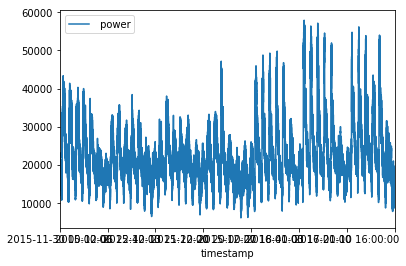

In [35]:
lines = power[:70000].plot.line(x= 'timestamp',y = " power")

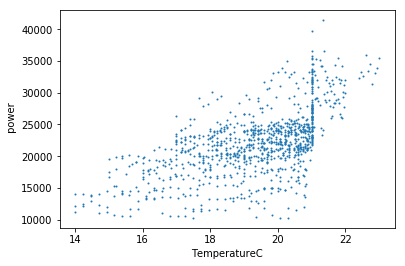

In [33]:
lines = c5[:1000].plot(kind='scatter',s=1,x= 'TemperatureC',y = " power")

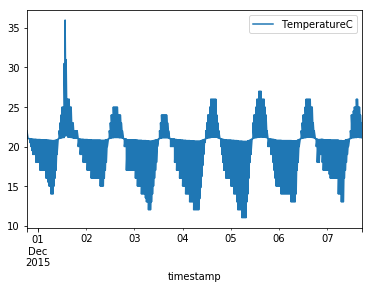

In [34]:
lines = c5[:10000].plot(x= 'timestamp',y = "TemperatureC")

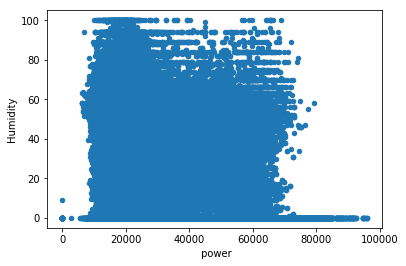

In [41]:
c5.plot(kind='scatter',x=' power',y='Humidity')

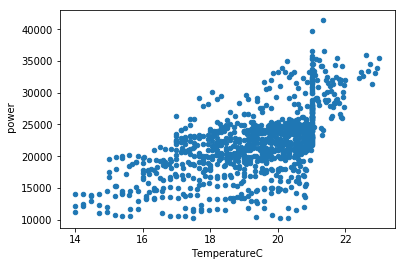

In [60]:
c5[1:1000].plot(kind='scatter',x='TemperatureC',y=' power')

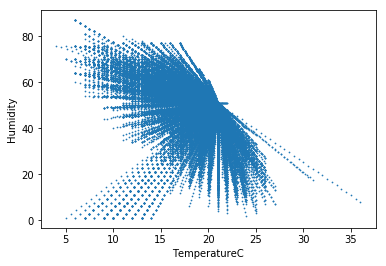

In [127]:
c5[1:70000].plot(kind='scatter',x='TemperatureC',y='Humidity',s=0.5)

In [129]:
c5[1:10000].plot(kind='scatter',x='activity_y',y=' power')

ValueError: scatter requires x column to be numeric

In [96]:
plt.show()
